# Classify a hiprfish image with hierarchical clustering
## Setup

In [1]:
import glob
import sys
import os
import gc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import yaml
import re
from collections import defaultdict
import aicspylibczi as aplc
from skimage.registration import phase_cross_correlation
from tqdm import tqdm
from scipy.cluster import hierarchy
from scipy.spatial.distance import squareform
import umap
import math
from sklearn.cluster import AgglomerativeClustering


In [2]:
cluster = '/fs/cbsuvlaminck2'
workdir = '/workdir/bmg224/manuscripts/mgefish/code/fig_5/2023_04_06_mefe/HiPRFISH/agglomerative_clustering'
os.chdir(cluster + workdir)
os.getcwd()

'/fs/cbsuvlaminck2/workdir/bmg224/manuscripts/mgefish/code/fig_5/2023_04_06_mefe/HiPRFISH/agglomerative_clustering'

In [108]:
config_fn = 'config_matrix_classify.yaml' # relative path to config file from workdir

with open(config_fn, 'r') as f:
    config = yaml.safe_load(f)

In [5]:
%load_ext autoreload
%autoreload 2

sys.path.append(config['pipeline_path'] + '/' + config['functions_path'])
import fn_general_use as fgu
import image_plots as ip
import segmentation_func as sf
import fn_hiprfish_classifier as fhc
import fn_spectral_images as fsi



The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [16]:
print(raw_dir)

../../../../../data/Combined_taxonomic_mapping_and_MGE_mapping/plasmid_mefE_host_association_images/*_method_hiprfish_mode_spec[0-9_]+.czi


In [24]:
# Get filenames from directories 
raw_dir = config['data_dir'] + '/*' + config['laser_regex']
fns = glob.glob(raw_dir)
fns_base = [os.path.split(f)[1] for f in fns]
group_names = [re.sub(config['laser_regex'],'',s) for s in fns_base]
# print('HERE-->', shifts_fns)
group_names = np.sort(np.unique(group_names))
m_size = group_names.shape[0]
dict_group_czifns = defaultdict(list)
for g in group_names:
    for s in fns:
        if g in s:
            dict_group_czifns[g].append(s)
dict_group_czifns = {g:sorted(s) for g, s in dict_group_czifns.items()}
dict_group_czifns

{'plasmid_mefE_host_association_fov_01': ['../../../../../data/Combined_taxonomic_mapping_and_MGE_mapping/plasmid_mefE_host_association_images/plasmid_mefE_host_association_fov_01_method_hiprfish_mode_spec488.czi',
  '../../../../../data/Combined_taxonomic_mapping_and_MGE_mapping/plasmid_mefE_host_association_images/plasmid_mefE_host_association_fov_01_method_hiprfish_mode_spec514.czi',
  '../../../../../data/Combined_taxonomic_mapping_and_MGE_mapping/plasmid_mefE_host_association_images/plasmid_mefE_host_association_fov_01_method_hiprfish_mode_spec561.czi'],
 'plasmid_mefE_host_association_fov_02': ['../../../../../data/Combined_taxonomic_mapping_and_MGE_mapping/plasmid_mefE_host_association_images/plasmid_mefE_host_association_fov_02_method_hiprfish_mode_spec488.czi',
  '../../../../../data/Combined_taxonomic_mapping_and_MGE_mapping/plasmid_mefE_host_association_images/plasmid_mefE_host_association_fov_02_method_hiprfish_mode_spec514.czi',
  '../../../../../data/Combined_taxonomic_ma

In [533]:
sn = 'plasmid_mefE_host_association_fov_06'

## Shift images

In [534]:
from cv2 import resize, INTER_CUBIC, INTER_NEAREST

def center_image(im, dims, ul_corner):
    shp = im.shape
    if not all([dims[i] == shp[i] for i in range(len(dims))]):
        shp_new = dims if len(shp) == 2 else dims + (shp[2],)
        temp = np.zeros(shp_new)
        br_corner = np.array(ul_corner) + np.array(shp[:2])
        temp[ul_corner[0]:br_corner[0], ul_corner[1]:br_corner[1]] = im
        im = temp
    return im

def resize_hipr(im, hipr_res, mega_res, dims='none', out_fn=False, ul_corner=(0,0)):
    # im = np.load(in_fn)
    factor_resize = hipr_res / mega_res
    hipr_resize = resize(
            im,
            None,
            fx = factor_resize,
            fy = factor_resize,
            interpolation = INTER_NEAREST
            )
    if isinstance(dims, str): dims = hipr_resize.shape
    hipr_resize = center_image(hipr_resize, dims, ul_corner)
    # if out_fn: np.save(out_fn, hipr_resize)
    return hipr_resize

def reshape_aics_image(m_img):
    '''
    Given an AICS image with just XY and CHannel,
    REshape into shape (X,Y,C)
    '''
    img = np.squeeze(m_img)
    img = np.transpose(img, (1,2,0))
    return img

def correct_633_sizing(raws, czifns):
    # Get resolution
    res_um_pix = []
    for fn in czifns:
        czi = aplc.CziFile(fn)
        for n in czi.meta.iter():
            if 'Scaling' in n.tag:
                if 'X' in n.tag:
                    resolution = float(n.text)
        res_um_pix.append(resolution * 10**6)
    res_633 = res_um_pix[3]
    res_other = res_um_pix[0]
    print(res_633, '-->', res_other)
    # REsize 633
    # raws_resize = raws.copy()
    resize_633 = resize_hipr(raws[3], res_633, res_other)
    resize_shape = resize_633.shape[:2]
    # other_shape = np.array(raws[0].shape[:2])
    # corner = (np.array(resize_633.shape[:2]) - np.array(other_shape)) // 2
    raws_resize = []
    for i in range(3):
        ri = raws[i]
        sp = ri.shape[2]
        c = (np.array(resize_shape) - np.array(ri.shape[:2])) // 2
        r = np.zeros(resize_shape + (sp,))
        r[c[0]:c[0] + ri.shape[0], c[1]:c[1] + ri.shape[1],:] = ri
        raws_resize.append(r)
    raws_resize.append(resize_633)
    # resize_633 = resize_633[corner[0]:corner[1]+other_shape[0], corner[1]:corner[1]+other_shape[1],:]
    # raws_resize[3] = resize_633
    return(raws_resize, c) 


def _get_shift_vectors(image_sum):
    # Find shift vectors
    shift_vectors = [
            phase_cross_correlation(
                    np.log(image_sum[0]+1), np.log(image_sum[i]+1)
                    )[0]
            for i in range(1,len(image_sum))
            ]
    shift_vectors.insert(0, np.asarray([0.0,0.0]))
    return shift_vectors


def max_norm(raw, c=['min','max']):
    im = np.max(raw, axis=2)
    mn = np.min(im) if c[0] == 'min' else c[0]
    mx = np.max(im) if c[1] == 'max' else c[1]
    im = np.clip(im, mn, mx)
    return (im - mn) / (mx - mn)

In [535]:
czifns = dict_group_czifns[sn]
dimshape = aplc.CziFile(czifns[0]).get_dims_shape()[0]
dimshape

{'X': (0, 2000),
 'Y': (0, 2000),
 'Z': (0, 1),
 'C': (0, 23),
 'T': (0, 1),
 'V': (0, 1),
 'B': (0, 1)}



Tile: 0
0 0 0
1 1 -1
2 3 -2
1


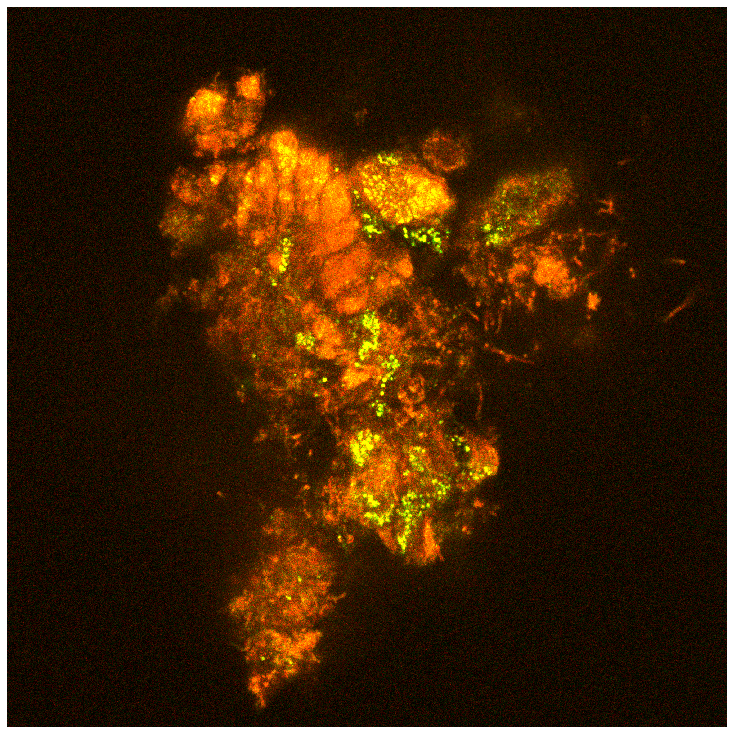

2


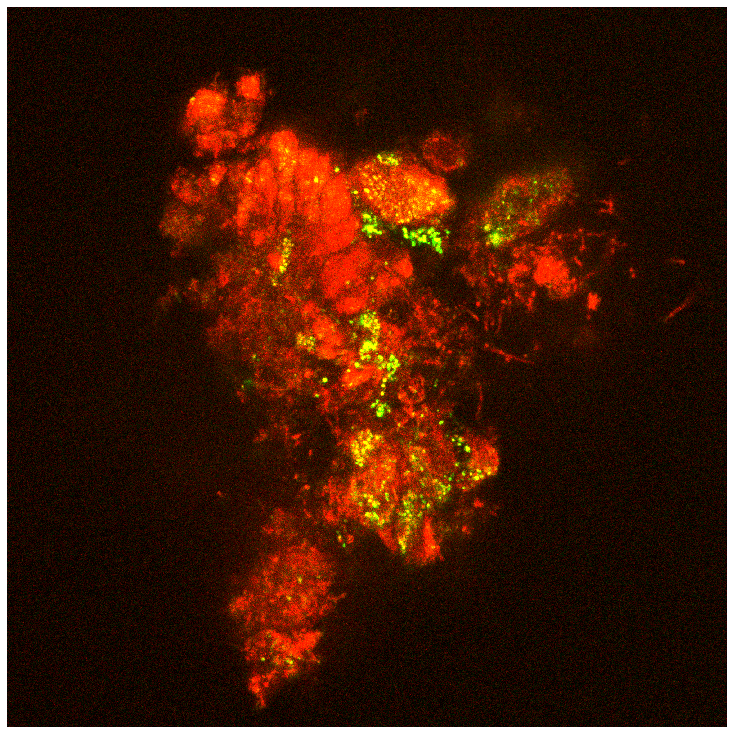

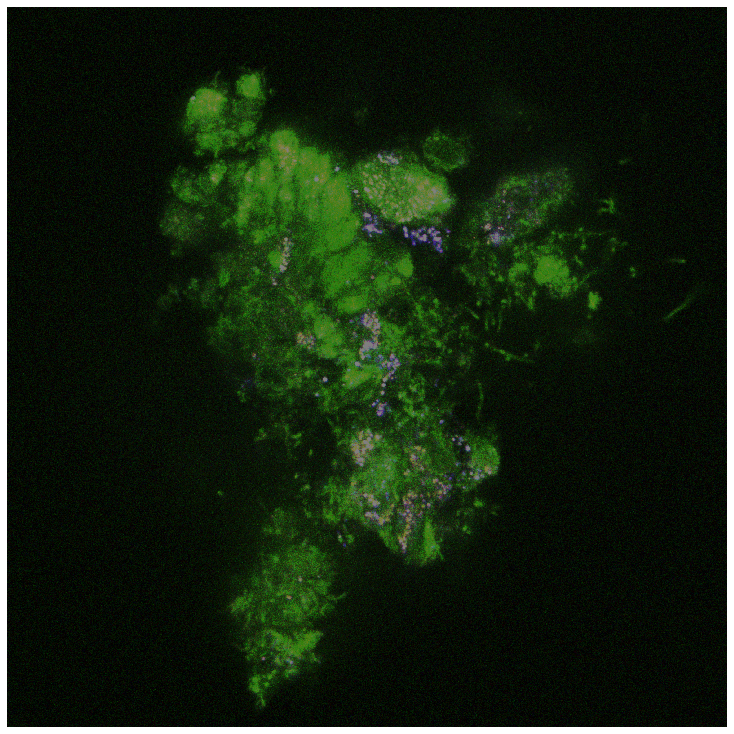

In [536]:
M = 1
# M = dimshape['S'][1]

colors = [[0,0.5,0],[0.5,0,0],[0,0,0.5]]
clips_rgb = [[0,10000],[0,20000],[0,20000]]
stacks = []
im_inches = 10
# for m in [2]:
for m in range(M):
    print("\n\nTile:",m)
    raws = []
    for fn, las in zip(czifns, config['lasers']):
        if las not in config['rgb']['exclude_lasers']:
            czi = aplc.CziFile(fn)
            # if M:
            im, sh = czi.read_image()

            im = reshape_aics_image(im)
            raws.append(im)
    
    raws_max_norm = [max_norm(r, c) for r, c in zip(raws, clips_rgb)]
    shift_vectors = _get_shift_vectors(raws_max_norm)
    # shift_vectors_1_3 = _get_shift_vectors(raws_max_norm[:3])
    
    # raws_resize, c = correct_633_sizing(raws, czifns)
    # raws_shift_max_norm = [max_norm(r, c) for r, c in zip(raws_resize, clips_rgb)]
    # shp = raws_max_norm[0].shape
    # raws_max_norm[3] = raws_shift_max_norm[3][:shp[0],:shp[1]]
    # shift_vectors = _get_shift_vectors(raws_max_norm)
    # shift_vectors[3] = shift_vectors[3] + c
    # max_shift = config['max_shift']
    # raws_shift = fsi._shift_images(raws_resize, shift_vectors, max_shift=max_shift)
    max_shift = config['max_shift']
    raws_shift = fsi._shift_images(raws, shift_vectors, max_shift=max_shift)
        
    # shift_vectors_4 = _get_shift_vectors(raws_shift_max_norm[2:4])
    # shift_vectors = shift_vectors_1_3 + [shift_vectors_4[1]]

    # raws_shift = fsi._shift_images(raws_resize, shift_vectors, max_shift=max_shift)
    im_r = max_norm(raws_shift[0], clips_rgb[0])
    stack_max = [im_r]
    true_points = np.argwhere(im_r)
    top_left = true_points.min(axis=0)
    bottom_right = true_points.max(axis=0)
    for i in range(1,len(raws_shift)):
        im_rgb = np.zeros(im_r.shape + (3,))
        im_rgb[:,:,0] = im_r
        im_g = max_norm(raws_shift[i], clips_rgb[i])
        stack_max.append(im_g)
        im_rgb[:,:,1] = im_g
        print(i)
        ip.plot_image(im_rgb, im_inches=im_inches)
        plt.show()    
        plt.close()
        true_points = np.argwhere(im_g)
        tl = true_points.min(axis=0)
        top_left = np.max(np.vstack([top_left, tl]), axis=0)
        br = true_points.max(axis=0)
        bottom_right = np.min(np.vstack([bottom_right, br]), axis=0)
    raws_chan_col = []
    for c, im in zip(colors, stack_max):
        raws_chan_col.append(im[...,None] * np.array(c)[None,None,:])    
    rgb = np.zeros_like(raws_chan_col[0])
    for im in raws_chan_col:
        rgb += im
    rgb_trim = rgb[
        top_left[0]:bottom_right[0]+1,
        top_left[1]:bottom_right[1]+1
        ]
    ip.plot_image(rgb_trim, im_inches=im_inches)
    plt.show()
    plt.close()
    stacks.append(np.dstack(raws_shift)[
        top_left[0]:bottom_right[0]+1,
        top_left[1]:bottom_right[1]+1
        ])




In [537]:
for n in czi.meta.iter():
    if 'Scaling' in n.tag:
        if 'X' in n.tag:
            resolution = float(n.text)
resolution

6.74755728214788e-08

### Segment

Laser 488


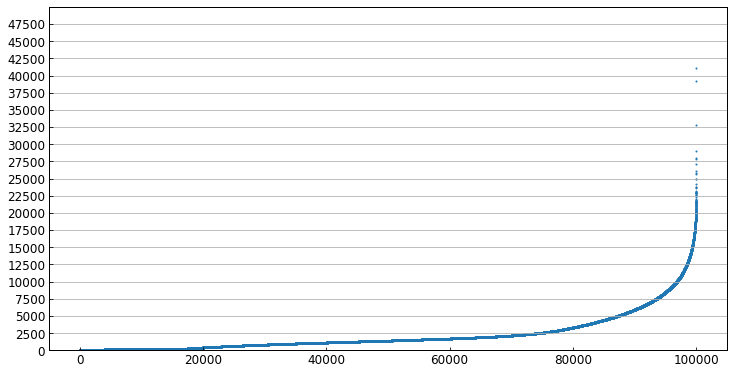

Laser 514


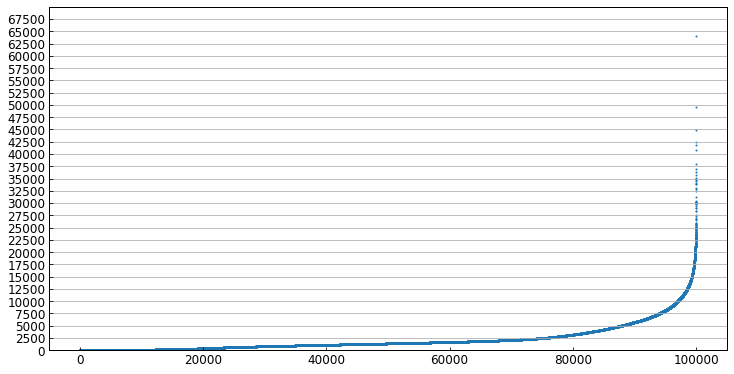

Laser 561


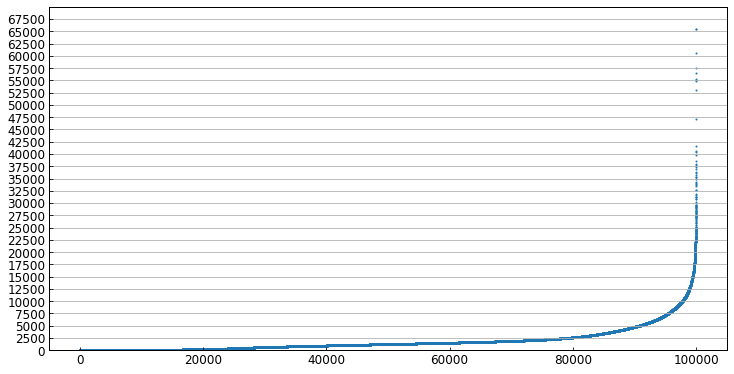

In [538]:
mxs = []
lasers = ['488','514','561']
chan_inds = [0,23,43,57]
for i in range(len(lasers)):
    print('Laser',lasers[i])
    for stack in stacks:
        mx = np.max(stack[:,:,chan_inds[i]:chan_inds[i+1]],axis=2).ravel()
        mxs += mx.tolist()

    mxs_sub = np.random.choice(mxs,100000)
    mxs_sub = np.sort(mxs_sub)


    rnd = 10000

    fig, ax = ip.general_plot(dims=(10,5))
    ax.scatter(np.arange(len(mxs_sub)), mxs_sub, s=1)
    ylim = int(math.ceil(ax.get_ylim()[1] / rnd)) * rnd
    ax.set_ylim(0,ylim)
    ax.set_yticks(np.arange(0, ylim, rnd//4))
    ax.grid(axis='y')
    plt.show()

In [539]:
mask_threshs = [6000,6000,6000]


masks = []
for stack in stacks:
    masks_chan = []
    for i in range(len(lasers)):
        mx = np.max(stack[:,:,chan_inds[i]:chan_inds[i+1]],axis=2)
        masks_chan.append(mx > mask_threshs[i])
    mask = np.zeros_like(masks_chan[0])
    for m in masks_chan:
        mask += m
    masks.append(mask)


(<Figure size 720x720 with 1 Axes>, <Axes:>, [[], []])

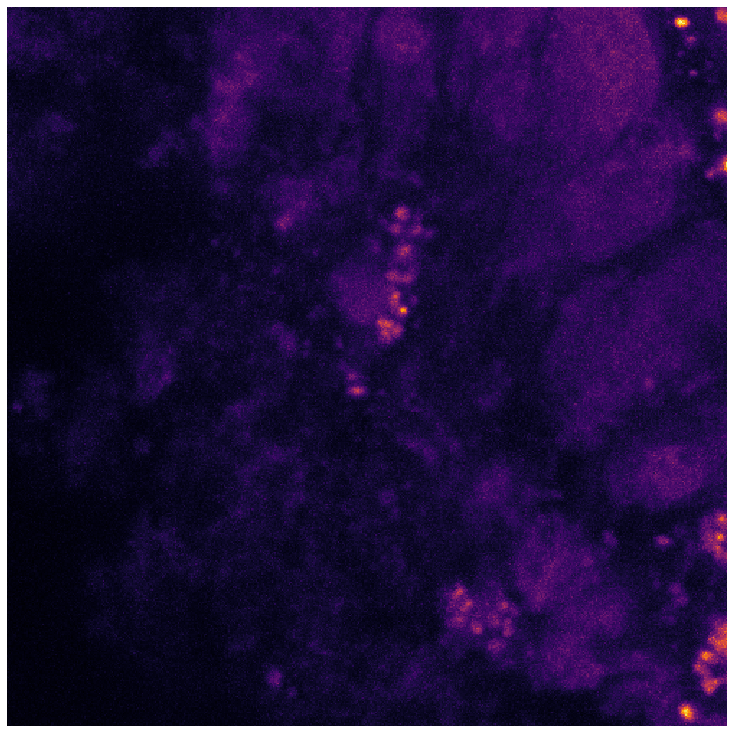

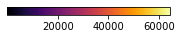

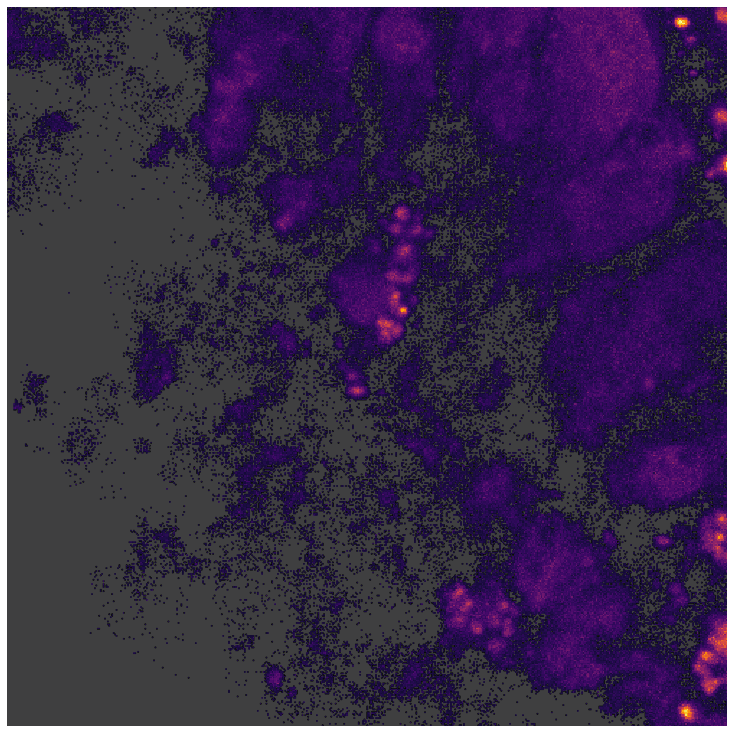

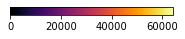

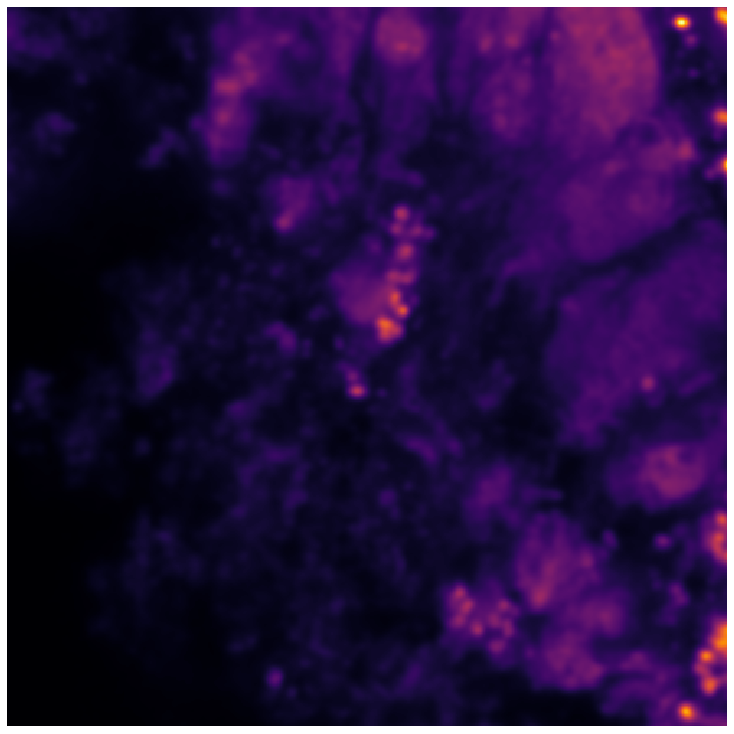

...

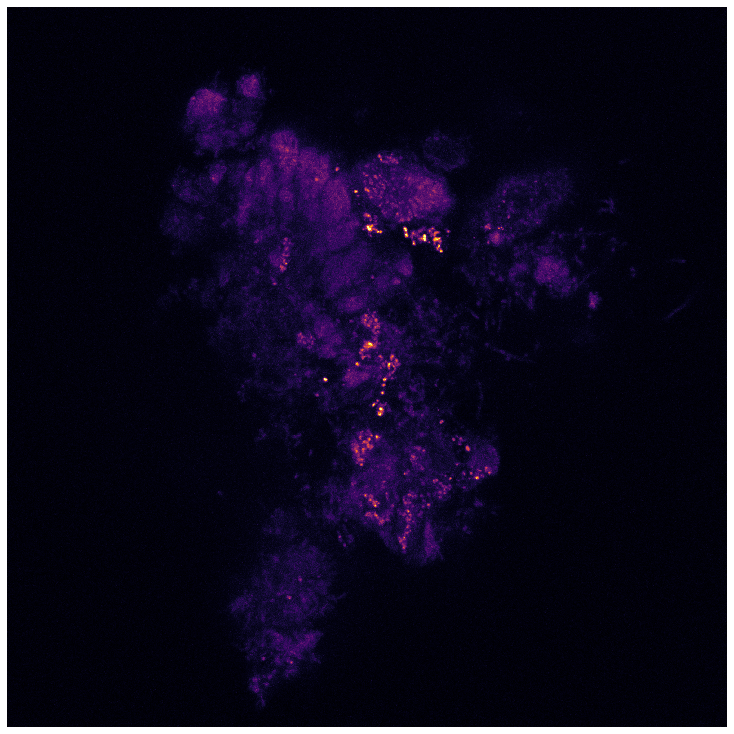

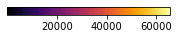

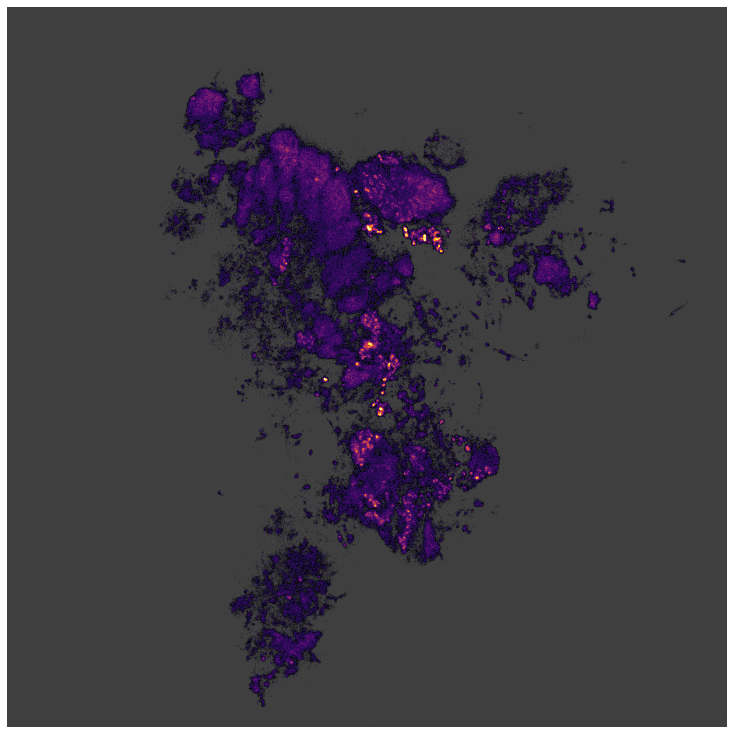

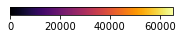

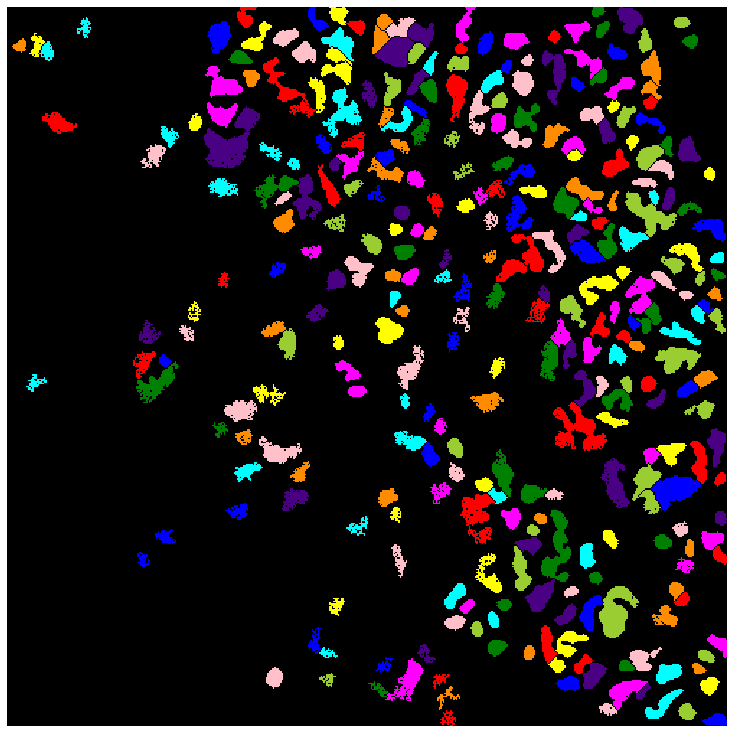

In [540]:
# Set param

z = [500,1000,500,1000]
imin = 10
gauss = 2
diff_gauss = (0,)
mask_thresh = 2500

i = 0
stack = stacks[i]
mask = masks[i]

im_max = np.max(stack, axis=2)
im_sum = np.sum(stack, axis=2)
# mask = im_max > mask_thresh
ip.plot_image(im_max[z[0]:z[1],z[2]:z[3]], cmap='inferno', im_inches=imin)
fig, ax, cbar = ip.plot_image((im_max*mask)[z[0]:z[1],z[2]:z[3]], cmap='inferno', im_inches=imin)
ax.imshow(np.dstack([0.5*(~mask)]*4)[z[0]:z[1],z[2]:z[3]])
pre = sf.pre_process(im_sum, gauss=gauss, diff_gauss=diff_gauss)
ip.plot_image(pre[z[0]:z[1],z[2]:z[3]], cmap='inferno', im_inches=imin)
ip.plot_image((im_max), cmap='inferno', im_inches=imin)
fig, ax, cbar = ip.plot_image((im_max*mask), cmap='inferno', im_inches=imin)
ax.imshow(np.dstack([0.5*(~mask)]*4))
seg = sf.segment(pre[z[0]:z[1],z[2]:z[3]], background_mask=mask[z[0]:z[1],z[2]:z[3]])
seg_zoom_rgb = ip.seg2rgb(seg)
ip.plot_image(seg_zoom_rgb, im_inches=imin)
# ip.plot_image(seg_zoom_rgb[z[0]:z[1],z[2]:z[3]], im_inches=imin)

In [541]:
segs = []
specs = []
props = []
for stack in tqdm(stacks):
    im_max = np.max(stack, axis=2)
    im_sum = np.sum(stack, axis=2)
    # ip.plot_image(im_max[z[0]:z[1],z[2]:z[3]], cmap='inferno', im_inches=imin)
    pre = sf.pre_process(im_sum, gauss=gauss, diff_gauss=diff_gauss)
    # ip.plot_image(pre[z[0]:z[1],z[2]:z[3]], cmap='inferno', im_inches=imin)
    mask = im_max > mask_thresh
    # ip.plot_image((pre), cmap='inferno', im_inches=imin)
    # ip.plot_image((pre*mask), cmap='inferno', im_inches=imin)
    seg = sf.segment(pre, background_mask=mask)
    segs.append(seg)
    prop = sf.measure_regionprops(seg, raw=im_sum)
    props.append(prop)
    dict_lab_spec = {}
    for i, row in prop.iterrows():
        b = row.bbox
        l = row.label
        b = eval(b) if isinstance(b, str) else b
        r_sub = stack[b[0]:b[2],b[1]:b[3],:]
        m_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        dict_lab_spec[l] = r_sub[m_sub]
    dict_lab_specmean = {l:np.mean(s, axis=0) for l, s in dict_lab_spec.items()}
    specs.append(dict_lab_specmean)


  0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 1/1 [00:42<00:00, 42.21s/it]


Filter intensity

Laser 488


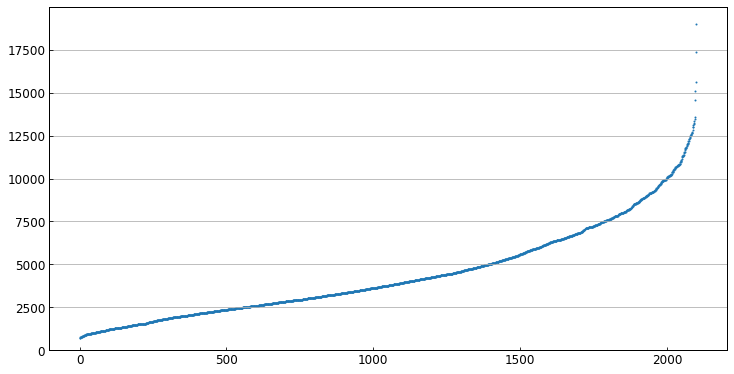

Laser 514


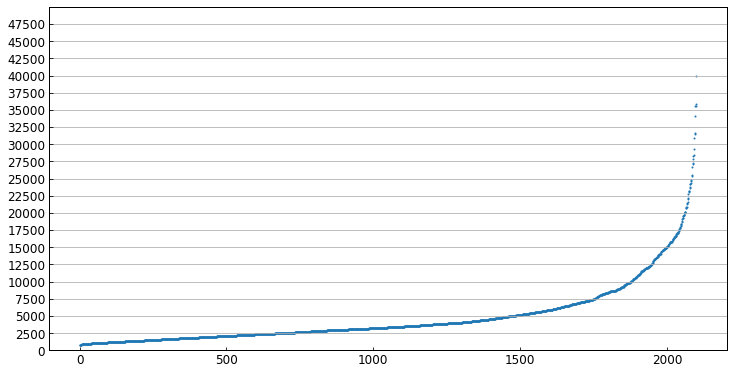

Laser 561


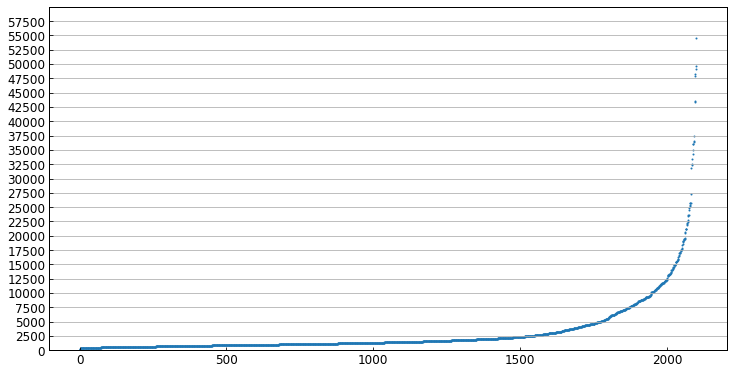

In [542]:
for i in range(len(lasers)):
    mxs = []
    print('Laser',lasers[i])
    for dict_lab_specmean in specs:
        s_ch = np.array(list(dict_lab_specmean.values()))[:,chan_inds[i]:chan_inds[i+1]]
        mx = np.max(s_ch, axis=1)
        # mx = np.max(stack[:,:,chan_inds[i]:chan_inds[i+1]],axis=2).ravel()
        mxs += mx.tolist()
    # mxs_sub = np.random.choice(mxs,100000)
    mxs = np.sort(mxs)


    rnd = 10000

    fig, ax = ip.general_plot(dims=(10,5))
    ax.scatter(np.arange(len(mxs)), mxs, s=1)
    ylim = int(math.ceil(ax.get_ylim()[1] / rnd)) * rnd
    ax.set_ylim(0,ylim)
    ax.set_yticks(np.arange(0, ylim, rnd//4))
    ax.grid(axis='y')
    plt.show()

In [543]:
seg_threshs = [5000,5000,5000]
specs_filt = []
for dict_lab_specmean in specs:
    dict_lab_specfilt = {}
    for l, s in dict_lab_specmean.items():
        mxs_ch = [np.max(s[chan_inds[i]:chan_inds[i+1]]) for i in range(len(lasers))]
        mxs_ch_bool = [mxs_ch[i] > seg_threshs[i] for i in range(len(lasers))]
        if any(mxs_ch_bool):
            dict_lab_specfilt[l] = s
    specs_filt.append(dict_lab_specfilt)

print([len(s) for s in specs])
print([len(s) for s in specs_filt])

[2101]
[822]


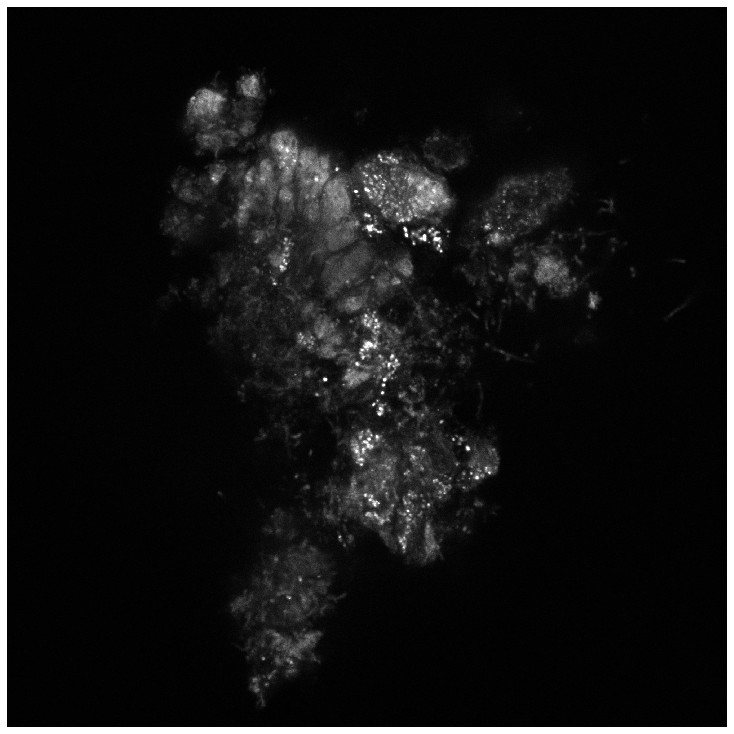

In [544]:
for m in range(M):
    im_sum = np.sum(stacks[m], axis=2)

    mx = np.max(im_sum)*0.35
    # mx = 60000
    mn = np.min(im_sum)
    im_norm = np.clip(im_sum,mn,mx)
    im_norm = (im_norm - mn) / (mx - mn)
    im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
    im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])
    fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

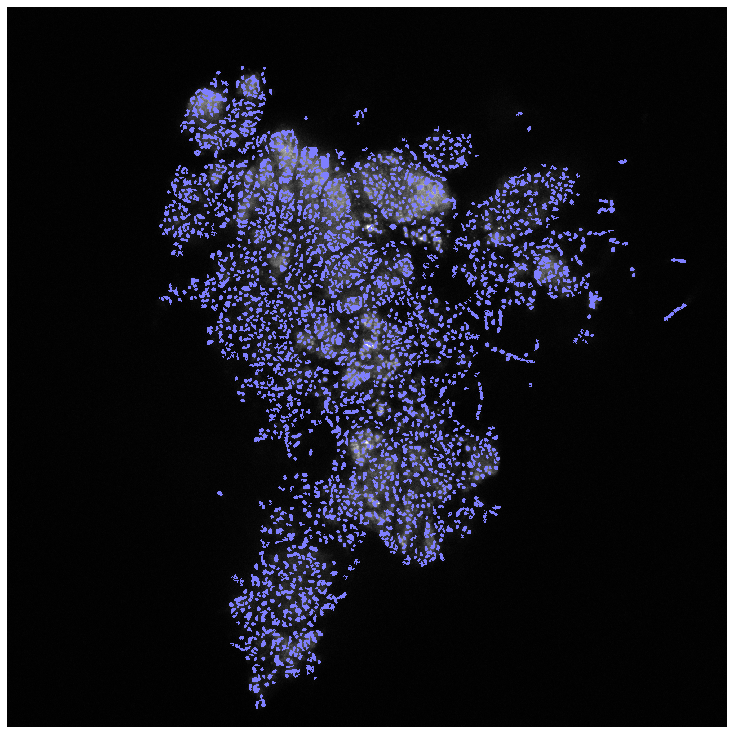

In [545]:
for m in range(M):
    dict_lab_spec = specs[m]
    labels = list(dict_lab_spec.keys())
    seg = segs[m]
    prop = props[m]
    for i, row in prop.iterrows():
        l = row.label
        if l in labels:
            b = row.bbox
            b = eval(b) if isinstance(b, str) else b
            rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
            seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
            im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
            color = np.array([0,0,1,0.5])
            # rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3 + np.ones_like(seg_sub))
            rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
            # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
            rgb_cell = seg_sub[:,:,None] * color[None,:]
            im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

    fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

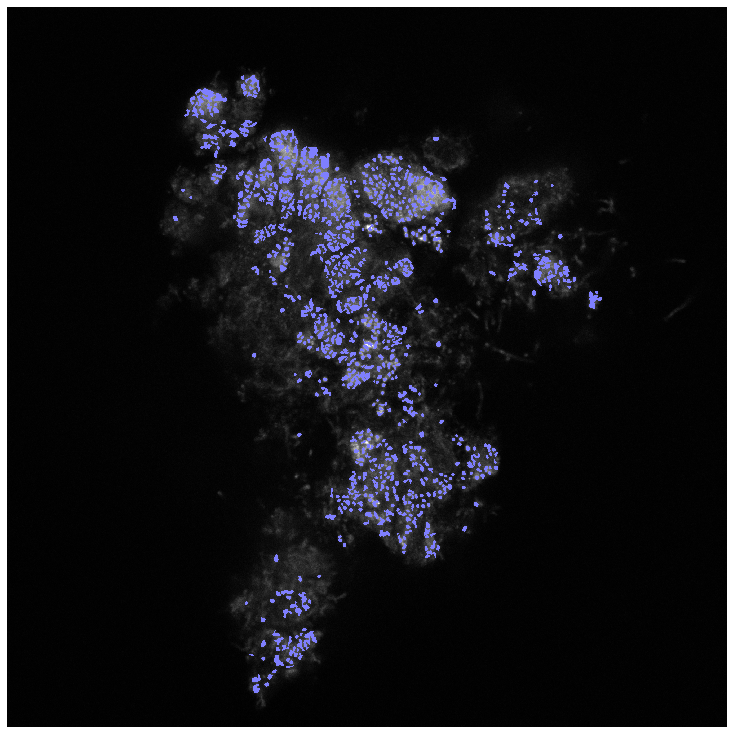

In [546]:

for m in range(M):
    im_sum = np.sum(stacks[m], axis=2)

    mx = np.max(im_sum)*0.35
    # mx = 60000
    mn = np.min(im_sum)
    im_norm = np.clip(im_sum,mn,mx)
    im_norm = (im_norm - mn) / (mx - mn)
    im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
    im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])
    
    dict_lab_specfilt = specs_filt[m]
    labels = list(dict_lab_specfilt.keys())
    seg = segs[m]
    prop = props[m]
    for i, row in prop.iterrows():
        l = row.label
        if l in labels:
            b = row.bbox
            b = eval(b) if isinstance(b, str) else b
            rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
            seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
            im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
            color = np.array([0,0,1,0.5])
            # rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3 + np.ones_like(seg_sub))
            rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
            # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
            rgb_cell = seg_sub[:,:,None] * color[None,:]
            im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

    fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

In [480]:
# rnd = 10000

# fig, ax = ip.general_plot(dims=(10,5))
# ax.scatter(np.arange(len(mxs)), mxs, s=1)
# ylim = int(math.ceil(ax.get_ylim()[1] / rnd)) * rnd
# ax.set_ylim(0,ylim)
# ax.set_yticks(np.arange(0, ylim, rnd//4))
# ax.grid(axis='y')


In [392]:
# spec_thresh = 2000
# specs_filt = []
# for dict_lab_specmean in specs:
#     dict_lab_specfilt = {}
#     for l, s in dict_lab_specmean.items():
#         if np.max(s) > spec_thresh:
#             dict_lab_specfilt[l] = s
#     specs_filt.append(dict_lab_specfilt)

## Clustering auto

In [677]:
n_clust = 20

# Setup output dirs
output_dir = '../outputs/agglomerative_cluster/' + sn
# output_dir = output_dir_fmt.format(sample_name=sn)
if not os.path.exists(output_dir): 
    os.makedirs(output_dir)
    print("made dir:",output_dir)

stack_dir = output_dir + '/stacks'
props_dir = output_dir + '/props'
segs_dir = output_dir + '/segs'
spec_dir = output_dir + '/spectra'
clust_dir = output_dir + '/clust'

for dir_ in [clust_dir, spec_dir, segs_dir, props_dir, stack_dir]:
    if not os.path.exists(dir_):
        os.makedirs(dir_)
        print("made dir:",dir_)


for m in range(M):
    # Get derivative of spectra
    dict_lab_specmean = specs_filt[m]
    dict_lab_slope = {l:np.diff(s) for l, s in dict_lab_specmean.items()}


    # Build distance matrix between all cell spectra
    n_cells = len(dict_lab_slope)

    dist_mat = np.zeros((n_cells,n_cells))
    for i, s_i in tqdm(enumerate(dict_lab_slope.values())):
        s_i_sub = s_i
        for j, s_j in enumerate(dict_lab_slope.values()):
            # if j > i:
            s_j_sub = s_j
            dist_mat[i,j] = fhc.channel_cosine_intensity_allonev2(s_i_sub, s_j_sub)

    # Cluster
    condensed_dist_mat = squareform(dist_mat)
    linkage = hierarchy.linkage(condensed_dist_mat, method='complete')
    labels = list(dict_lab_slope.keys())
    agg = AgglomerativeClustering(n_clusters=n_clust, affinity='precomputed', linkage='complete')

    agg.fit(dist_mat)

    clust_all = agg.labels_

    dict_lab_clust = dict(zip(labels,clust_all))

    # Save files
    bn = sn + '_M_' + str(m)
    stack_fn = stack_dir + '/' + bn + '_stack.npy'
    props_fn = props_dir + '/' + bn + '_props.csv'
    seg_fn = segs_dir + '/' + bn + '_seg.npy'
    spec_fn = spec_dir + '/' + bn + '_spec.yaml'
    clust_fn = clust_dir + '/' + bn + '_clust.yaml'

    np.save(stack_fn, stacks[m])
    print('Wrote:',stack_fn)
    props[m].to_csv(props_fn, index=False)
    print('Wrote:',props_fn)
    np.save(seg_fn, segs[m])
    print('Wrote:',seg_fn)
    with open(spec_fn, 'w') as f:
        yaml.dump(specs[m], f)
    print('Wrote:',spec_fn)
    with open(clust_fn, 'w') as f:
        yaml.dump(dict_lab_clust, f)
    print('Wrote:',clust_fn)



made dir: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01
made dir: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/clust
made dir: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/spectra
made dir: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/segs
made dir: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/props
made dir: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/stacks


7281it [00:43, 167.38it/s]


Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/stacks/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_0_stack.npy
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/props/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_0_props.csv
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/segs/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_0_seg.npy
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/spectra/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_0_spec.yaml
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/clust/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_0_clust.yaml


1796it [00:02, 730.90it/s]


Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/stacks/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_1_stack.npy
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/props/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_1_props.csv
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/segs/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_1_seg.npy
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/spectra/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_1_spec.yaml
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/clust/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_1_clust.yaml


6457it [00:31, 204.34it/s]


Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/stacks/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_2_stack.npy
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/props/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_2_props.csv
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/segs/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_2_seg.npy
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/spectra/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_2_spec.yaml
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/clust/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_2_clust.yaml


3943it [00:11, 345.55it/s]


Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/stacks/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_3_stack.npy
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/props/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_3_props.csv
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/segs/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_3_seg.npy
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/spectra/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_3_spec.yaml
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/clust/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_3_clust.yaml


7439it [00:41, 177.74it/s]


Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/stacks/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_4_stack.npy
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/props/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_4_props.csv
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/segs/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_4_seg.npy
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/spectra/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_4_spec.yaml
Wrote: ../outputs/agglomerative_cluster/2023_02_18_hsdm_group_batch1_patient_7_fov_01/clust/2023_02_18_hsdm_group_batch1_patient_7_fov_01_M_4_clust.yaml


### Clustering Manual

In [547]:
m = 0

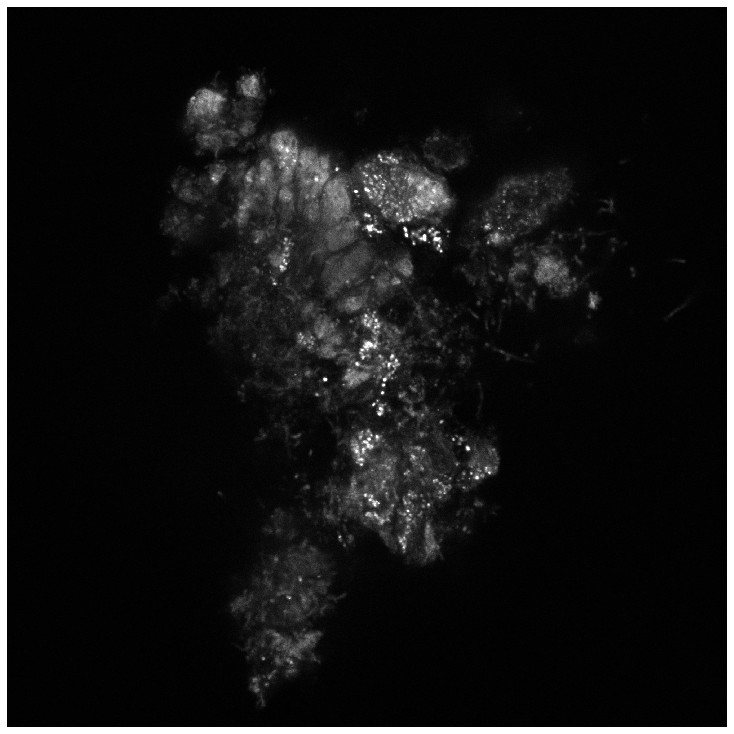

In [548]:
im_sum = np.sum(stacks[m], axis=2)

mx = np.max(im_sum)*0.35
# mx = 60000
mn = np.min(im_sum)
im_norm = np.clip(im_sum,mn,mx)
im_norm = (im_norm - mn) / (mx - mn)
im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

In [549]:
np.max(list(specs[m].values()))

54512.14193548387

In [550]:
# n_cells = 0
# slopes = []
# dict_ind_lab = {}
# ind = 0
# for m, dict_lab_specmean in enumerate(specs):
#     s_ = []
#     for l,s in dict_lab_specmean.items():
#         s_.append(np.diff(s))
#         dict_ind_lab[ind] = [m,l]
#         ind += 1   
#     slopes += s_ 
#     # n_cells += len(dict_lab_specmean)
# n_cells = len(dict_ind_lab)
# print(n_cells)
dict_lab_specmean = specs_filt[m]
dict_lab_slope = {l:np.diff(s) for l, s in dict_lab_specmean.items()}



822it [00:00, 1685.32it/s]


(<Figure size 720x720 with 1 Axes>,
 <Axes:>,
 [<Figure size 720x72 with 2 Axes>,
  <matplotlib.colorbar.Colorbar at 0x7f03a890e3a0>])

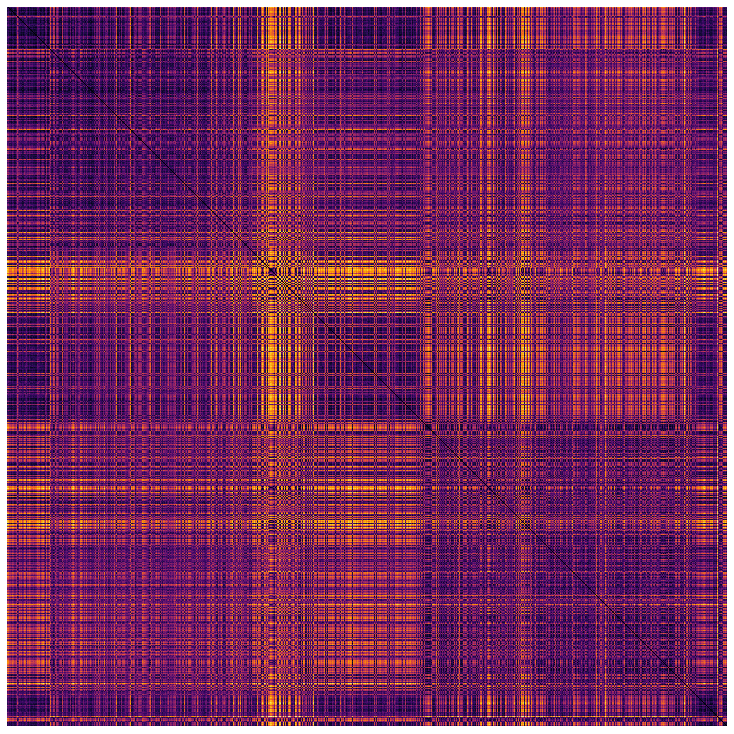

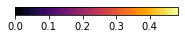

In [551]:
# dist_mat = np.zeros((n_cells,n_cells))

# for i, s_i in tqdm(enumerate(slopes)):
#     s_i_sub = s_i
#     for j, s_j in enumerate(slopes):
#         if j > i:
#             s_j_sub = s_j
#             dist_mat[i,j] = fhc.channel_cosine_intensity_allonev2(s_i_sub, s_j_sub)
# dist_mat_t = dist_mat.copy().T
# for i in range(dist_mat.shape[0]):
#     dist_mat_t[i,i] = 0
# dist_mat += dist_mat_t
# ip.plot_image(dist_mat, cmap='inferno',im_inches=imin)

n_cells = len(dict_lab_slope)

dist_mat = np.zeros((n_cells,n_cells))
for i, s_i in tqdm(enumerate(dict_lab_slope.values())):
    s_i_sub = s_i
    for j, s_j in enumerate(dict_lab_slope.values()):
        # if j > i:
        s_j_sub = s_j
        dist_mat[i,j] = fhc.channel_cosine_intensity_allonev2(s_i_sub, s_j_sub)
ip.plot_image(dist_mat, cmap='inferno',im_inches=imin)

In [552]:
condensed_dist_mat = squareform(dist_mat)
linkage = hierarchy.linkage(condensed_dist_mat, method='complete')

In [553]:
labels = list(dict_lab_slope.keys())

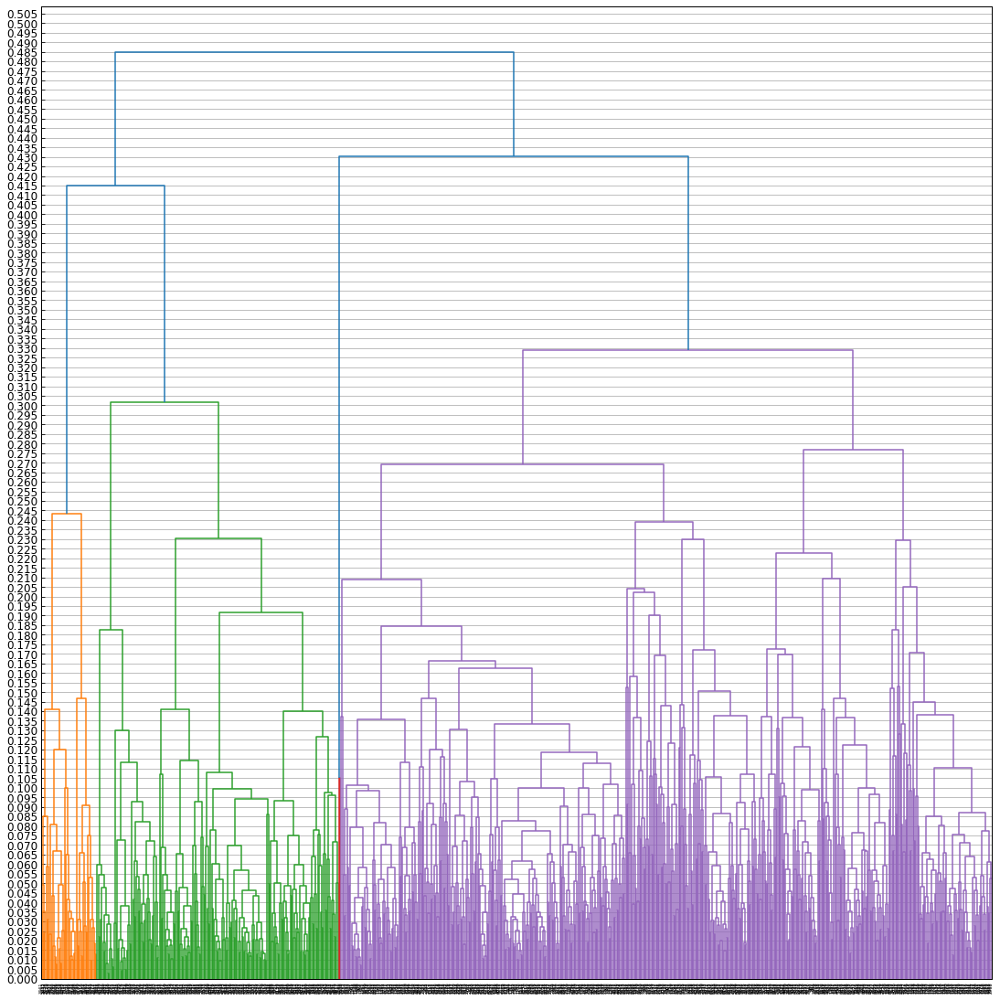

In [554]:

fig, ax = ip.general_plot(dims=(15,15))
dn = hierarchy.dendrogram(linkage, labels=labels, truncate_mode=None)
# dn = hierarchy.dendrogram(linkage, labels=inds, truncate_mode='lastp')
# ax.axhline(t[i])
ylims = [round(l,2) for l in ax.get_ylim()]
ax.set_yticks(np.arange(ylims[0],ylims[1],0.005))
ax.grid(axis='y')
plt.show()
plt.close()

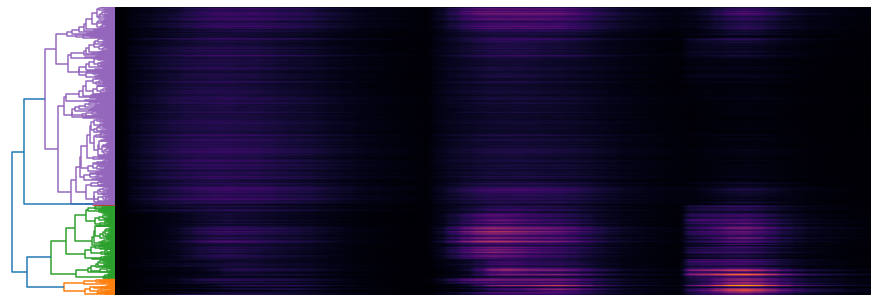

In [555]:
spec_arr_order = []
for l in dn['ivl']:
    s = dict_lab_specmean[l]
    spec_arr_order.append(s)
spec_arr_order = np.vstack(spec_arr_order)



fig = plt.figure(figsize=(15,5))
axs = {
    0: fig.add_axes([0.1,0.1,0.1,0.8]),
    1: fig.add_axes([0.2,0.1,0.7,0.8])
}
hierarchy.dendrogram(linkage, ax=axs[0], labels=labels, orientation='left', no_labels=True, truncate_mode=None)
axs[1].imshow(np.flip(spec_arr_order, axis=0), cmap='inferno', aspect='auto')
axs[1].axis('off')
axs[0].axis('off')
plt.show()
plt.close()

/home/bmg224/miniconda3/envs/hiprfish_imaging_py38/lib/python3.8/site-packages/umap/umap_.py:1780: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")


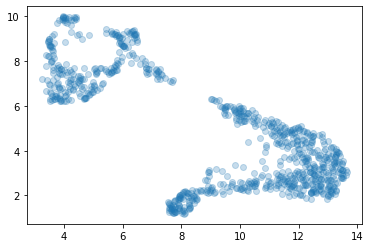

In [556]:
fit = umap.UMAP(metric='precomputed')
u = fit.fit_transform(dist_mat)
plt.scatter(u[:,0], u[:,1], alpha=0.25)
plt.show()
plt.close()

In [557]:
from sklearn.cluster import AgglomerativeClustering

n_clust = 20
agg = AgglomerativeClustering(n_clusters=n_clust, affinity='precomputed', linkage='complete')

agg.fit(dist_mat)

clust_agg = agg.labels_



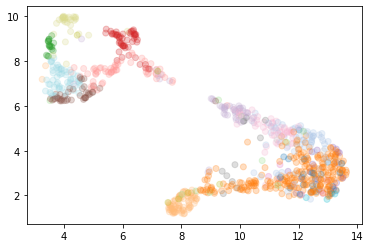

In [558]:

plt.scatter(u[:,0], u[:,1], c=clust_agg, alpha=0.25, cmap='tab20')
plt.show()
plt.close()

In [559]:
clust_all = clust_agg


In [560]:
dict_lab_clust = dict(zip(labels,clust_all))
colors = plt.get_cmap('tab20')(np.linspace(0,1,n_clust))
dict_clust_col = dict(zip(np.unique(clust_all), colors))

In [561]:
im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])

seg = segs[m]
prop = props[m]
for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        # rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3 + np.ones_like(seg_sub))
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

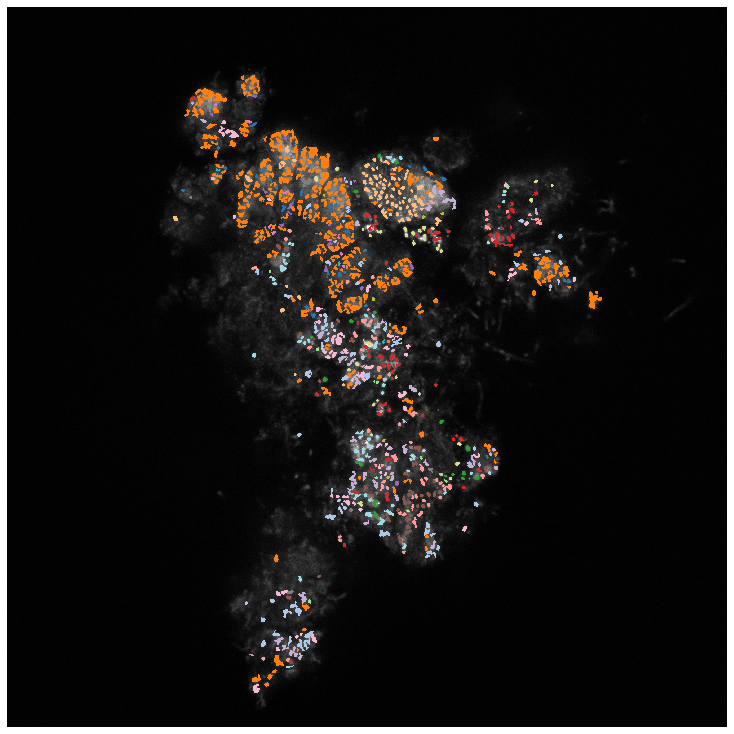

In [562]:
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

Cluster: 0


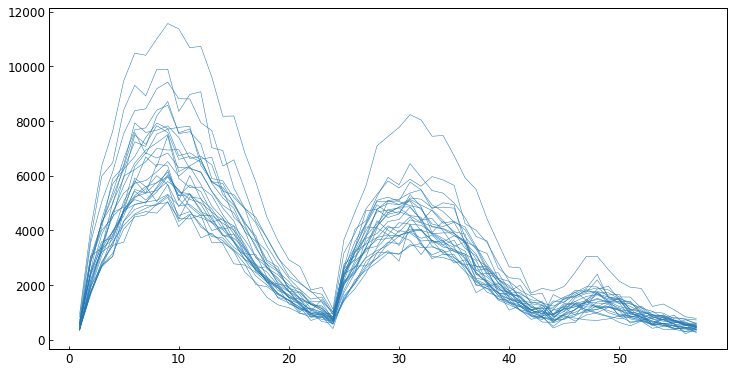

Cluster: 1


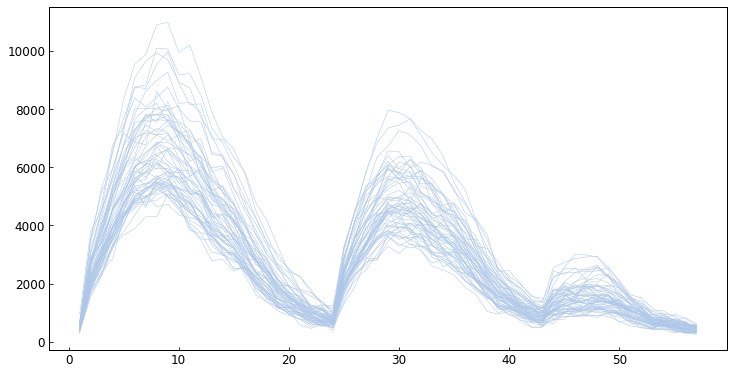

Cluster: 2


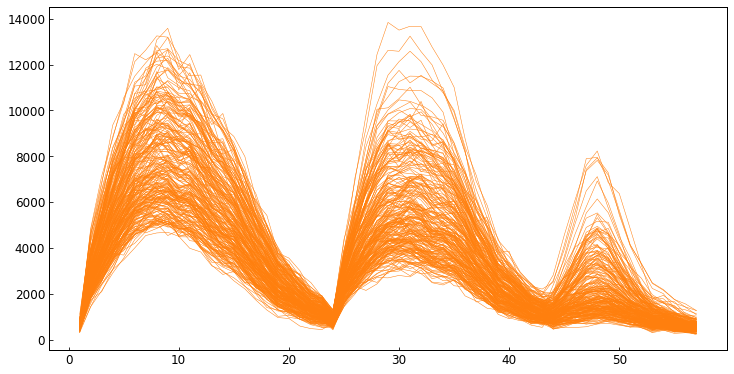

Cluster: 3


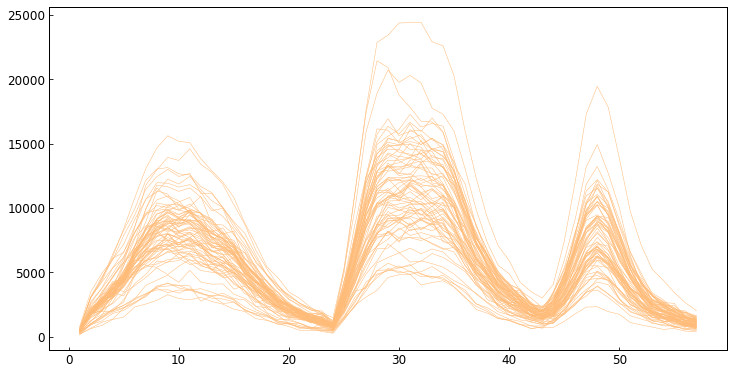

Cluster: 4


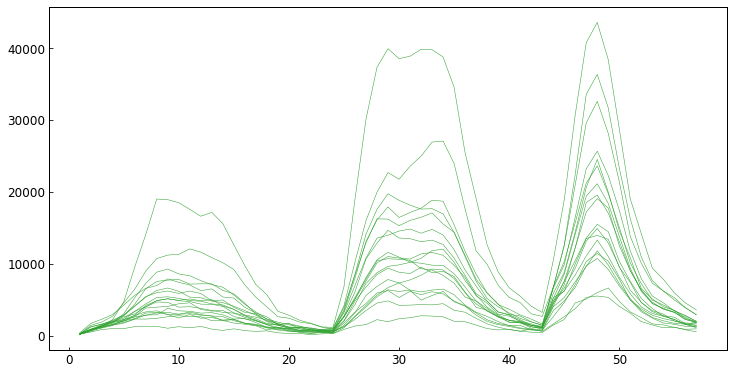

Cluster: 5


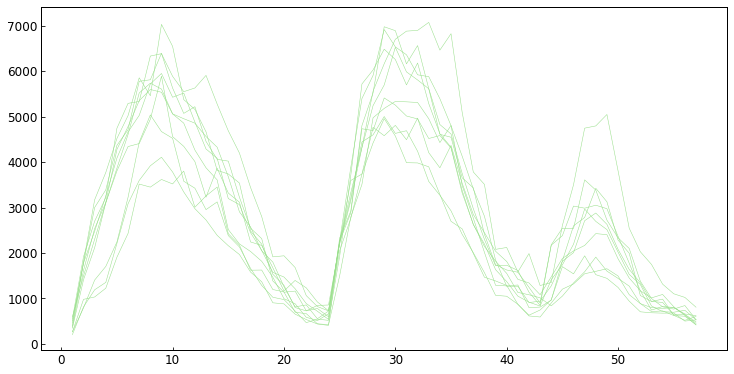

Cluster: 6


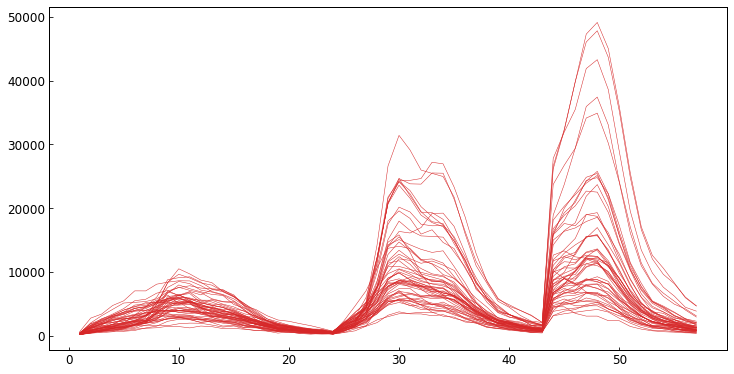

Cluster: 7


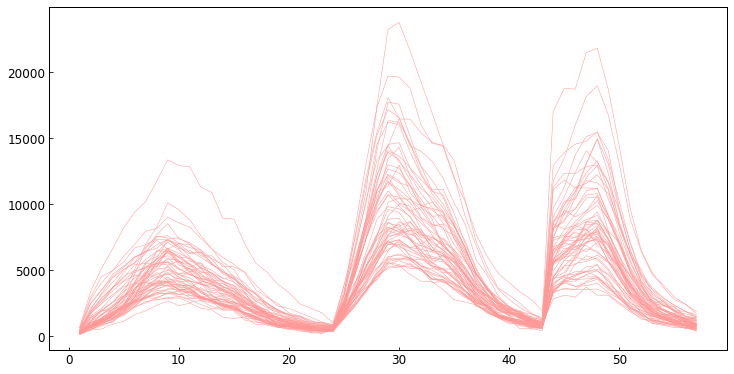

Cluster: 8


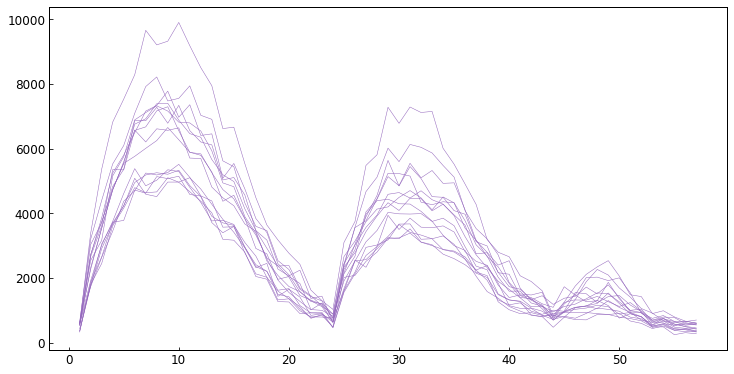

Cluster: 9


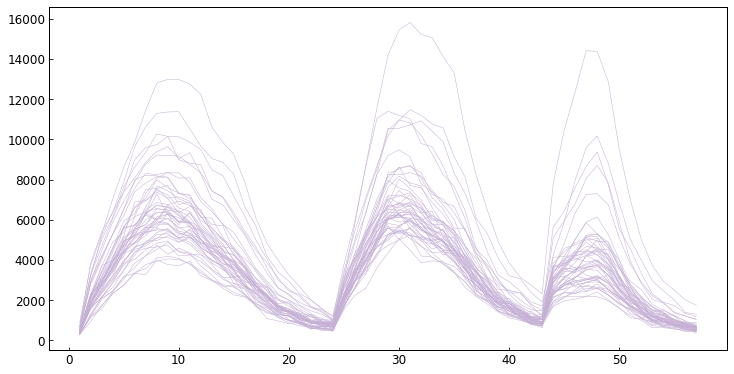

Cluster: 10


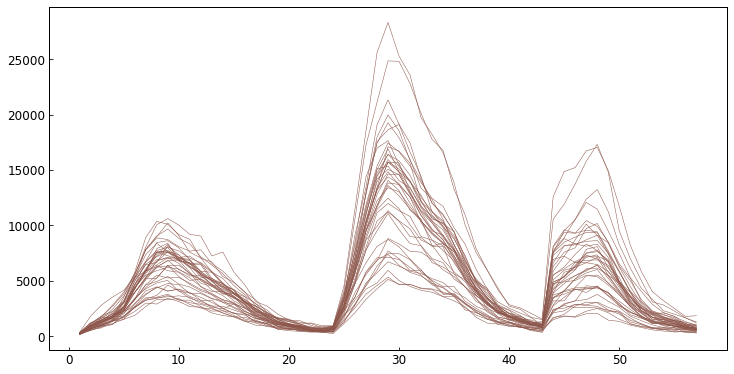

Cluster: 11


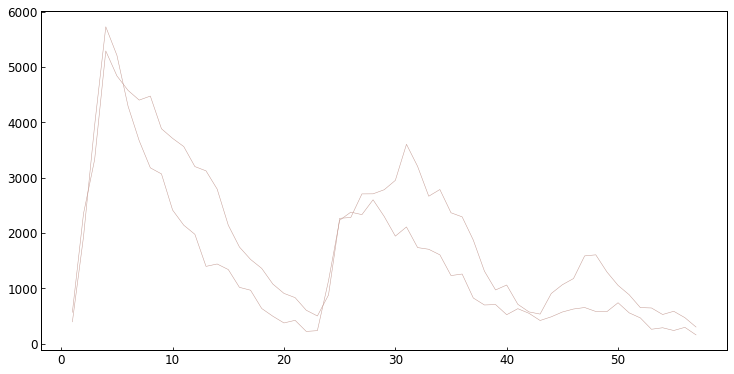

Cluster: 12


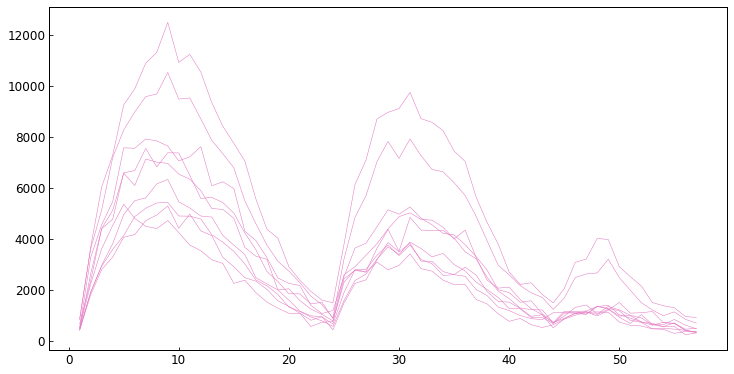

Cluster: 13


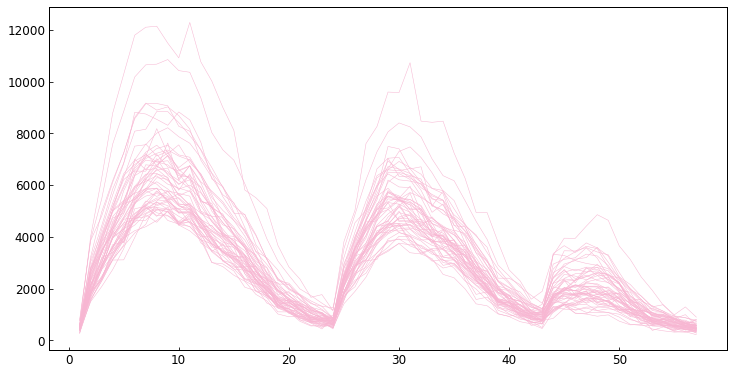

Cluster: 14


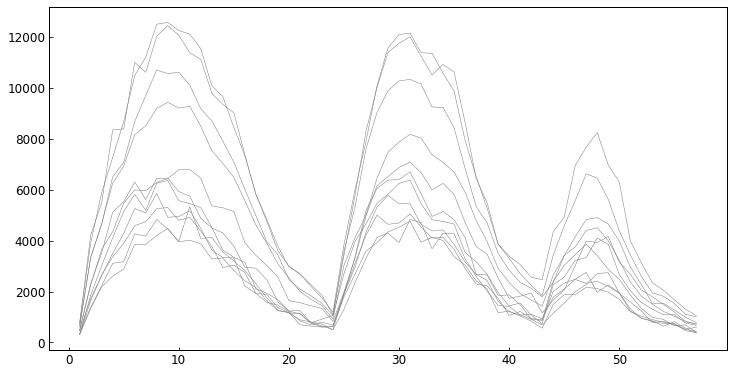

Cluster: 15


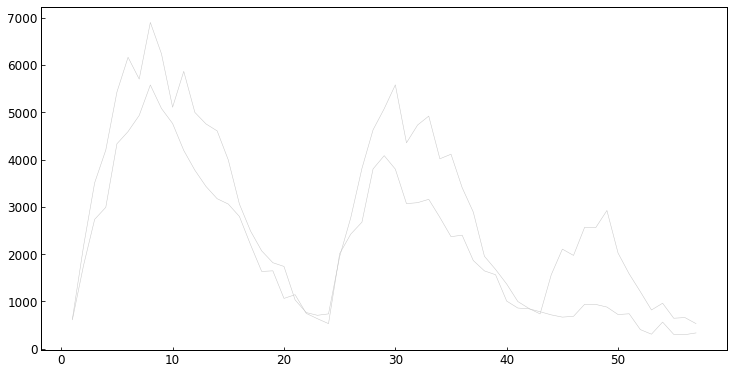

Cluster: 16


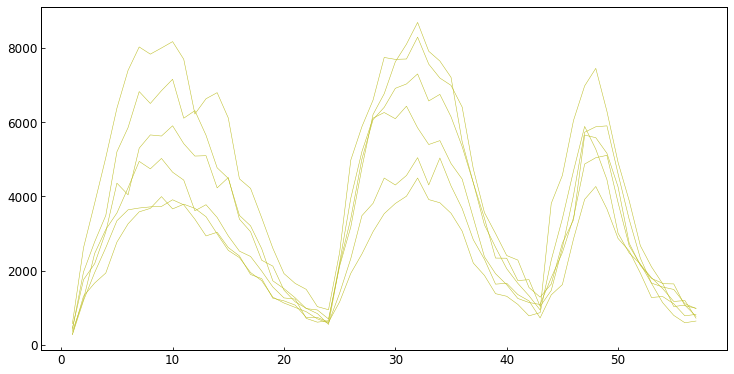

Cluster: 17


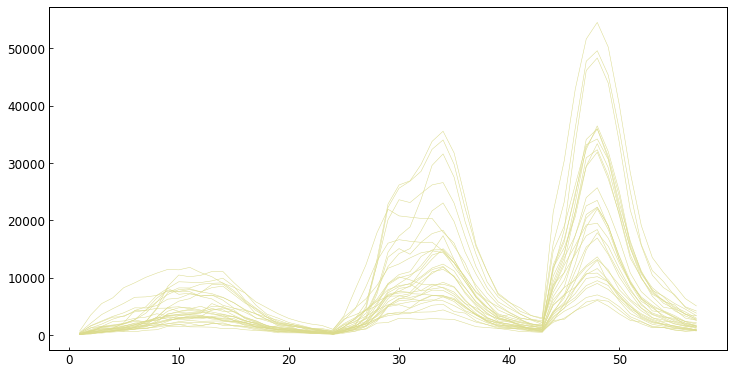

Cluster: 18


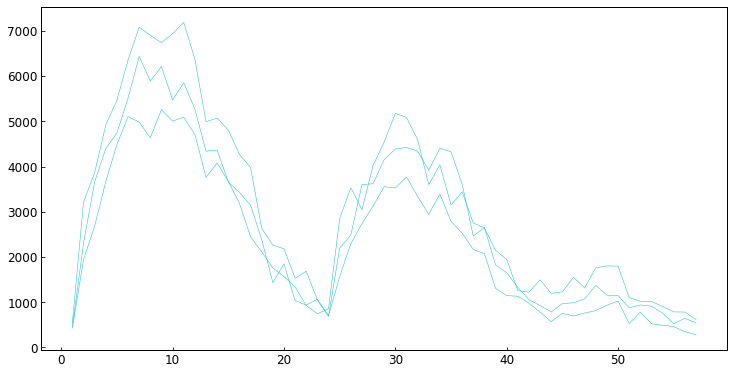

Cluster: 19


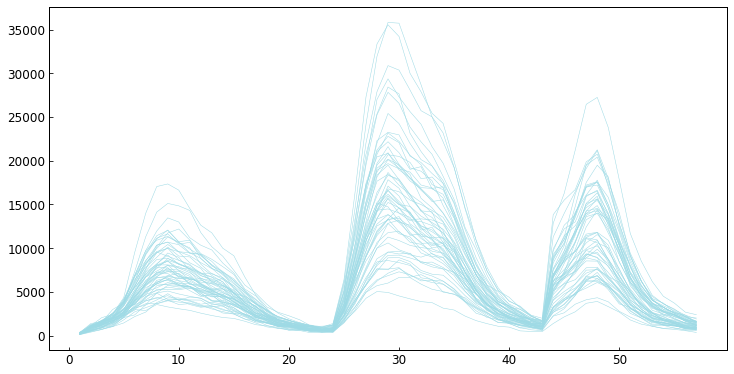

In [563]:
spec_dims = (10,5)

for c in np.unique(clust_all):
    print('Cluster:', c)
    bool_c = clust_all == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':1,'color':color})
    # ax.set_ylim(0,12500)
    # ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

### Subset clusters

Cluster: 1


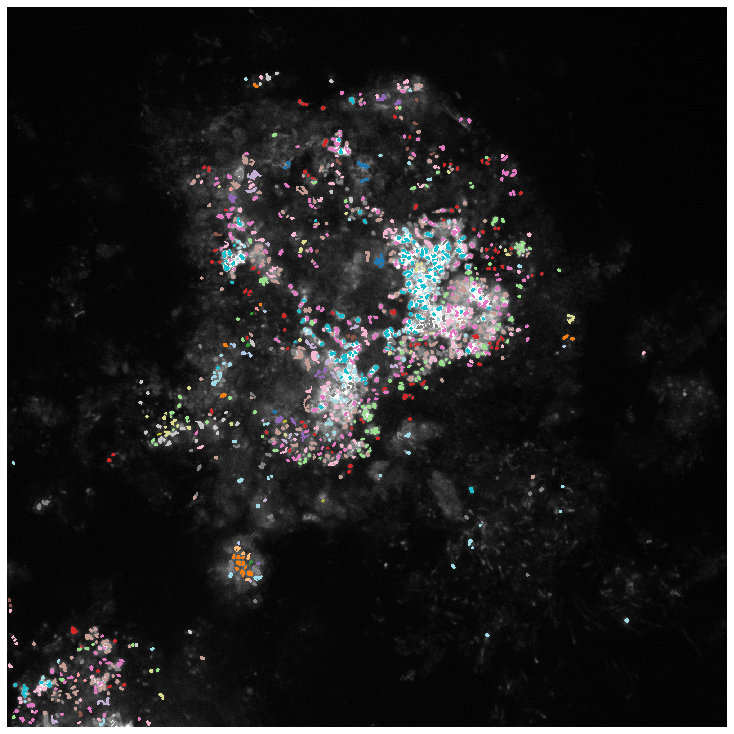

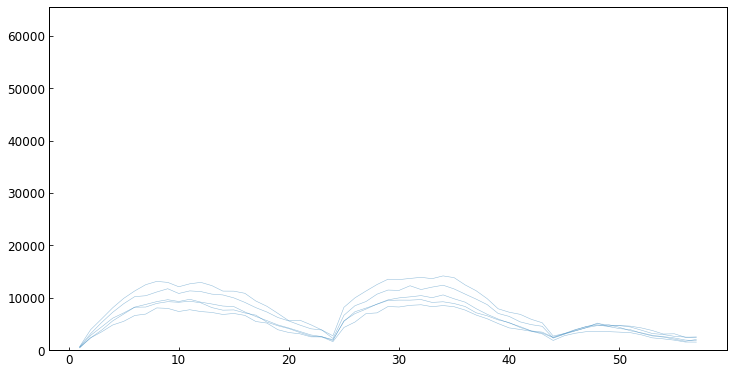

Cluster: 2


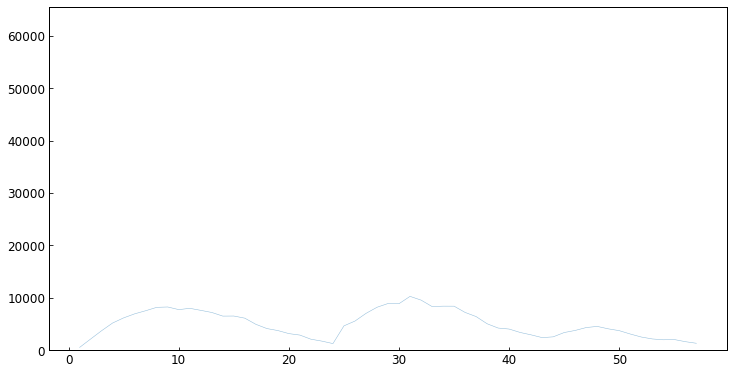

Cluster: 3


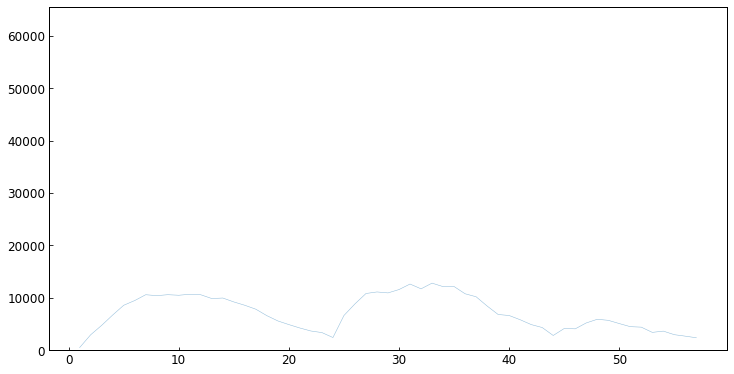

Cluster: 4


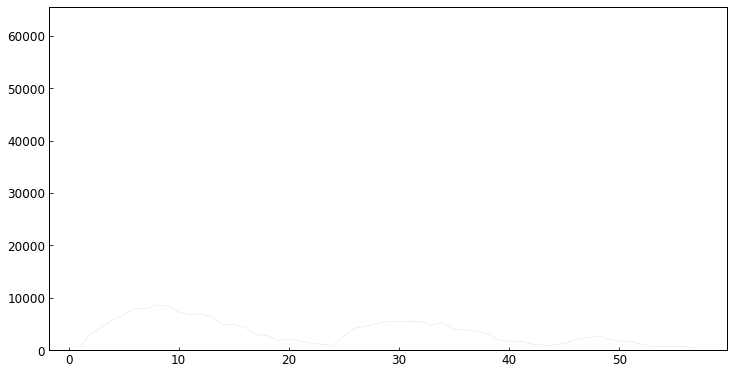

Cluster: 5


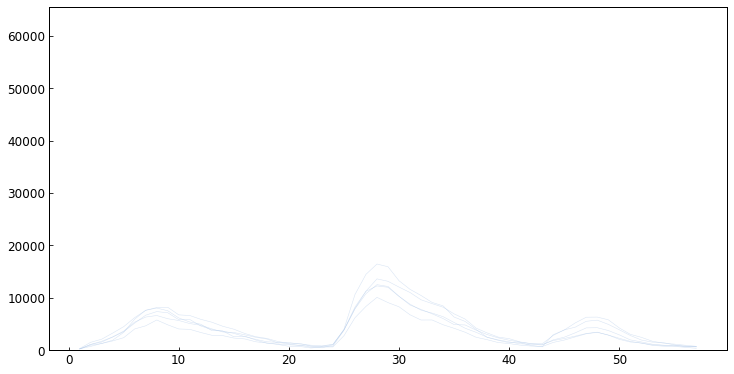

Cluster: 6


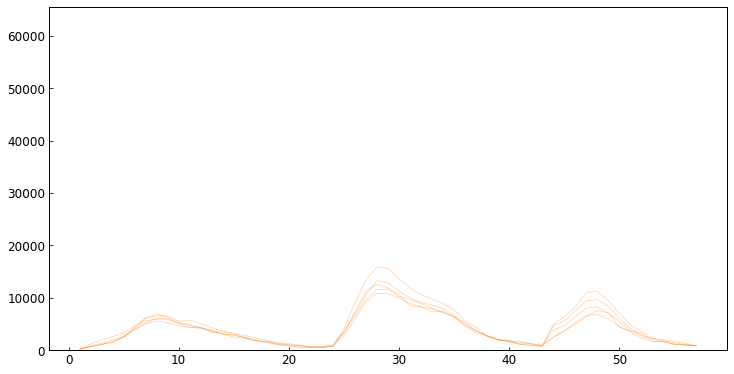

Cluster: 7


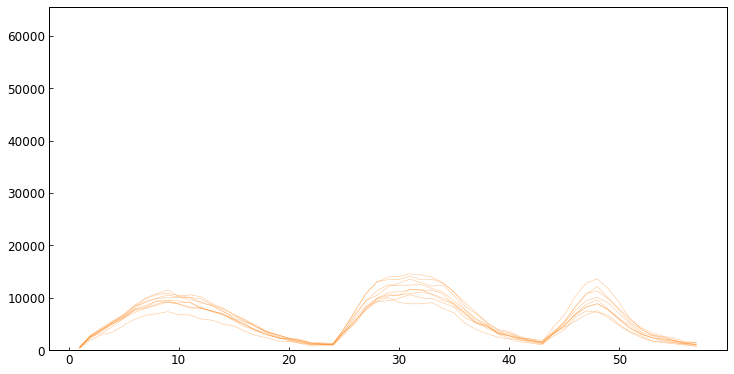

Cluster: 8


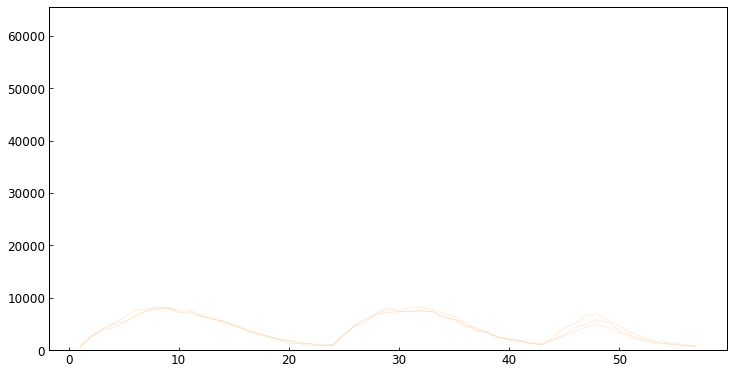

Cluster: 9


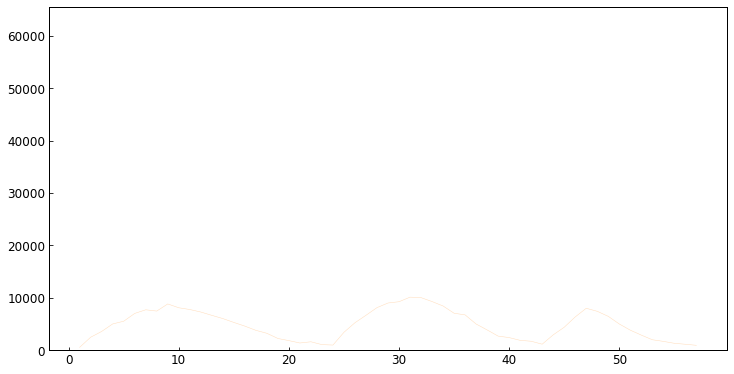

Cluster: 10


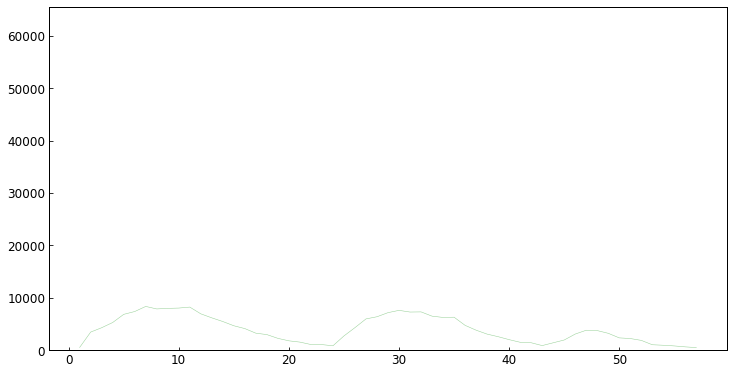

Cluster: 11


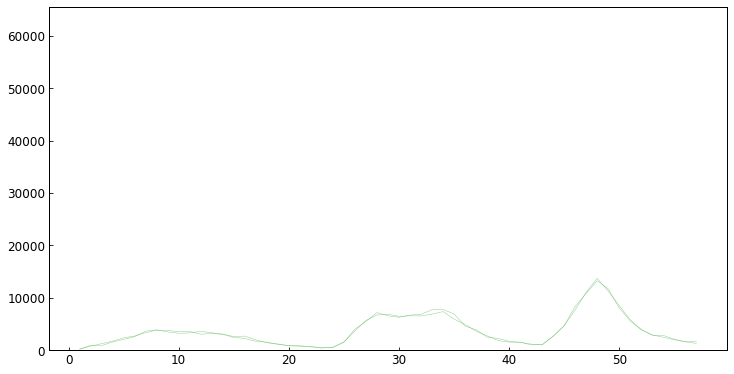

Cluster: 12


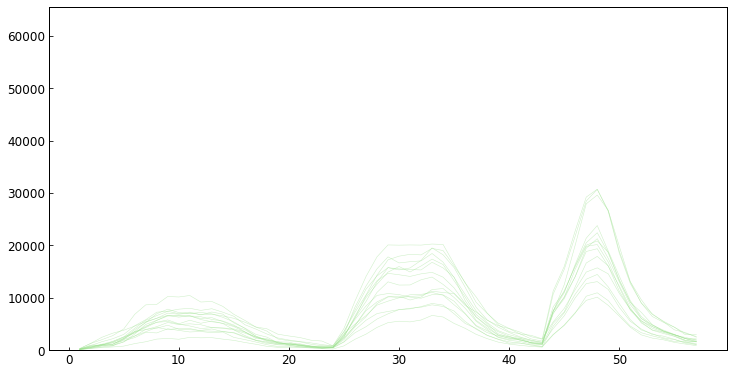

Cluster: 13


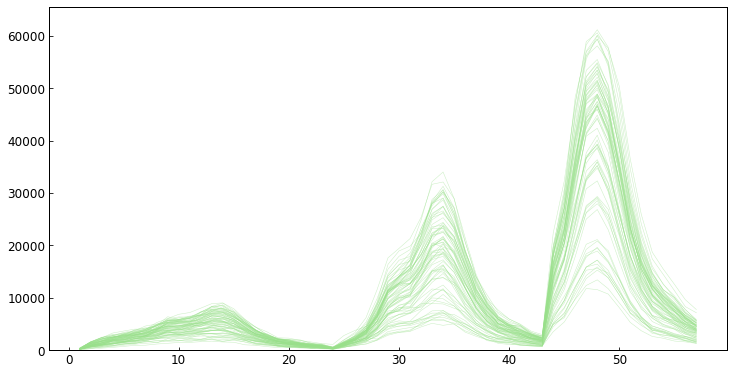

Cluster: 14


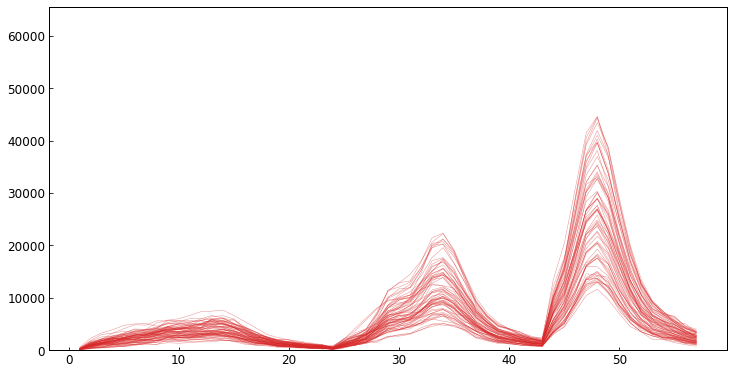

Cluster: 15


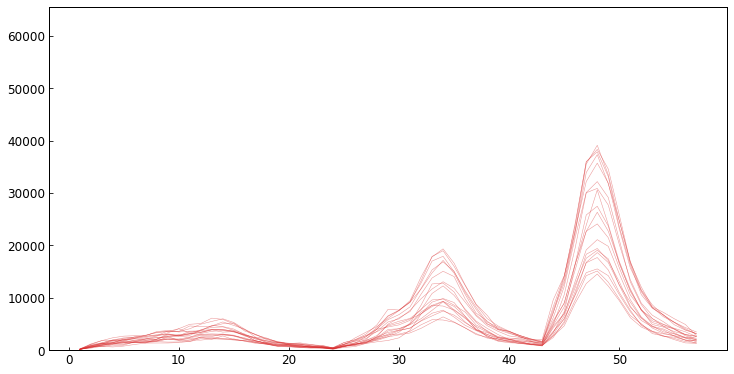

Cluster: 16


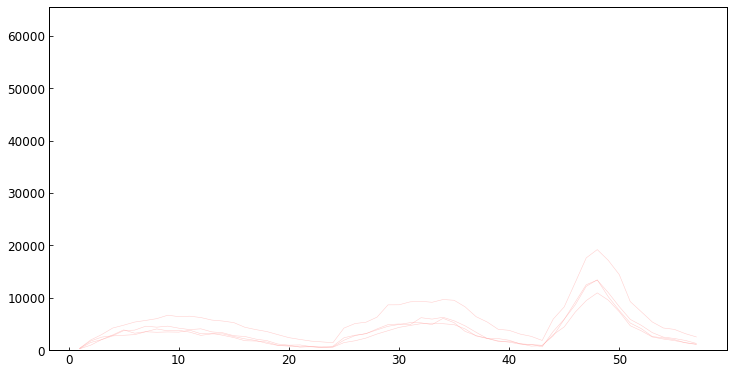

Cluster: 17


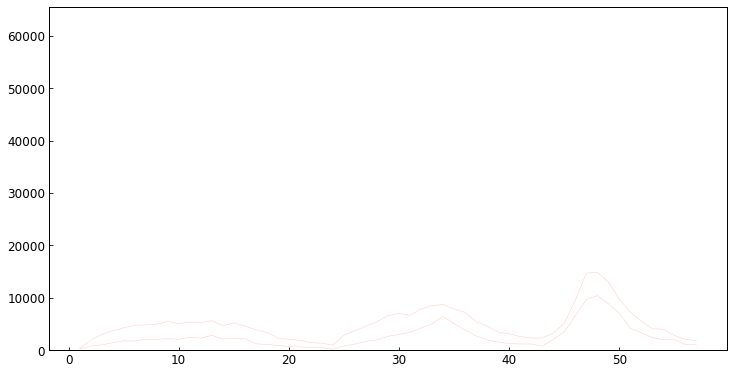

Cluster: 18


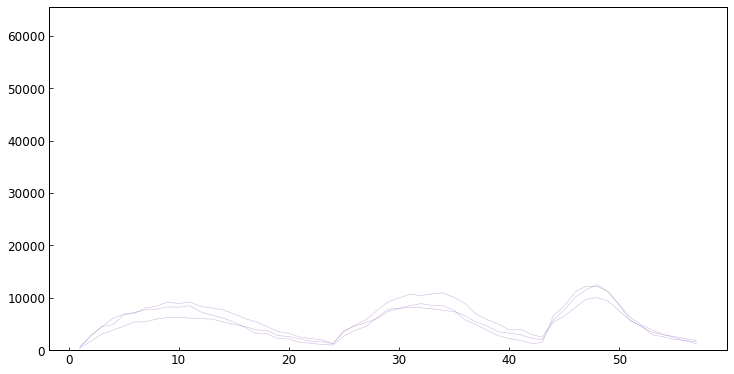

Cluster: 19


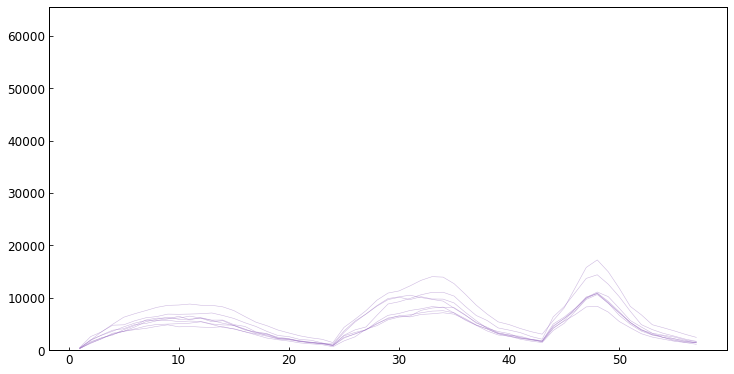

Cluster: 20


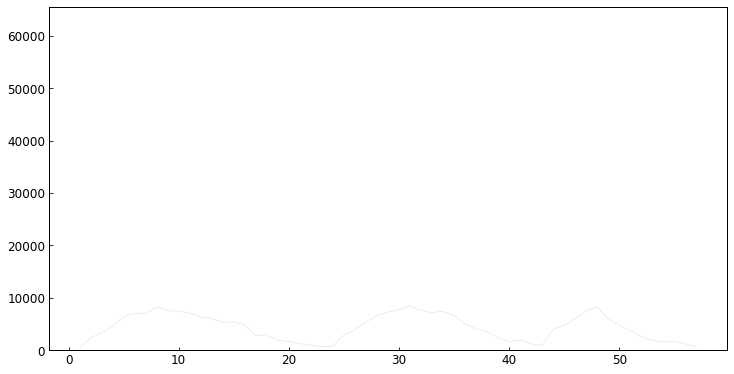

Cluster: 21


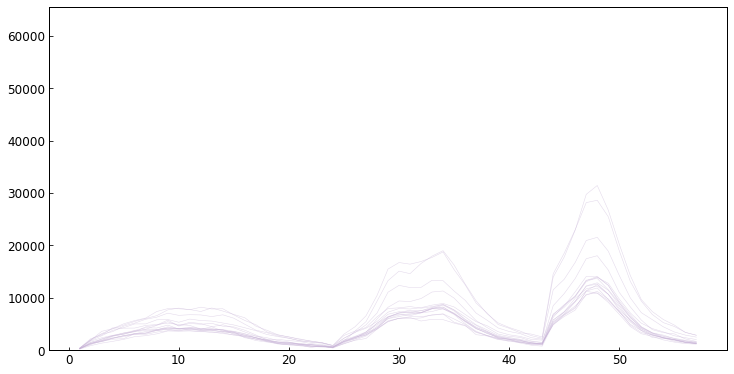

Cluster: 22


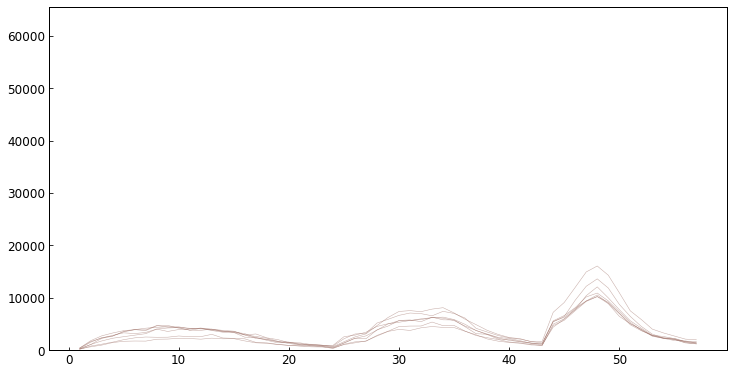

Cluster: 23


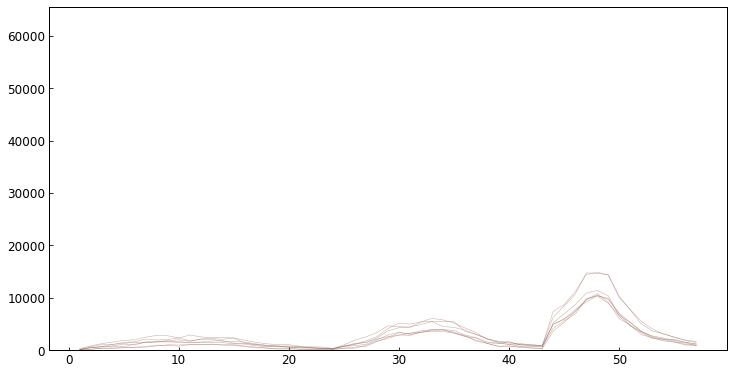

Cluster: 24


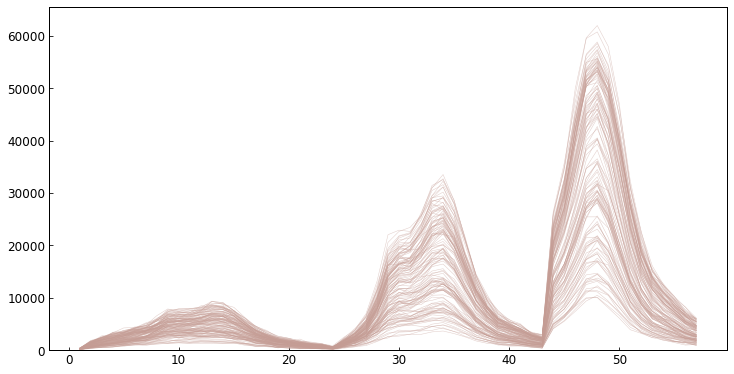

Cluster: 25


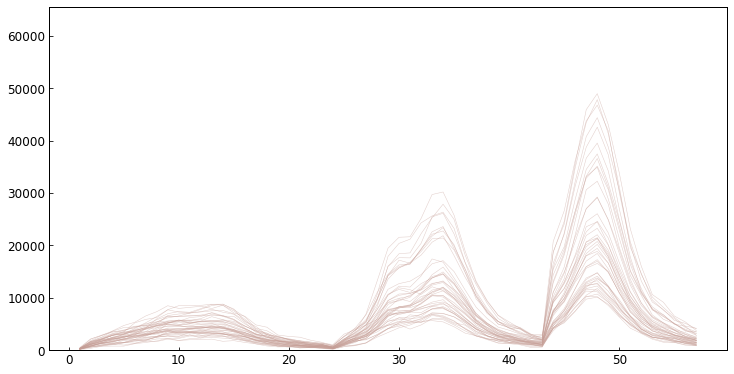

Cluster: 26


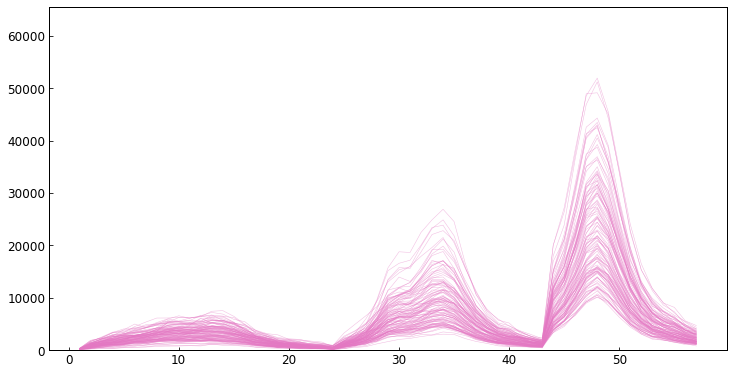

Cluster: 27


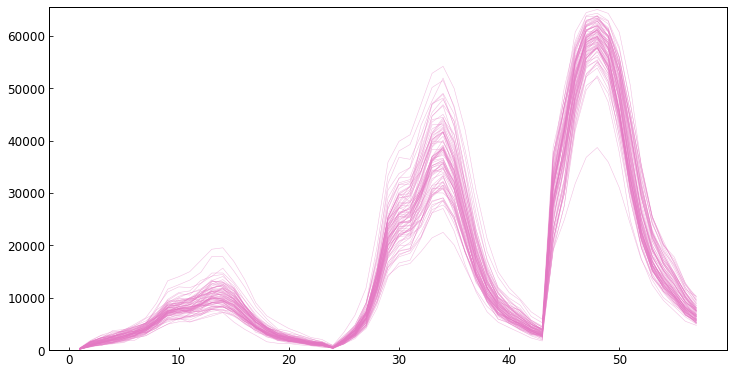

Cluster: 28


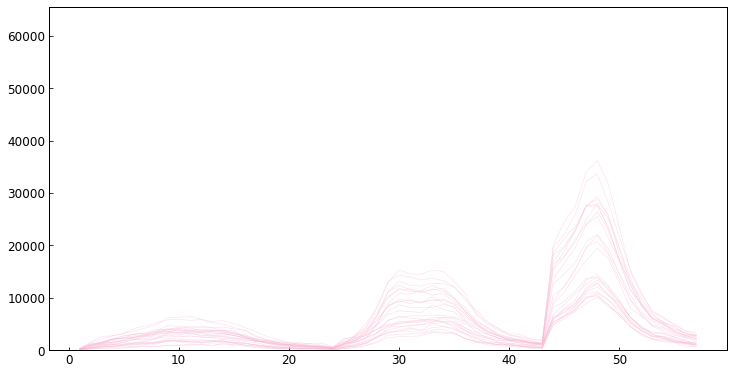

Cluster: 29


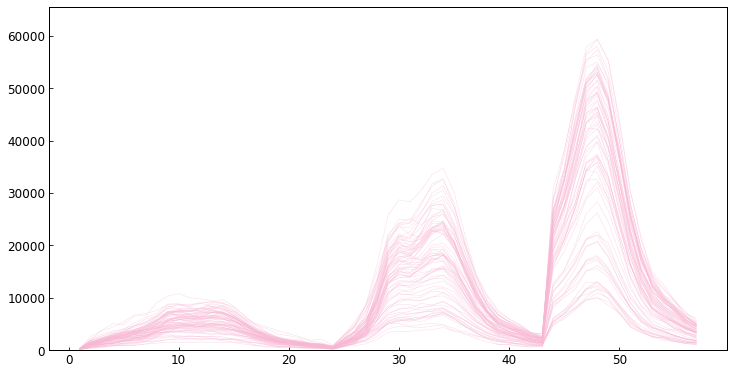

Cluster: 30


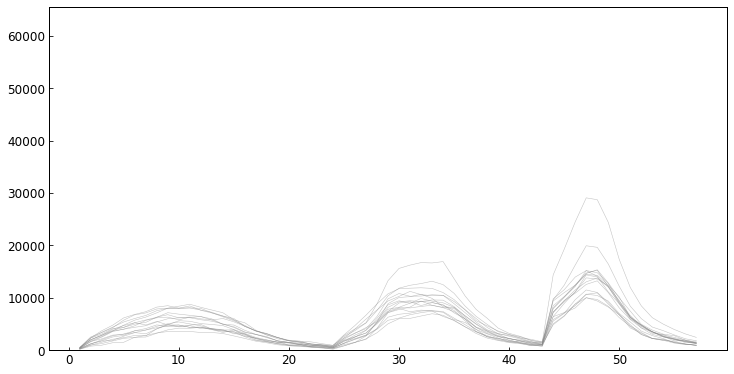

Cluster: 31


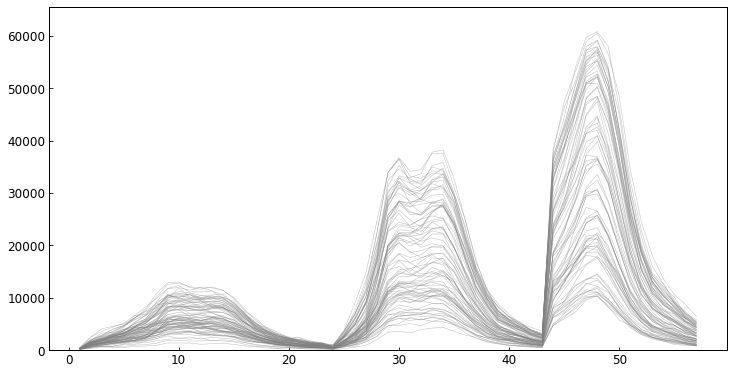

Cluster: 32


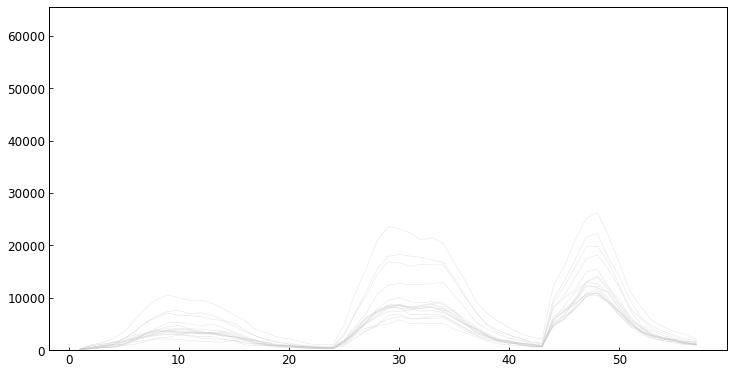

Cluster: 33


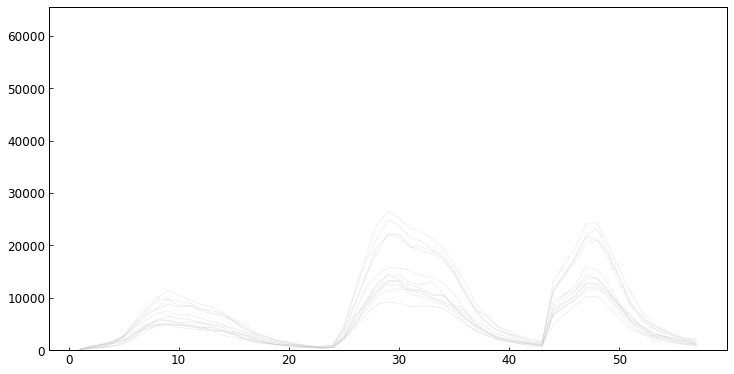

Cluster: 34


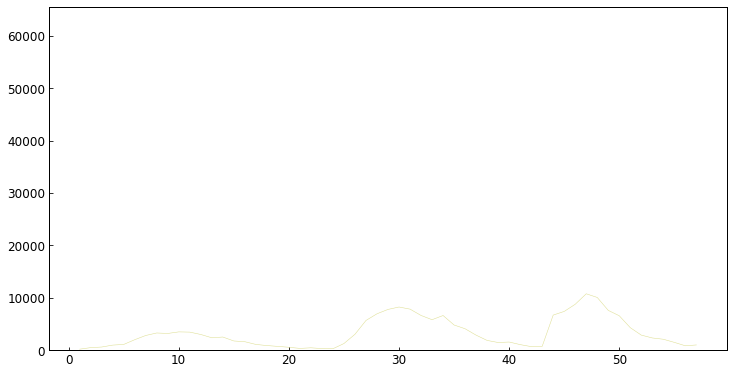

Cluster: 35


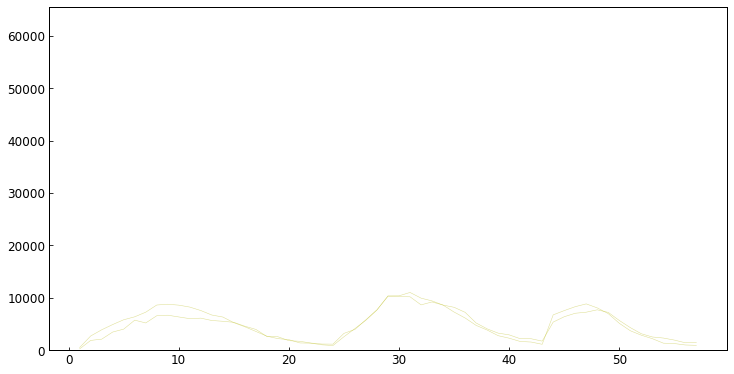

Cluster: 36


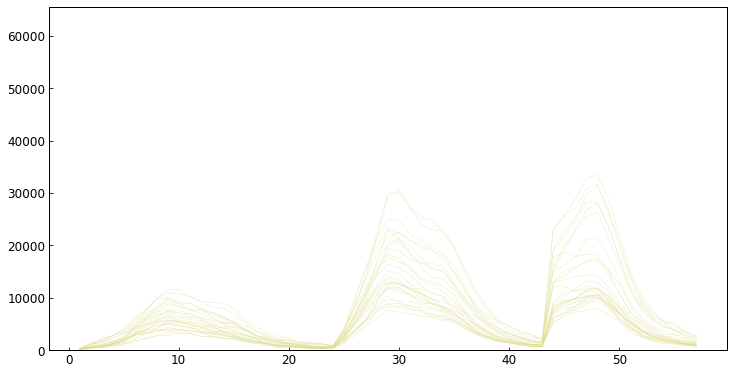

Cluster: 37


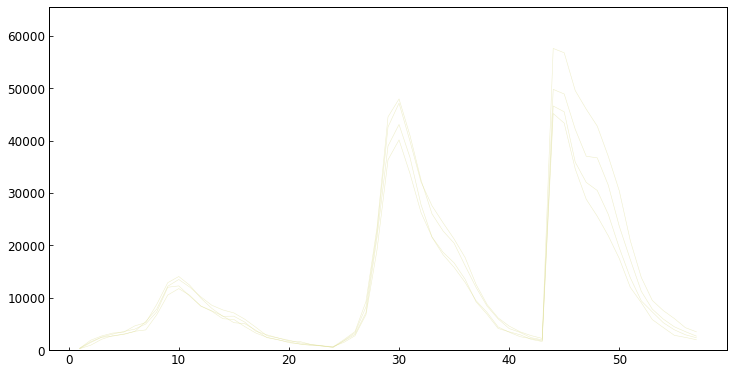

Cluster: 38


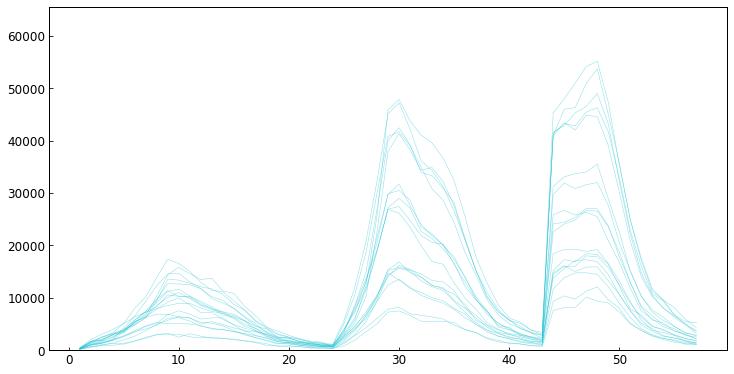

Cluster: 39


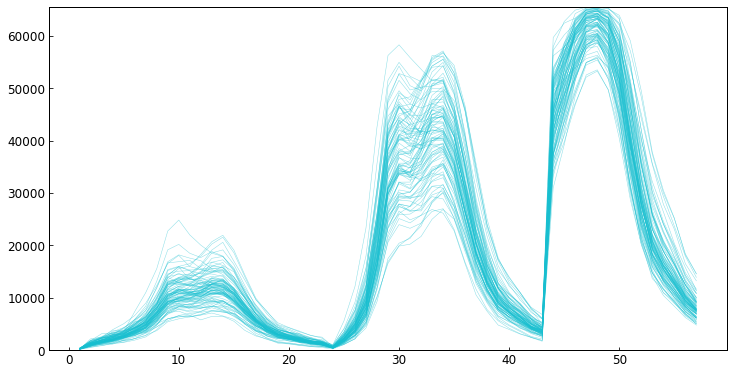

Cluster: 40


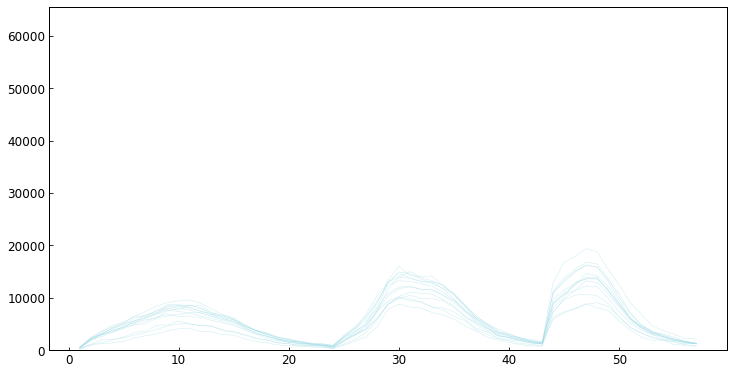

Cluster: 41


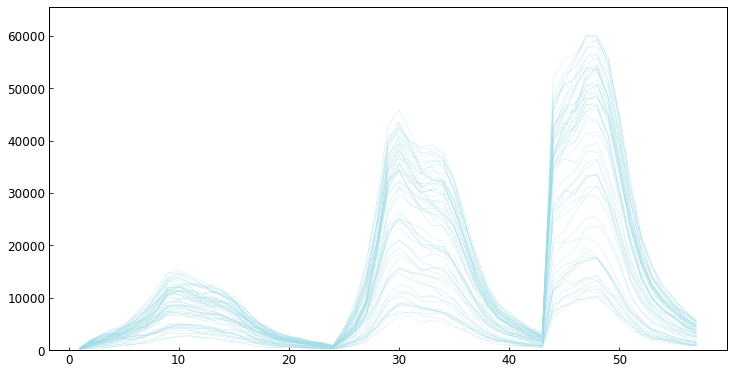

Cluster: 42


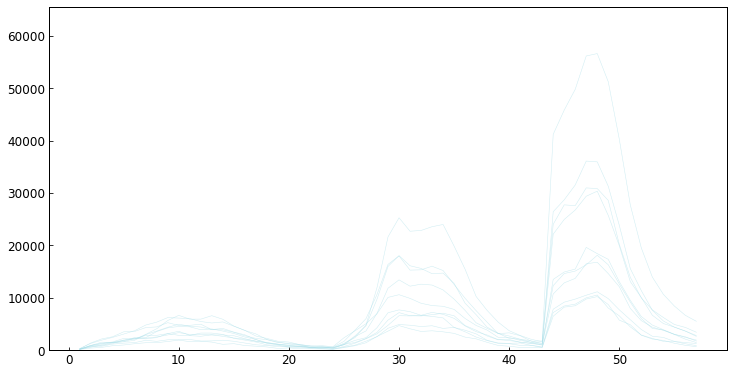

In [386]:
t = {}
clust = {}
i = 0
t[i] = 0.065

clust[i] = hierarchy.fcluster(linkage, t=t[i], criterion='distance')
clust_unique = np.unique(clust[i])
n_clust = len(clust_unique)

clust_all = clust[i]
labels = list(dict_lab_slope.keys())

dict_lab_clust = dict(zip(labels,clust_all))
colors = plt.get_cmap('tab20')(np.linspace(0,1,n_clust))
dict_clust_col = dict(zip(np.unique(clust_all), colors))

im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])
seg = segs[m]
prop = props[m]
for _, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

spec_dims = (10,5)
for c in clust_unique:
    labels_sub = np.array(labels)[clust[i] == c]
    # if len(labels_sub) > 100:
    print("Cluster:",c) 
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = np.array(dict_clust_col[c])
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.5,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()


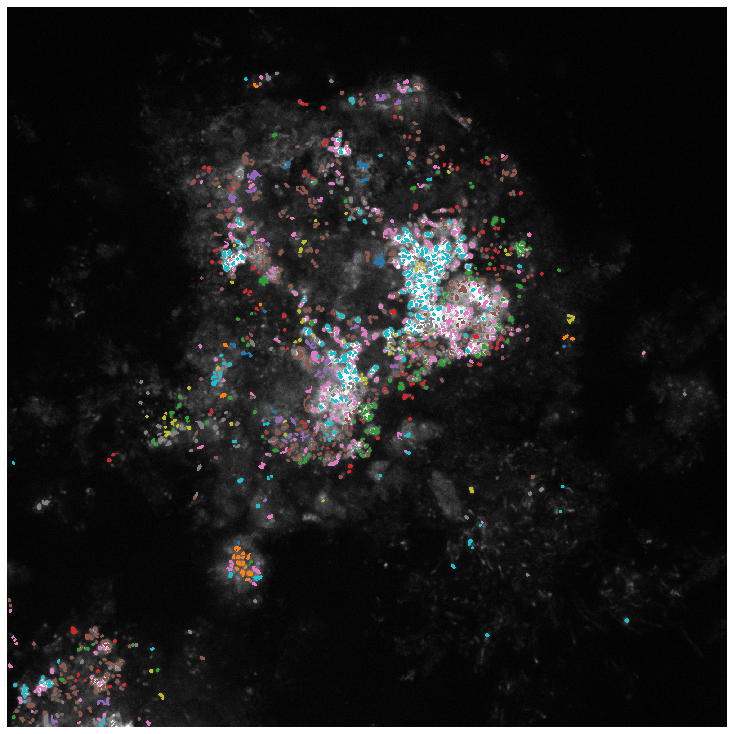

Cluster: 1


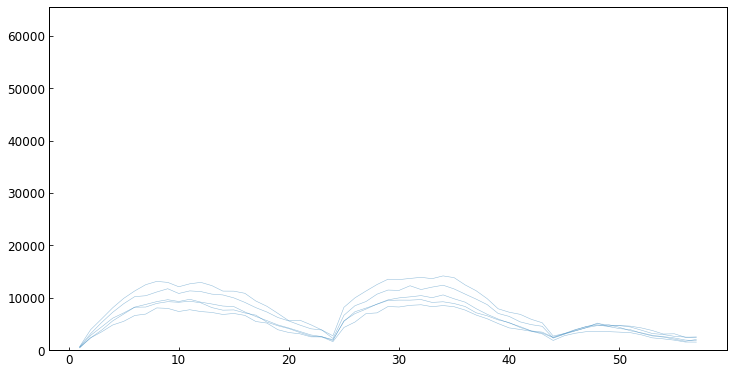

Cluster: 2


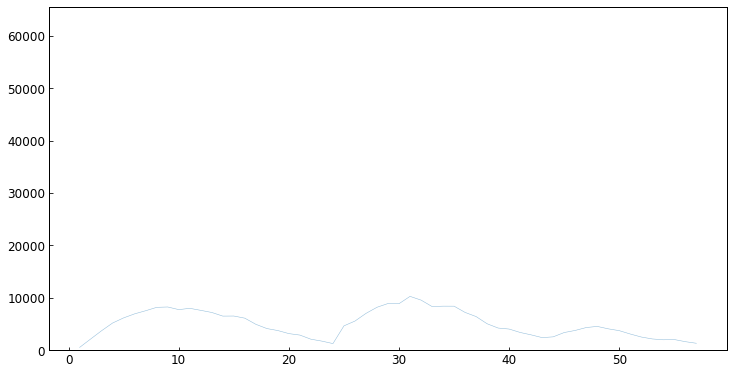

Cluster: 3


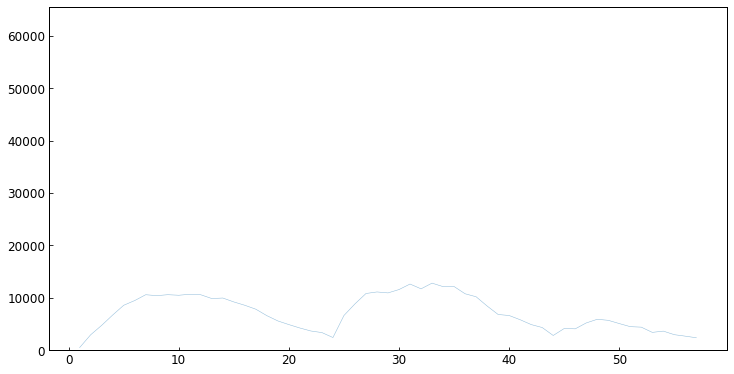

Cluster: 4


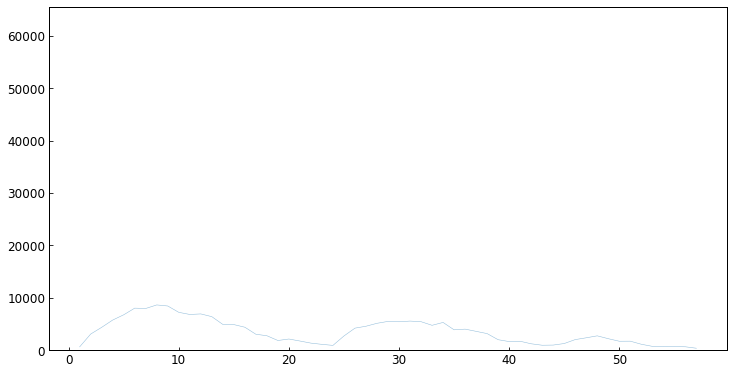

Cluster: 5


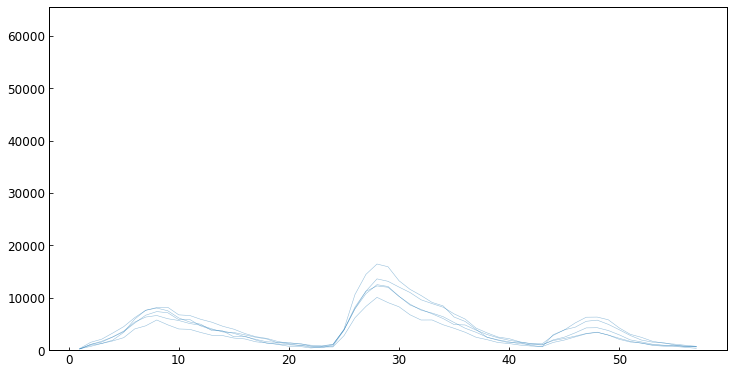

Cluster: 6


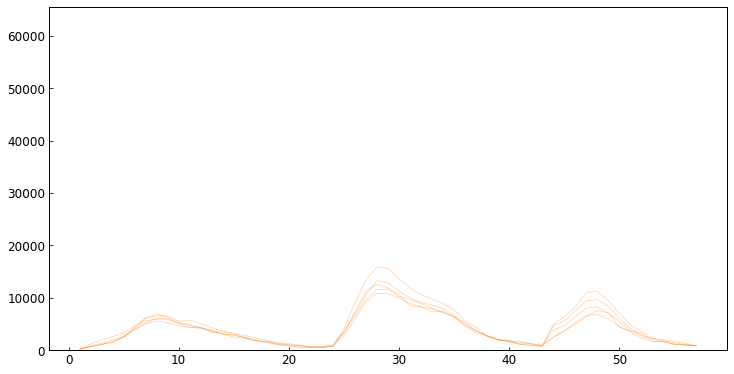

Cluster: 7


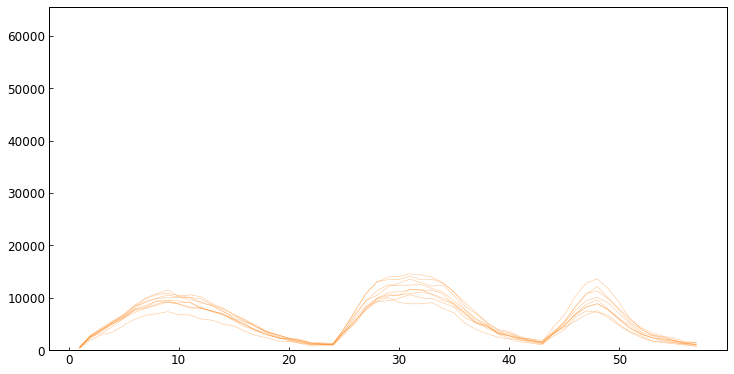

Cluster: 8


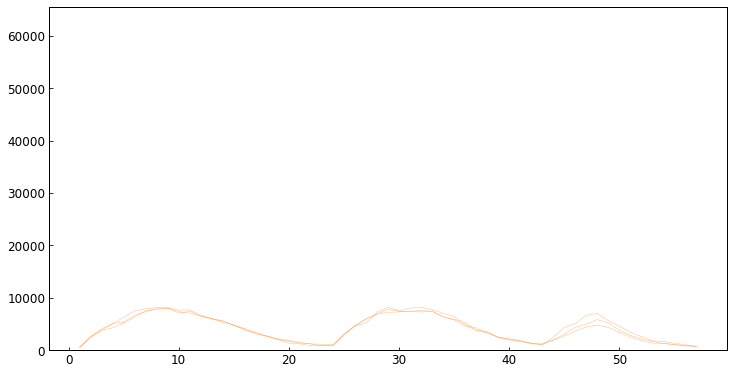

Cluster: 9


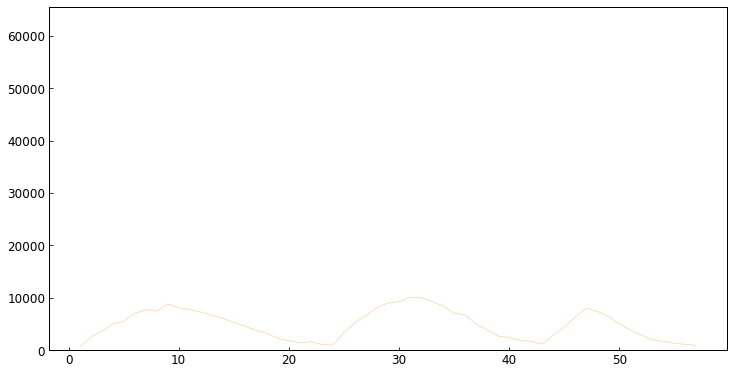

Cluster: 10


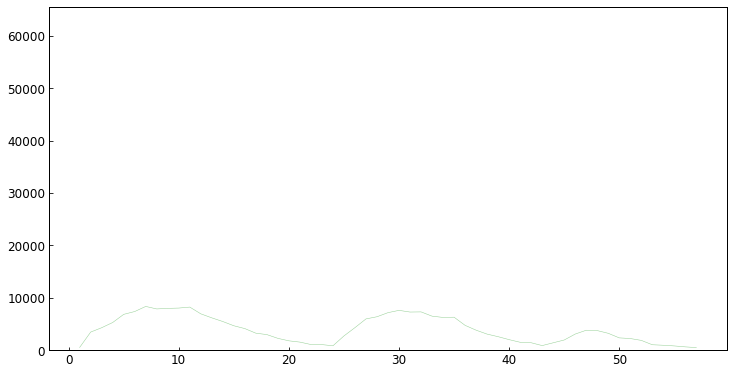

Cluster: 11


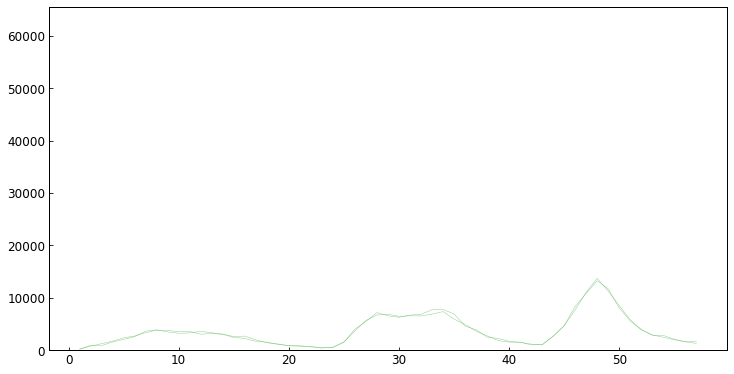

Cluster: 12


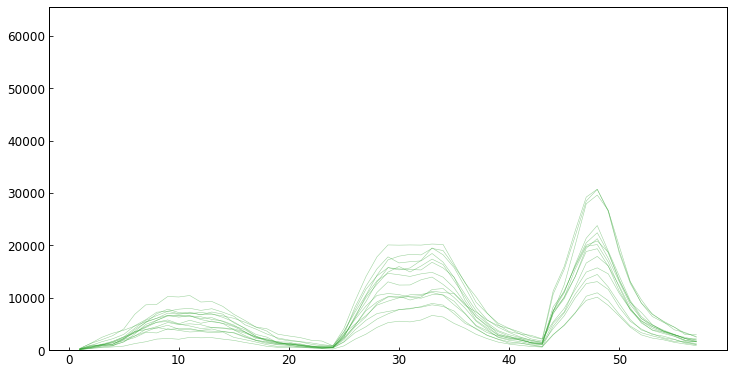

Cluster: 13


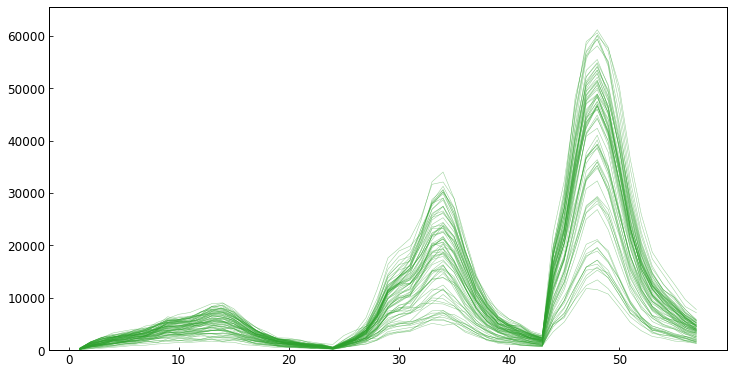

Cluster: 14


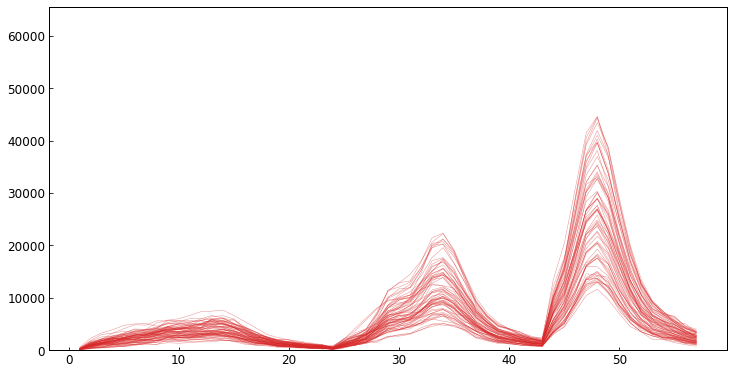

Cluster: 15


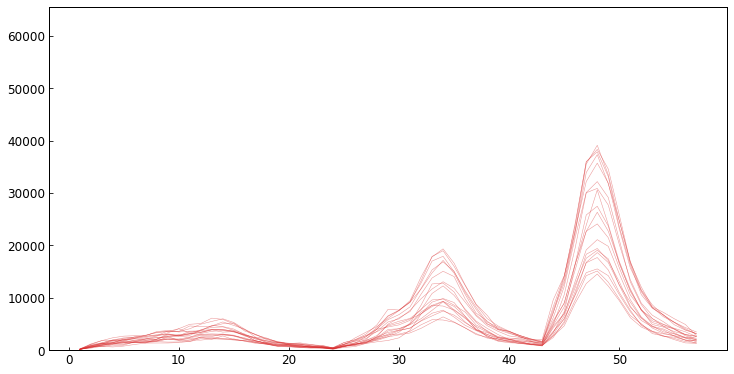

Cluster: 16


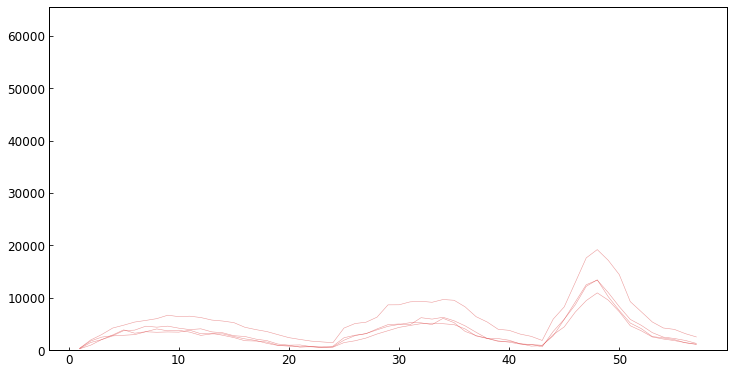

Cluster: 17


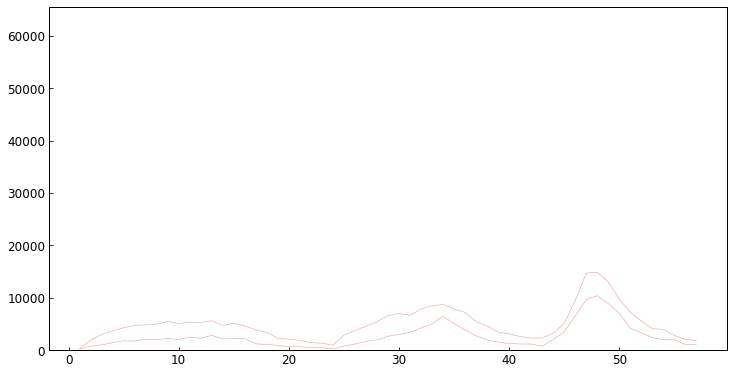

Cluster: 18


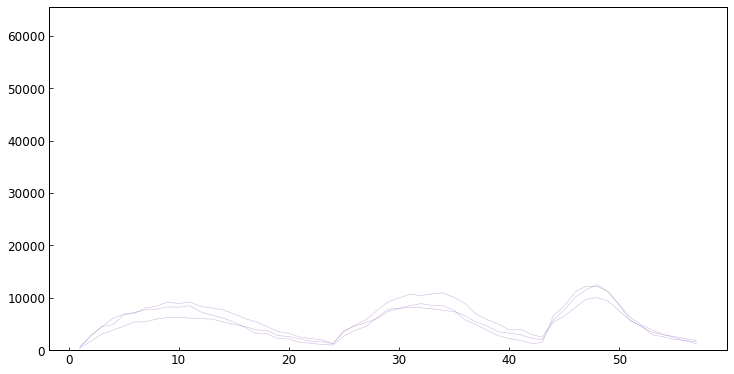

Cluster: 19


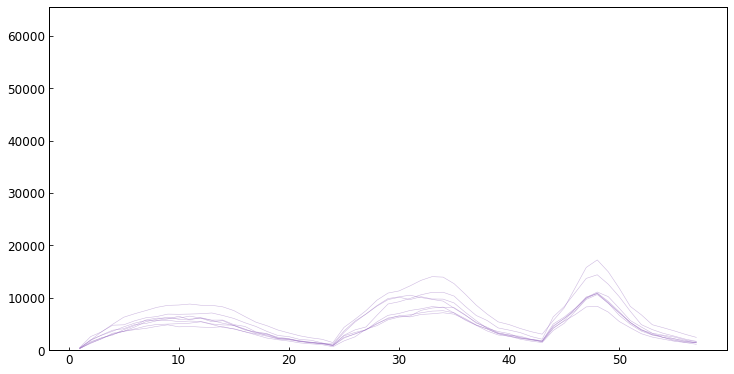

Cluster: 20


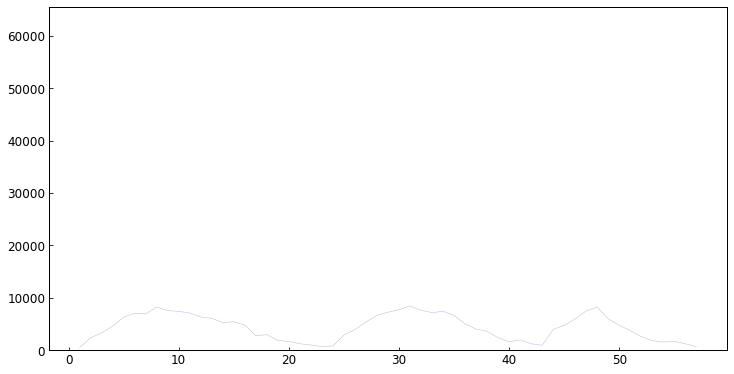

Cluster: 21


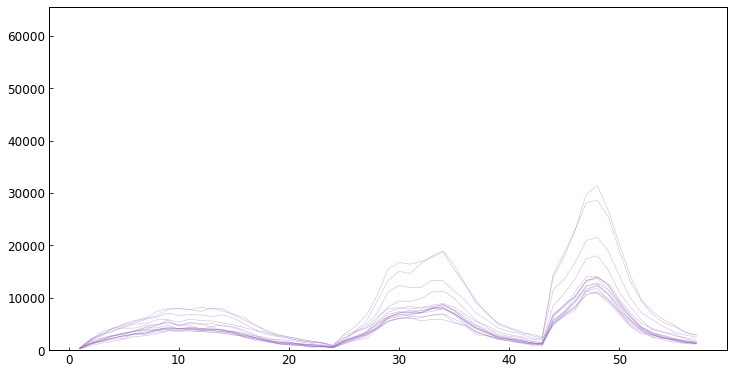

Cluster: 22


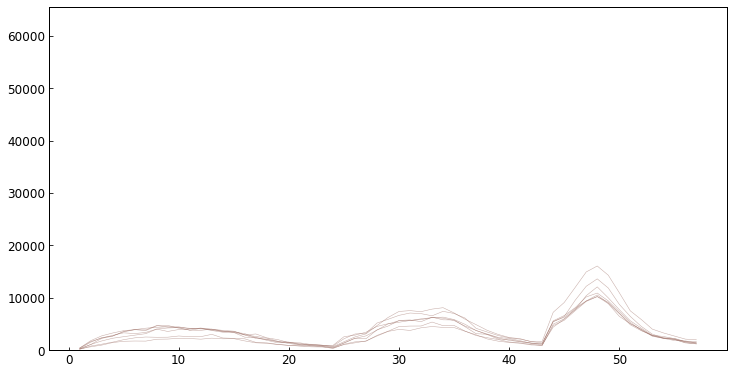

Cluster: 23


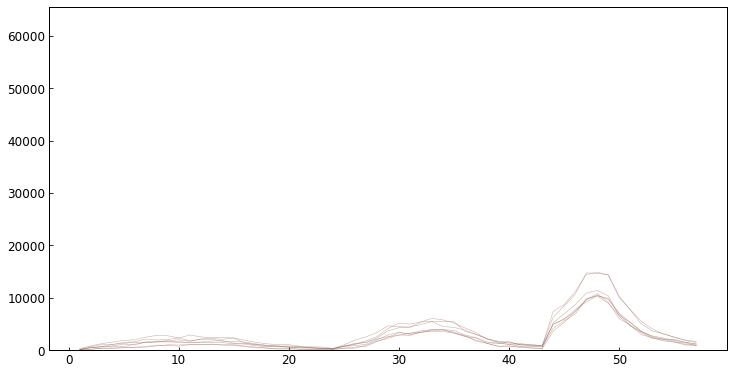

Cluster: 24


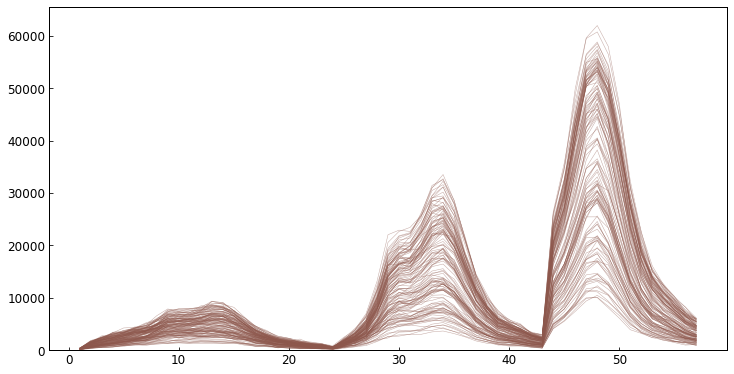

Cluster: 25


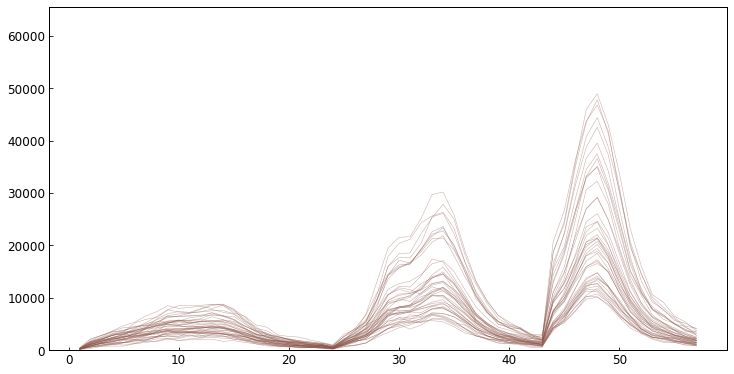

Cluster: 26


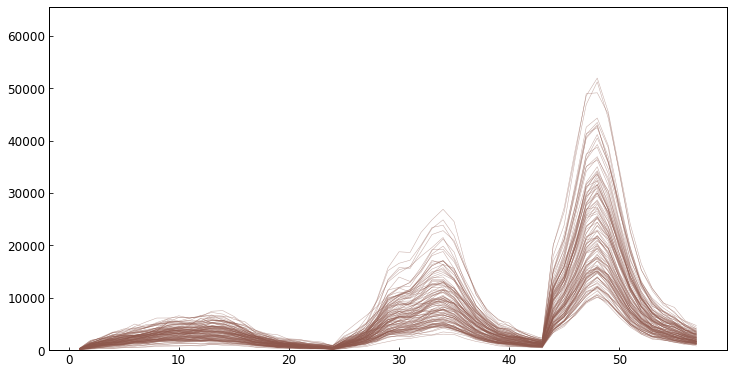

Cluster: 27


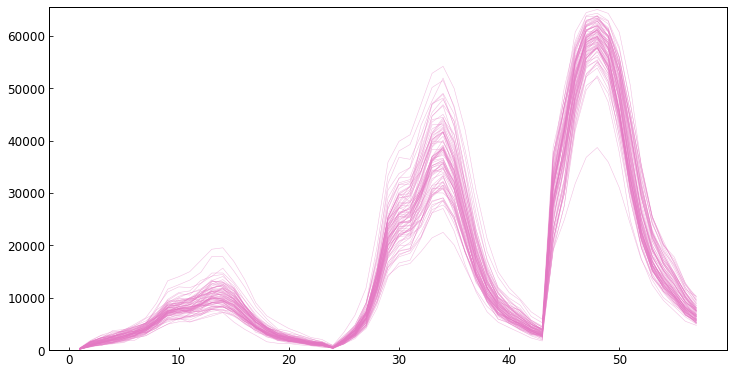

Cluster: 28


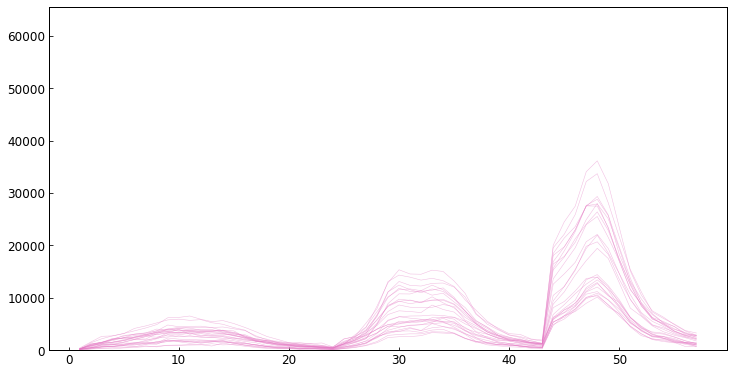

Cluster: 29


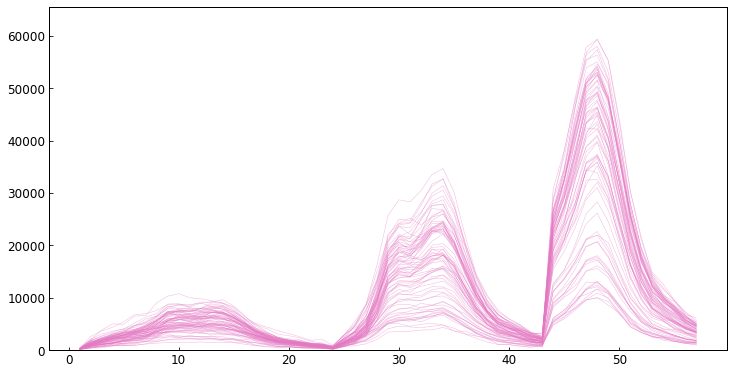

Cluster: 30


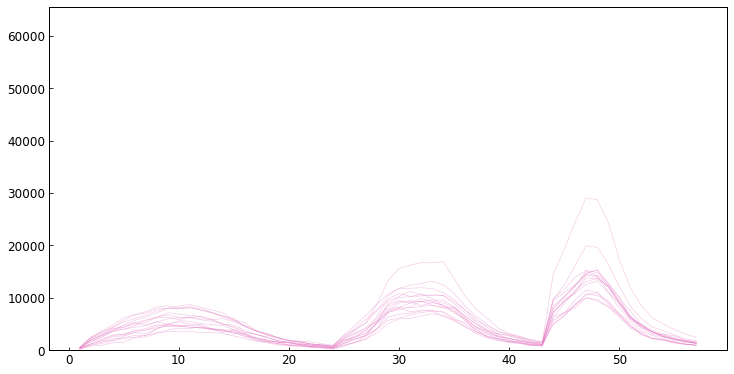

Cluster: 31


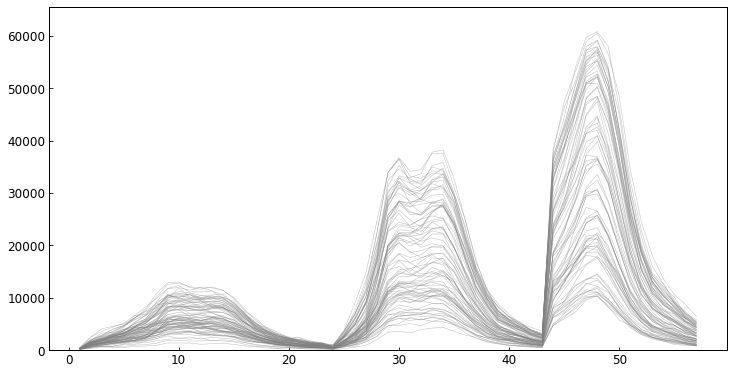

Cluster: 32


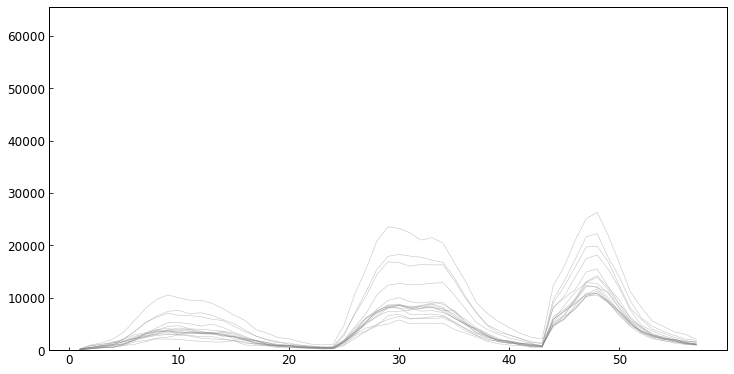

Cluster: 33


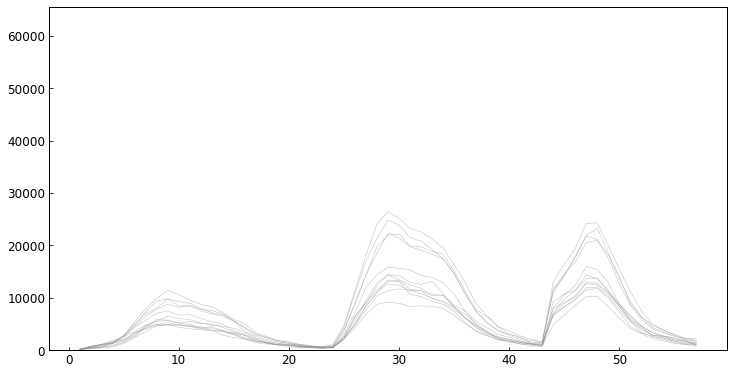

Cluster: 34


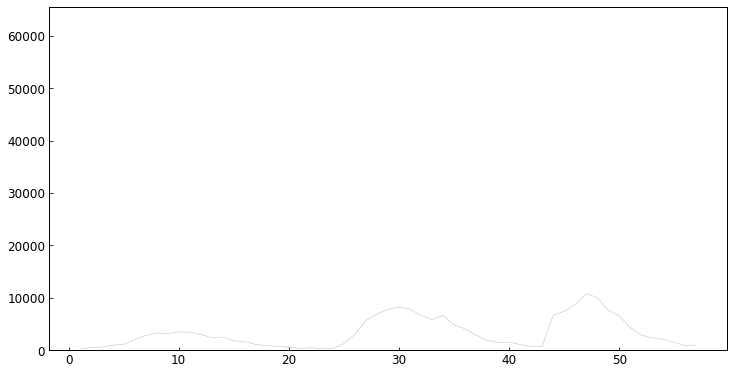

Cluster: 35


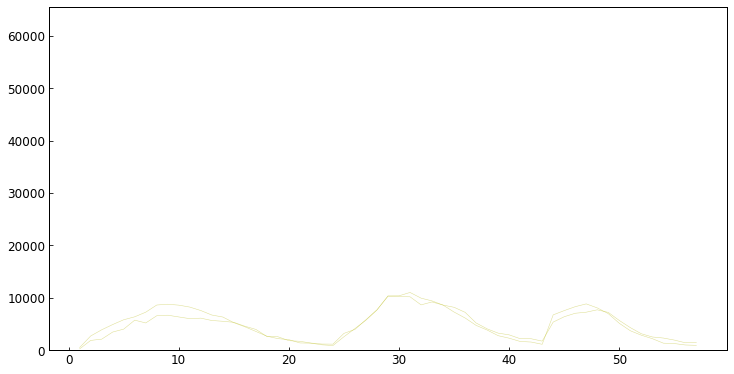

Cluster: 36


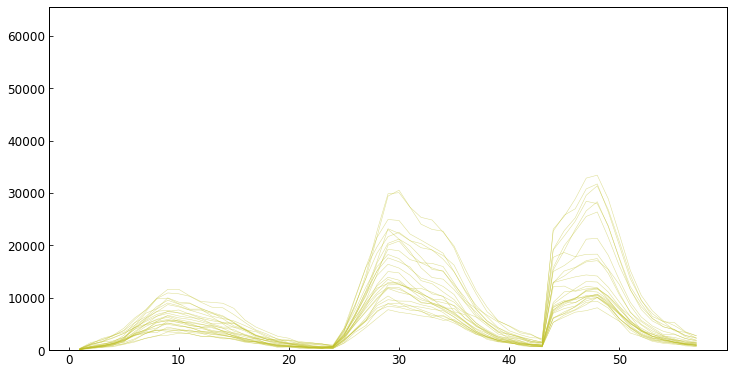

Cluster: 37


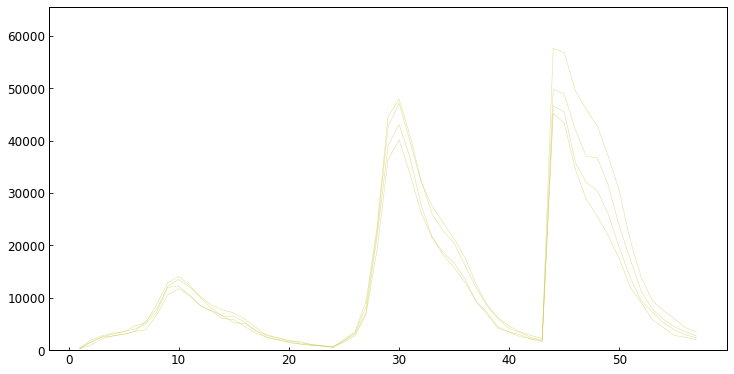

Cluster: 38


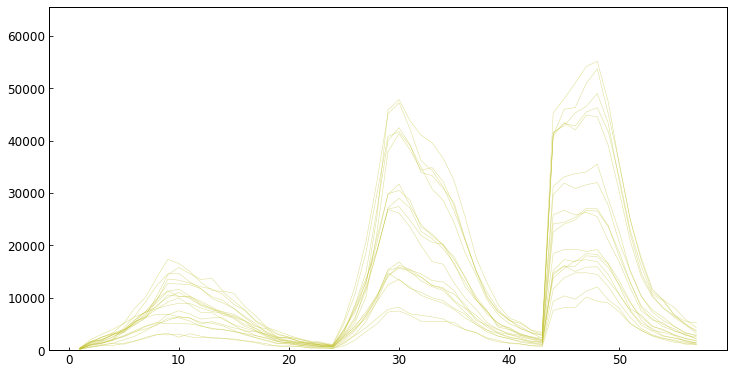

Cluster: 40


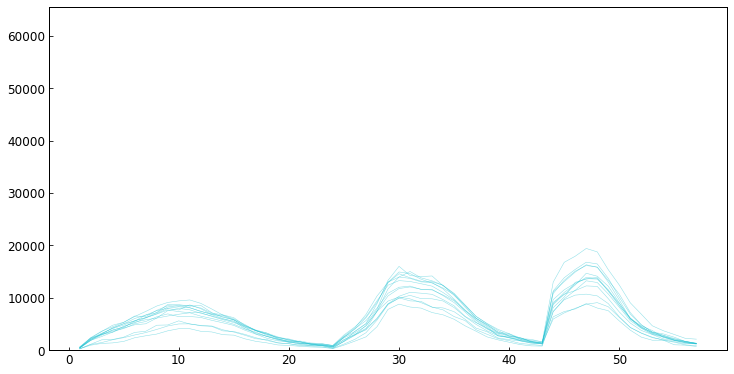

Cluster: 41


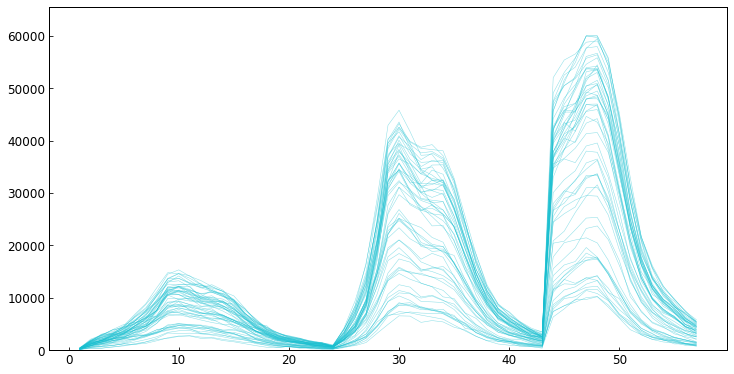

Cluster: 42


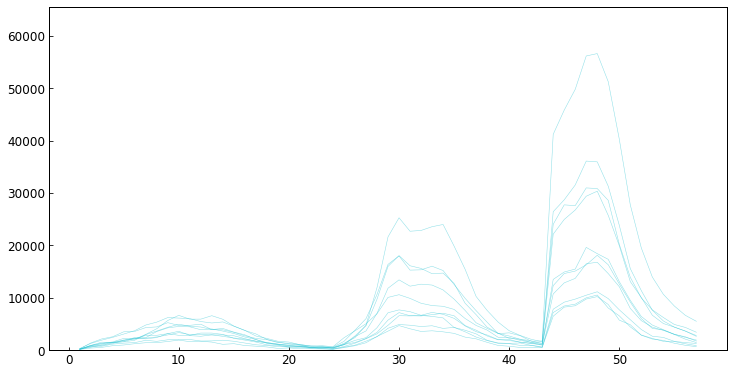

Cluster: 43
Changed from new fcluster: 58


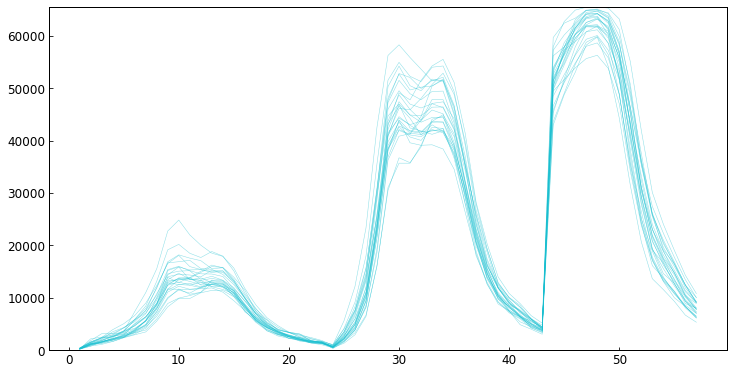

Cluster: 44
Changed from new fcluster: 59


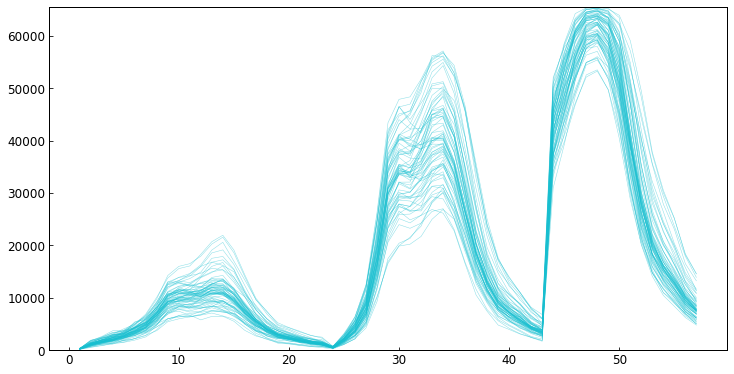

In [385]:
sub_cl = {}
i = 1
i_old = 0
sub_cl[i] = 39
t[i] = 0.050

clust[i] = hierarchy.fcluster(linkage, t=t[i], criterion='distance')
bool_subclust = clust[i_old] == sub_cl[i]
clust_change = np.unique(clust[i][bool_subclust])

clust_all_temp = clust_all.copy()
clmx = np.max(clust_all_temp)
clust_i_rename = clust_all_temp.copy()
dict_clust_change = defaultdict(dict)
for c in clust_change:
    bool_c = clust[i] == c
    clmx += 1
    dict_clust_change[i][clmx] = c
    clust_i_rename[bool_c] = clmx
clust_all_temp[bool_subclust] = clust_i_rename[bool_subclust]


clust_unique = np.unique(clust_all_temp)
n_clust = len(clust_unique)

labels = list(dict_lab_slope.keys())

dict_lab_clust = dict(zip(labels,clust_all_temp))
colors = plt.get_cmap('tab10')(np.linspace(0,1,n_clust))
dict_clust_col = dict(zip(np.unique(clust_all_temp), colors))

im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])
seg = segs[m]
prop = props[m]
for _, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)
plt.show()
plt.close()

spec_dims = (10,5)
for c in clust_unique:
    labels_sub = np.array(labels)[clust_all_temp == c]
    # if len(labels_sub) > 100:
    print("Cluster:",c) 
    try:
        print("Changed from new fcluster:",dict_clust_change[i][c]) 
    except:
        pass
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = np.array(dict_clust_col[c])
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.5,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()


In [376]:
clust_all = clust_all_temp

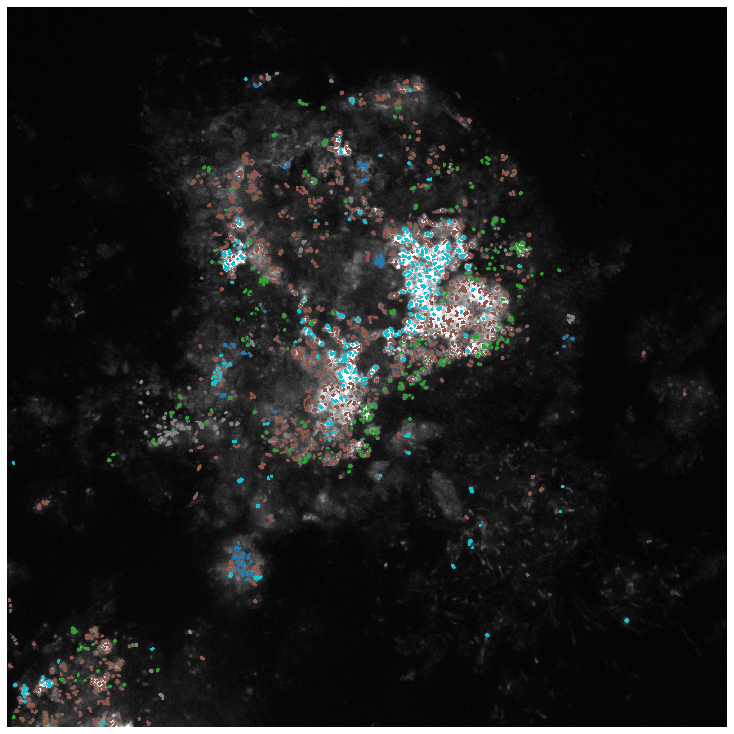

Cluster: 1


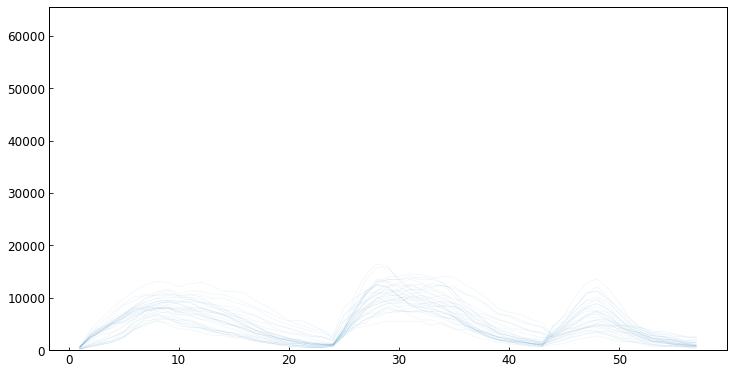

Cluster: 4


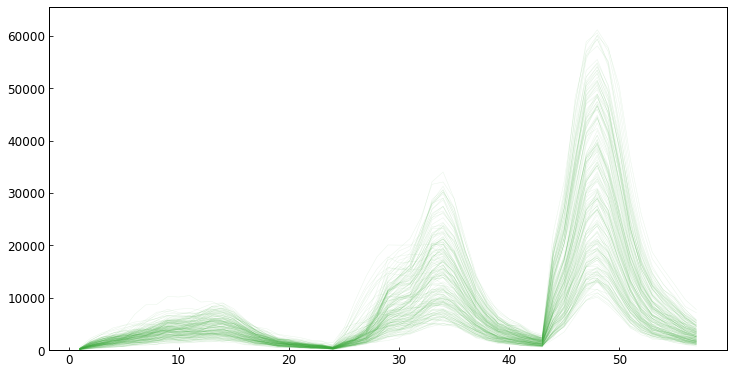

Cluster: 5


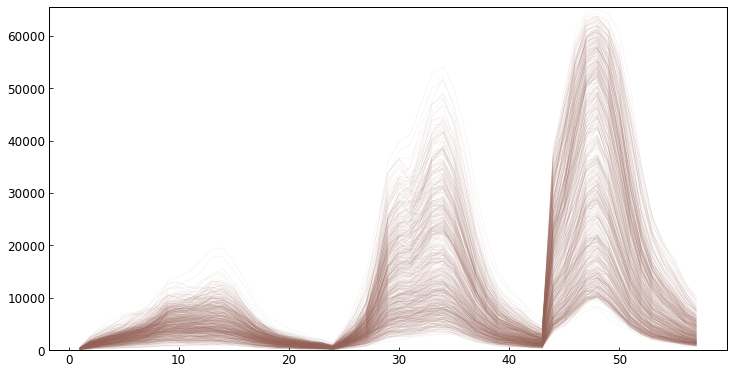

Cluster: 6
Changed from new fcluster: 5


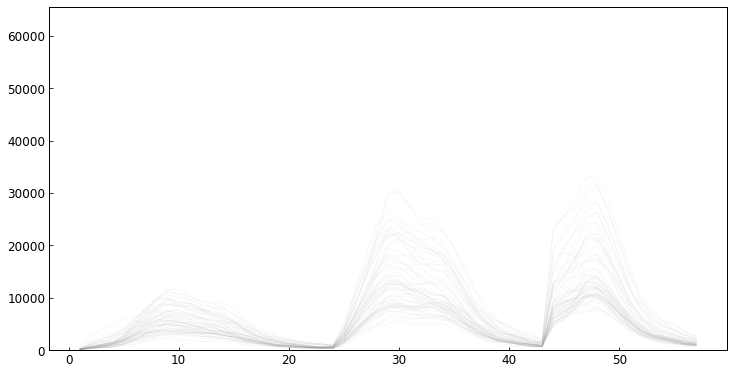

Cluster: 7
Changed from new fcluster: 6


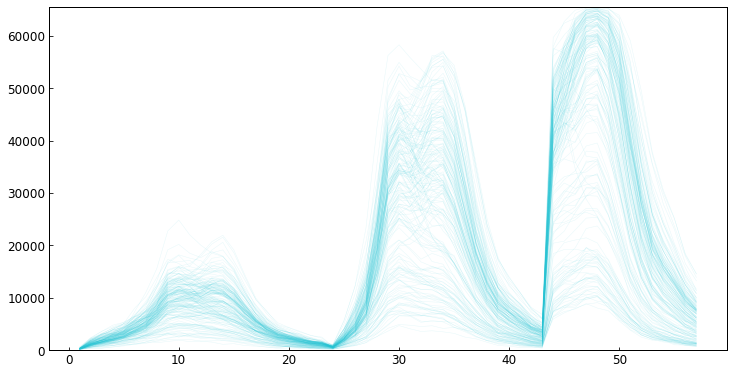

In [377]:
i = 2
i_old = 0
sub_cl[i] = 3
t[i] = 0.21

clust[i] = hierarchy.fcluster(linkage, t=t[i], criterion='distance')
bool_subclust = clust[i_old] == sub_cl[i]
clust_change = np.unique(clust[i][bool_subclust])

clust_all_temp = clust_all.copy()
clmx = np.max(clust_all_temp)
clust_i_rename = clust_all_temp.copy()
dict_clust_change = defaultdict(dict)
for c in clust_change:
    bool_c = clust[i] == c
    clmx += 1
    dict_clust_change[i][clmx] = c
    clust_i_rename[bool_c] = clmx
clust_all_temp[bool_subclust] = clust_i_rename[bool_subclust]


clust_unique = np.unique(clust_all_temp)
n_clust = len(clust_unique)

labels = list(dict_lab_slope.keys())

dict_lab_clust = dict(zip(labels,clust_all_temp))
colors = plt.get_cmap('tab10')(np.linspace(0,1,n_clust))
dict_clust_col = dict(zip(np.unique(clust_all_temp), colors))

im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])
seg = segs[m]
prop = props[m]
for _, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)
plt.show()
plt.close()

spec_dims = (10,5)
for c in clust_unique:
    labels_sub = np.array(labels)[clust_all_temp == c]
    # if len(labels_sub) > 100:
    print("Cluster:",c) 
    try:
        print("Changed from new fcluster:",dict_clust_change[i][c]) 
    except:
        pass
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = np.array(dict_clust_col[c])
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.1,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()


In [378]:
clust_all = clust_all_temp

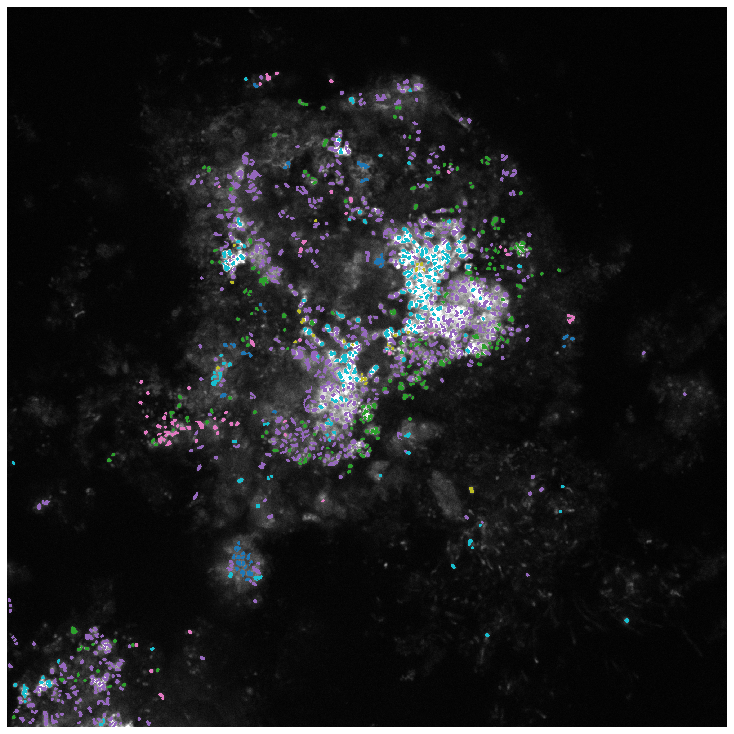

Cluster: 1


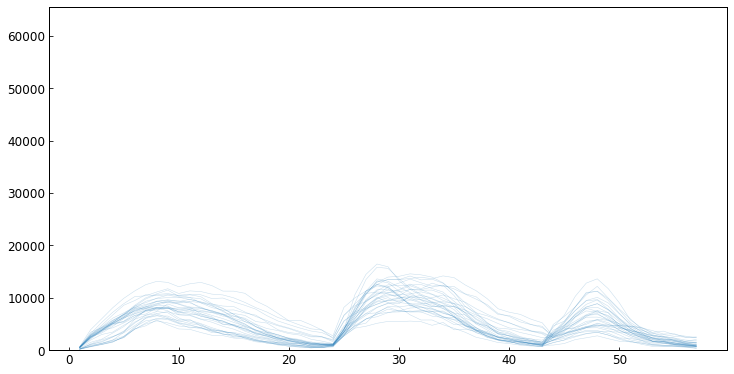

Cluster: 4


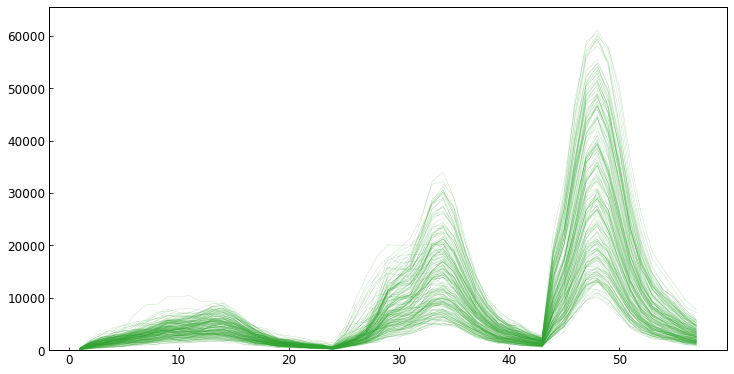

Cluster: 5


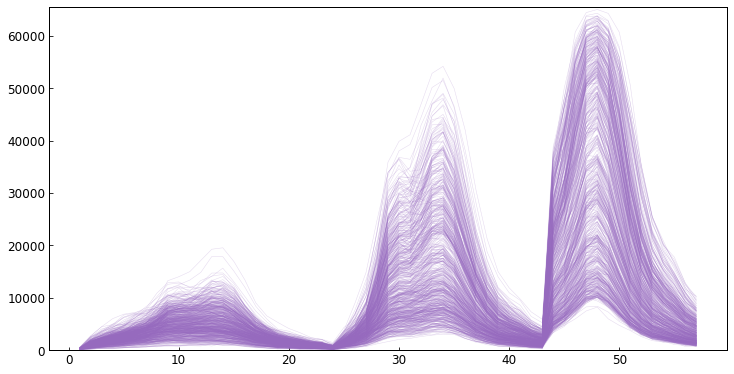

Cluster: 6


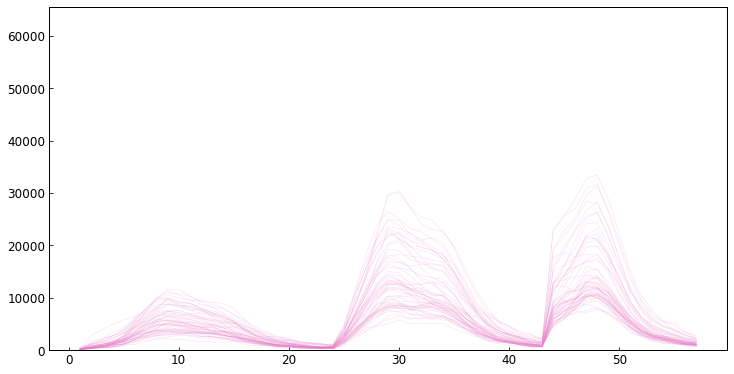

Cluster: 8
Changed from new fcluster: 11


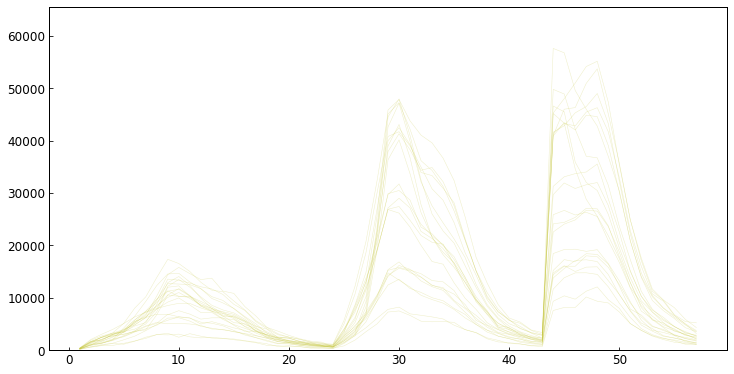

Cluster: 9
Changed from new fcluster: 12


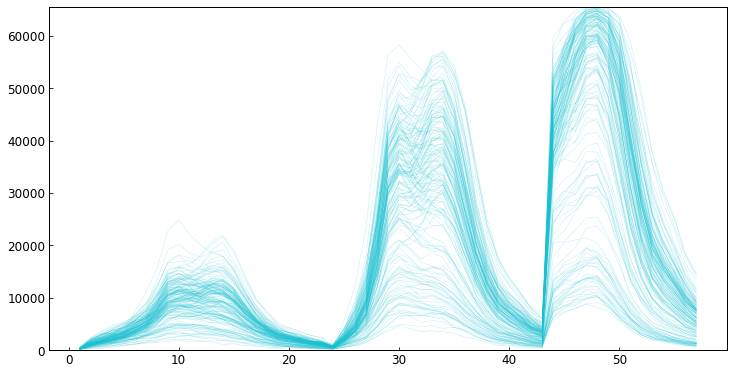

In [380]:
i = 3
i_old = 1
sub_cl[i] = 6
t[i] = 0.14

clust[i] = hierarchy.fcluster(linkage, t=t[i], criterion='distance')
bool_subclust = clust[i_old] == sub_cl[i]
clust_change = np.unique(clust[i][bool_subclust])

clust_all_temp = clust_all.copy()
clmx = np.max(clust_all_temp)
clust_i_rename = clust_all_temp.copy()
dict_clust_change = defaultdict(dict)
for c in clust_change:
    bool_c = clust[i] == c
    clmx += 1
    dict_clust_change[i][clmx] = c
    clust_i_rename[bool_c] = clmx
clust_all_temp[bool_subclust] = clust_i_rename[bool_subclust]


clust_unique = np.unique(clust_all_temp)
n_clust = len(clust_unique)

labels = list(dict_lab_slope.keys())

dict_lab_clust = dict(zip(labels,clust_all_temp))
colors = plt.get_cmap('tab10')(np.linspace(0,1,n_clust))
dict_clust_col = dict(zip(np.unique(clust_all_temp), colors))

im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])
seg = segs[m]
prop = props[m]
for _, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)
plt.show()
plt.close()

spec_dims = (10,5)
for c in clust_unique:
    labels_sub = np.array(labels)[clust_all_temp == c]
    # if len(labels_sub) > 100:
    print("Cluster:",c) 
    try:
        print("Changed from new fcluster:",dict_clust_change[i][c]) 
    except:
        pass
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = np.array(dict_clust_col[c])
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.25,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()


In [ ]:
clust_change = []

clmx = np.max(clust_all)
clust_i_rename = clust_all.copy()
for c in clust_change:
    bool_c = clust[i] == c
    clmx += 1
    clust_i_rename[bool_c] = clmx

np.unique(clust_i_rename[bool_subclust])

clust_all[bool_subclust] = clust_i_rename[bool_subclust]

### Remove clusters

In [561]:
ignore = [9]
clust_trim = clust_all.copy()
for c in ignore:
    bool_c = clust_all == c
    clust_trim[bool_c] = 0

In [562]:
dict_lab_clust = dict(zip(labels,clust_trim))
# colors = plt.get_cmap('tab10').colors
# dict_clust_col = dict(zip(np.unique(clust_trim)[1:], colors))

In [563]:
im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
im_rgb = np.dstack([im_rgb, np.ones(im_rgb.shape[:2])])

for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        cl = dict_lab_clust[l]
        if cl:
            color = np.array(dict_clust_col[cl])
            b = eval(b) if isinstance(b, str) else b
            rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
            seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
            im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
            rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*4)
            # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]        
            rgb_cell = seg_sub[:,:,None] * color[None,:]
            im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

(<Figure size 720x719.64 with 1 Axes>, <Axes:>, [[], []])

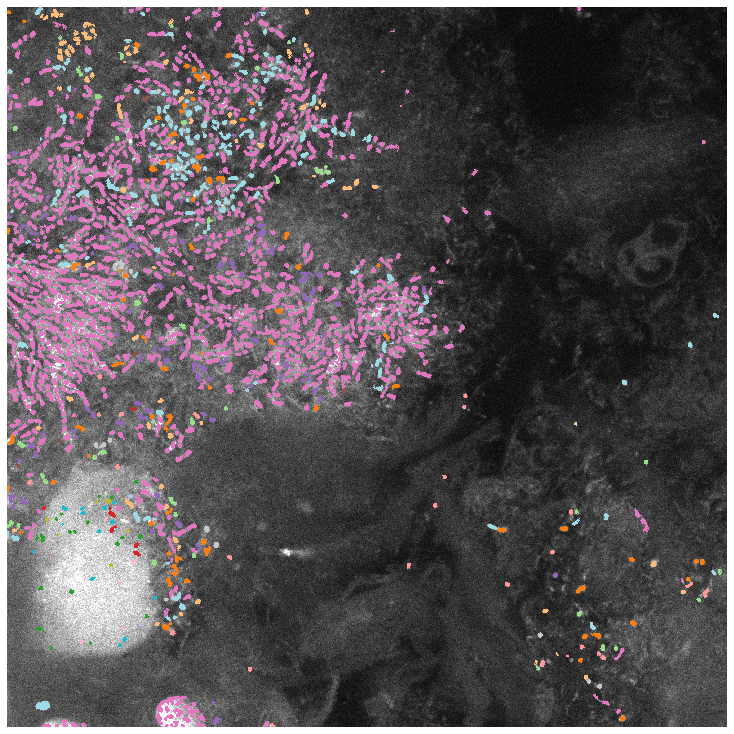

In [564]:
ip.plot_image(im_rgb, im_inches=10)

Cluster: 1


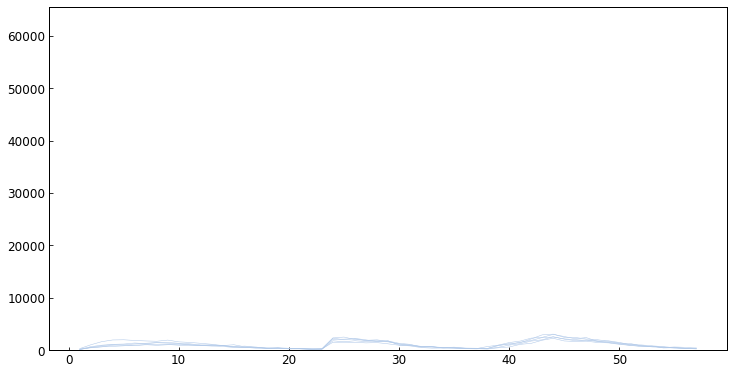

Cluster: 2


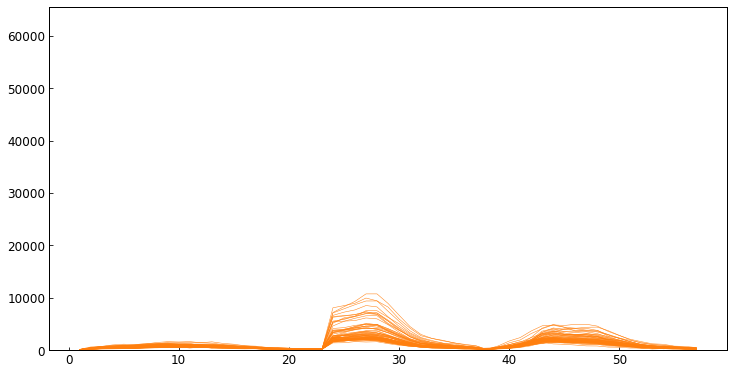

Cluster: 3


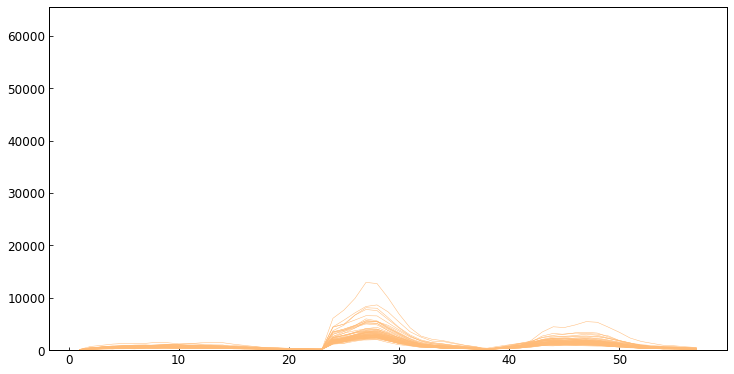

Cluster: 4


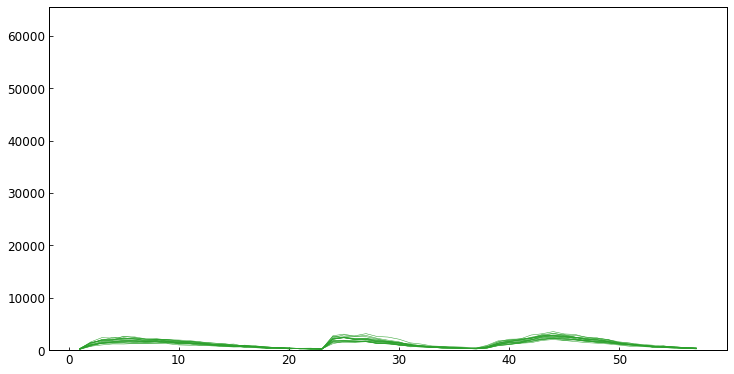

Cluster: 5


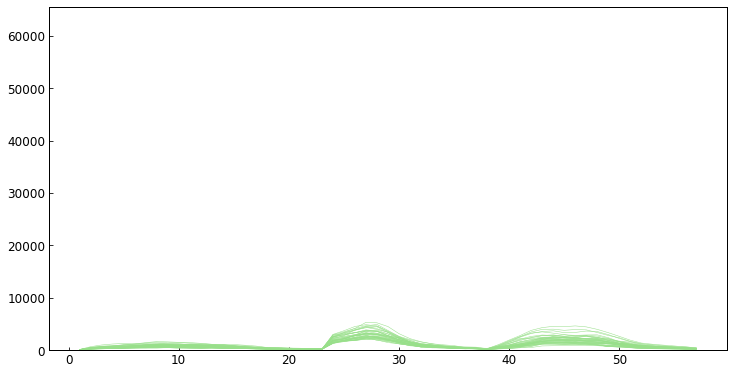

Cluster: 6


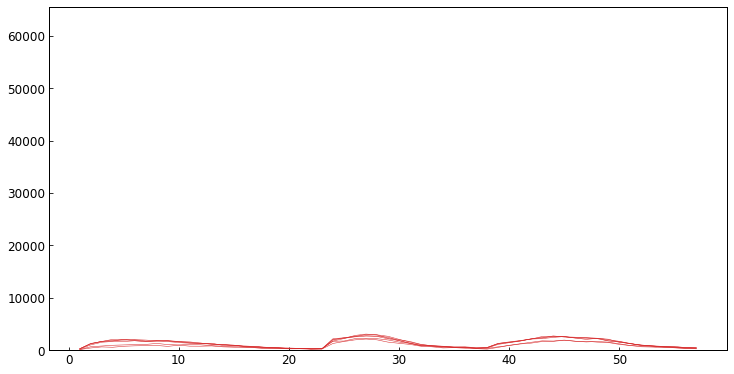

Cluster: 7


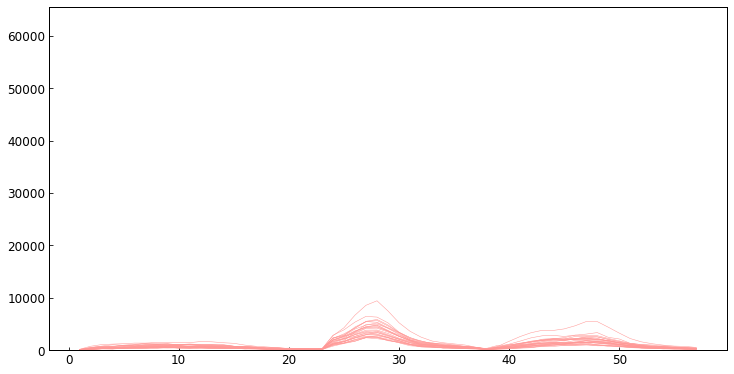

Cluster: 8


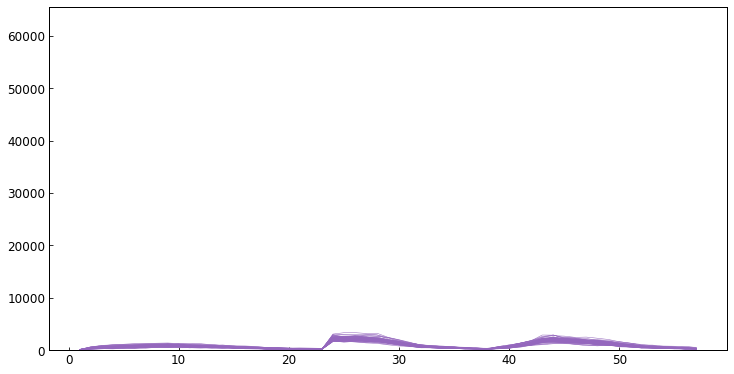

Cluster: 10


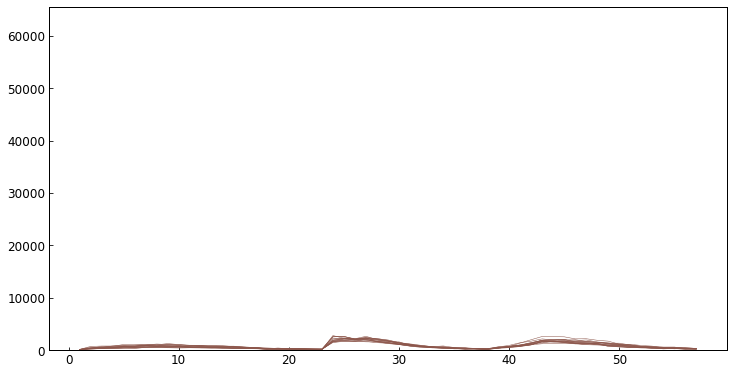

Cluster: 11


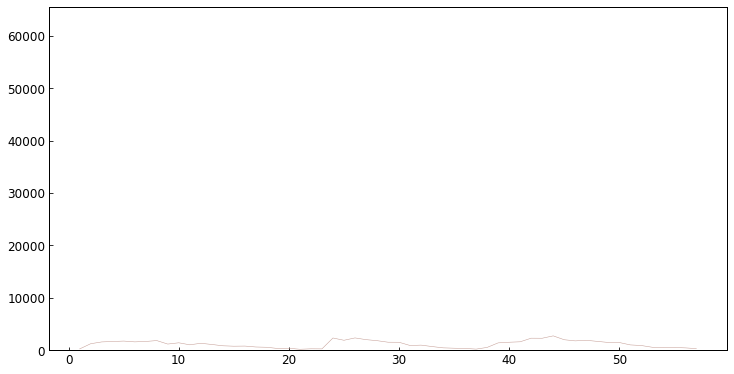

Cluster: 12


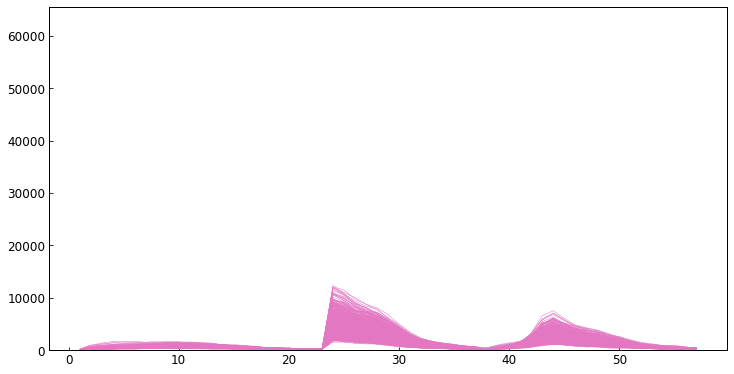

Cluster: 13


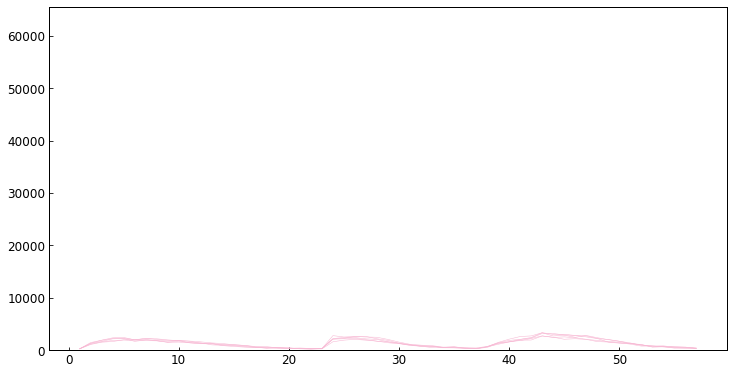

Cluster: 14


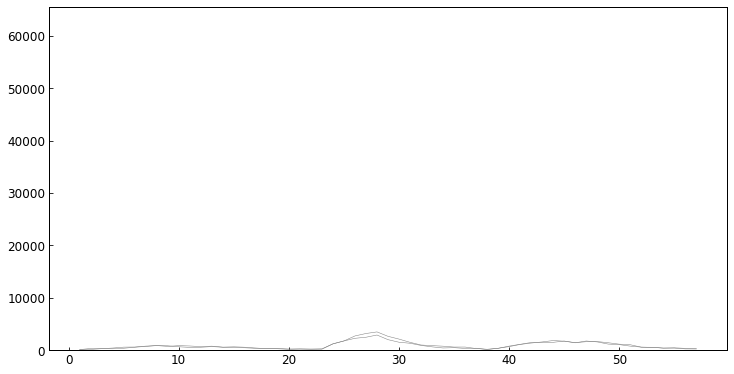

Cluster: 15


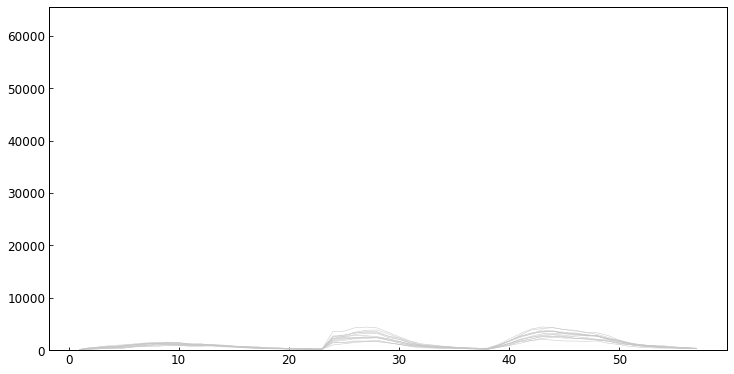

Cluster: 16


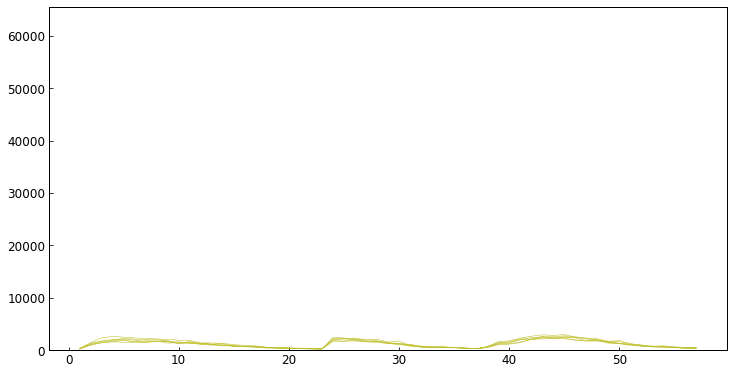

Cluster: 17


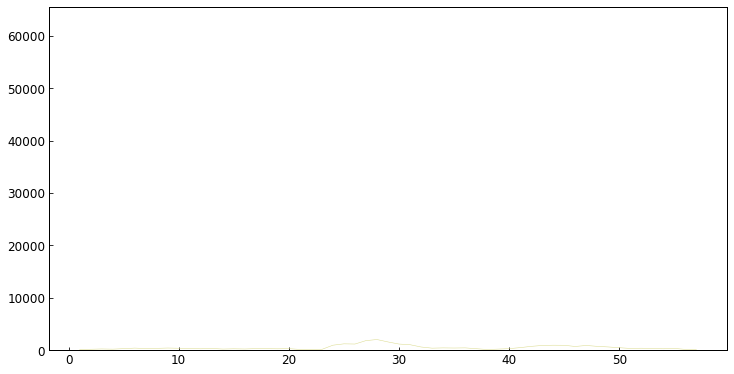

Cluster: 18


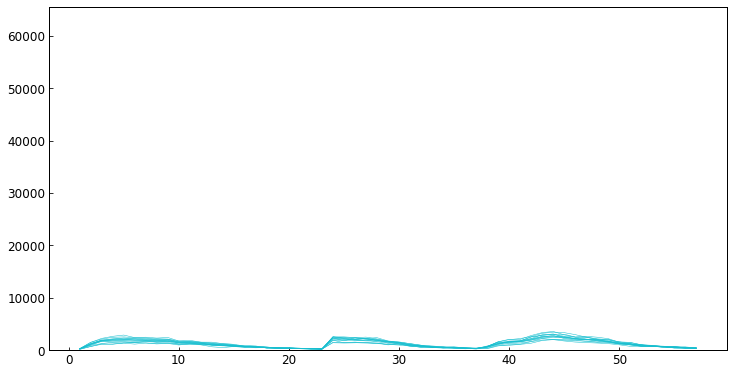

Cluster: 19


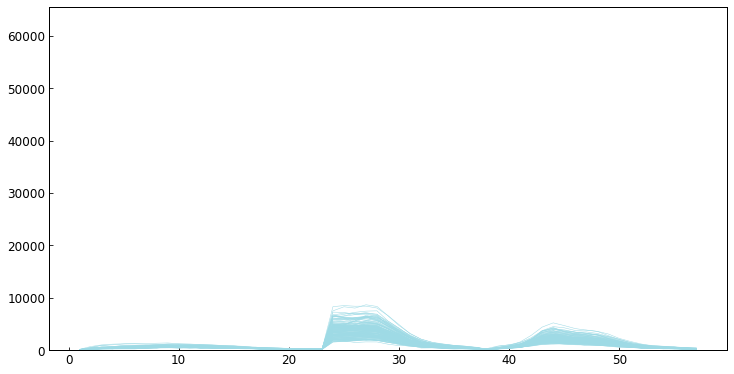

In [565]:
for c in np.unique(clust_trim):
    if c:
        print('Cluster:', c)
        bool_c = clust_trim == c
        labels_sub = np.array(labels)[bool_c]
        spec_sub = []
        for l in labels_sub:
            s = dict_lab_specmean[l]
            spec_sub.append(s)
        spec_sub = np.vstack(spec_sub)
        fig, ax = ip.general_plot(dims=spec_dims)
        color = dict_clust_col[c]
        fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':1,'color':color})
        ax.set_ylim(0,2**16)
        plt.plot()
        plt.show()

## Save

In [432]:
output_dir = config['output_dir'] + '/' + sn
# output_dir = output_dir_fmt.format(sample_name=sn)
if not os.path.exists(output_dir): 
    os.makedirs(output_dir)
    print("made dir:",output_dir)


made dir: ../../../../../outputs/mefE_taxon_mapping/agglomerative_cluster/plasmid_mefE_host_association_fov_02


In [433]:
stack_dir = output_dir + '/stacks'
props_dir = output_dir + '/props'
segs_dir = output_dir + '/segs'
spec_dir = output_dir + '/spectra'
clust_dir = output_dir + '/clust'

for dir_ in [clust_dir, spec_dir, segs_dir, props_dir, stack_dir]:
    if not os.path.exists(dir_):
        os.makedirs(dir_)
        print("made dir:",dir_)


made dir: ../../../../../outputs/mefE_taxon_mapping/agglomerative_cluster/plasmid_mefE_host_association_fov_02/clust
made dir: ../../../../../outputs/mefE_taxon_mapping/agglomerative_cluster/plasmid_mefE_host_association_fov_02/spectra
made dir: ../../../../../outputs/mefE_taxon_mapping/agglomerative_cluster/plasmid_mefE_host_association_fov_02/segs
made dir: ../../../../../outputs/mefE_taxon_mapping/agglomerative_cluster/plasmid_mefE_host_association_fov_02/props
made dir: ../../../../../outputs/mefE_taxon_mapping/agglomerative_cluster/plasmid_mefE_host_association_fov_02/stacks


In [434]:
bn = sn + '_M_' + str(m)
stack_fn = stack_dir + '/' + bn + '_stack.npy'
props_fn = props_dir + '/' + bn + '_props.csv'
seg_fn = segs_dir + '/' + bn + '_seg.npy'
spec_fn = spec_dir + '/' + bn + '_spec.yaml'
clust_fn = clust_dir + '/' + bn + '_clust.yaml'

np.save(stack_fn, stacks[m])
print('Wrote:',stack_fn)
props[m].to_csv(props_fn, index=False)
print('Wrote:',props_fn)
np.save(seg_fn, segs[m])
print('Wrote:',seg_fn)
with open(spec_fn, 'w') as f:
    yaml.dump(specs[m], f)
print('Wrote:',spec_fn)
with open(clust_fn, 'w') as f:
    yaml.dump(dict_lab_clust, f)
print('Wrote:',clust_fn)


Wrote: ../../../../../outputs/mefE_taxon_mapping/agglomerative_cluster/plasmid_mefE_host_association_fov_02/stacks/plasmid_mefE_host_association_fov_02_M_0_stack.npy
Wrote: ../../../../../outputs/mefE_taxon_mapping/agglomerative_cluster/plasmid_mefE_host_association_fov_02/props/plasmid_mefE_host_association_fov_02_M_0_props.csv
Wrote: ../../../../../outputs/mefE_taxon_mapping/agglomerative_cluster/plasmid_mefE_host_association_fov_02/segs/plasmid_mefE_host_association_fov_02_M_0_seg.npy
Wrote: ../../../../../outputs/mefE_taxon_mapping/agglomerative_cluster/plasmid_mefE_host_association_fov_02/spectra/plasmid_mefE_host_association_fov_02_M_0_spec.yaml
Wrote: ../../../../../outputs/mefE_taxon_mapping/agglomerative_cluster/plasmid_mefE_host_association_fov_02/clust/plasmid_mefE_host_association_fov_02_M_0_clust.yaml


## Failed: HDBSCAN clustering

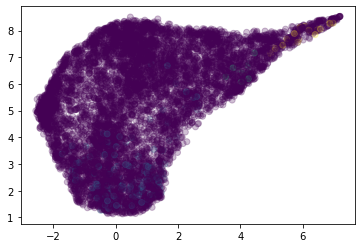

In [ ]:
import hdbscan
hdb = hdbscan.HDBSCAN(min_cluster_size=5, metric='precomputed')

hdb.fit(dist_mat)

clust_hdb = hdb.labels_

plt.scatter(u[:,0], u[:,1], c=clust_hdb, alpha=0.25)
plt.show()
plt.close()

In [ ]:
import hdbscan
hdb = hdbscan.HDBSCAN(min_cluster_size=10)

hdb.fit(u)

clust_hdb = hdb.labels_



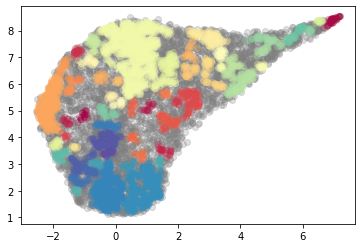

In [ ]:
u_ = u[clust_hdb > -1,:]
u_i = u[clust_hdb == -1,:]


plt.scatter(u_i[:,0], u_i[:,1], color=[0.5,0.5,0.5], alpha=0.25)
plt.scatter(u_[:,0], u_[:,1], c=clust_hdb[clust_hdb > -1], alpha=0.25, cmap='Spectral')
plt.show()
plt.close()

In [ ]:
np.unique(clust_hdb).shape

(65,)

In [ ]:
clust_all = clust_hdb
dict_lab_clust = dict(zip(labels,clust_all))
colors = plt.get_cmap('tab20').colors
dict_clust_col = dict(zip(np.unique(clust_all), colors))

In [ ]:
seg = segs[m]
prop = props[m]
for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

KeyError: 61

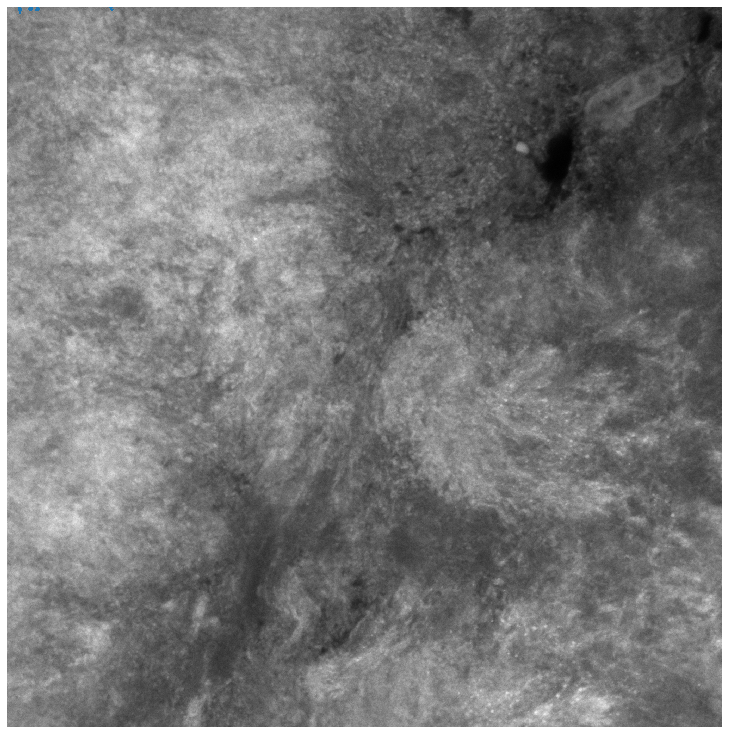

In [ ]:
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

Cluster: -1


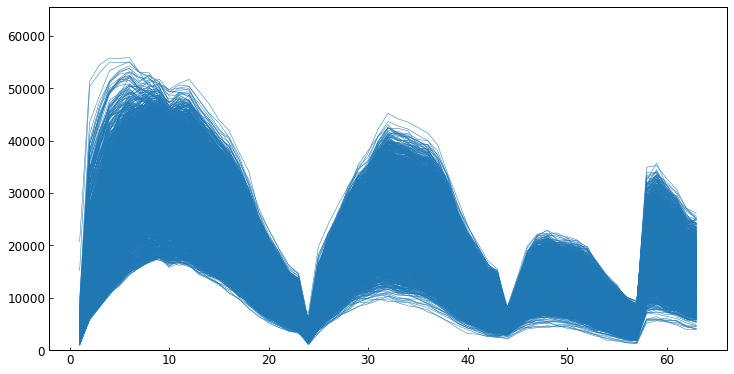

Cluster: 0


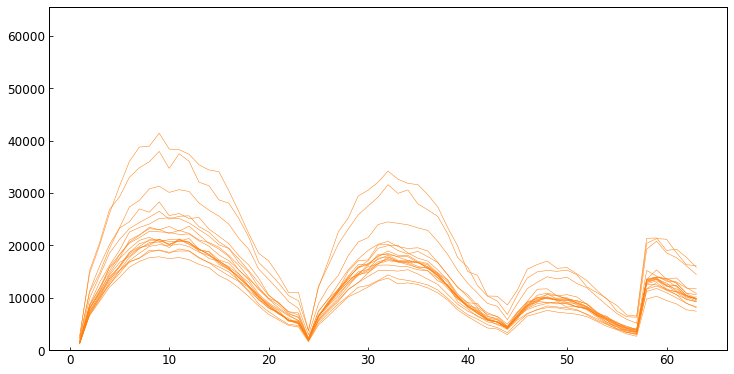

Cluster: 1


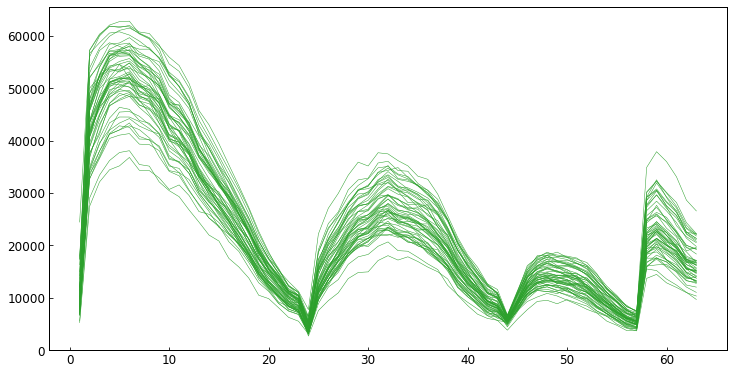

Cluster: 2


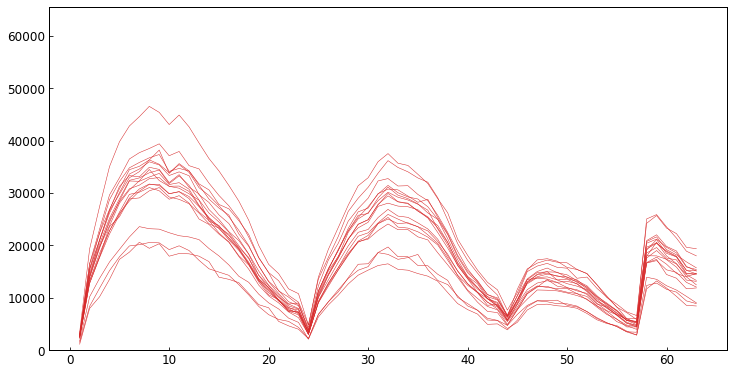

Cluster: 3


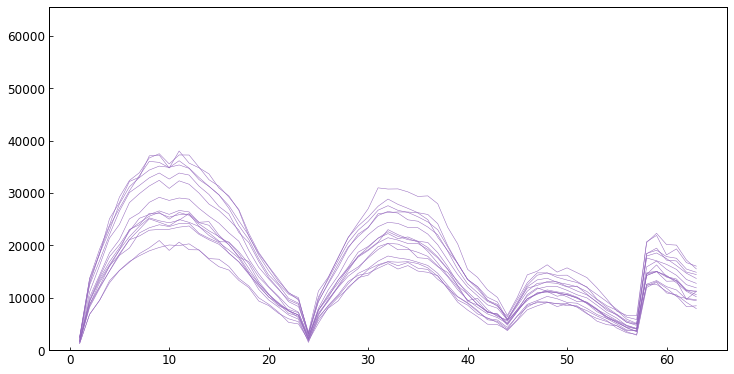

Cluster: 4


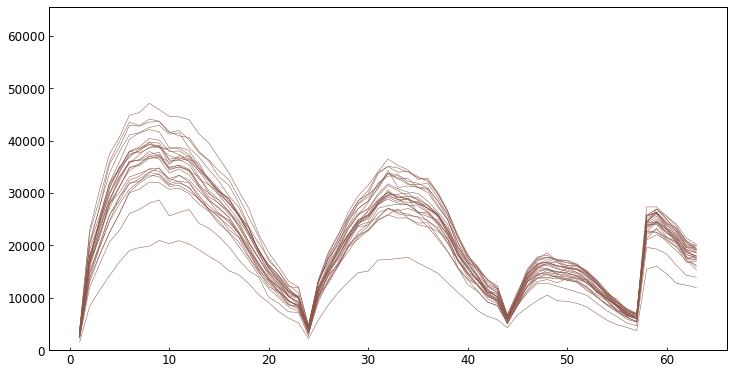

Cluster: 5


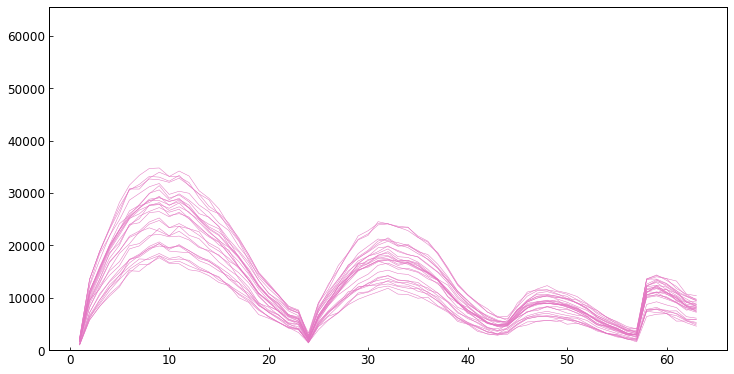

Cluster: 6


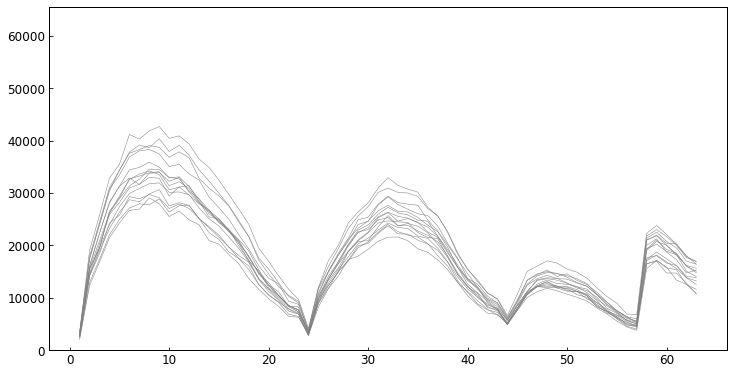

Cluster: 7


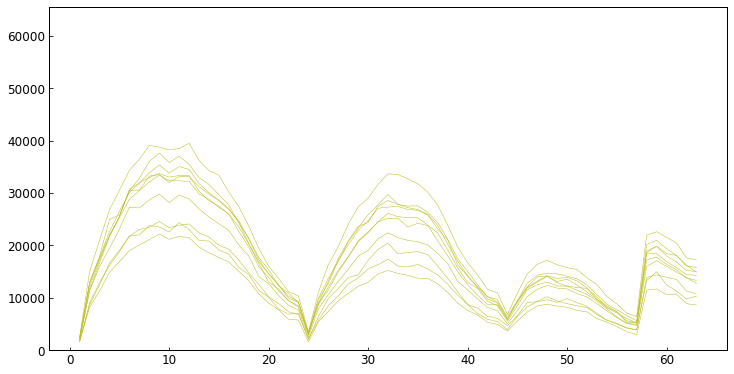

Cluster: 8


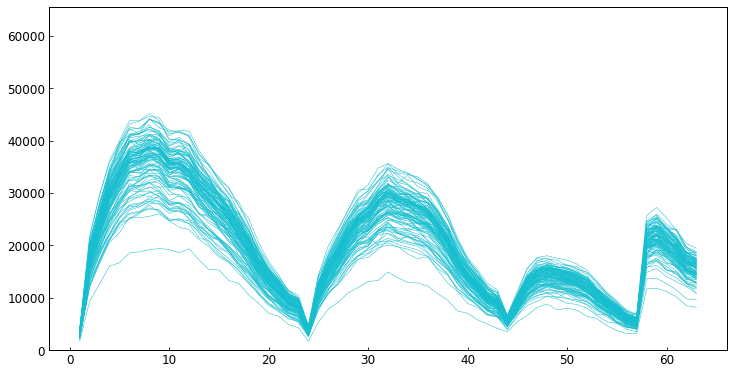

Cluster: 9


KeyError: 9

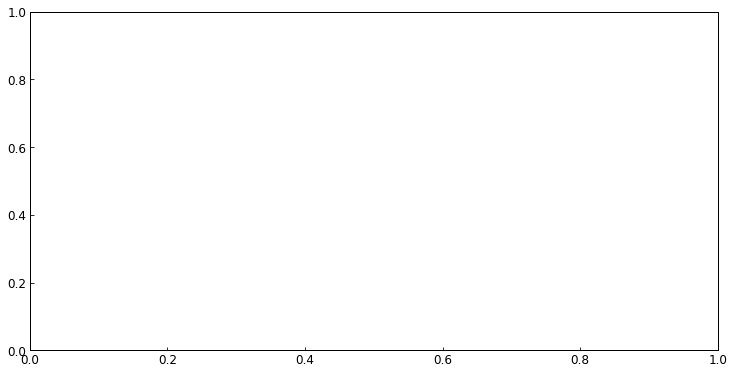

In [ ]:
for c in np.unique(clust_all):
    print('Cluster:', c)
    bool_c = clust_all == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':1,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

## Moved to classify_clusters_02

In [197]:
dict_cl_spec = {}
for c in np.unique(clust_all):
    # print('Cluster:', c)
    bool_c = clust_all == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    dict_cl_spec[c] = spec_sub

Cluster: 0
Cluster: 1
Cluster: 2
Cluster: 3
Cluster: 4
Cluster: 5
Cluster: 6
Cluster: 7
Cluster: 8
Cluster: 9
Cluster: 10
Cluster: 11
Cluster: 12
Cluster: 13
Cluster: 14
Cluster: 15
Cluster: 16
Cluster: 17
Cluster: 18
Cluster: 19


In [200]:
dict_cl_specmean = {cl: np.mean(s, axis=0) for cl, s in dict_cl_spec.items()}
dict_cl_specnorm = {cl: s / np.sum(s) for cl, s in dict_cl_specmean.items()}

In [201]:
n_clust = len(dict_cl_specnorm)
n_chan = dict_cl_spec[c].shape[1]
diff_mat = np.zeros((n_clust,n_clust,n_chan))
for i, s_i in enumerate(dict_cl_specnorm.values()):
    for j, s_j in enumerate(dict_cl_specnorm.values()):
        diff_mat[i,j,:] = s_i - s_j

In [ ]:
def sum_normalize_ref(ref_spec):
    ref_sum_norm = []
    for r in ref_spec:
        r_ = r - np.min(r, axis=1)[:,None]
        ref_sum_norm.append(r_ / np.sum(r_, axis=1)[:,None])
    return [np.mean(r, axis=0) for r in ref_sum_norm]

def get_reference_spectra(barcodes, bc_len):
    ref_dir = '/fs/cbsuvlaminck2/workdir/bmg224/manuscripts/mgefish/data/unused/fig_5/HiPRFISH_reference_spectra'
    fmt = '08_18_2018_enc_{}_avgint.csv'
    # if bc_len == 5:
    barcodes_str = [str(bc).zfill(7) for bc in barcodes]
    # barcodes_str = [str(bc).zfill(7) for bc in barcodes]
    barcodes_10bit = [bc[0] + '0' + bc[1:4] + '00' + bc[4:] for bc in barcodes_str]
    # barcodes_10bit = [bc[0] + '0' + bc[1:4] + '00' + bc[4:] for bc in barcodes_str]
    barcodes_b10 = [int(str(bc),2) for bc in barcodes_10bit]
    st = 32
    en = 32 + 63
    ref_avgint_cols = [i for i in range(st,en)]

    ref_spec = []
    for bc in barcodes_b10:
        fn = cluster + '/' + ref_dir + '/'+ fmt.format(bc)
        ref = pd.read_csv(fn, header=None)
        ref = ref[ref_avgint_cols].values
        ref_spec.append(ref)
    return ref_spec

# Get reference spectra
probe_design_dir = '/fs/cbsuvlaminck2/workdir/bmg224/manuscripts/mgefish/data/HiPRFISH_probe_design'
probe_design_fn = probe_design_dir + '/welch2016_7b_distant.csv'
probe_design = pd.read_csv(probe_design_fn)
barcodes = probe_design['code'].unique()
barcode_length = len(str(np.max(barcodes)))
ref_spec = get_reference_spectra(barcodes, barcode_length)
sci_names = [probe_design.loc[probe_design['code'] == bc,'sci_name'].unique()[0] 
            for bc in barcodes]
weights_sum_norm = sum_normalize_ref(ref_spec)

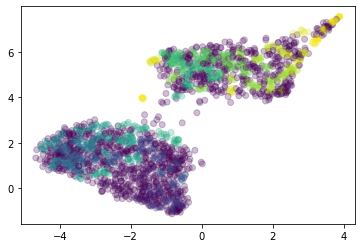

In [69]:
from sklearn.cluster import OPTICS
opt = OPTICS()

opt.fit(u)

clust_opt = opt.labels_

plt.scatter(u[:,0], u[:,1], c=clust_opt, alpha=0.25)
plt.show()
plt.close()

## Manual cluster selecrion

In [70]:
t = {}
clust = {}


In [71]:
i = 0

In [72]:
# pick a threshold for clustering
t[i] = 0.042

In [73]:
# cluster linkage into three groups
clust[i] = hierarchy.fcluster(linkage, t=t[i], criterion='distance')
clust_unique = np.unique(clust[i])
clust_unique

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19], dtype=int32)

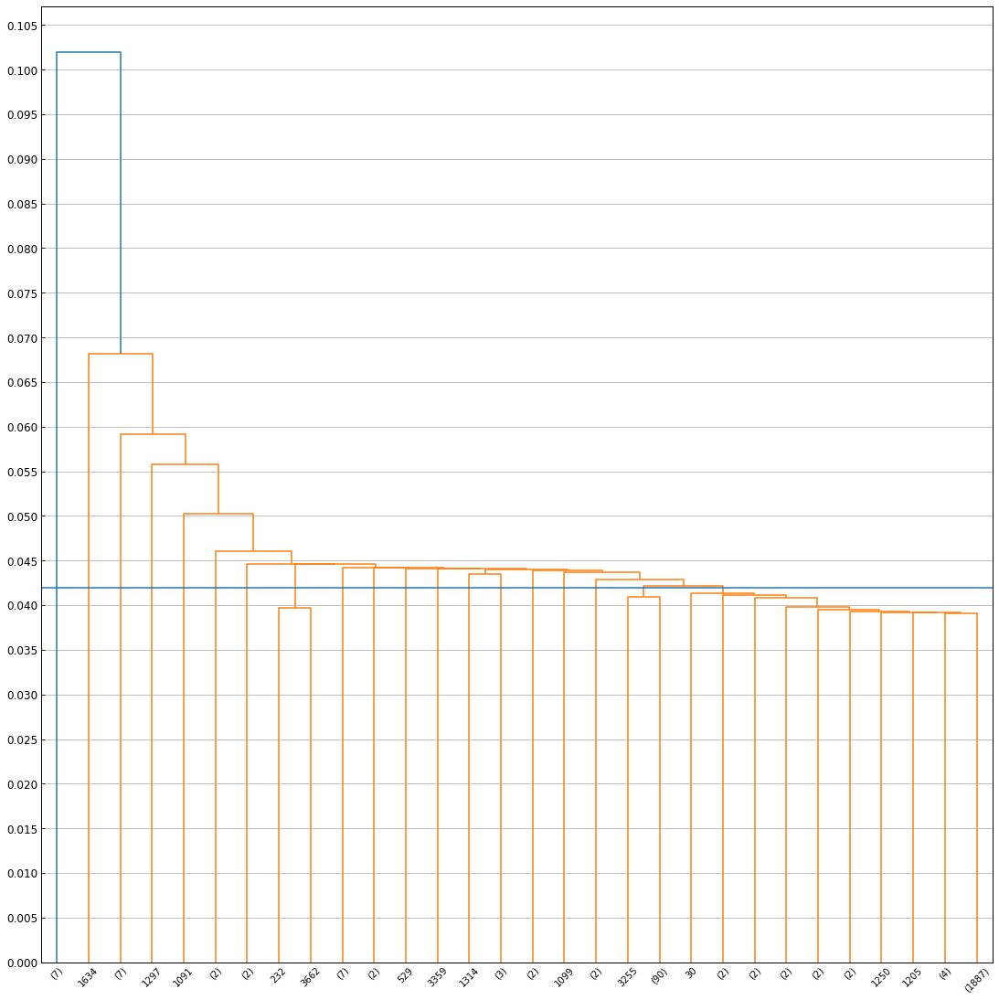

In [74]:
fig, ax = ip.general_plot(dims=(15,15))
dn = hierarchy.dendrogram(linkage, labels=labels, truncate_mode='lastp')
ax.axhline(t[i])
ylims = [round(l,2) for l in ax.get_ylim()]
ax.set_yticks(np.arange(ylims[0],ylims[1],0.005))
ax.grid(axis='y')
plt.show()
plt.close()

Cluster: 1


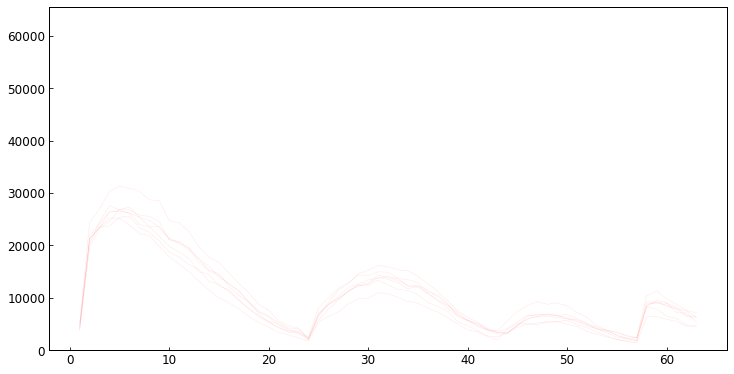

Cluster: 2


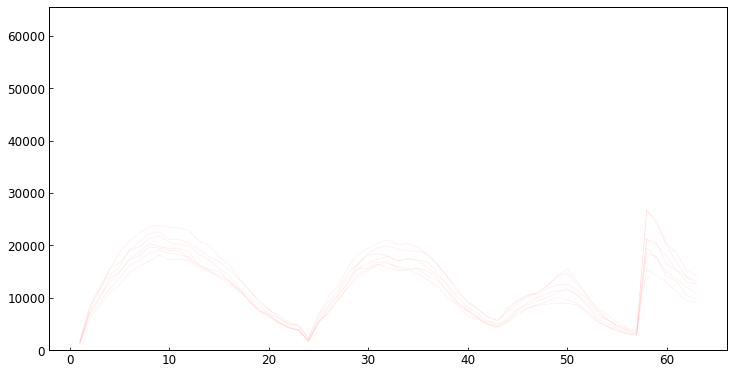

Cluster: 3


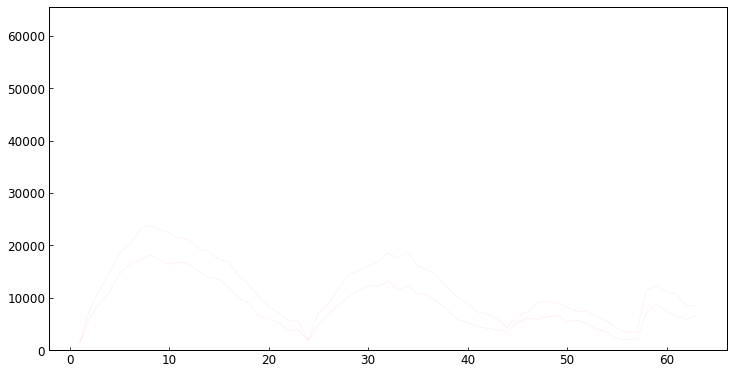

Cluster: 4


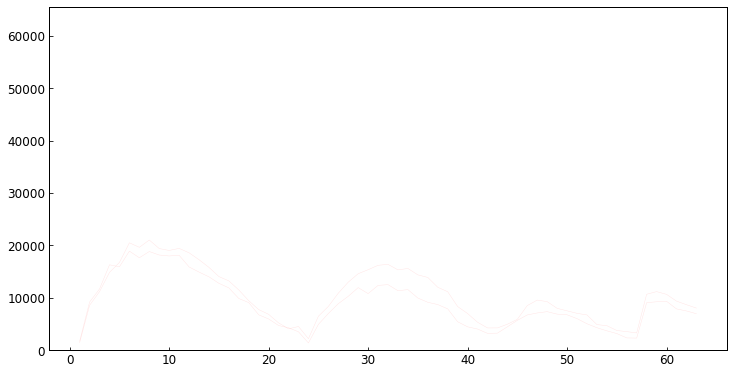

Cluster: 5


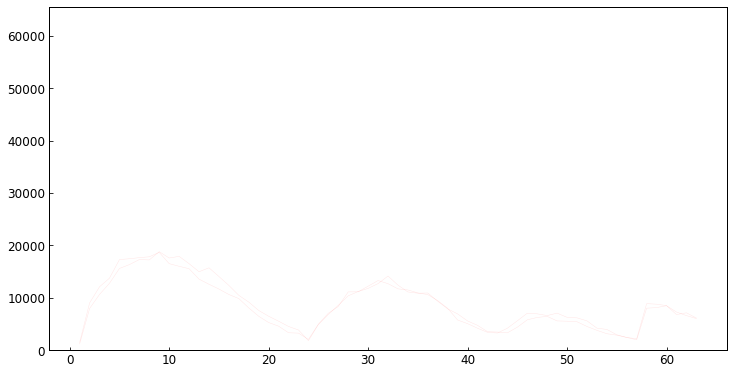

Cluster: 6


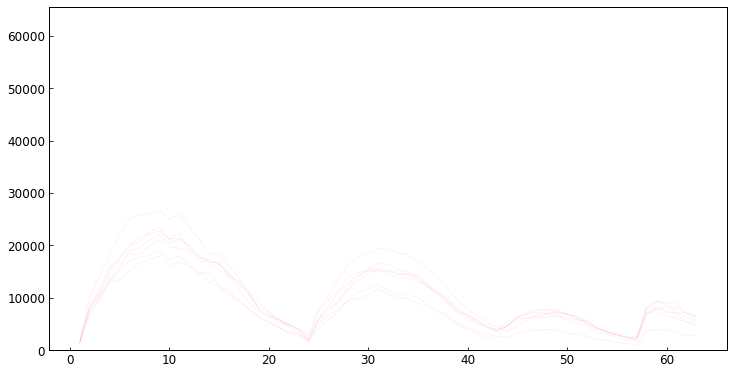

Cluster: 7


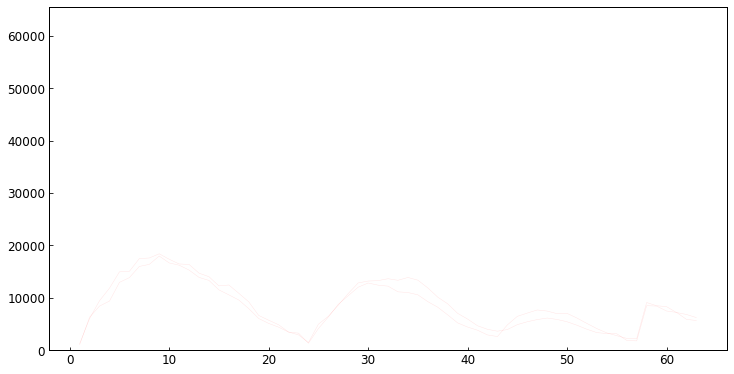

Cluster: 8


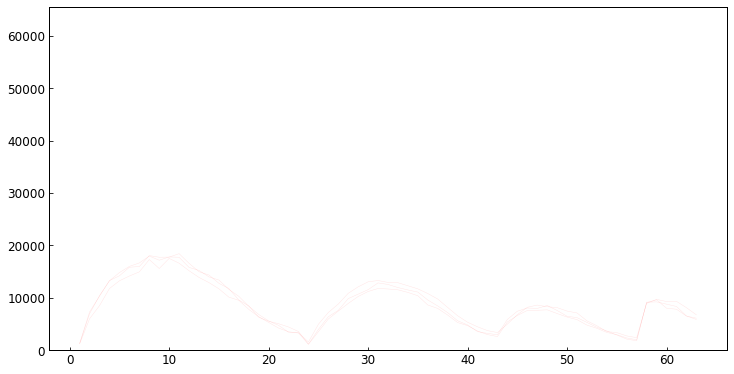

Cluster: 9


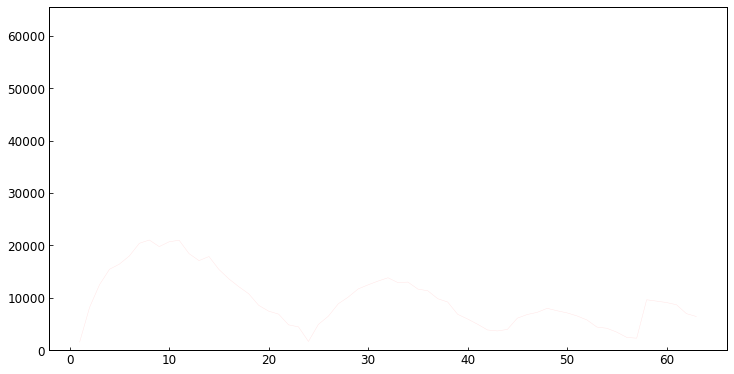

Cluster: 10


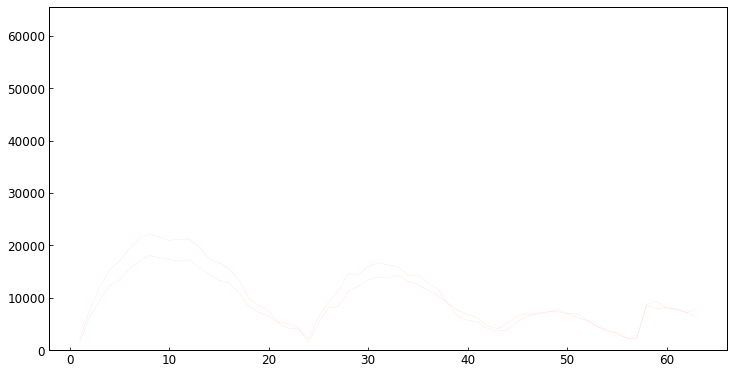

Cluster: 11


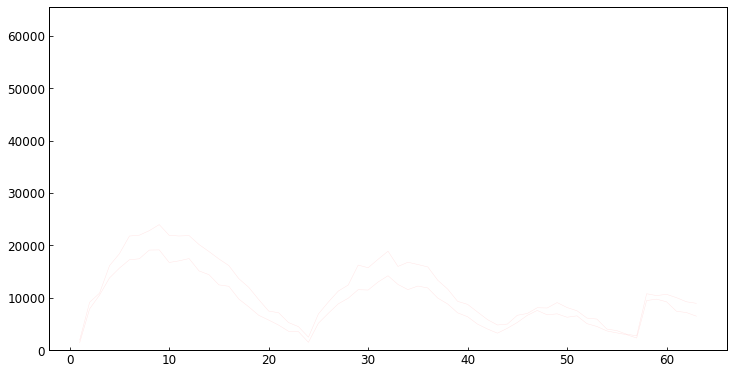

Cluster: 12


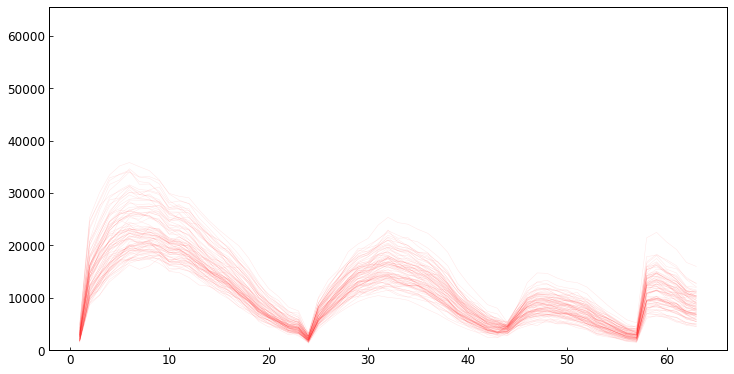

Cluster: 13


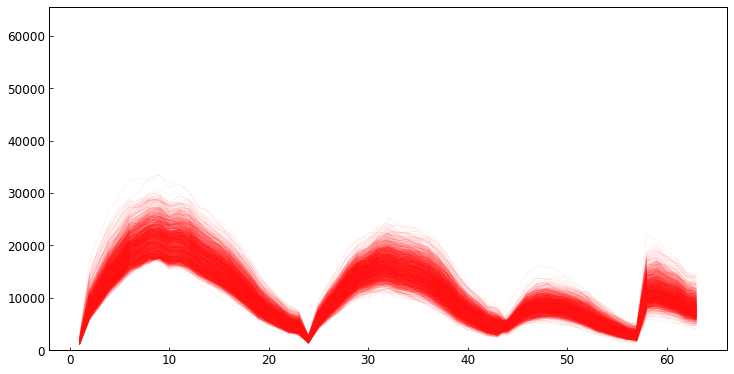

Cluster: 14


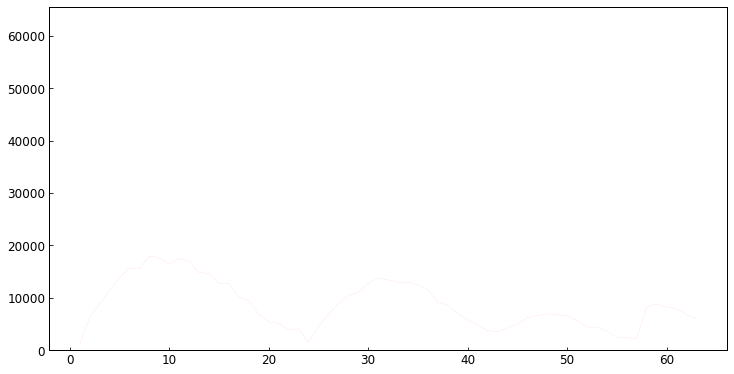

Cluster: 15


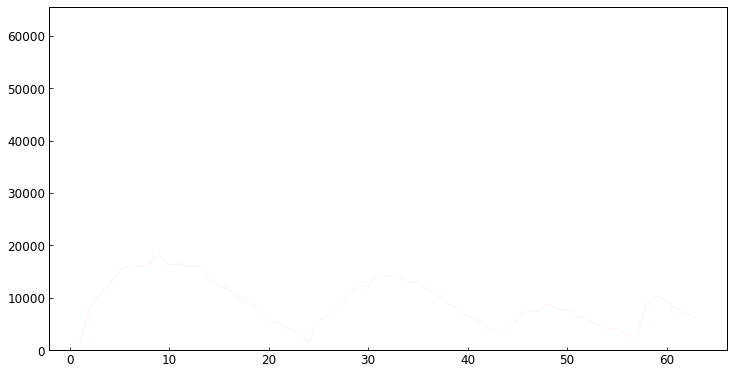

Cluster: 16


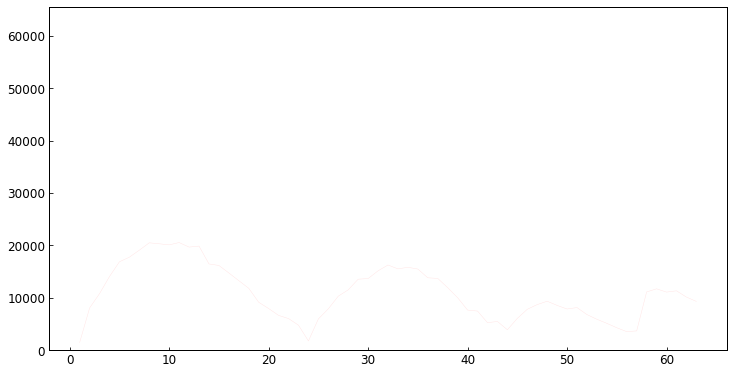

Cluster: 17


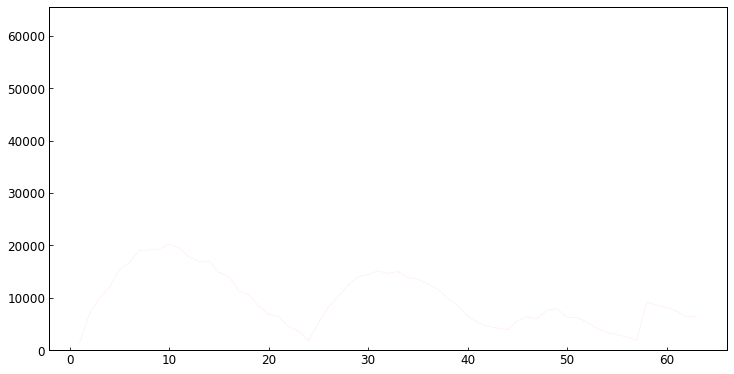

Cluster: 18


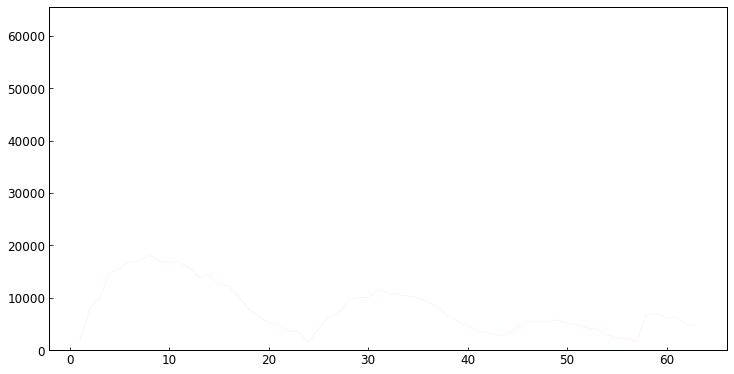

Cluster: 19


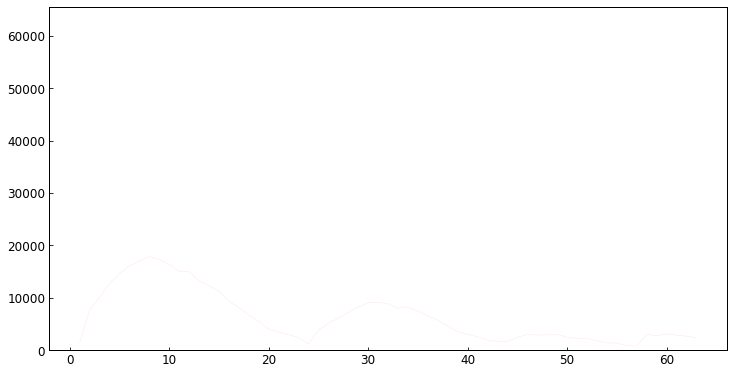

In [75]:
# Plot Spectra from each group
# choice = 200

# spec_dims = (10,5)
# for c in clust_unique:
#     print("Cluster:",c)
#     inds_sub = np.array(inds)[clust[i] == c]
#     spec_sub = []
#     inds_sub_choice = np.random.choice(inds_sub, size=choice, replace=False)
#     for ind in inds_sub:
#         m,l = dict_ind_lab[ind]
#         s = specs[m][l]
#         spec_sub.append(s)
#     spec_sub = np.vstack(spec_sub)
#     fig, ax = ip.general_plot(dims=spec_dims)
#     fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.1,'color':'r'})
#     ax.set_ylim(0,2**16)
#     plt.plot()
#     plt.show()
# project groups onto Image and compare with raw image

spec_dims = (10,5)
for c in clust_unique:
    print("Cluster:",c)
    labels_sub = np.array(labels)[clust[i] == c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.1,'color':'r'})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [1159]:
clust_all = clust[i]
np.unique(clust_all)

array([1, 2], dtype=int32)

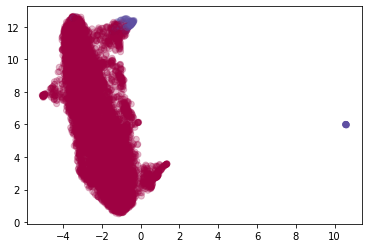

In [1160]:
# fit = umap.UMAP(metric='precomputed')
# u = fit.fit_transform(dist_mat)
plt.scatter(u[:,0], u[:,1], c=clust_all, alpha=0.25, cmap='Spectral')
plt.show()
plt.close()

In [1161]:
dict_lab_clust = dict(zip(labels,clust_all))
colors = plt.get_cmap('tab10').colors
dict_clust_col = dict(zip(np.unique(clust_all), colors))

In [1162]:
seg = segs[m]
prop = props[m]
for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

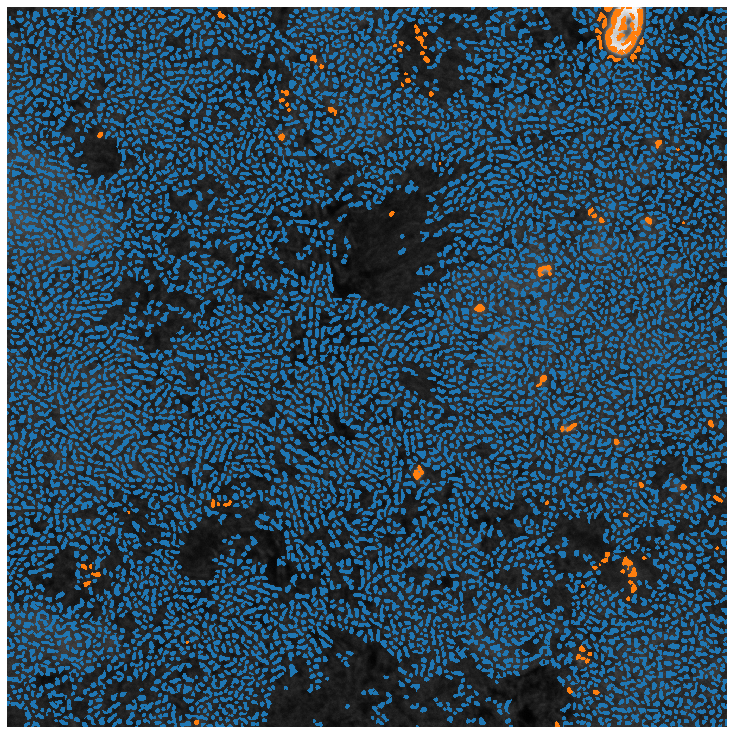

In [1163]:
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

In [1164]:
sub_cl = {}

In [1165]:
i = 1
i_old = 0
sub_cl[i] = 1

In [1166]:
# pick a threshold for clustering
t[i] = 0.04


In [1167]:
# cluster linkage into three groups
clust[i] = hierarchy.fcluster(linkage, t=t[i], criterion='distance')
bool_subclust = clust[i_old] == sub_cl[i]
clust_unique = np.unique(clust[i][bool_subclust])
clust_unique

array([1, 2, 3, 4, 5, 6], dtype=int32)

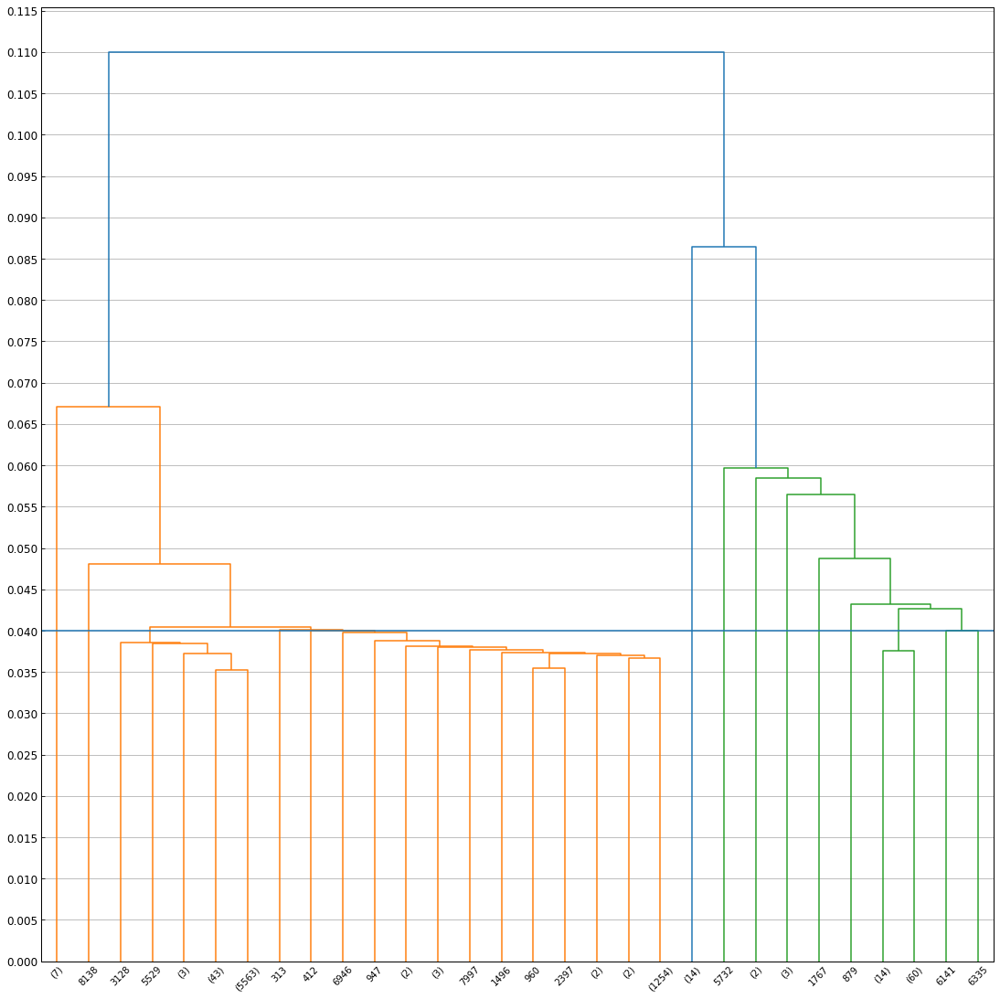

In [1168]:
fig, ax = ip.general_plot(dims=(15,15))
dn = hierarchy.dendrogram(linkage, labels=labels, truncate_mode='lastp')
ax.axhline(t[i])
ylims = [round(l,2) for l in ax.get_ylim()]
ax.set_yticks(np.arange(ylims[0],ylims[1],0.005))
ax.grid(axis='y')
plt.show()
plt.close()

Cluster: 1


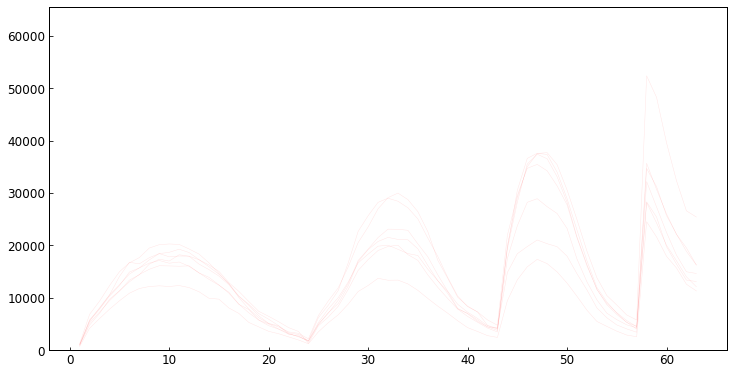

Cluster: 2


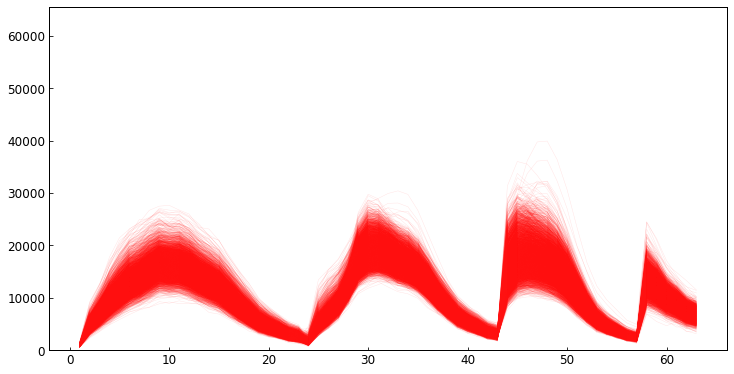

Cluster: 3


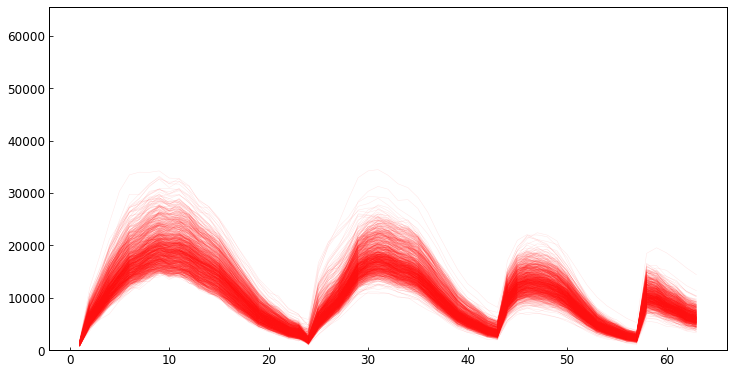

Cluster: 4


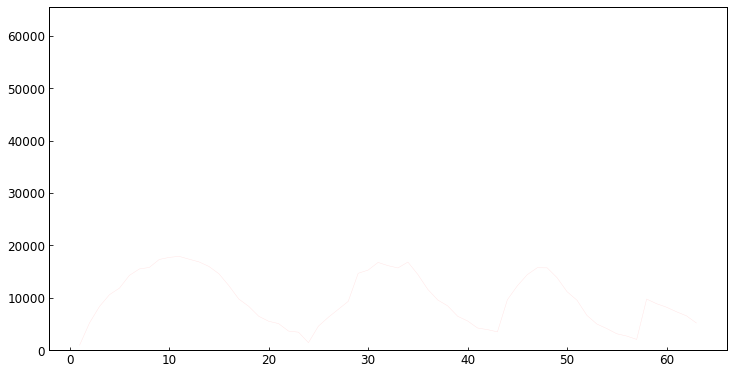

Cluster: 5


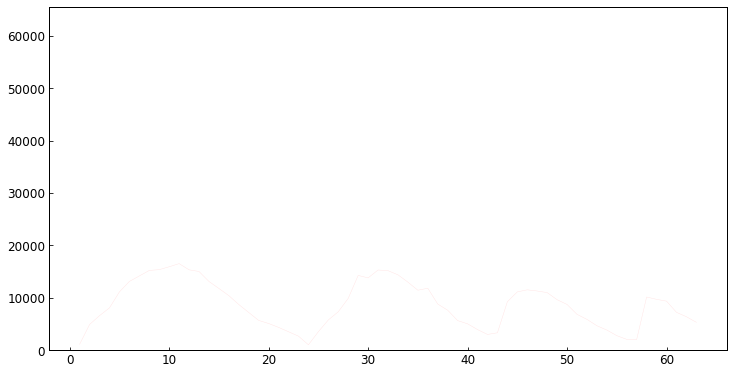

Cluster: 6


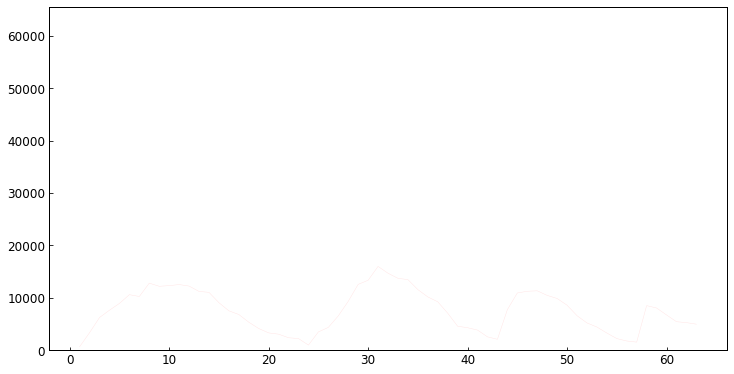

In [1169]:
spec_dims = (10,5)
for c in clust_unique:
    labels_sub = np.array(labels)[clust[i] == c]
    if len(labels_sub) > 100:
    print("Cluster:",c) 
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.1,'color':'r'})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [1170]:
clust_change = [1,2]

clmx = np.max(clust_all)
clust_i_rename = clust_all.copy()
for c in clust_change:
    bool_c = clust[i] == c
    clmx += 1
    clust_i_rename[bool_c] = clmx

np.unique(clust_i_rename[bool_subclust])

array([1, 3, 4], dtype=int32)

In [1171]:
clust_all[bool_subclust] = clust_i_rename[bool_subclust]
np.unique(clust_all)


array([1, 2, 3, 4], dtype=int32)

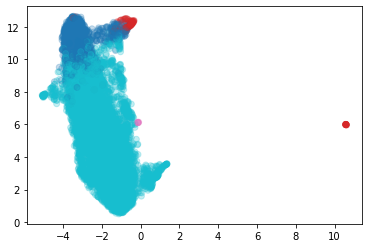

In [1172]:
# fit = umap.UMAP(metric='precomputed')
# u = fit.fit_transform(dist_mat)
plt.scatter(u[:,0], u[:,1], c=clust_all, alpha=0.25, cmap='tab10')
plt.show()
plt.close()

In [1173]:
dict_lab_clust = dict(zip(labels,clust_all))
colors = plt.get_cmap('tab10').colors
dict_clust_col = dict(zip(np.unique(clust_all), colors))

In [1174]:
seg = segs[m]
prop = props[m]
for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

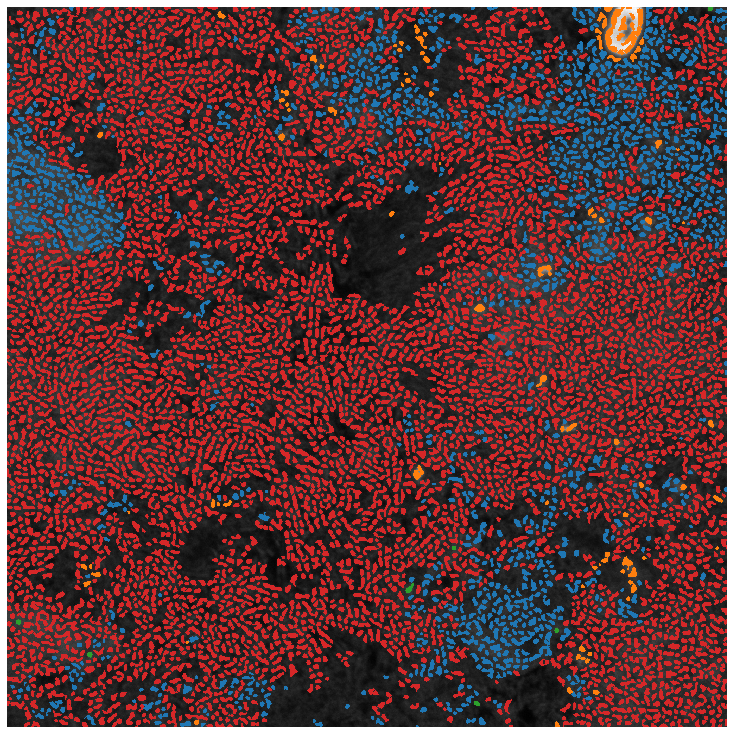

In [1175]:
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

Cluster: 1


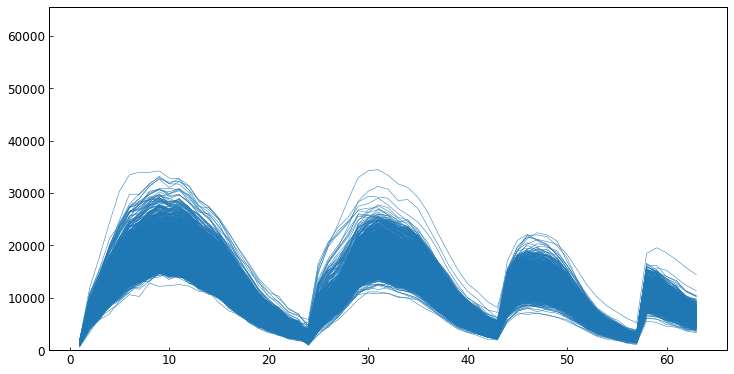

Cluster: 2


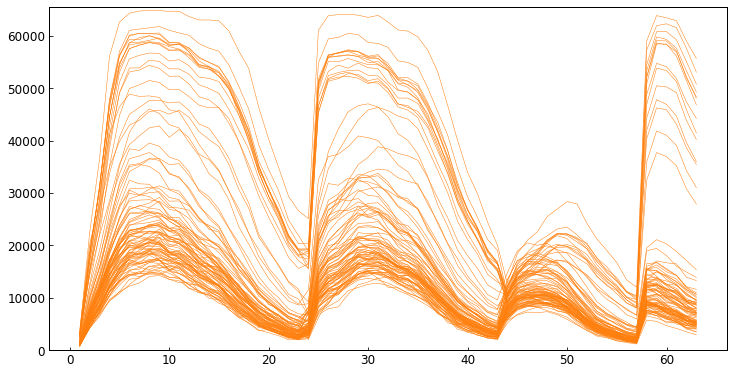

Cluster: 3


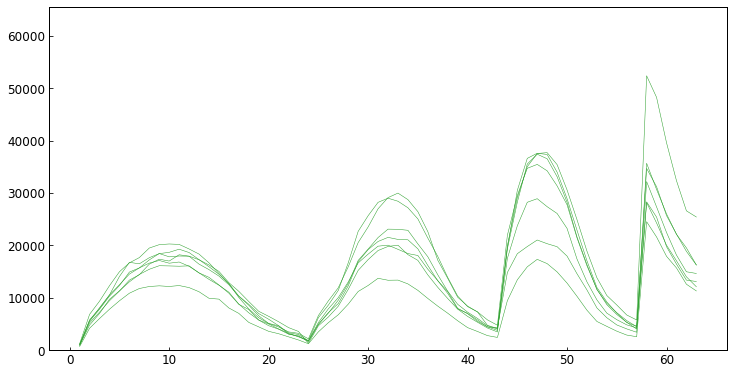

Cluster: 4


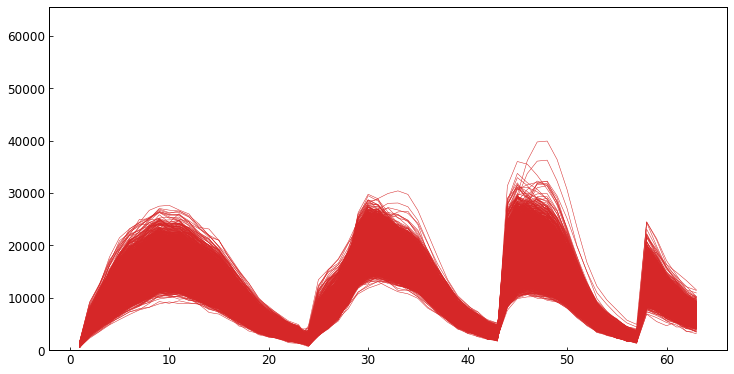

In [1176]:
for c in np.unique(clust_all):
    print('Cluster:', c)
    bool_c = clust_all == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':1,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [1177]:
i = 2
i_old = 1
sub_cl[i] = 2

In [1178]:
# pick a threshold for clustering
t[i] = 0.0225

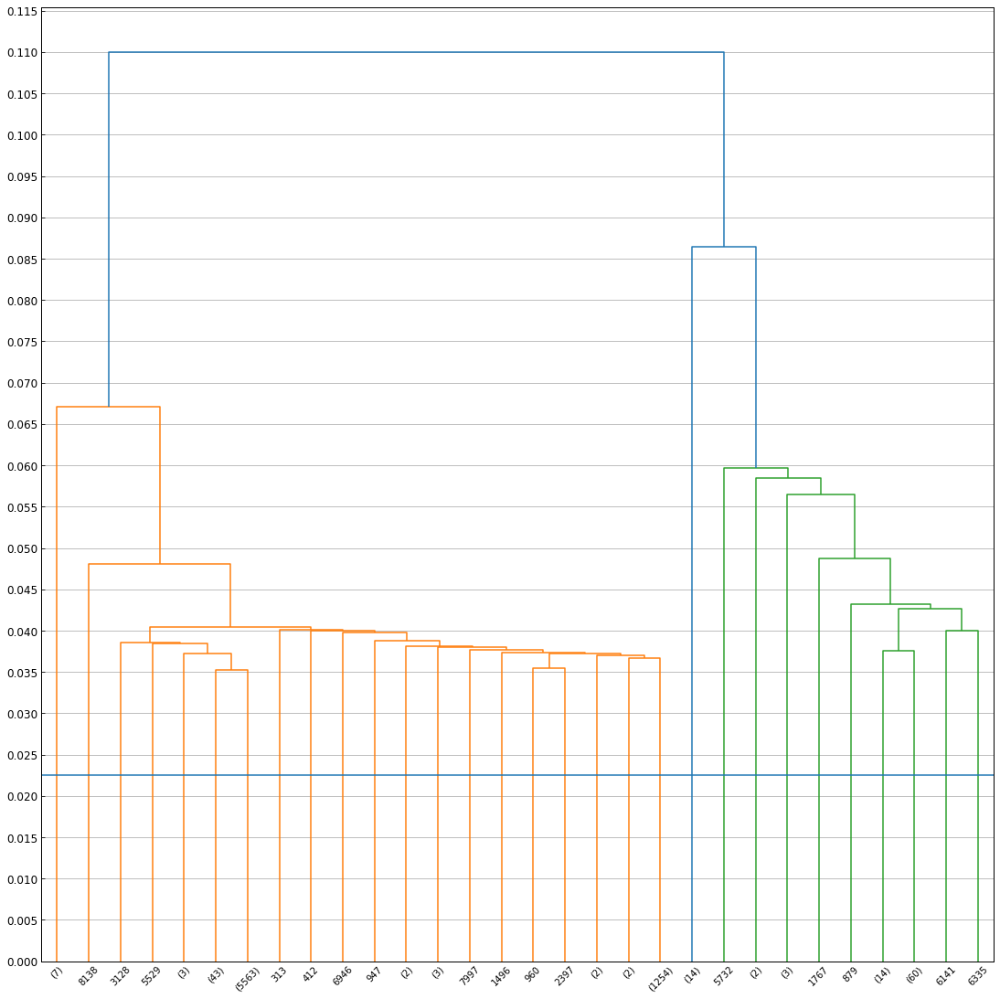

In [1179]:
fig, ax = ip.general_plot(dims=(15,15))
dn = hierarchy.dendrogram(linkage, labels=labels, truncate_mode='lastp')
ax.axhline(t[i])
ylims = [round(l,2) for l in ax.get_ylim()]
ax.set_yticks(np.arange(ylims[0],ylims[1],0.005))
ax.grid(axis='y')
plt.show()
plt.close()

In [1180]:
# cluster linkage into three groups
clust[i] = hierarchy.fcluster(linkage, t=t[i], criterion='distance')
bool_subclust = clust[i_old] == sub_cl[i]
clust_unique = np.unique(clust[i][bool_subclust])
clust_unique

array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
       19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
       36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52,
       53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66],
      dtype=int32)

Cluster: 2


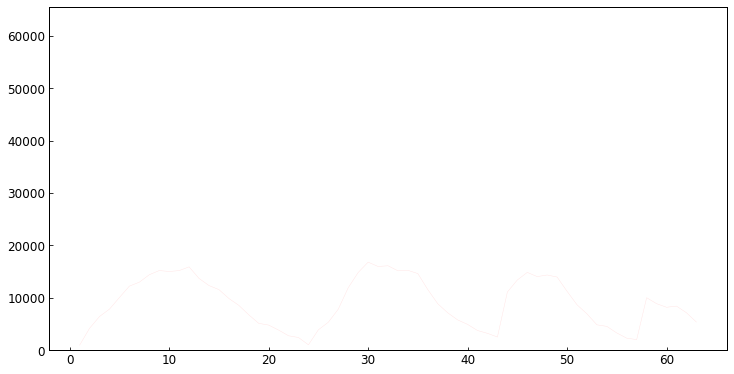

Cluster: 3


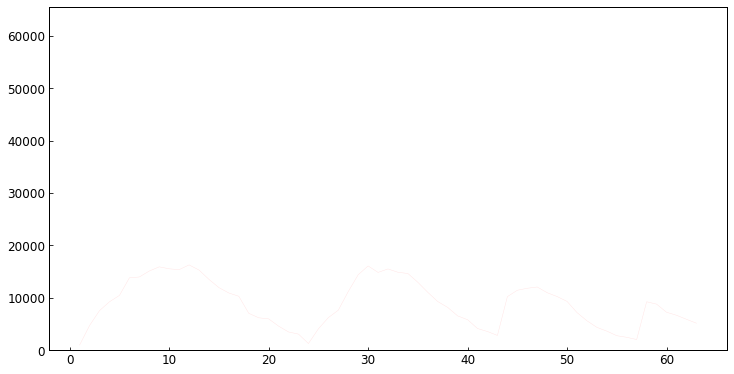

Cluster: 4


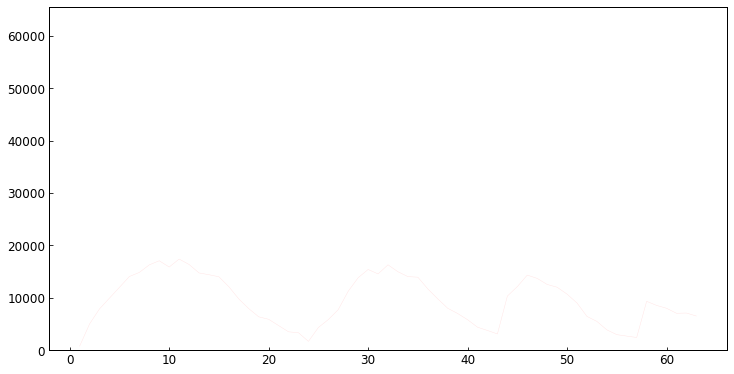

Cluster: 5


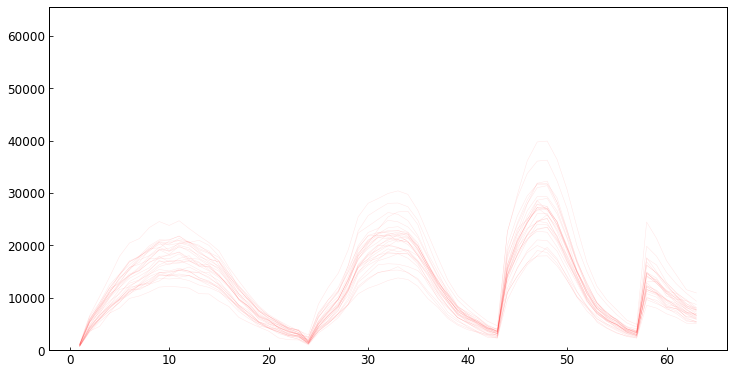

Cluster: 6


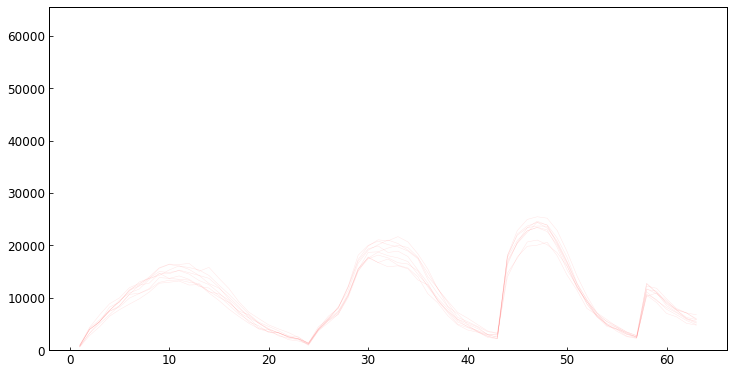

Cluster: 7


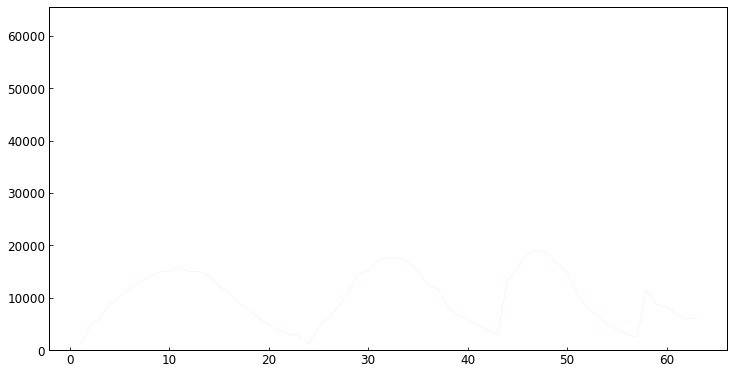

Cluster: 8


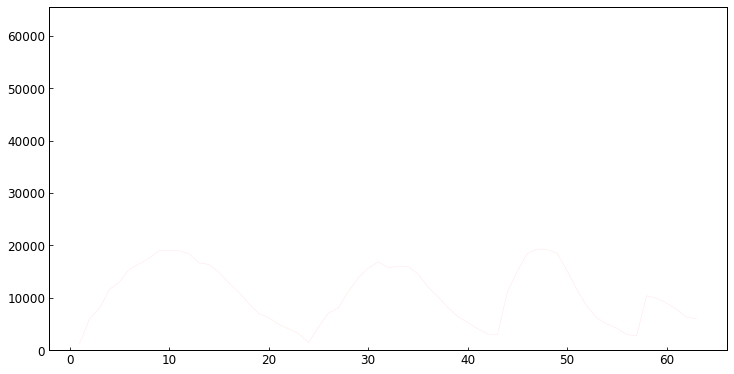

Cluster: 9


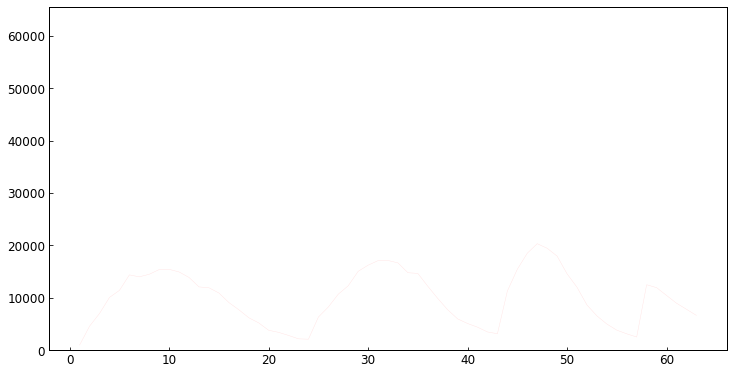

Cluster: 10


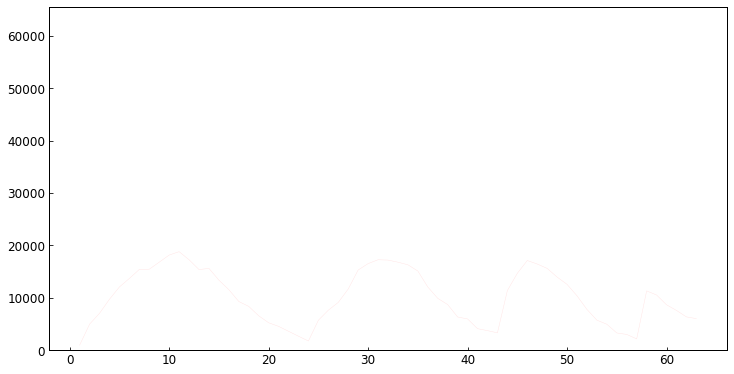

Cluster: 11


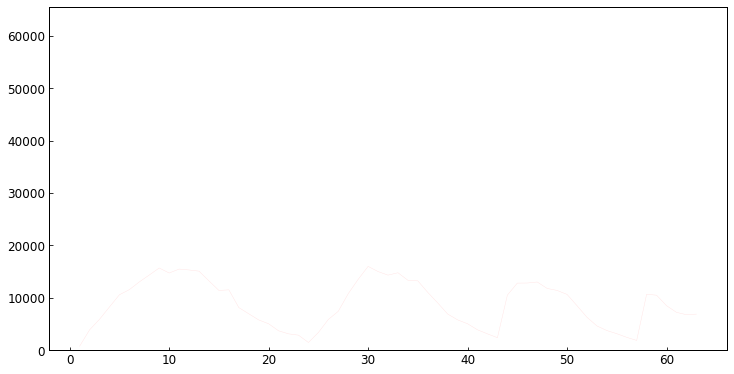

Cluster: 12


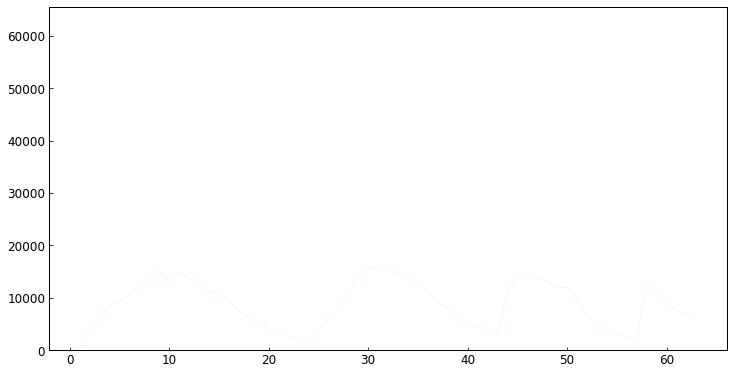

Cluster: 13


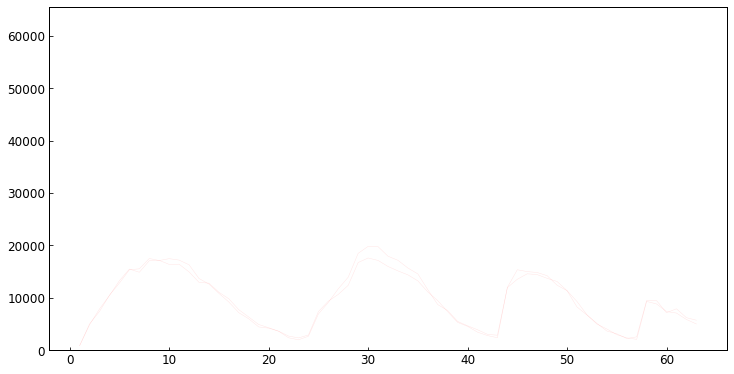

Cluster: 14


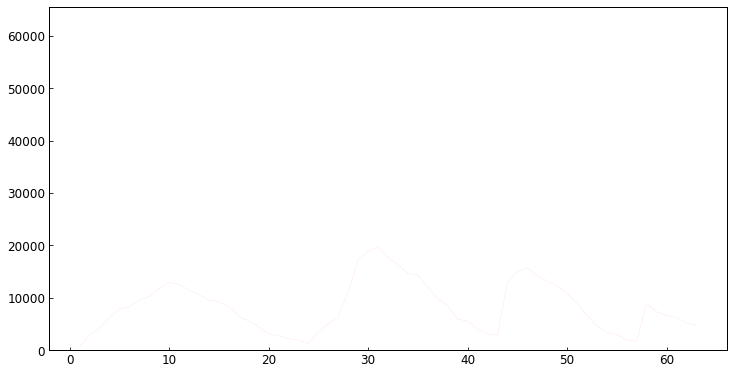

Cluster: 15


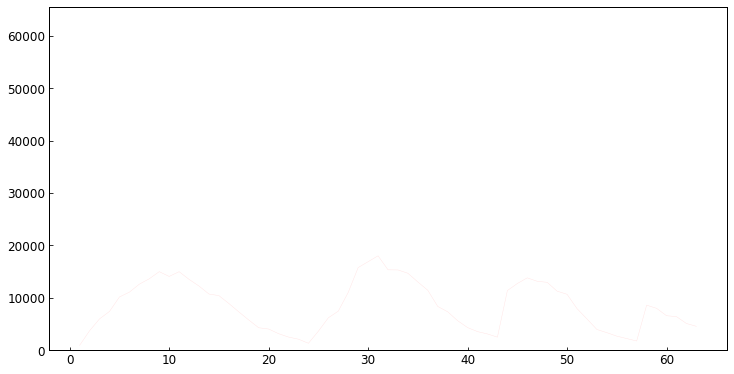

Cluster: 16


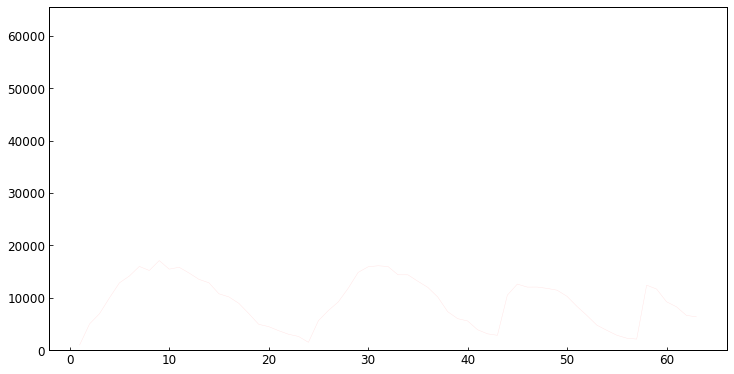

Cluster: 17


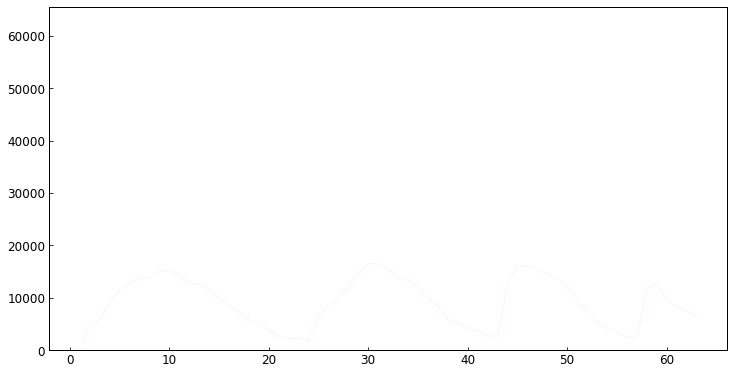

Cluster: 18


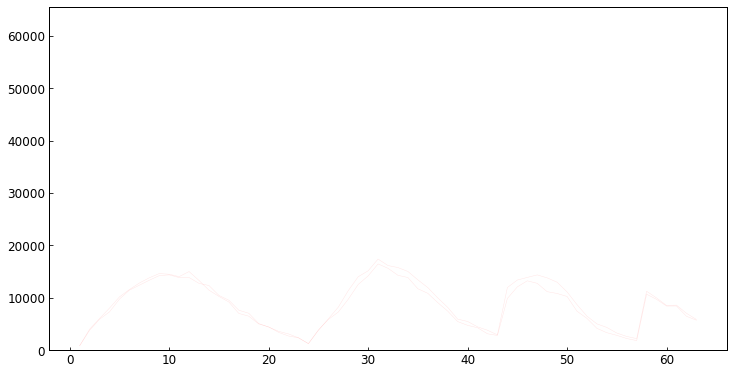

Cluster: 19


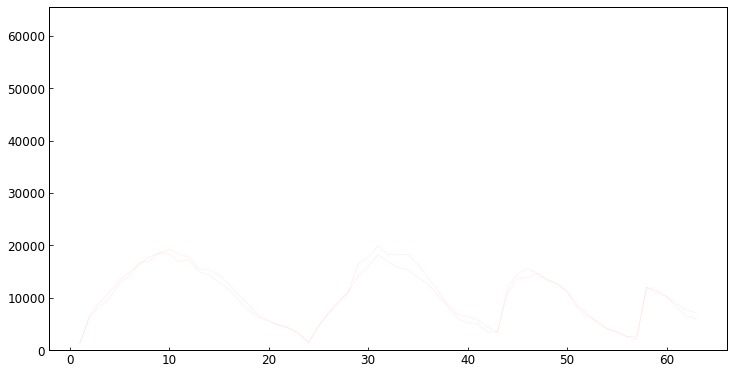

Cluster: 20


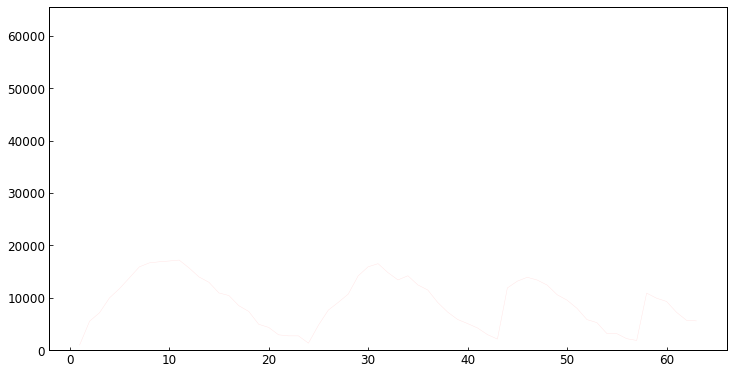

Cluster: 21


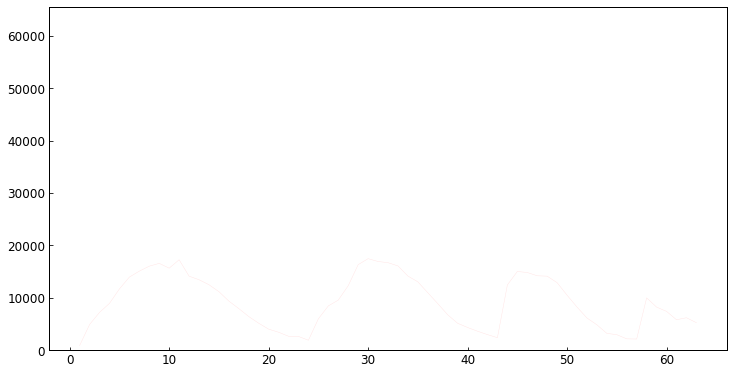

Cluster: 22


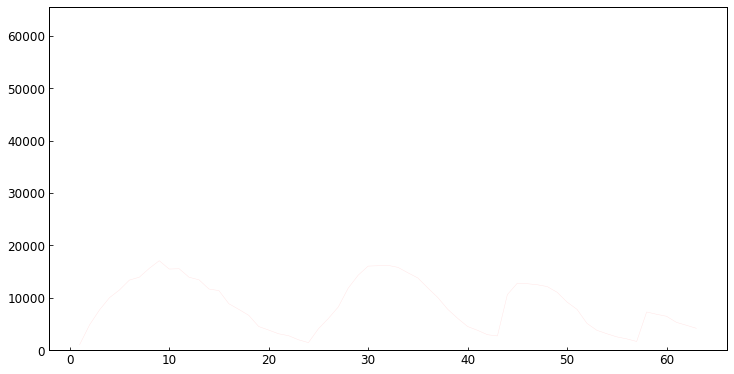

Cluster: 23


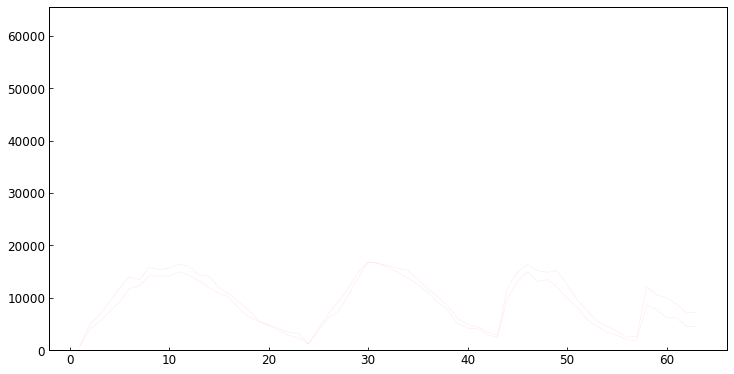

Cluster: 24


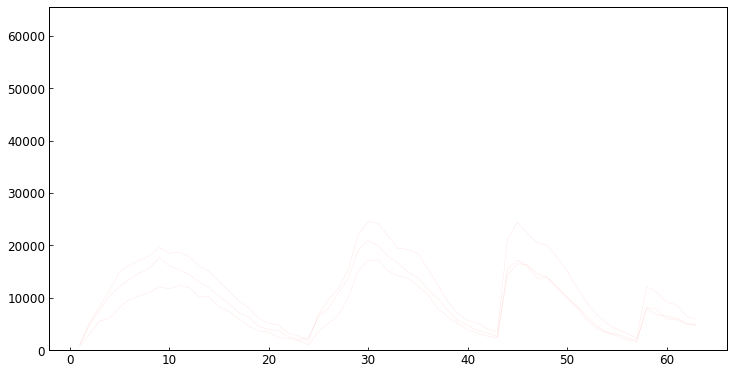

Cluster: 25


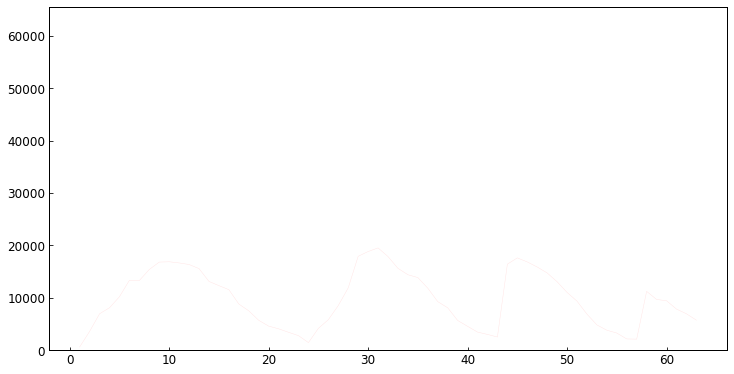

Cluster: 26


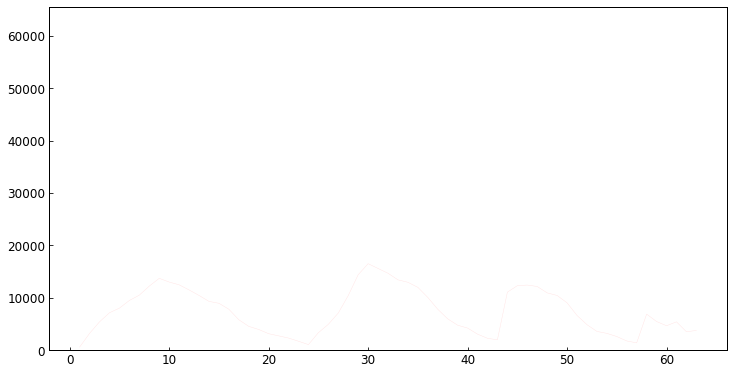

Cluster: 27


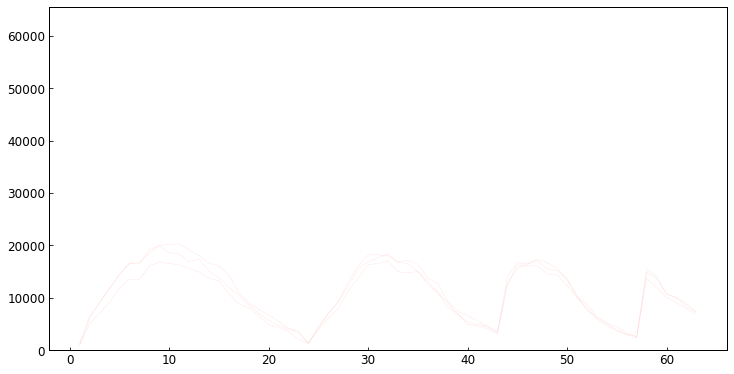

Cluster: 28


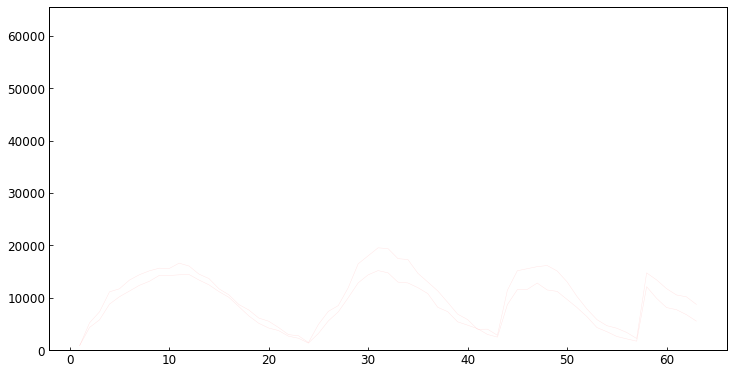

Cluster: 29


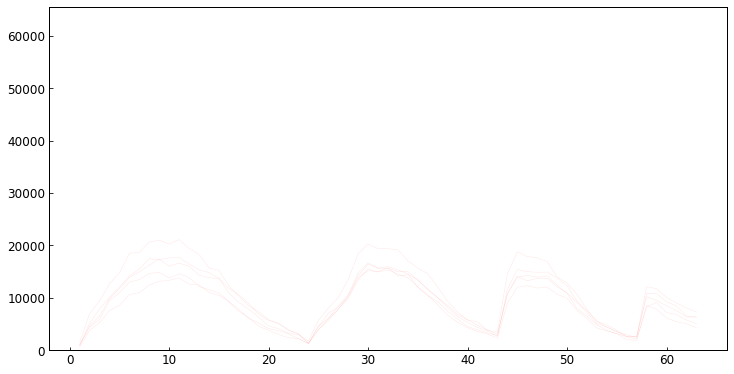

Cluster: 30


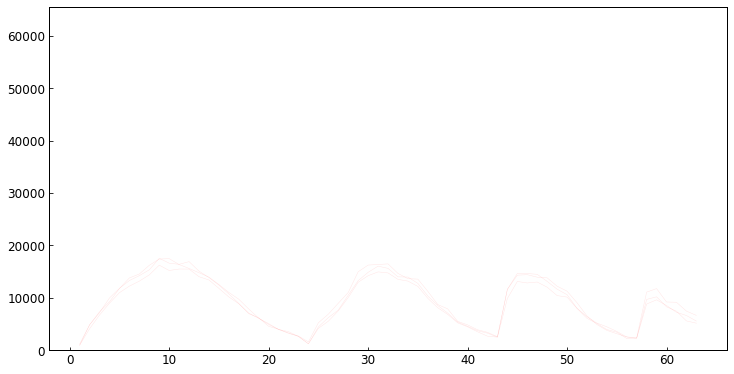

Cluster: 31


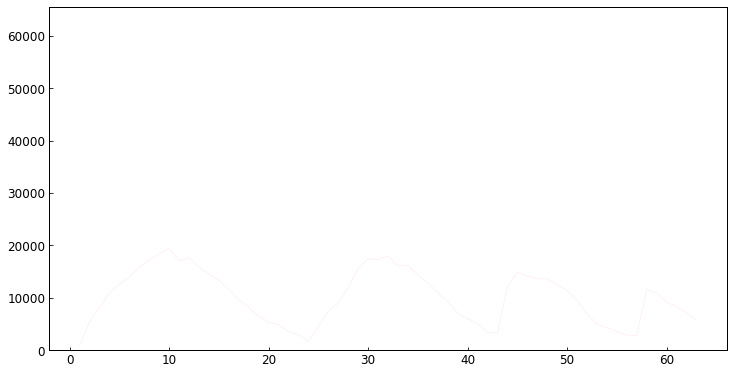

Cluster: 32


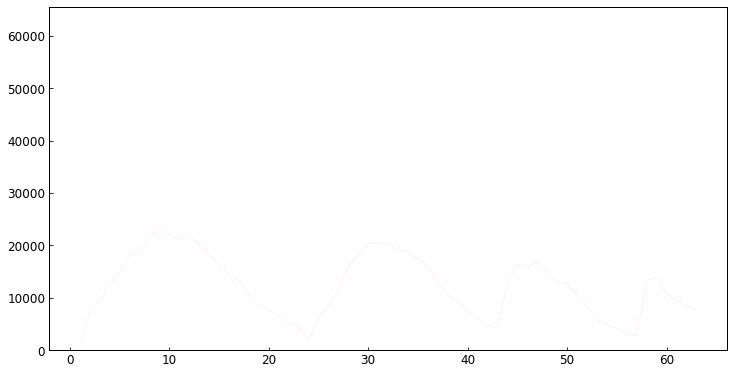

Cluster: 33


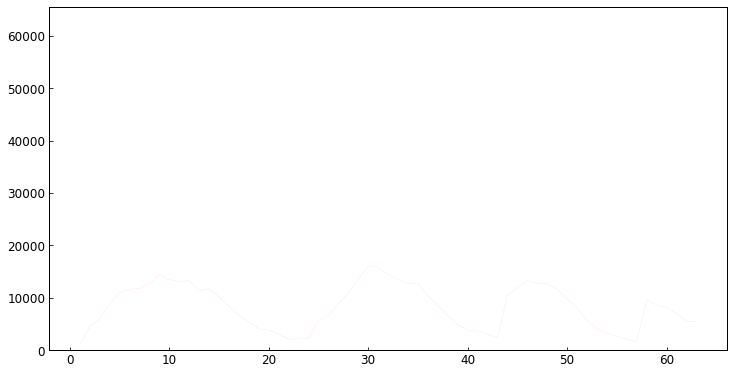

Cluster: 34


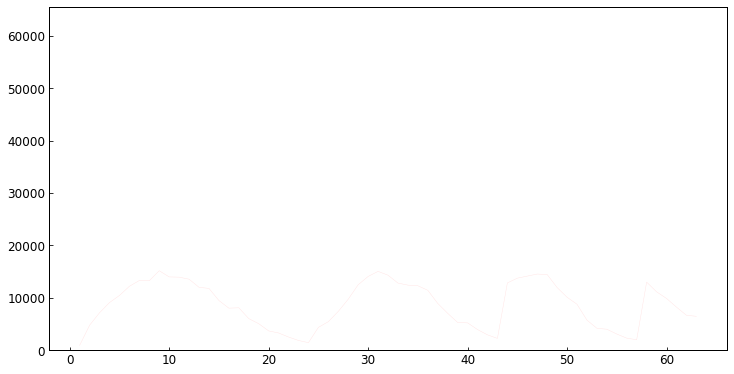

Cluster: 35


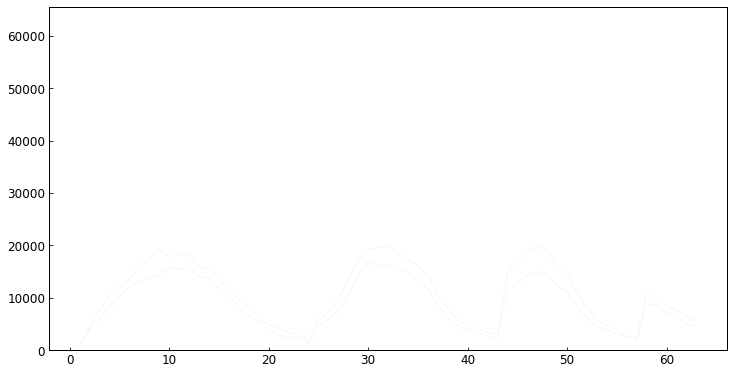

Cluster: 36


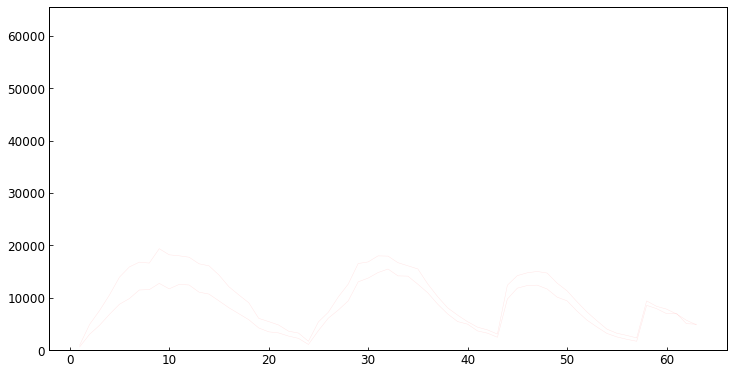

Cluster: 37


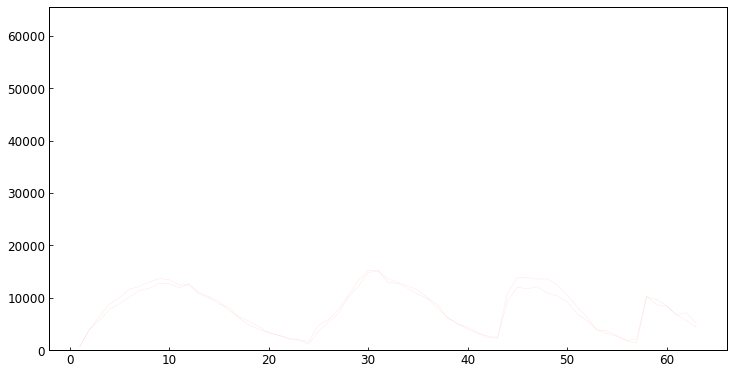

Cluster: 38


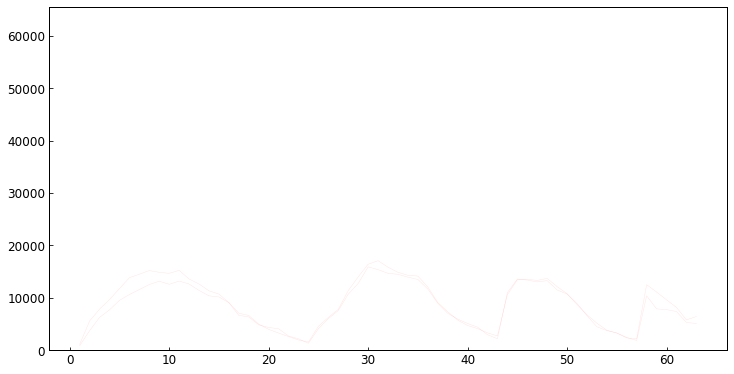

Cluster: 39


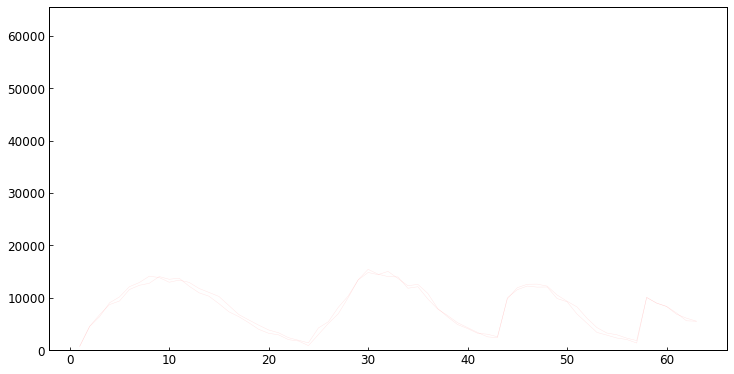

Cluster: 40


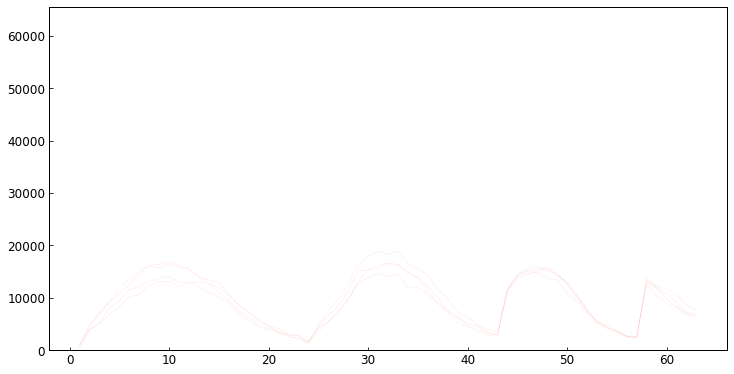

Cluster: 41


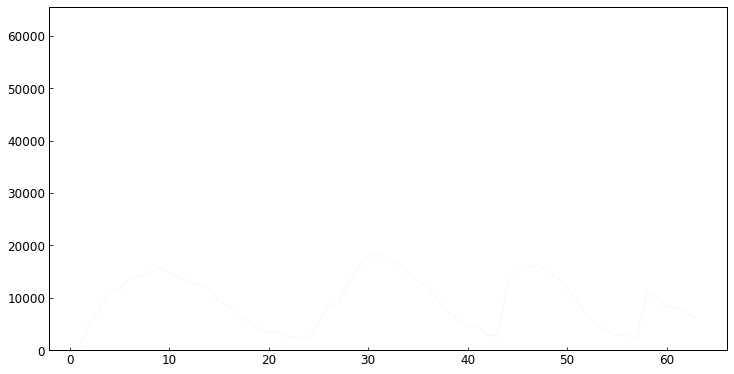

Cluster: 42


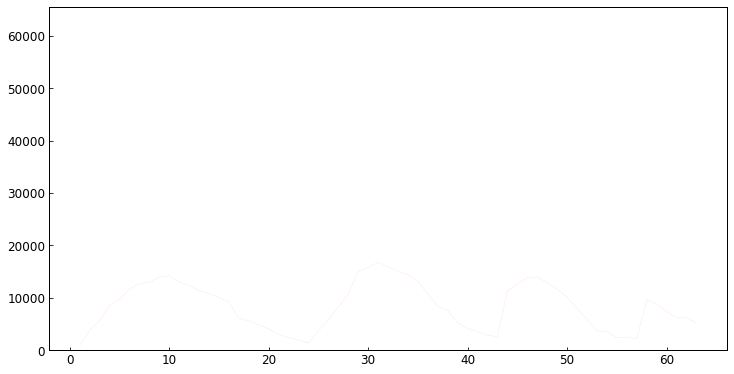

Cluster: 43


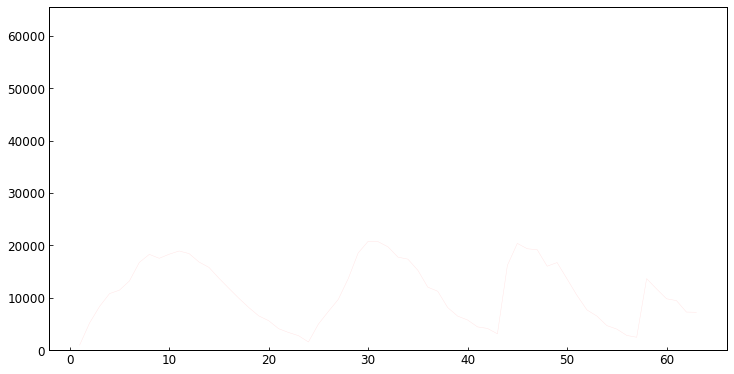

Cluster: 44


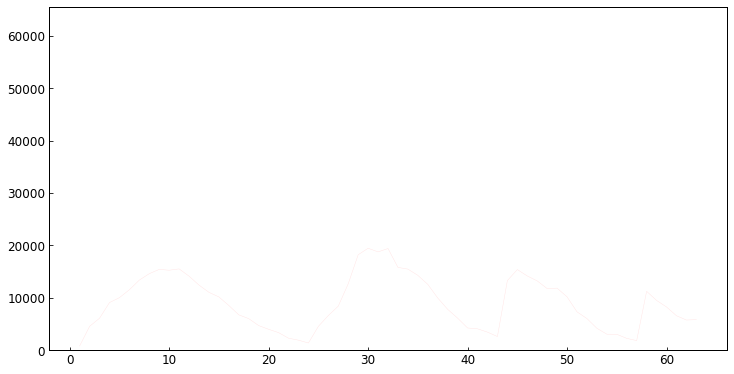

Cluster: 45


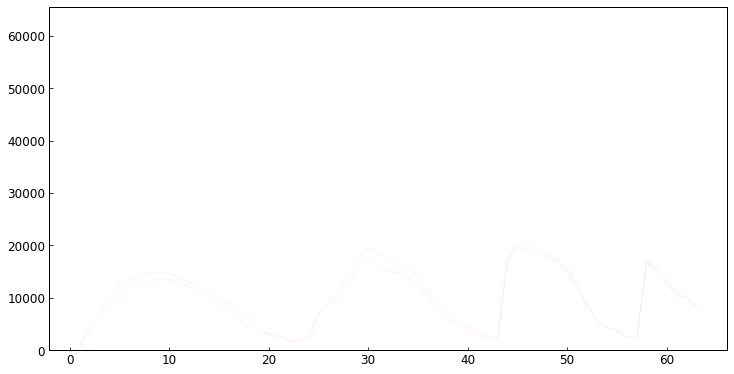

Cluster: 46


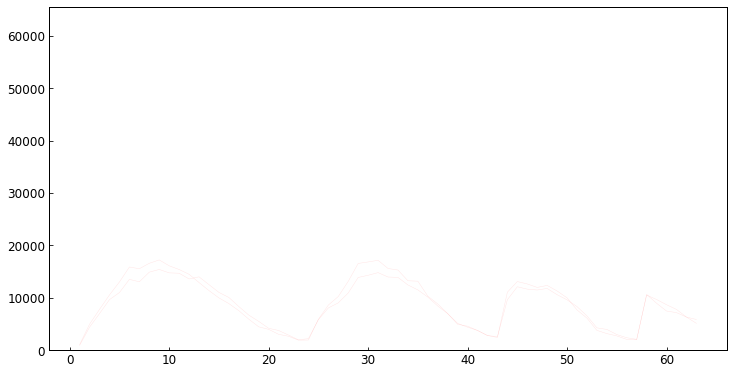

Cluster: 47


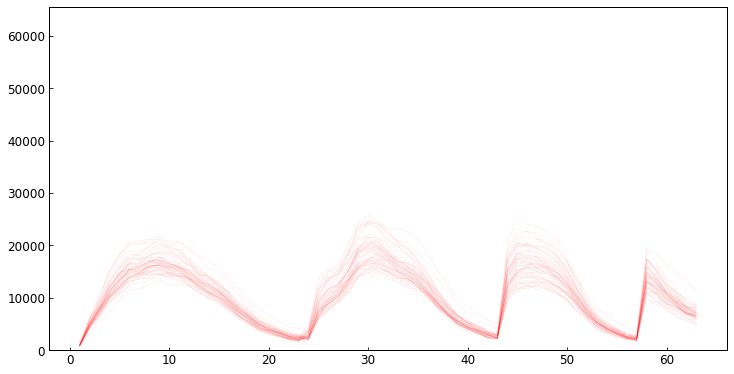

Cluster: 48


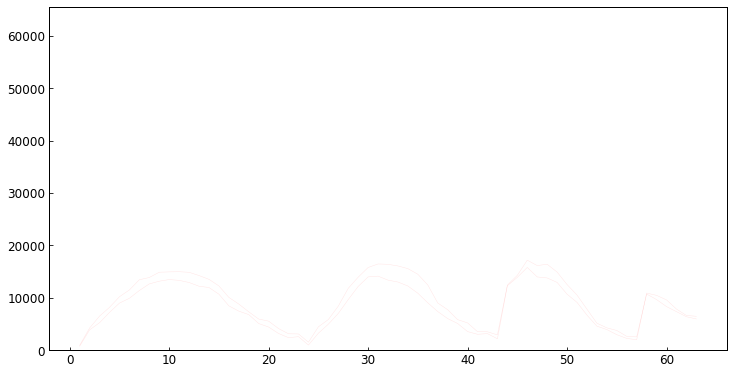

Cluster: 49


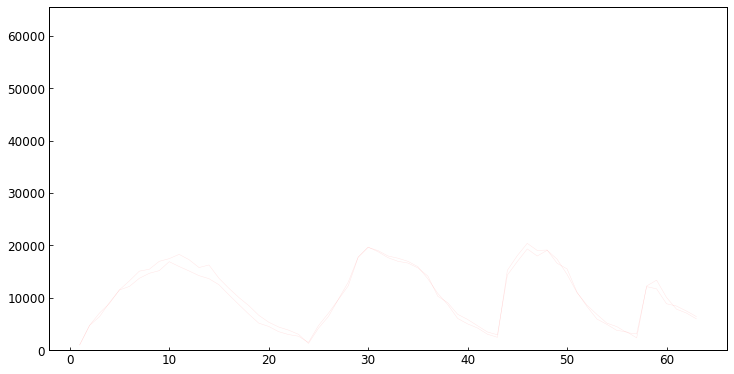

Cluster: 50


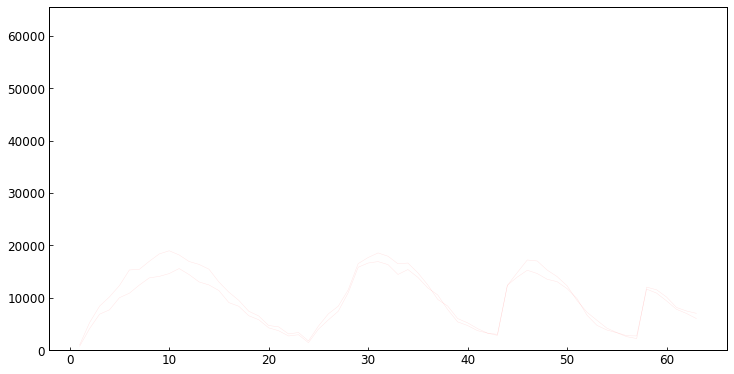

Cluster: 51


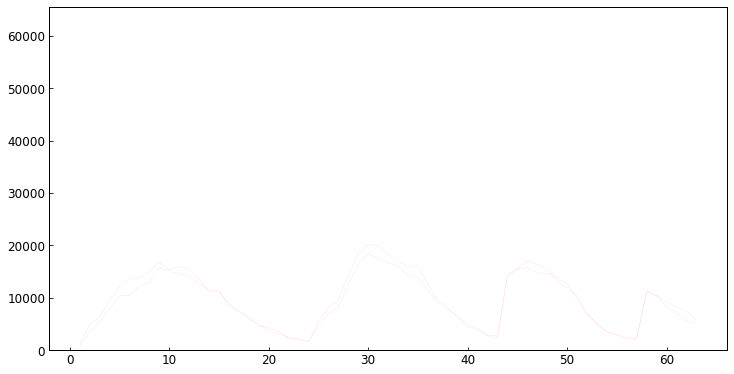

Cluster: 52


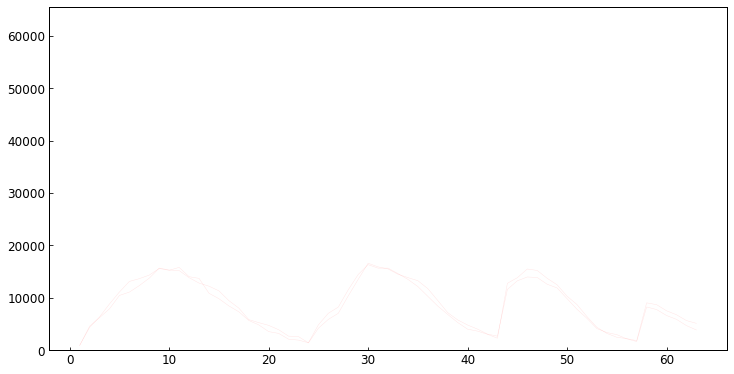

Cluster: 53


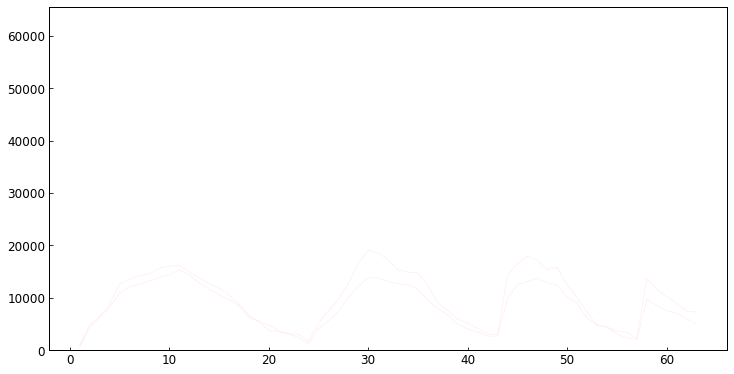

Cluster: 54


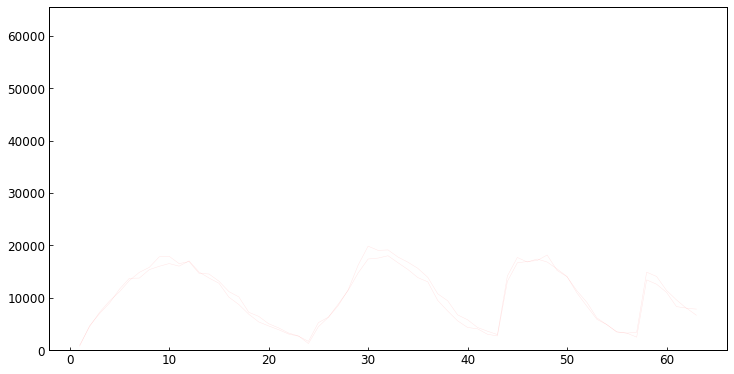

Cluster: 55


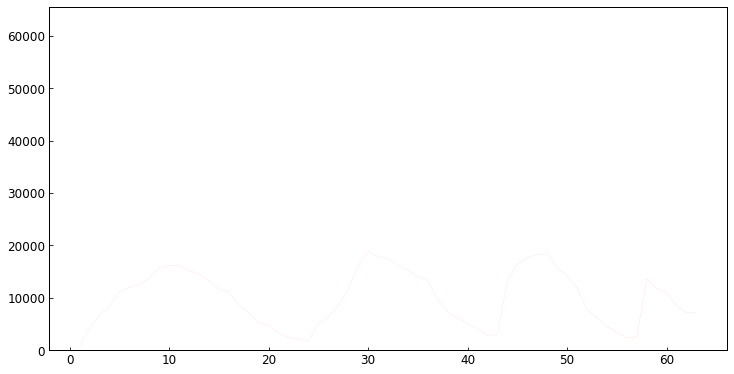

Cluster: 56


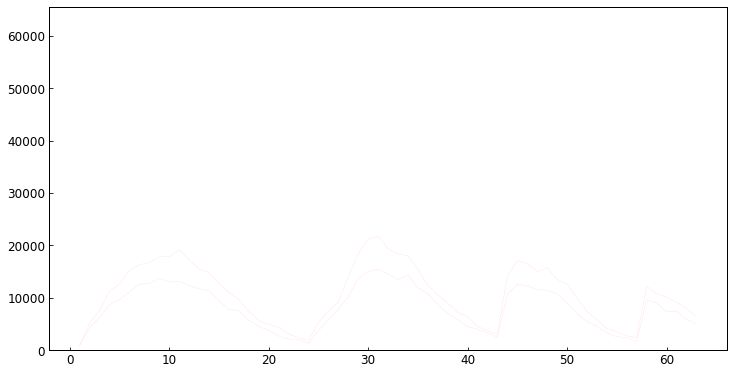

Cluster: 57


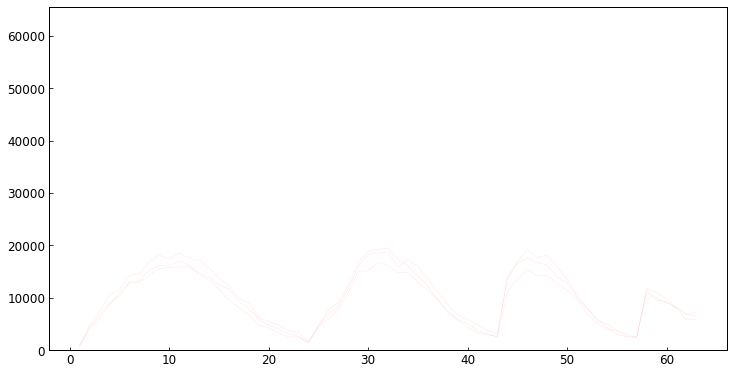

Cluster: 58


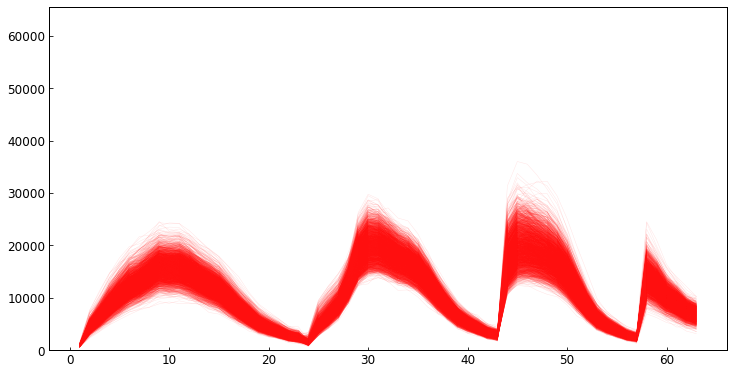

Cluster: 59


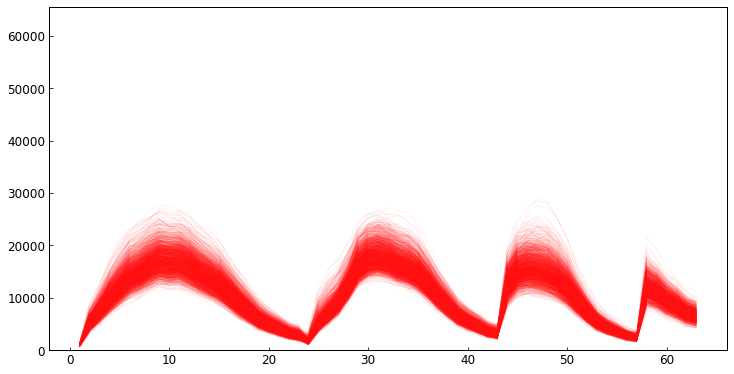

Cluster: 60


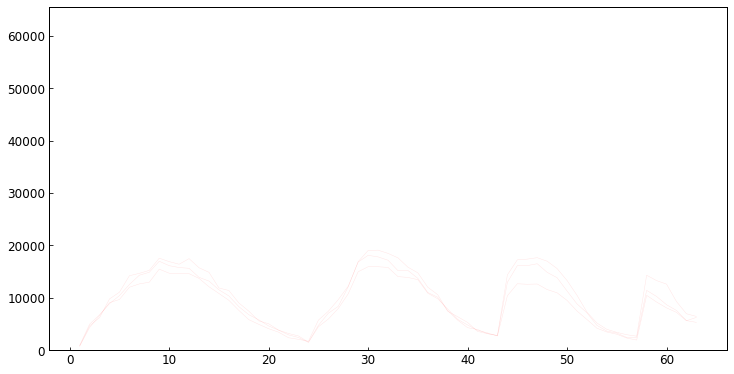

Cluster: 61


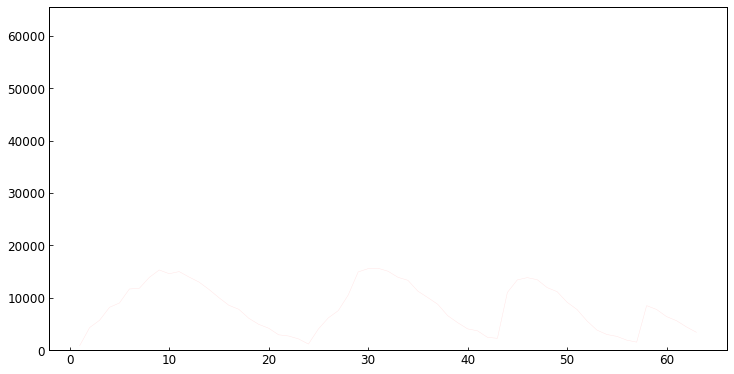

Cluster: 62


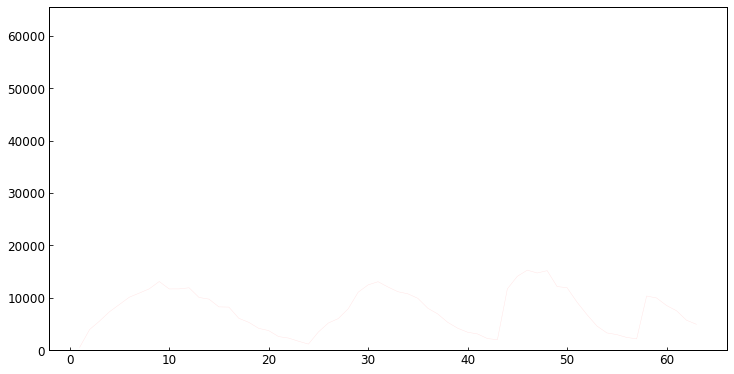

Cluster: 63


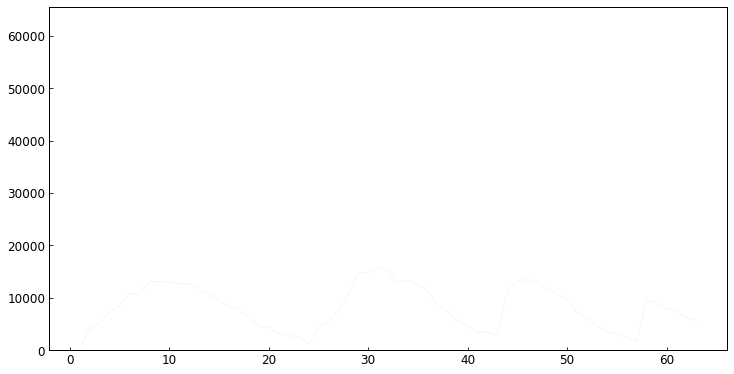

Cluster: 64


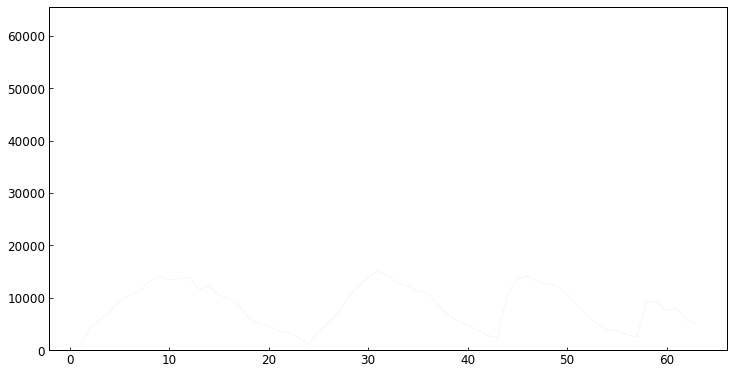

Cluster: 65


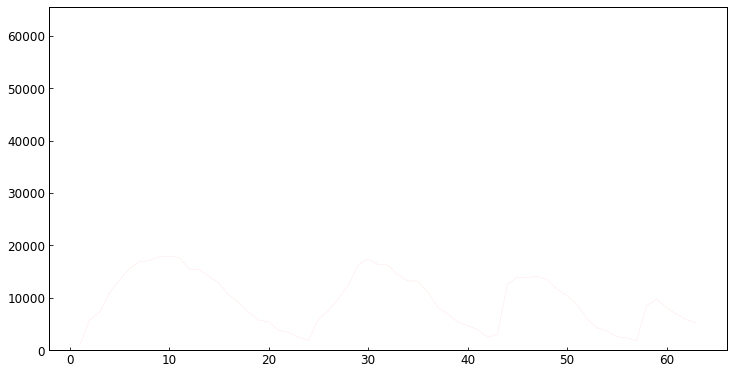

Cluster: 66


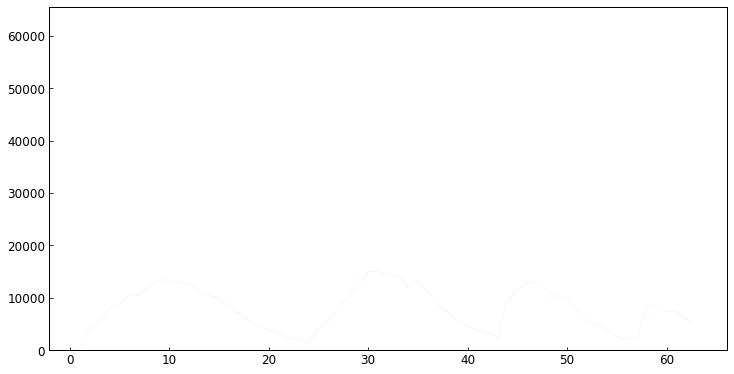

In [1181]:
spec_dims = (10,5)
for c in clust_unique:
    labels_sub = np.array(labels)[clust[i] == c]
    # if len(labels_sub) > 10:
    print("Cluster:",c) 
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.1,'color':'r'})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [1182]:
clust_change = [58,59]

clmx = np.max(clust_all)
clust_i_rename = clust_all.copy()
for c in clust_change:
    bool_c = clust[i] == c
    clmx += 1
    clust_i_rename[bool_c] = clmx

np.unique(clust_i_rename[bool_subclust])

array([4, 5, 6], dtype=int32)

In [1183]:
clust_all[bool_subclust] = clust_i_rename[bool_subclust]
np.unique(clust_all)


array([1, 2, 3, 4, 5, 6], dtype=int32)

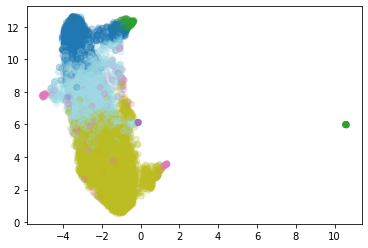

In [1184]:
# fit = umap.UMAP(metric='precomputed')
# u = fit.fit_transform(dist_mat)
plt.scatter(u[:,0], u[:,1], c=clust_all, alpha=0.25, cmap='tab20')
plt.show()
plt.close()

In [1185]:
dict_lab_clust = dict(zip(labels,clust_all))
colors = plt.get_cmap('tab10').colors
dict_clust_col = dict(zip(np.unique(clust_all), colors))

In [1186]:
seg = segs[m]
prop = props[m]
for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

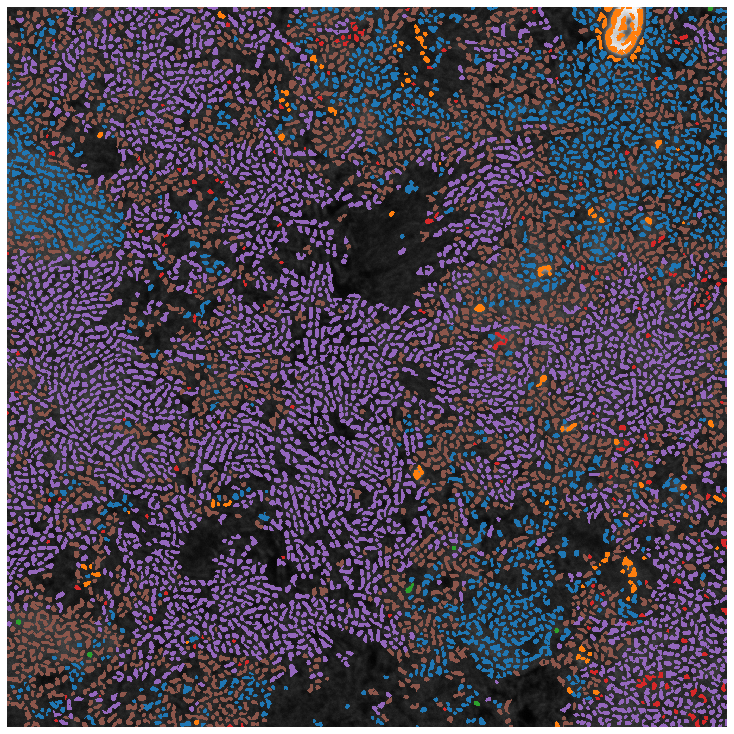

In [1187]:
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

Cluster: 1


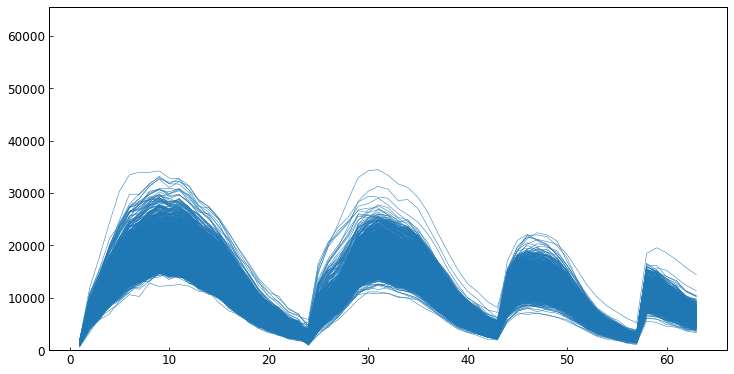

Cluster: 2


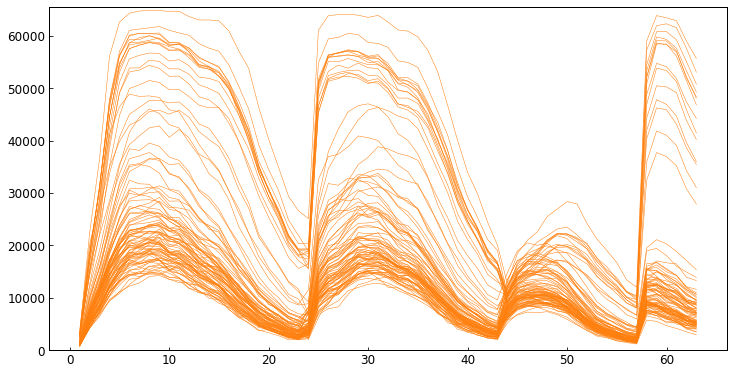

Cluster: 3


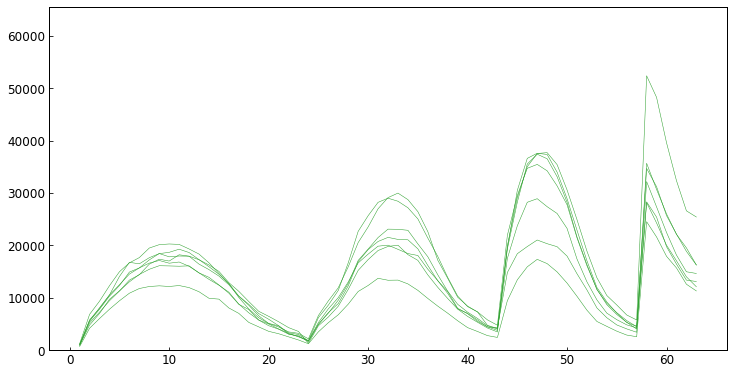

Cluster: 4


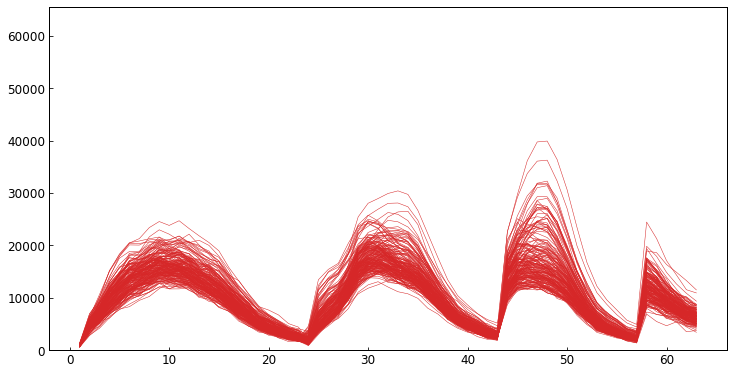

Cluster: 5


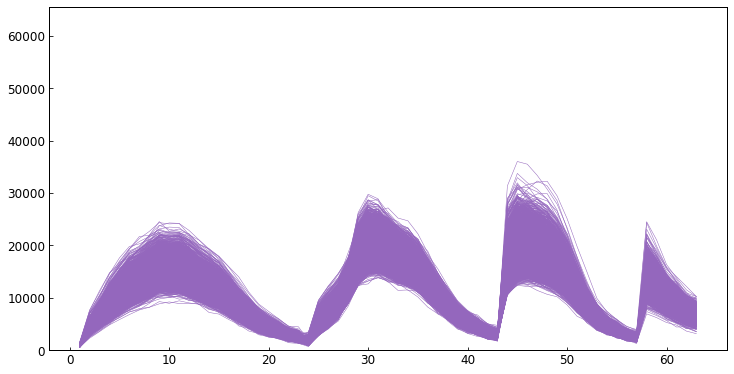

Cluster: 6


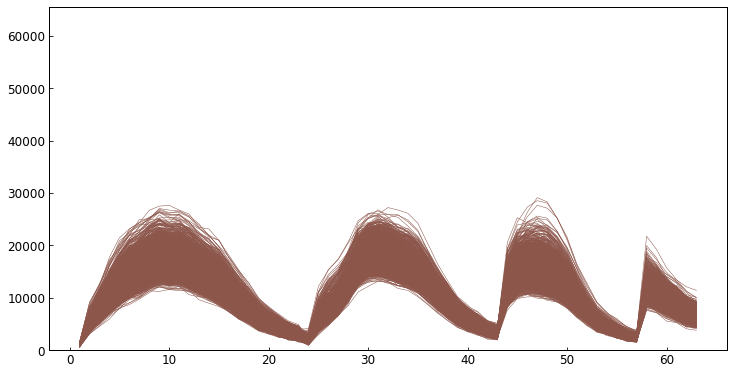

In [1188]:
for c in np.unique(clust_all):
    print('Cluster:', c)
    bool_c = clust_all == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':1,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [1055]:
i = 3
i_old = 1
sub_cl[i] = 1

In [1068]:
# pick a threshold for clustering
t[i] = 0.02525

In [1069]:
# cluster linkage into three groups
clust[i] = hierarchy.fcluster(linkage, t=t[i], criterion='distance')
bool_subclust = clust[i_old] == sub_cl[i]
clust_unique = np.unique(clust[i][bool_subclust])
clust_unique

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35], dtype=int32)

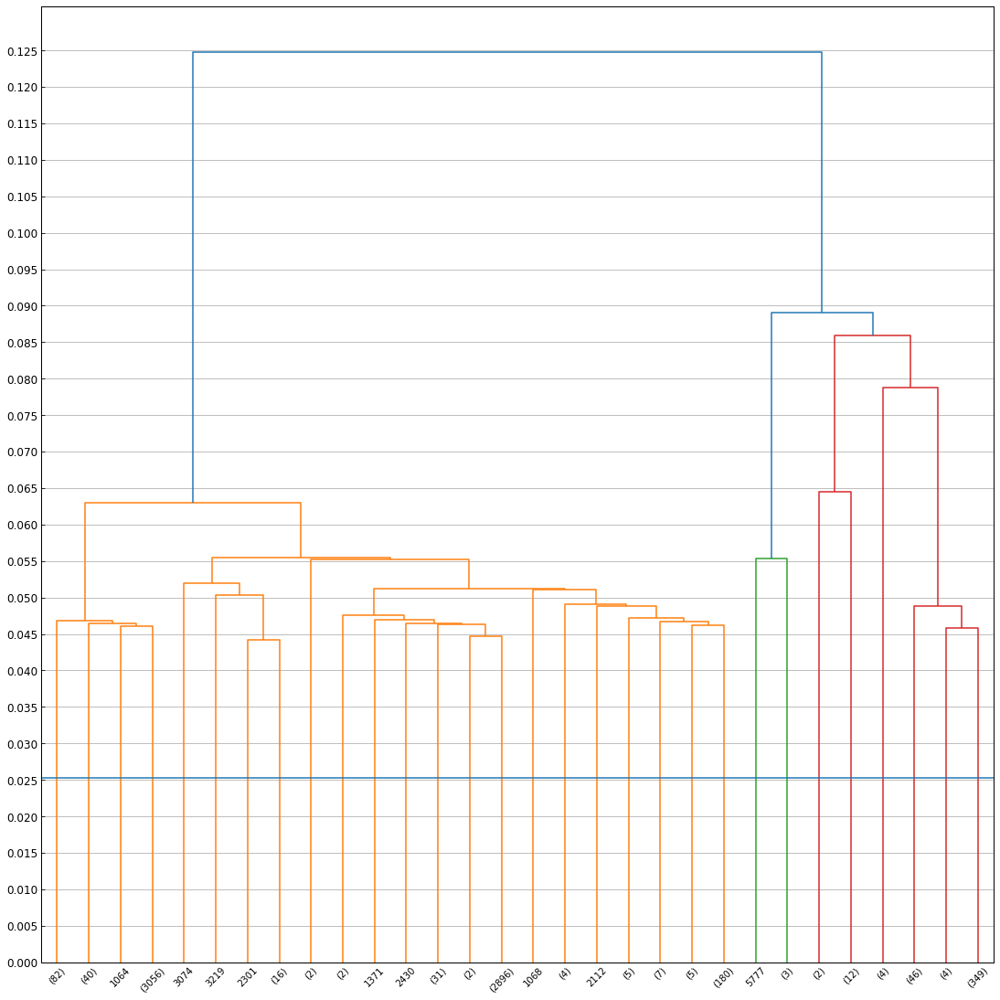

In [1070]:
fig, ax = ip.general_plot(dims=(15,15))
dn = hierarchy.dendrogram(linkage, labels=labels, truncate_mode='lastp')
ax.axhline(t[i])
ylims = [round(l,2) for l in ax.get_ylim()]
ax.set_yticks(np.arange(ylims[0],ylims[1],0.005))
ax.grid(axis='y')
plt.show()
plt.close()

Cluster: 4


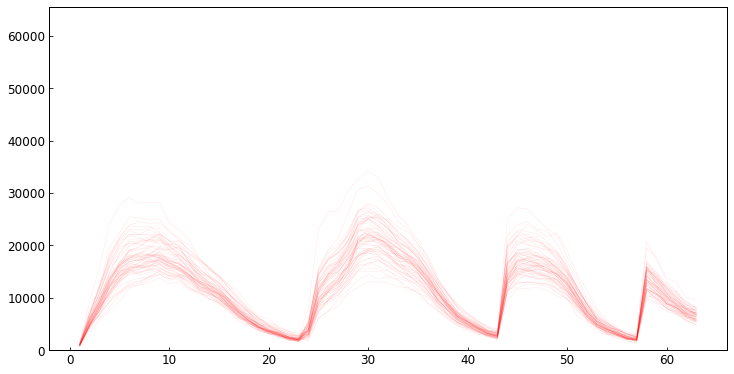

Cluster: 7


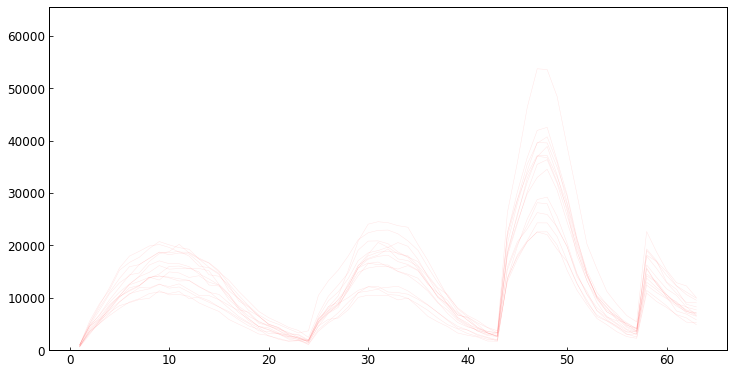

Cluster: 8


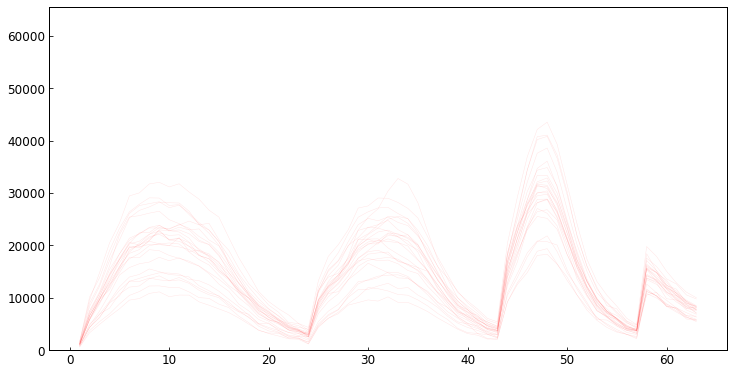

Cluster: 29


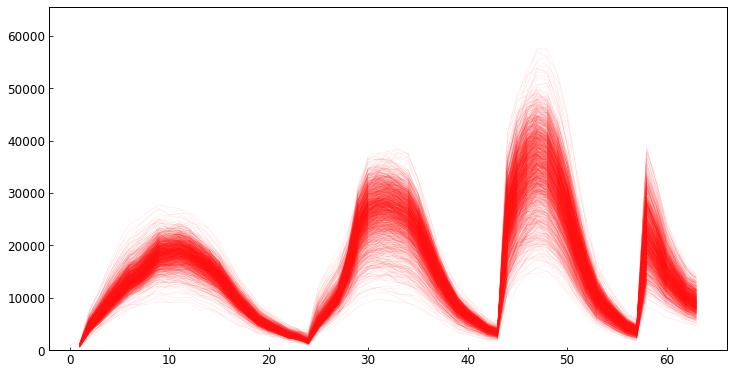

Cluster: 30


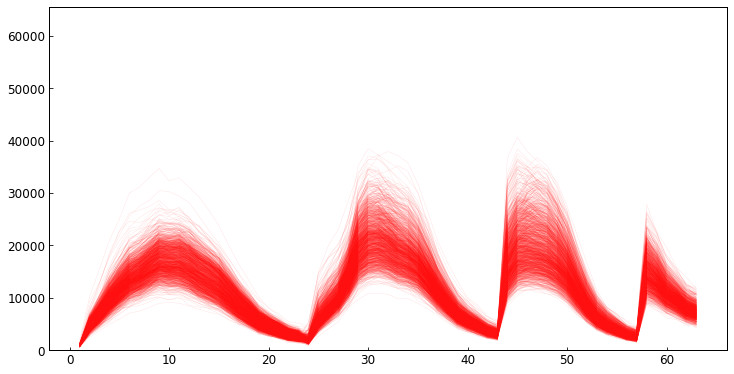

In [1063]:
spec_dims = (10,5)
for c in clust_unique:
    labels_sub = np.array(labels)[clust[i] == c]
    if len(labels_sub) > 10:
        print("Cluster:",c) 
        spec_sub = []
        for l in labels_sub:
            s = dict_lab_specmean[l]
            spec_sub.append(s)
        spec_sub = np.vstack(spec_sub)
        fig, ax = ip.general_plot(dims=spec_dims)
        fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.1,'color':'r'})
        ax.set_ylim(0,2**16)
        plt.plot()
        plt.show()

In [1071]:
clust_change = [4,7,8,29,30]

clmx = np.max(clust_all)
clust_i_rename = clust_all.copy()
for c in clust_change:
    bool_c = clust[i] == c
    clmx += 1
    clust_i_rename[bool_c] = clmx

np.unique(clust_i_rename[bool_subclust])

array([ 1,  7,  8,  9, 10, 11], dtype=int32)

In [1072]:
clust_all[bool_subclust] = clust_i_rename[bool_subclust]
np.unique(clust_all)


array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11], dtype=int32)

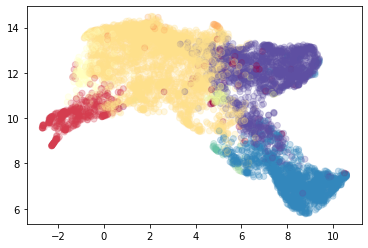

In [1073]:
# fit = umap.UMAP(metric='precomputed')
# u = fit.fit_transform(dist_mat)
plt.scatter(u[:,0], u[:,1], c=clust_all, alpha=0.25, cmap='Spectral')
plt.show()
plt.close()

In [1076]:
dict_lab_clust = dict(zip(labels,clust_all))
colors = plt.get_cmap('tab20').colors
dict_clust_col = dict(zip(np.unique(clust_all), colors))

In [1077]:
seg = segs[m]
prop = props[m]
for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

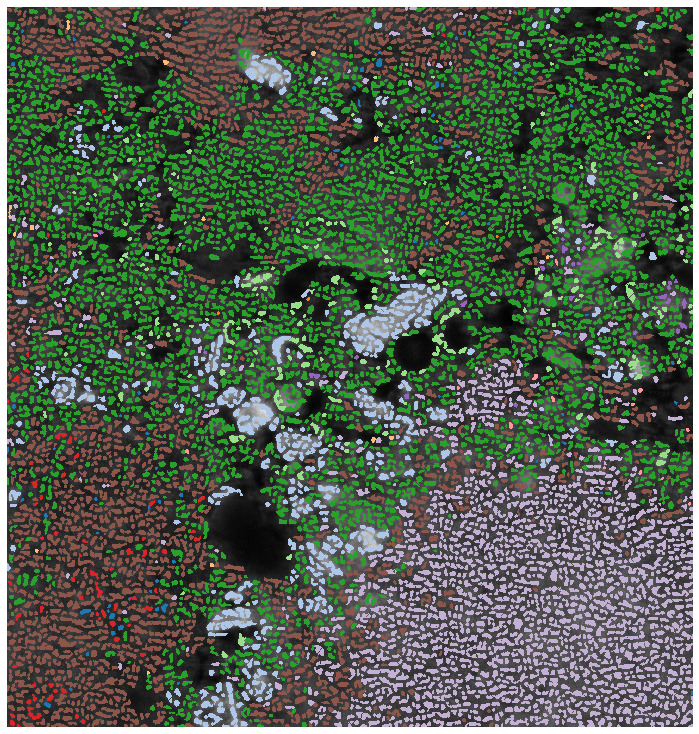

In [1078]:
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

Cluster: 1


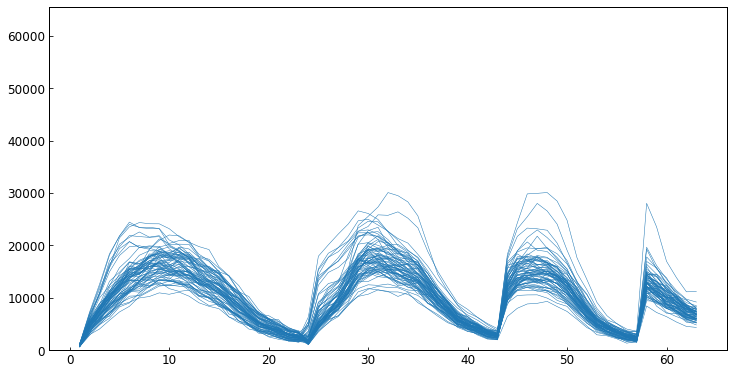

Cluster: 2


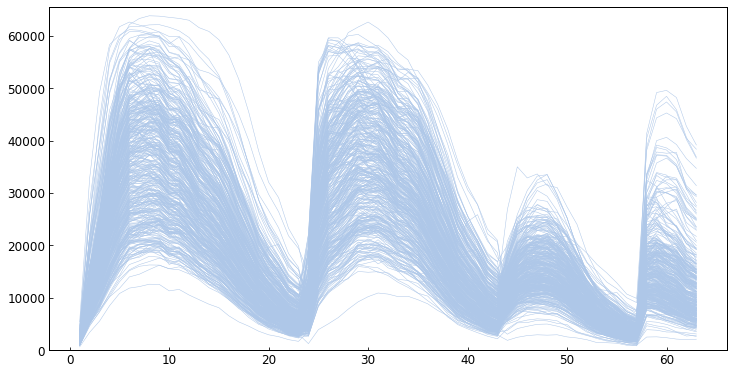

Cluster: 3


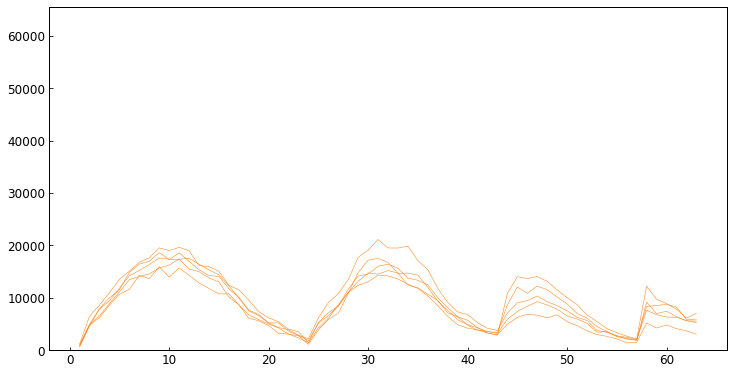

Cluster: 4


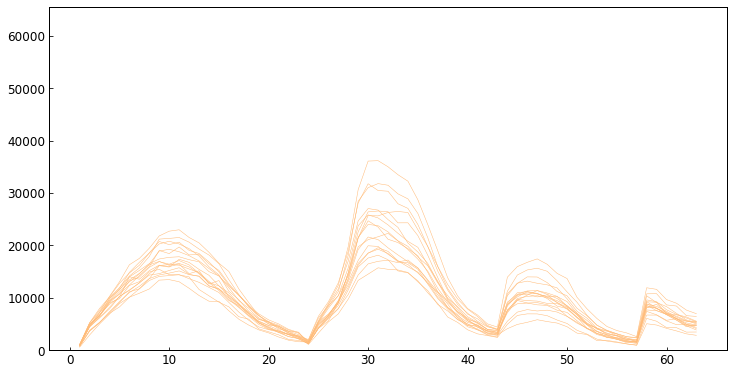

Cluster: 5


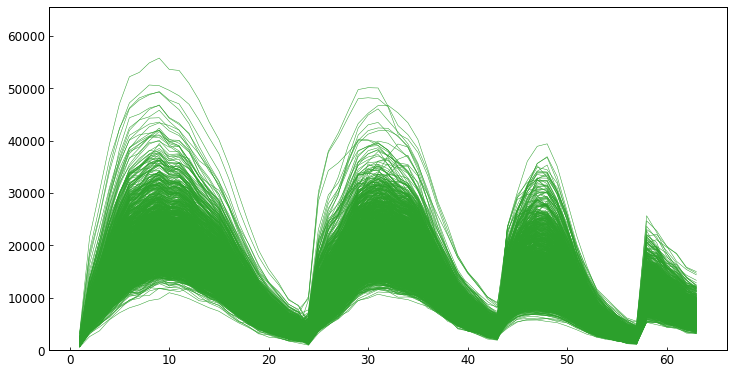

Cluster: 6


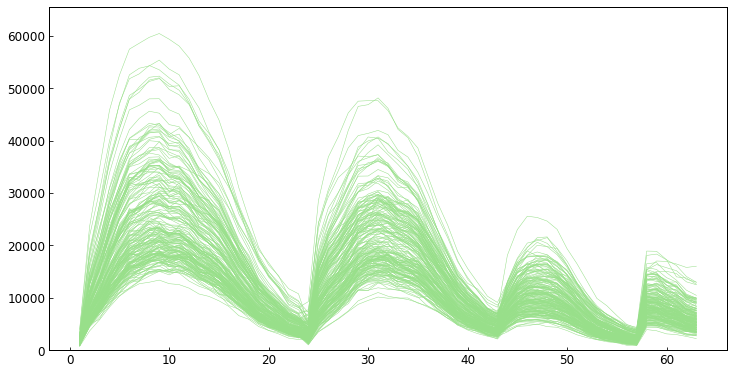

Cluster: 7


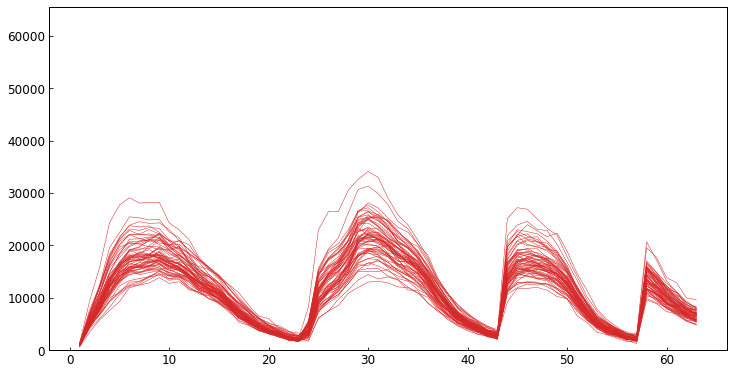

Cluster: 8


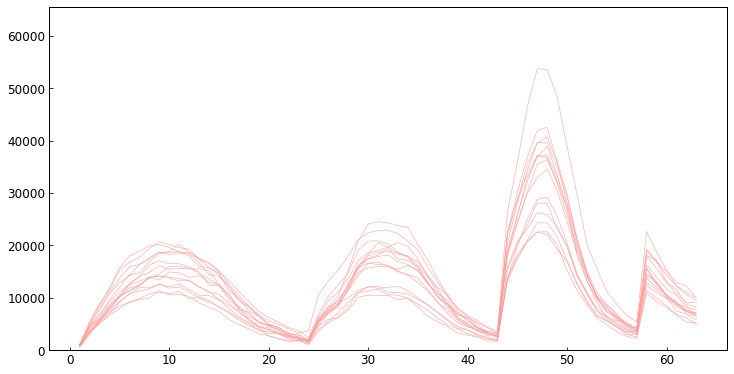

Cluster: 9


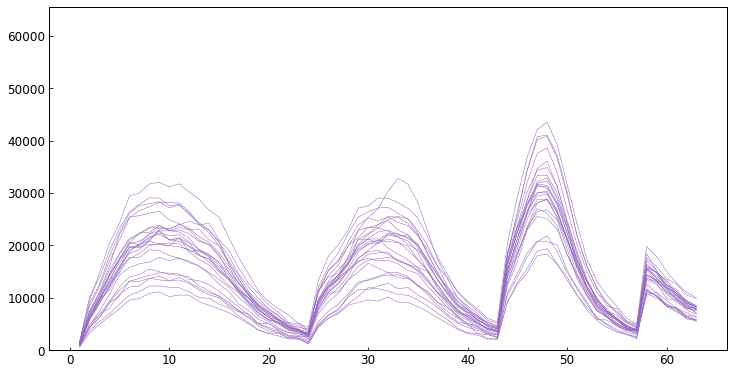

Cluster: 10


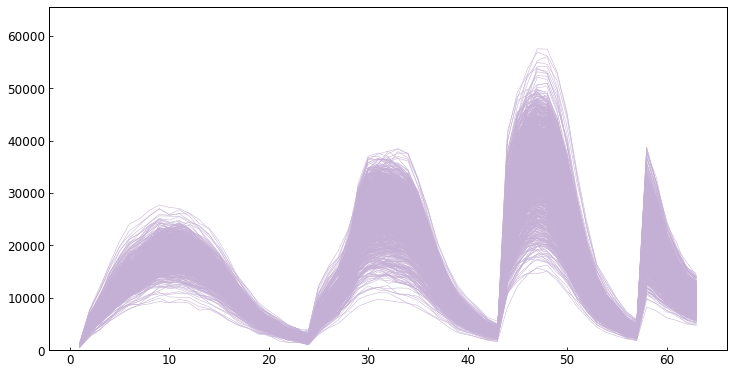

Cluster: 11


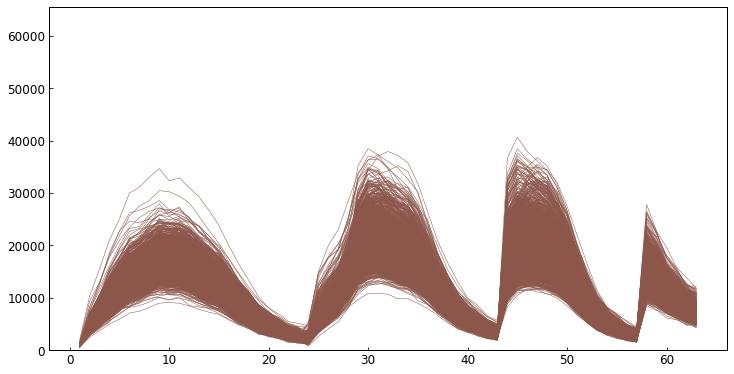

In [1079]:
for c in np.unique(clust_all):
    print('Cluster:', c)
    bool_c = clust_all == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':1,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [1080]:
i = 4
i_old = 3
sub_cl[i] = 30

In [1101]:
# pick a threshold for clustering
t[i] = 0.02125

In [1102]:
# cluster linkage into three groups
clust[i] = hierarchy.fcluster(linkage, t=t[i], criterion='distance')
bool_subclust = clust[i_old] == sub_cl[i]
clust_unique = np.unique(clust[i][bool_subclust])
clust_unique

array([55, 56, 57, 58, 59, 60, 61], dtype=int32)

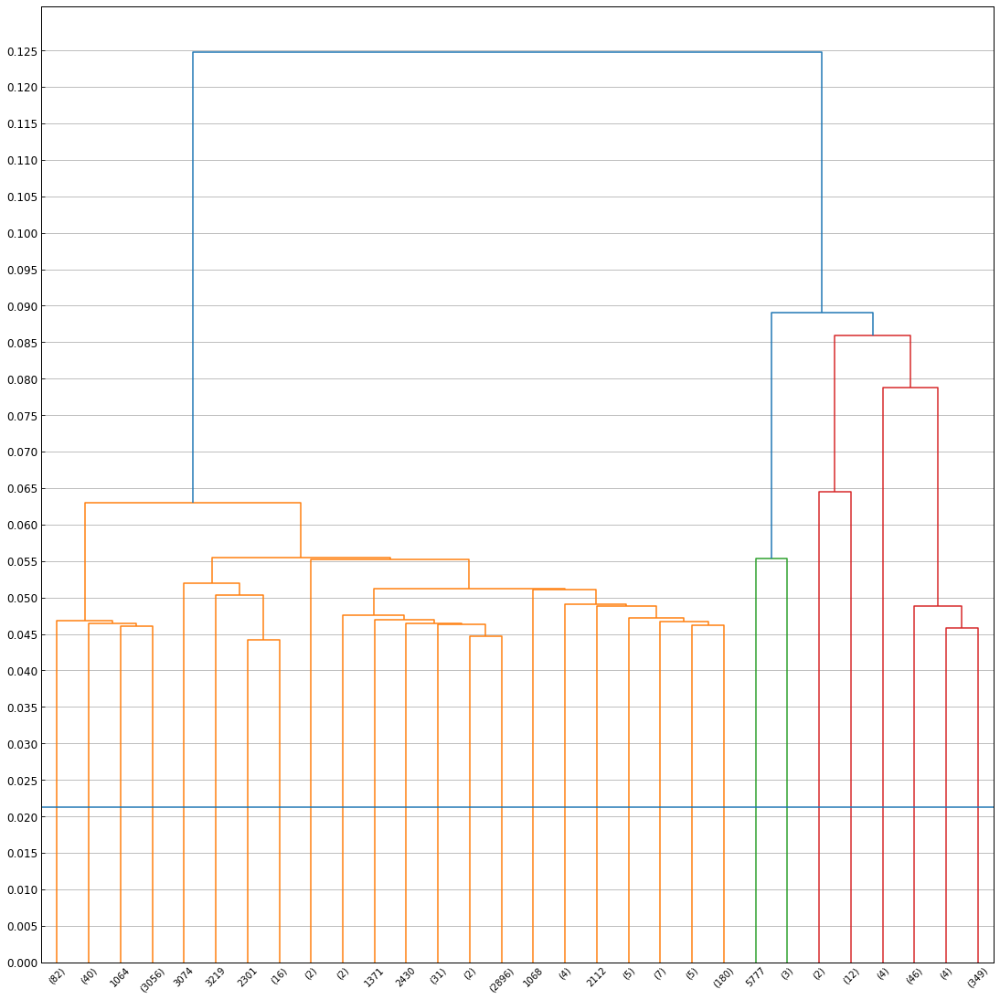

In [1103]:
fig, ax = ip.general_plot(dims=(15,15))
dn = hierarchy.dendrogram(linkage, labels=labels, truncate_mode='lastp')
ax.axhline(t[i])
ylims = [round(l,2) for l in ax.get_ylim()]
ax.set_yticks(np.arange(ylims[0],ylims[1],0.005))
ax.grid(axis='y')
plt.show()
plt.close()

Cluster: 57


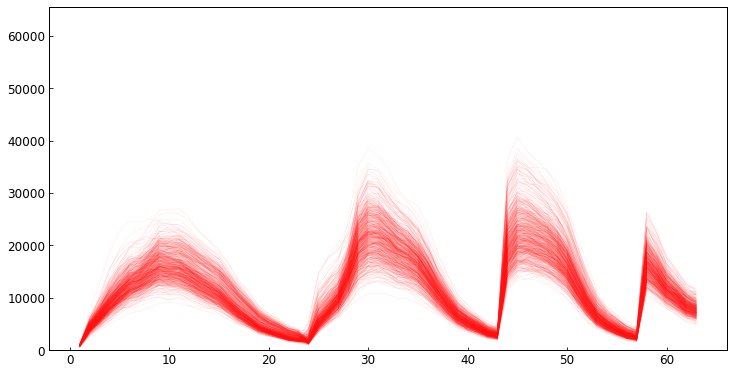

Cluster: 59


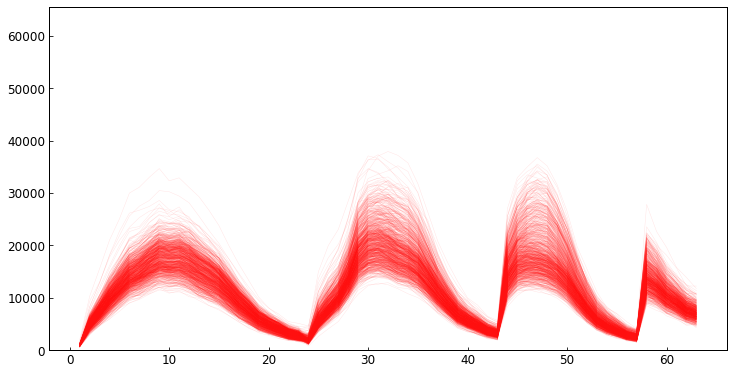

In [1104]:
spec_dims = (10,5)
for c in clust_unique:
    labels_sub = np.array(labels)[clust[i] == c]
    if len(labels_sub) > 10:
        print("Cluster:",c) 
        spec_sub = []
        for l in labels_sub:
            s = dict_lab_specmean[l]
            spec_sub.append(s)
        spec_sub = np.vstack(spec_sub)
        fig, ax = ip.general_plot(dims=spec_dims)
        fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.1,'color':'r'})
        ax.set_ylim(0,2**16)
        plt.plot()
        plt.show()

In [1105]:
clust_change = [59]

clmx = np.max(clust_all)
clust_i_rename = clust[i_old].copy()
for c in clust_change:
    bool_c = clust[i] == c
    clmx += 1
    clust_i_rename[bool_c] = clmx

np.unique(clust_i_rename[bool_subclust])

array([12, 30], dtype=int32)

In [1106]:
clust_all[bool_subclust] = clust_i_rename[bool_subclust]
np.unique(clust_all)


array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12, 30], dtype=int32)

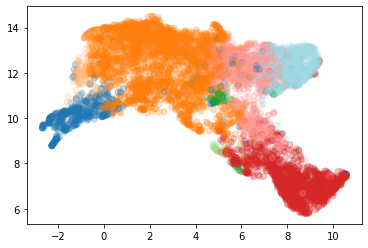

In [1109]:
# fit = umap.UMAP(metric='precomputed')
# u = fit.fit_transform(dist_mat)
plt.scatter(u[:,0], u[:,1], c=clust_all, alpha=0.25, cmap='tab20')
plt.show()
plt.close()

In [1114]:
dict_lab_clust = dict(zip(labels,clust_all))
colors = plt.get_cmap('tab20').colors
dict_clust_col = dict(zip(np.unique(clust_all), colors))

In [1115]:
seg = segs[m]
prop = props[m]
for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

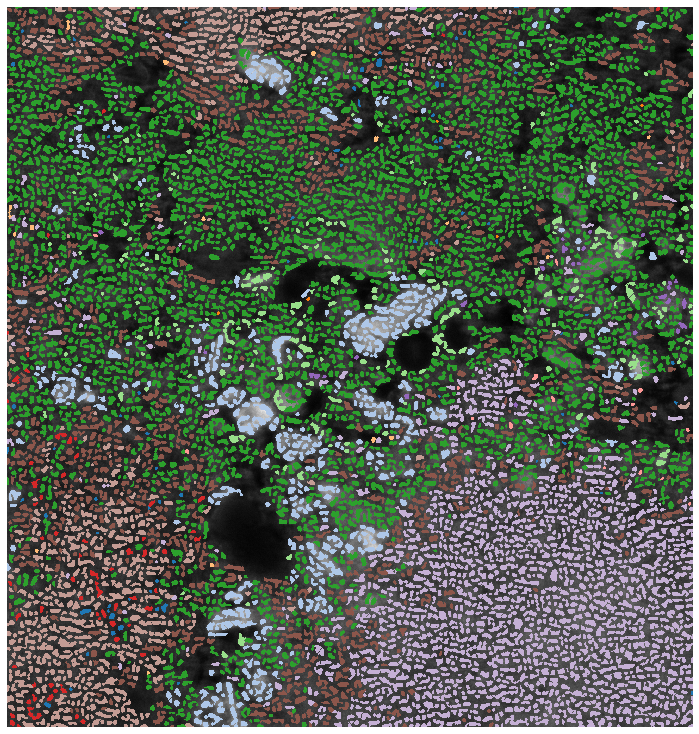

In [1116]:
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

Cluster: 1


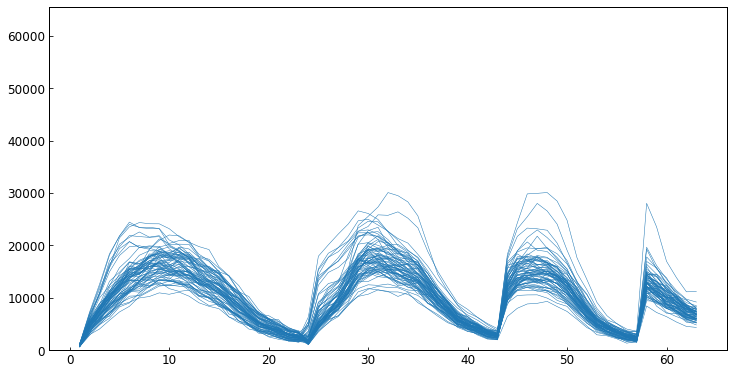

Cluster: 2


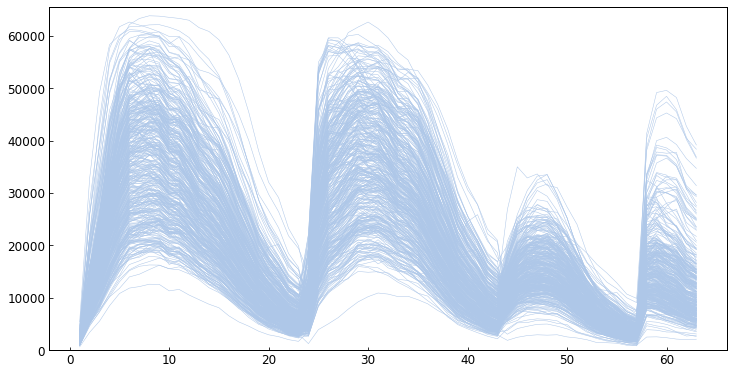

Cluster: 3


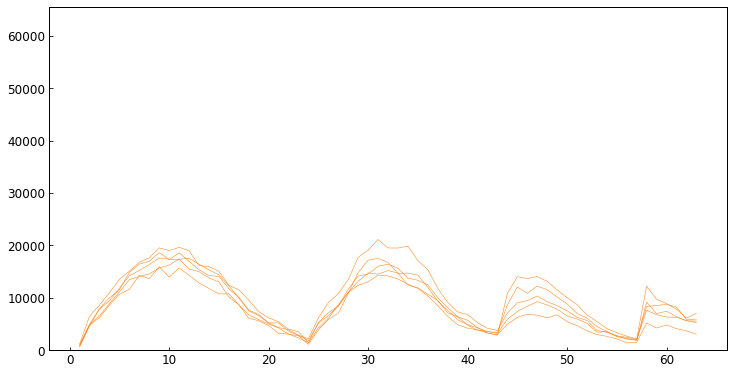

Cluster: 4


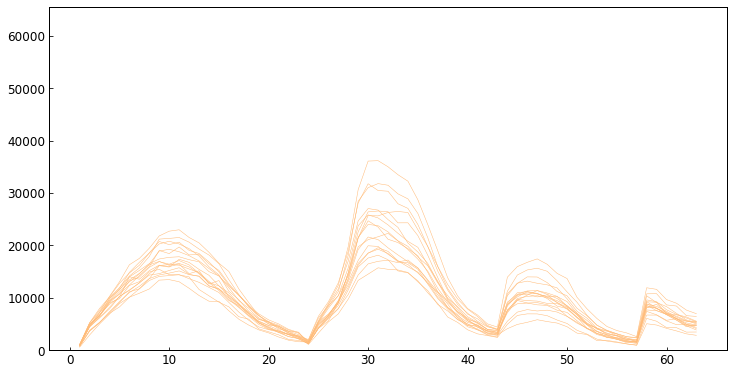

Cluster: 5


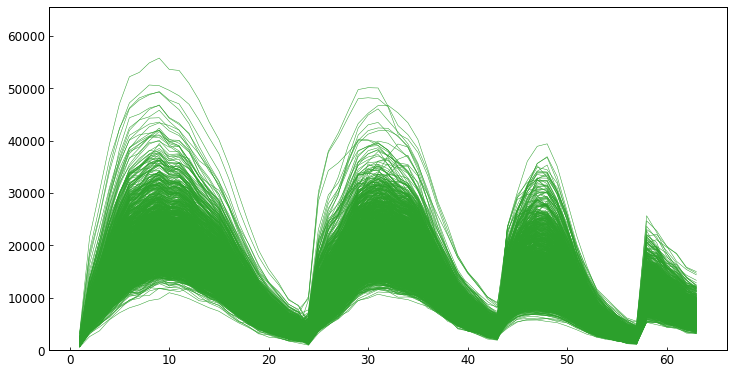

Cluster: 6


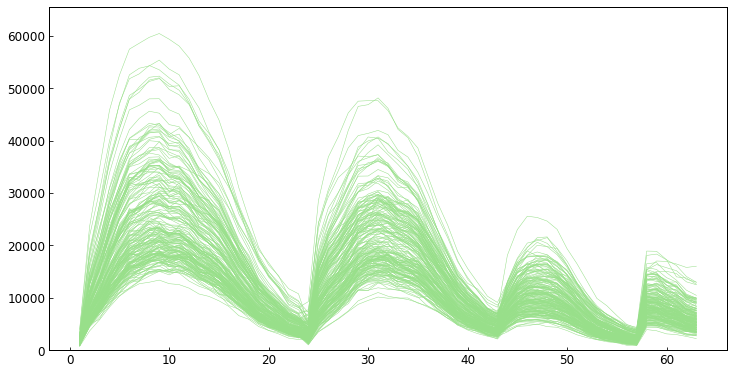

Cluster: 7


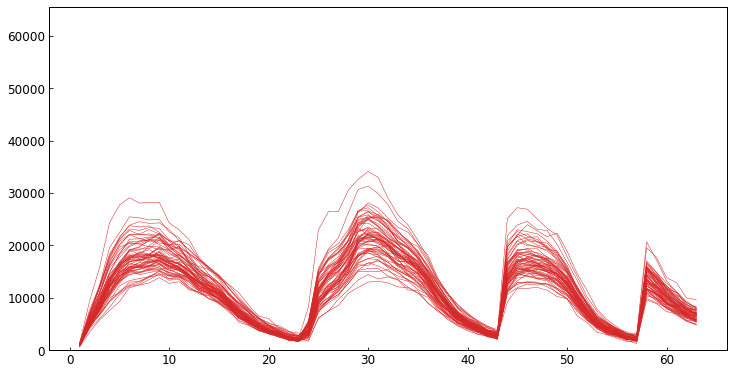

Cluster: 8


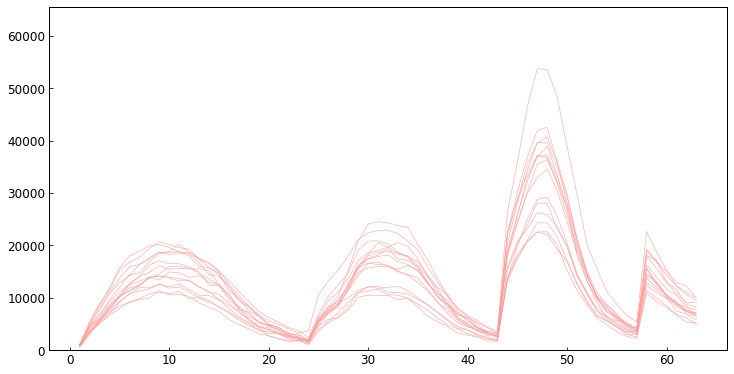

Cluster: 9


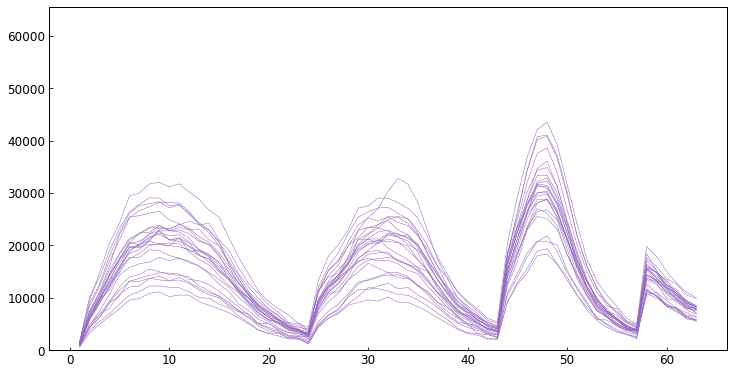

Cluster: 10


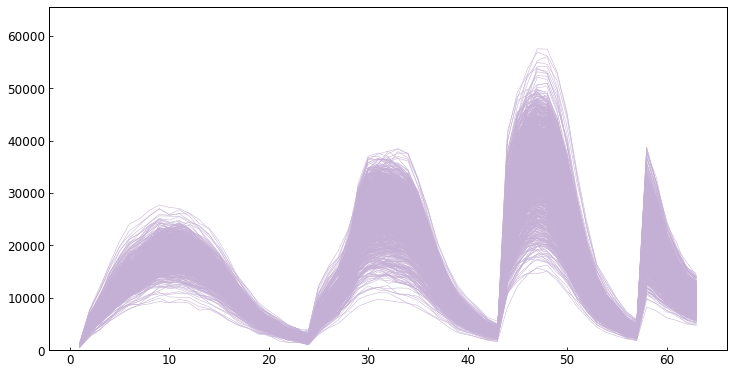

Cluster: 12


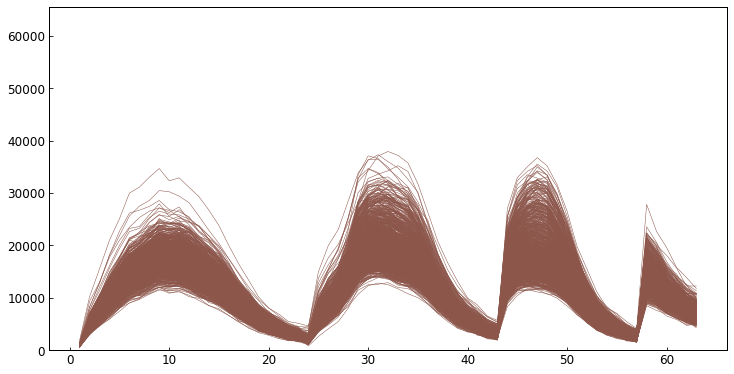

Cluster: 30


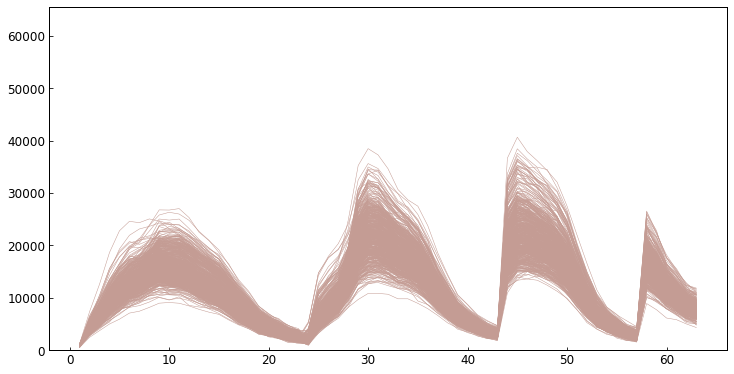

In [1117]:
for c in np.unique(clust_all):
    print('Cluster:', c)
    bool_c = clust_all == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':1,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [1118]:
i = 5
i_old = 3
sub_cl[i] = 29

In [1121]:
# pick a threshold for clustering
t[i] = 0.019

In [1122]:
# cluster linkage into three groups
clust[i] = hierarchy.fcluster(linkage, t=t[i], criterion='distance')
bool_subclust = clust[i_old] == sub_cl[i]
clust_unique = np.unique(clust[i][bool_subclust])
clust_unique

array([61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72], dtype=int32)

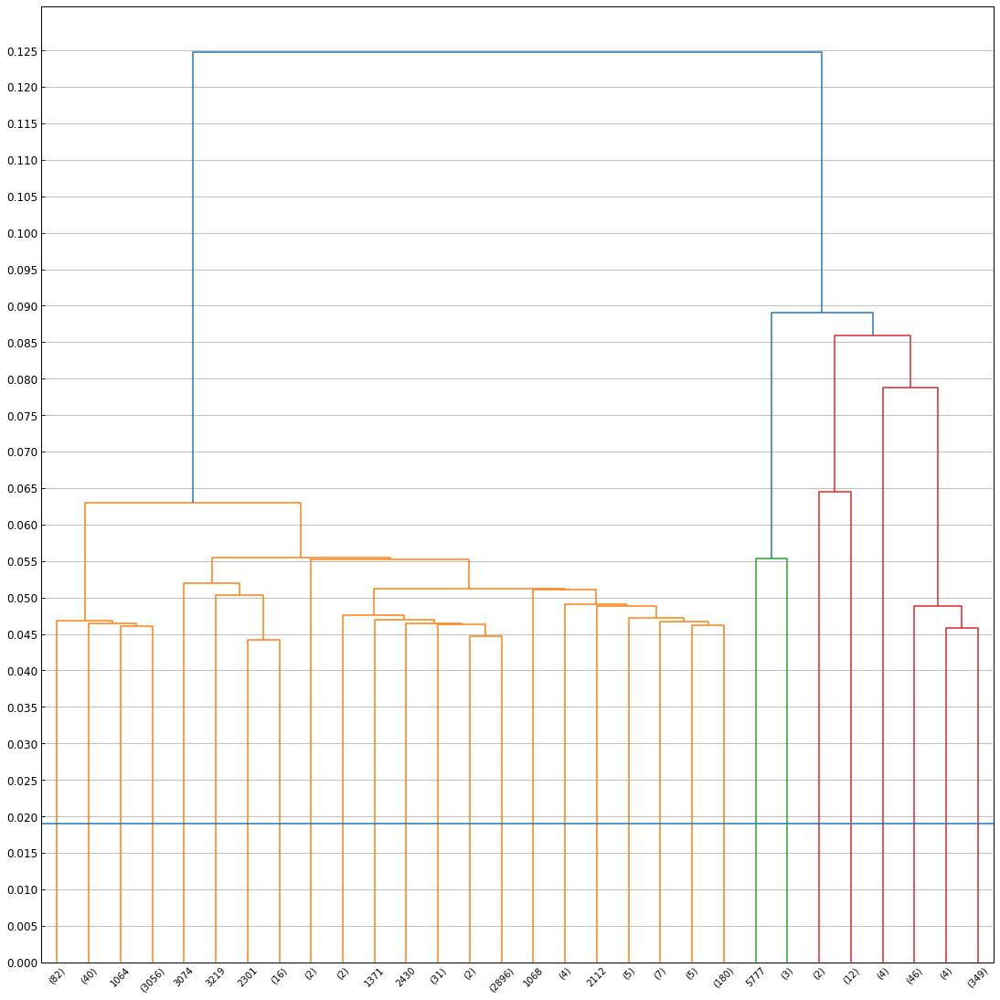

In [1123]:
fig, ax = ip.general_plot(dims=(15,15))
dn = hierarchy.dendrogram(linkage, labels=labels, truncate_mode='lastp')
ax.axhline(t[i])
ylims = [round(l,2) for l in ax.get_ylim()]
ax.set_yticks(np.arange(ylims[0],ylims[1],0.005))
ax.grid(axis='y')
plt.show()
plt.close()

Cluster: 67


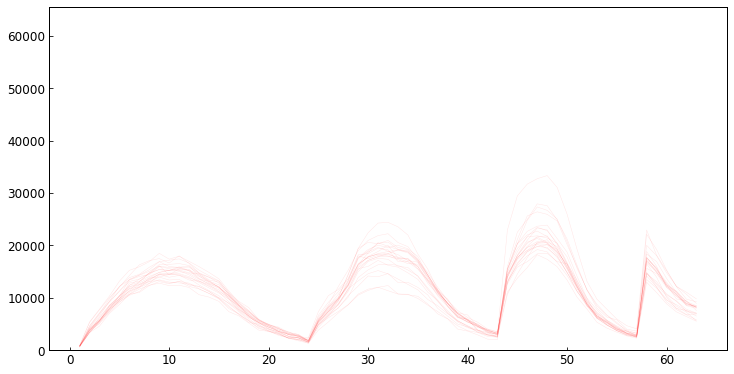

Cluster: 69


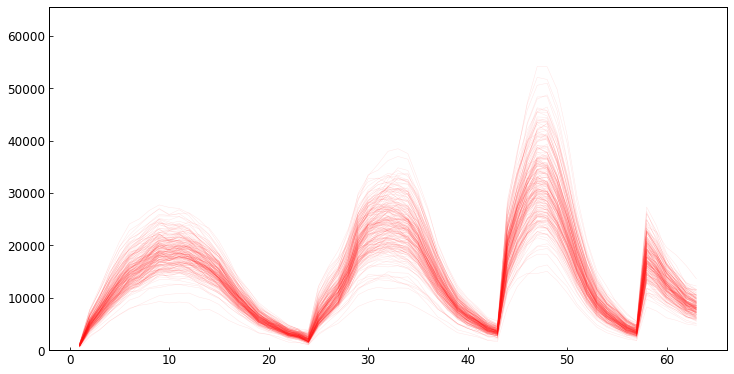

Cluster: 70


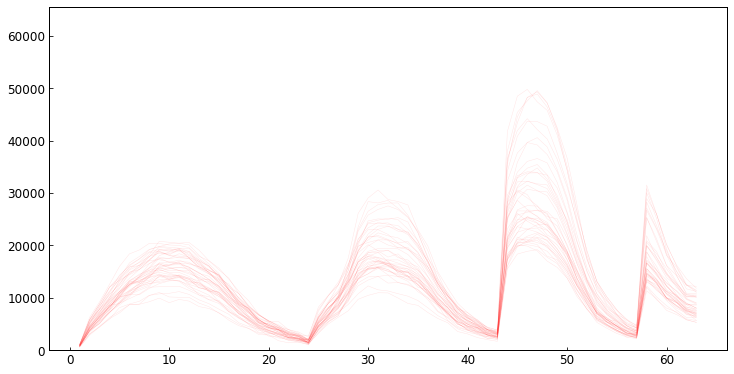

Cluster: 71


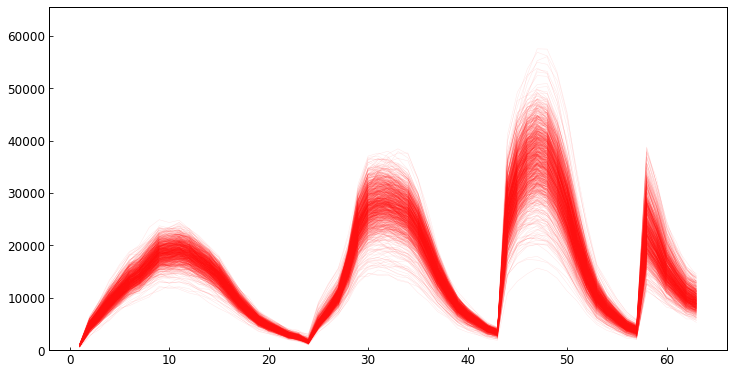

In [1124]:
spec_dims = (10,5)
for c in clust_unique:
    labels_sub = np.array(labels)[clust[i] == c]
    if len(labels_sub) > 10:
        print("Cluster:",c) 
        spec_sub = []
        for l in labels_sub:
            s = dict_lab_specmean[l]
            spec_sub.append(s)
        spec_sub = np.vstack(spec_sub)
        fig, ax = ip.general_plot(dims=spec_dims)
        fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.1,'color':'r'})
        ax.set_ylim(0,2**16)
        plt.plot()
        plt.show()

In [759]:
clust_change = [10,11]

clmx = np.max(clust_all)
clust_i_rename = clust[i_old].copy()
for c in clust_change:
    bool_c = clust[i] == c
    clmx += 1
    clust_i_rename[bool_c] = clmx

np.unique(clust_i_rename[bool_subclust])

array([12, 13], dtype=int32)

In [760]:
clust_all[bool_subclust] = clust_i_rename[bool_subclust]
np.unique(clust_all)


array([ 1,  2,  3,  4,  5,  6,  8,  9, 11, 12, 13], dtype=int32)

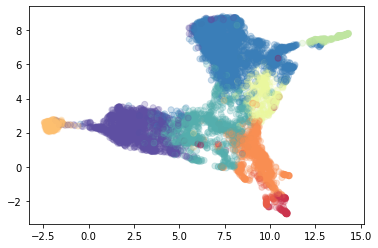

In [761]:
# fit = umap.UMAP(metric='precomputed')
# u = fit.fit_transform(dist_mat)
plt.scatter(u[:,0], u[:,1], c=clust_all, alpha=0.25, cmap='Spectral')
plt.show()
plt.close()

In [763]:
dict_lab_clust = dict(zip(labels,clust_all))
colors = plt.get_cmap('tab20').colors
dict_clust_col = dict(zip(np.unique(clust_all), colors))

In [764]:
seg = segs[m]
prop = props[m]
for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

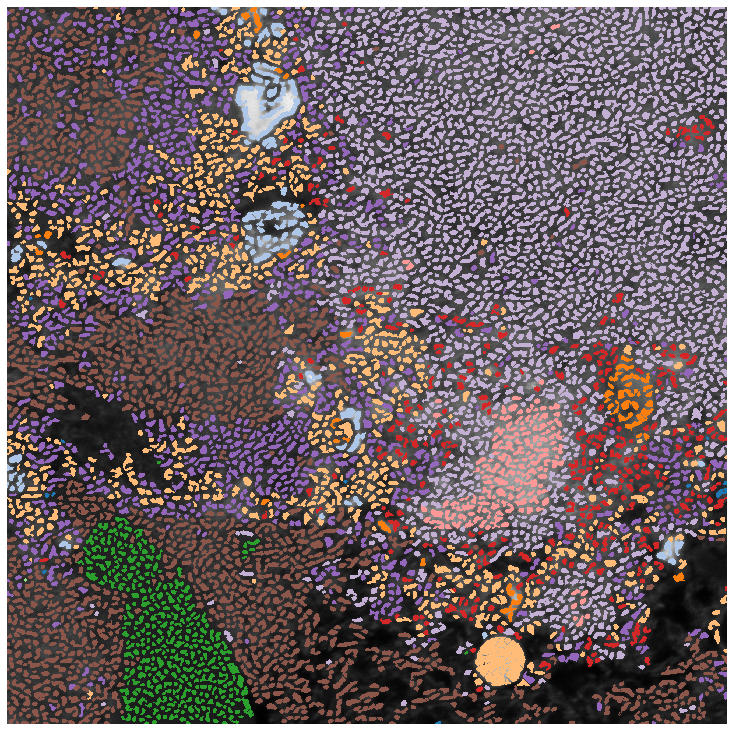

In [765]:
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

Cluster: 1


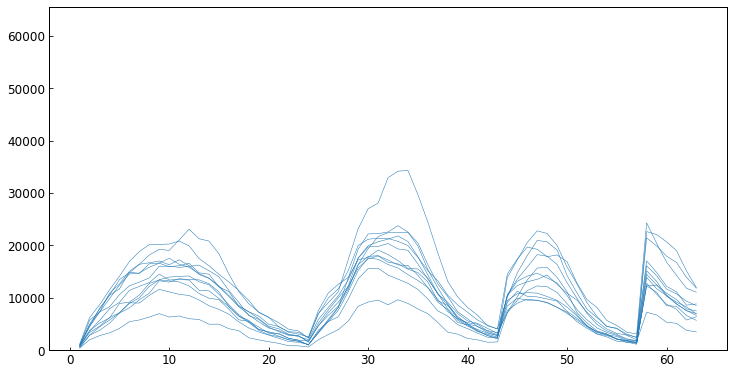

Cluster: 2


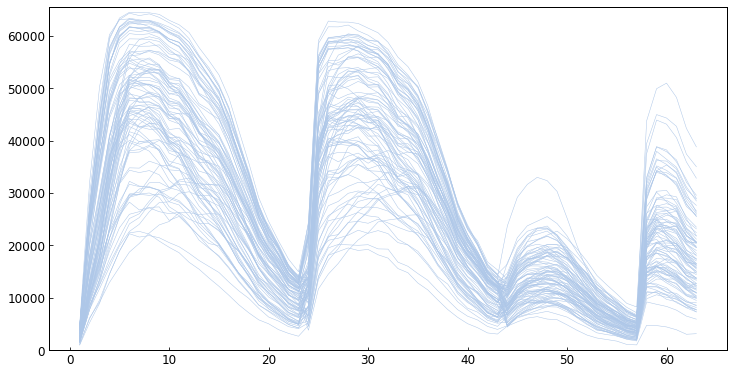

Cluster: 3


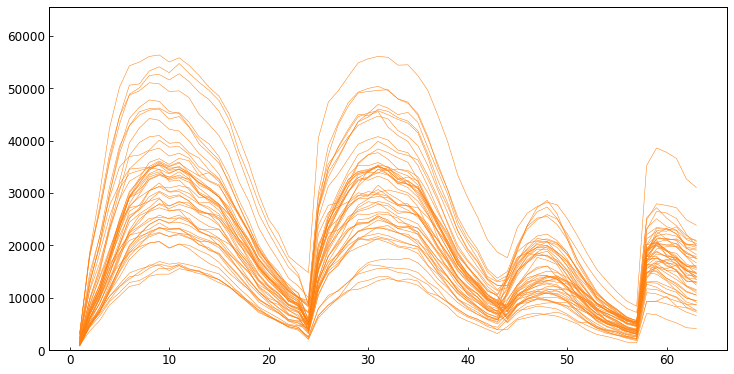

Cluster: 4


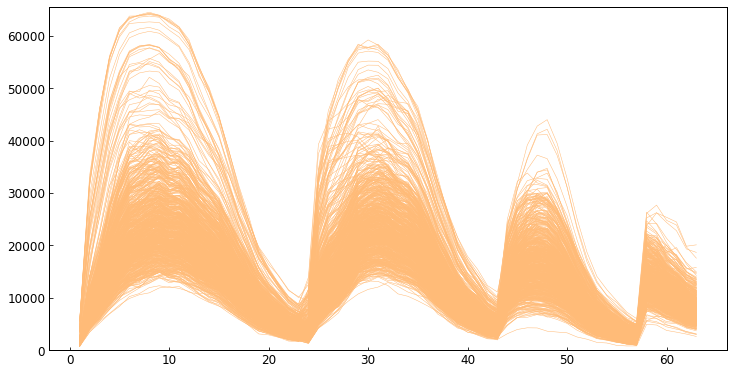

Cluster: 5


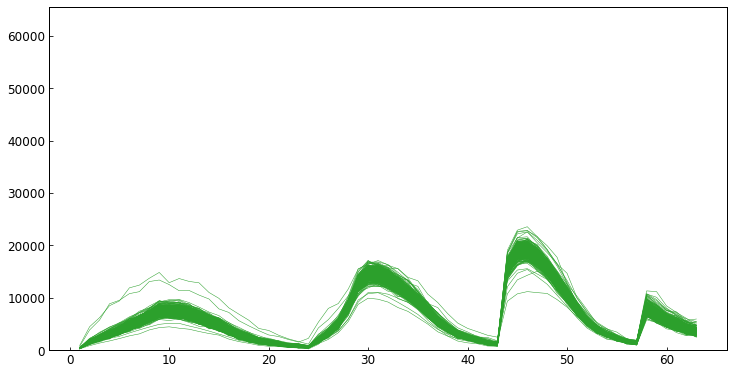

Cluster: 6


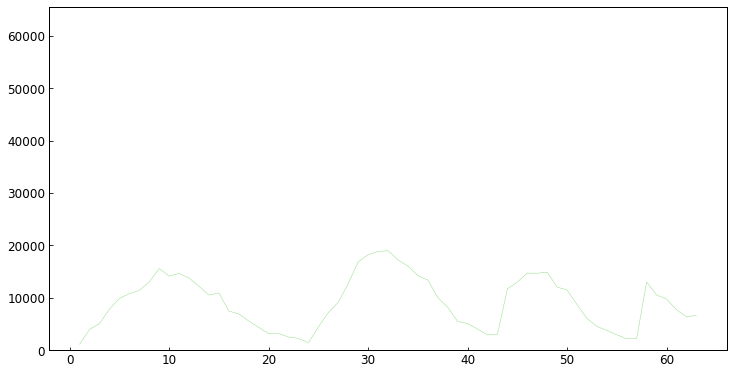

Cluster: 8


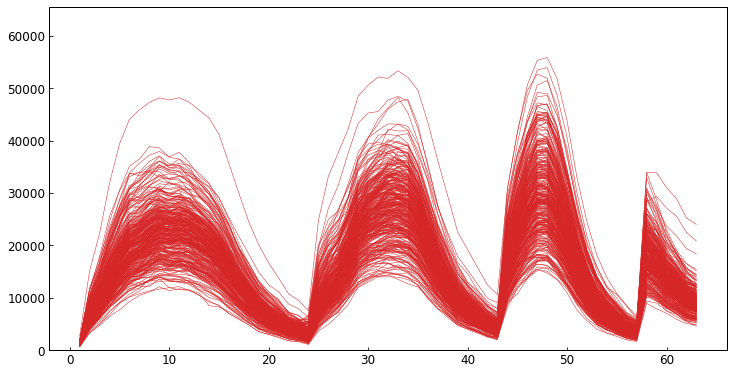

Cluster: 9


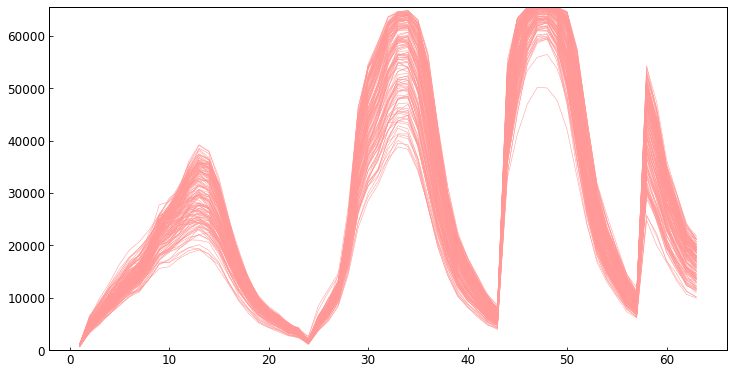

Cluster: 11


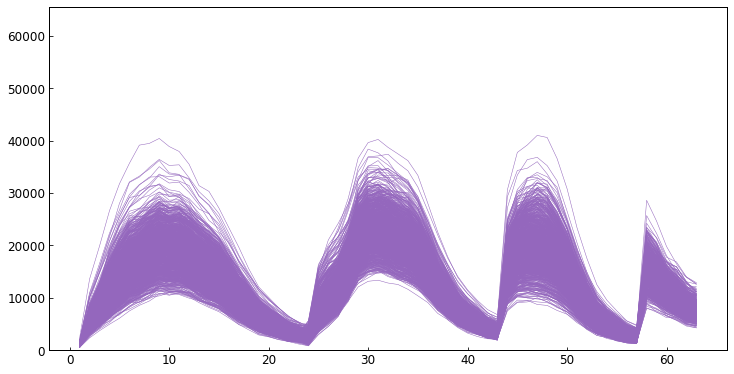

Cluster: 12


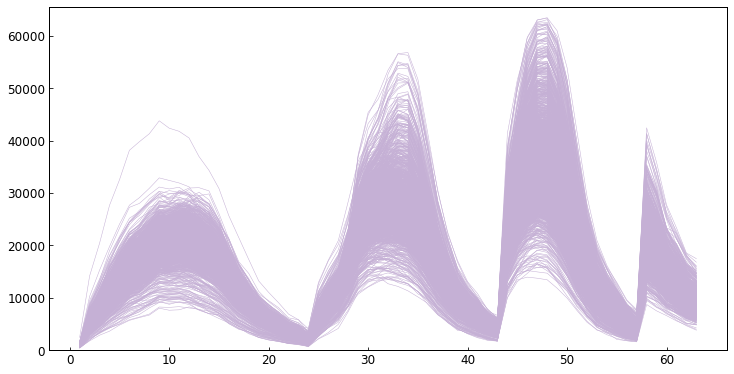

Cluster: 13


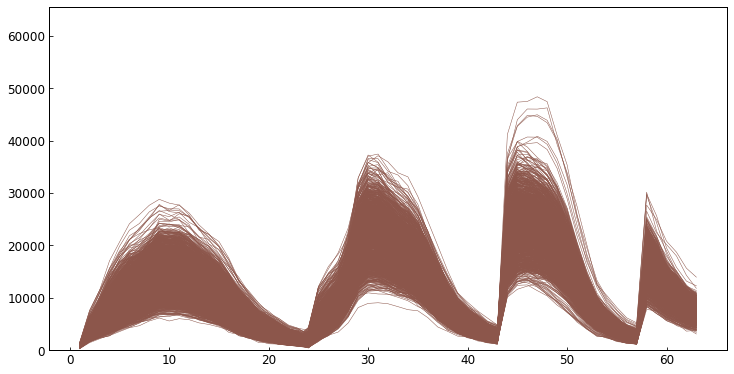

In [766]:
for c in np.unique(clust_all):
    print('Cluster:', c)
    bool_c = clust_all == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':1,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [767]:
i = 6
i_old = 5
sub_cl[i] = 10

In [771]:
# pick a threshold for clustering
t[i] = 0.0195

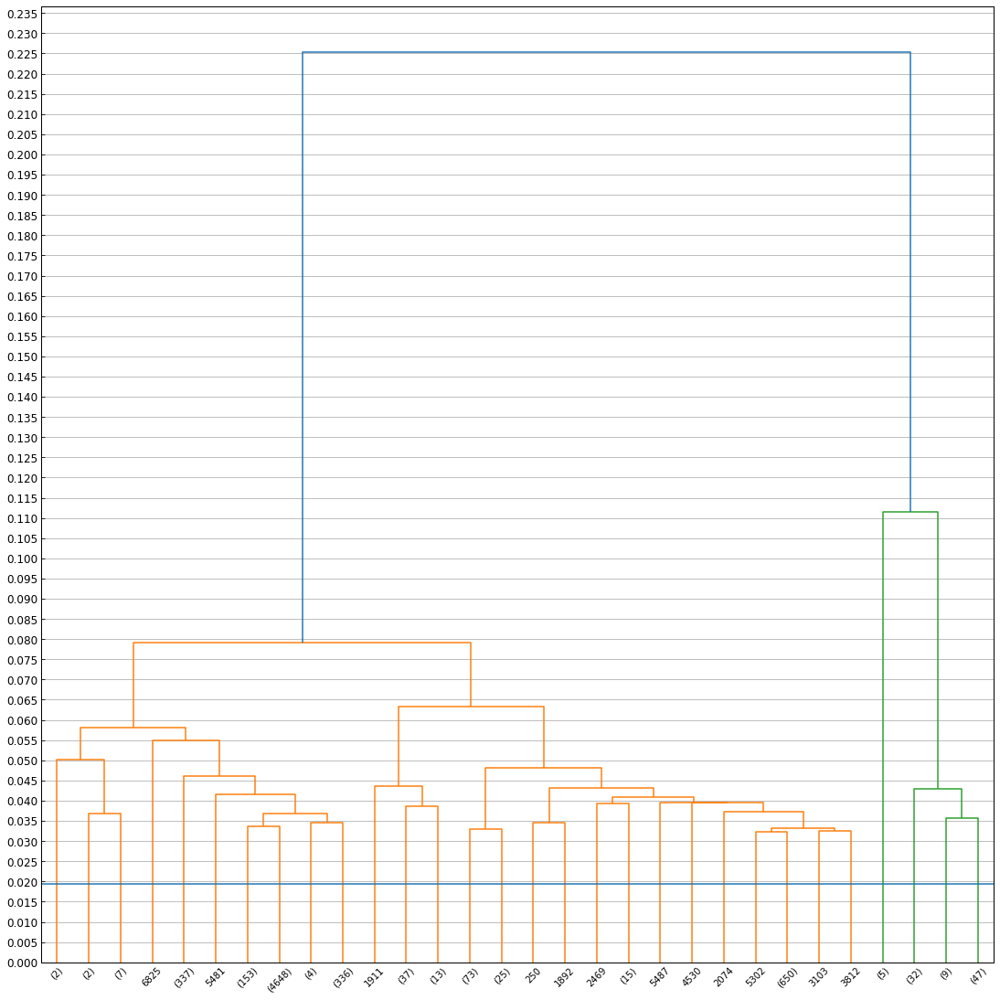

In [772]:
fig, ax = ip.general_plot(dims=(15,15))
dn = hierarchy.dendrogram(linkage, labels=labels, truncate_mode='lastp')
ax.axhline(t[i])
ylims = [round(l,2) for l in ax.get_ylim()]
ax.set_yticks(np.arange(ylims[0],ylims[1],0.005))
ax.grid(axis='y')
plt.show()
plt.close()

In [773]:
# cluster linkage into three groups
clust[i] = hierarchy.fcluster(linkage, t=t[i], criterion='distance')
bool_subclust = clust[i_old] == sub_cl[i]
clust_unique = np.unique(clust[i][bool_subclust])
clust_unique

array([11, 12], dtype=int32)

Cluster: 11


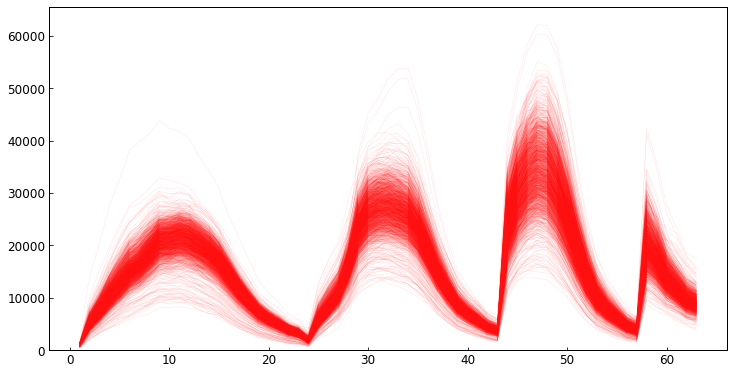

Cluster: 12


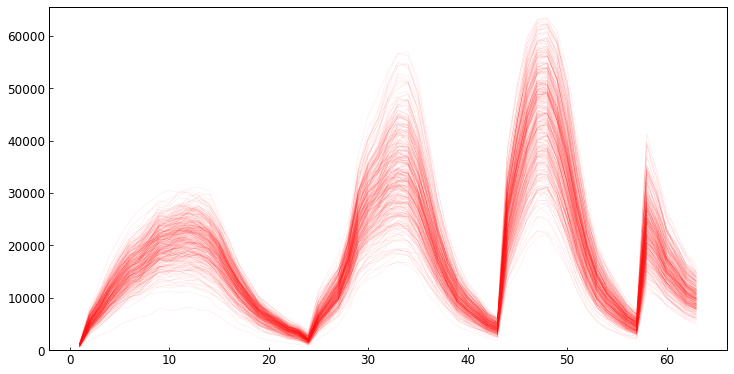

In [774]:
spec_dims = (10,5)
for c in clust_unique:
    labels_sub = np.array(labels)[clust[i] == c]
    if len(labels_sub) > 10:
        print("Cluster:",c) 
        spec_sub = []
        for l in labels_sub:
            s = dict_lab_specmean[l]
            spec_sub.append(s)
        spec_sub = np.vstack(spec_sub)
        fig, ax = ip.general_plot(dims=spec_dims)
        fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.1,'color':'r'})
        ax.set_ylim(0,2**16)
        plt.plot()
        plt.show()

In [775]:
clust_change = [12]

clmx = np.max(clust_all)
clust_i_rename = clust[i_old].copy()
for c in clust_change:
    bool_c = clust[i] == c
    clmx += 1
    clust_i_rename[bool_c] = clmx

np.unique(clust_i_rename[bool_subclust])

array([10, 14], dtype=int32)

In [776]:
clust_all[bool_subclust] = clust_i_rename[bool_subclust]
np.unique(clust_all)


array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 11, 13, 14], dtype=int32)

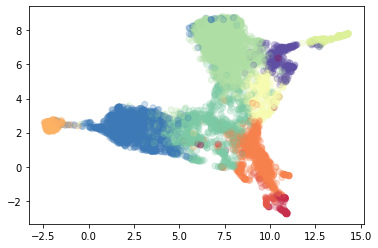

In [778]:
# fit = umap.UMAP(metric='precomputed')
# u = fit.fit_transform(dist_mat)
plt.scatter(u[:,0], u[:,1], c=clust_all, alpha=0.25, cmap='Spectral')
plt.show()
plt.close()

In [783]:
dict_lab_clust = dict(zip(labels,clust_all))
colors = plt.get_cmap('tab20').colors
dict_clust_col = dict(zip(np.unique(clust_all), colors))

In [784]:
seg = segs[m]
prop = props[m]
for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

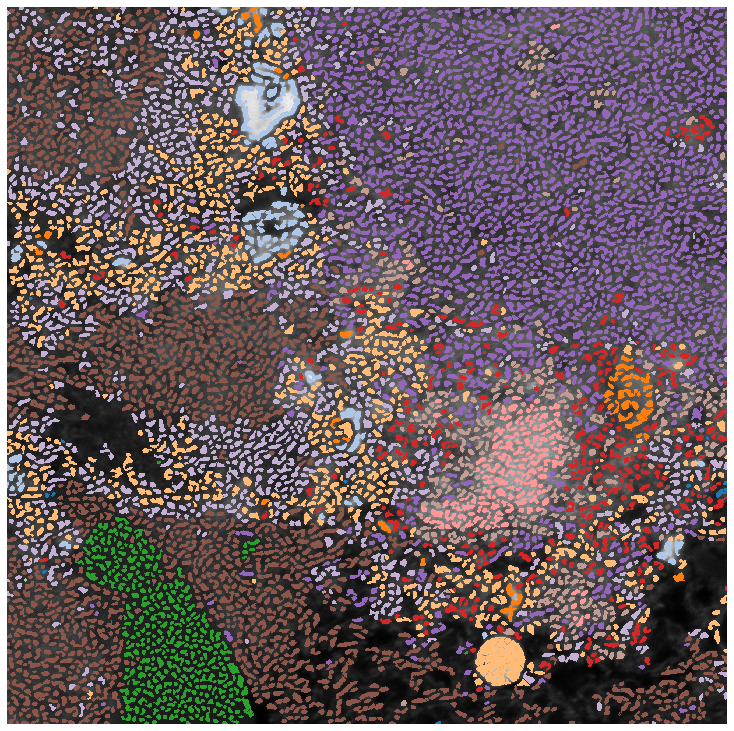

In [785]:
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

Cluster: 1


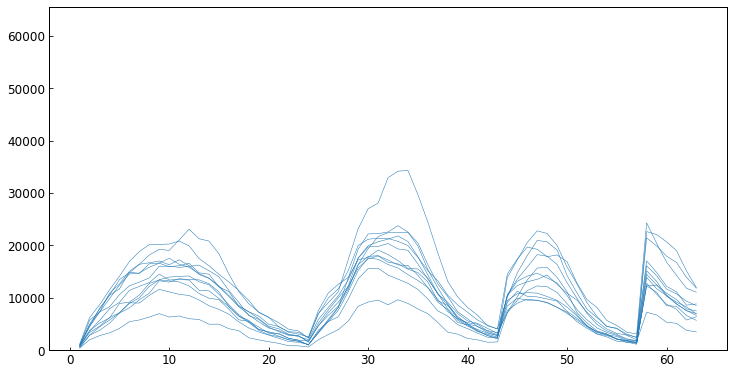

Cluster: 2


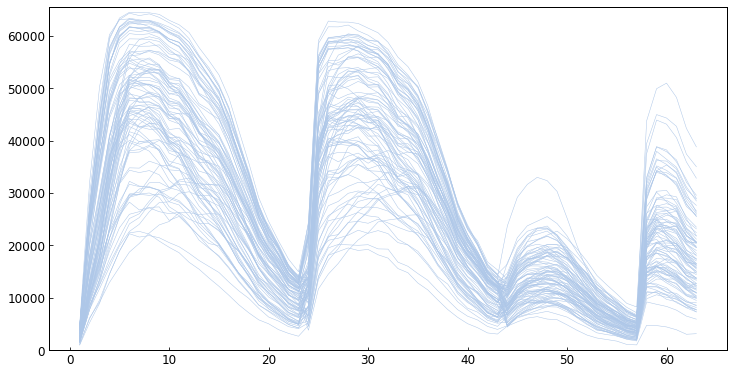

Cluster: 3


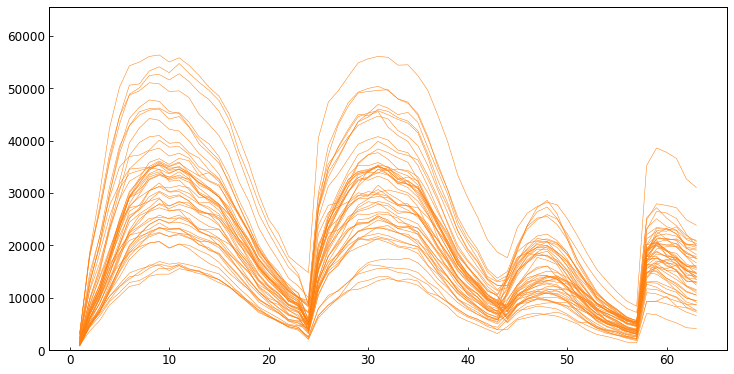

Cluster: 4


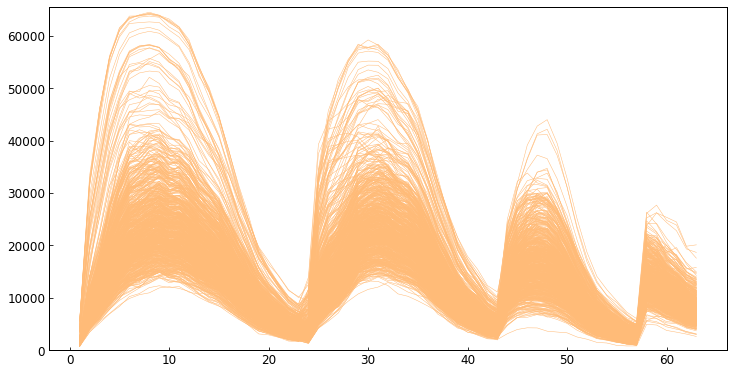

Cluster: 5


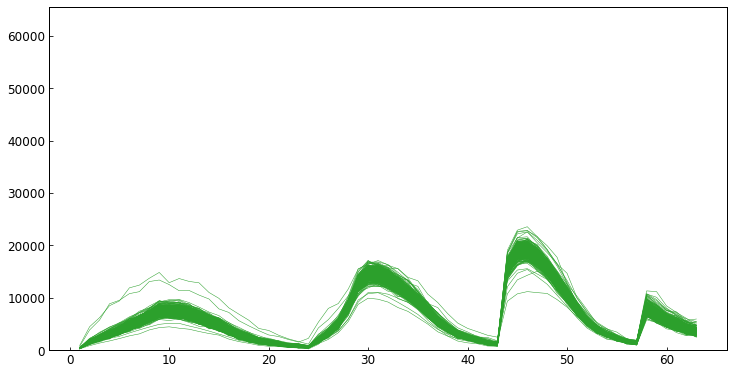

Cluster: 6


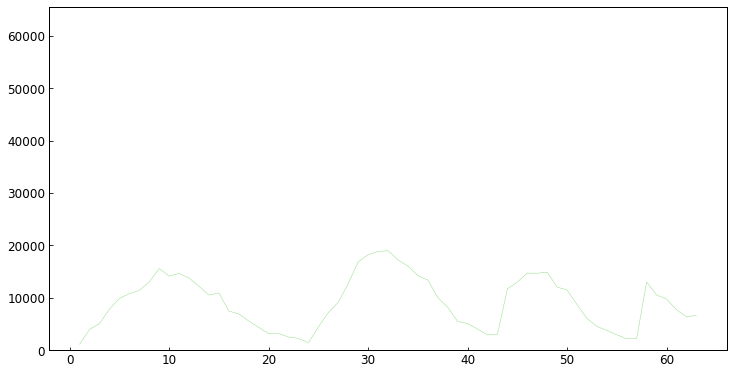

Cluster: 8


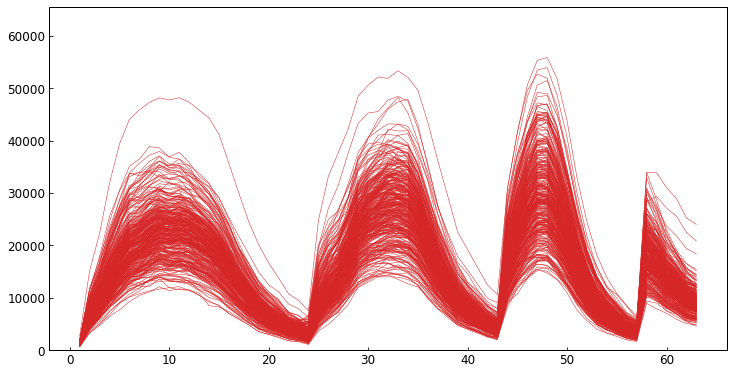

Cluster: 9


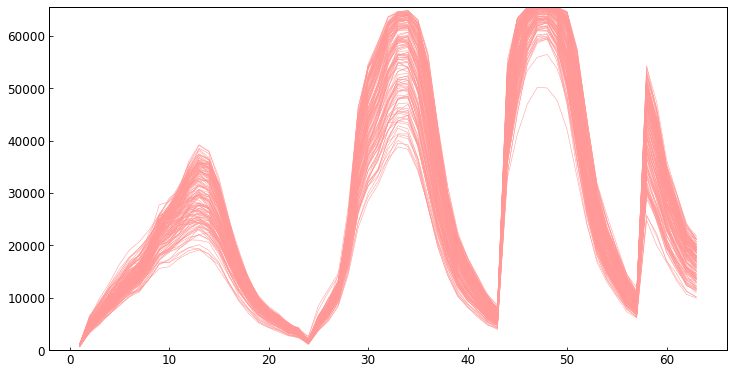

Cluster: 10


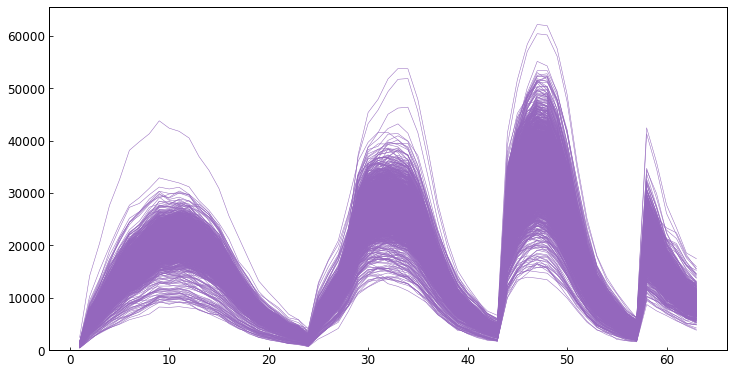

Cluster: 11


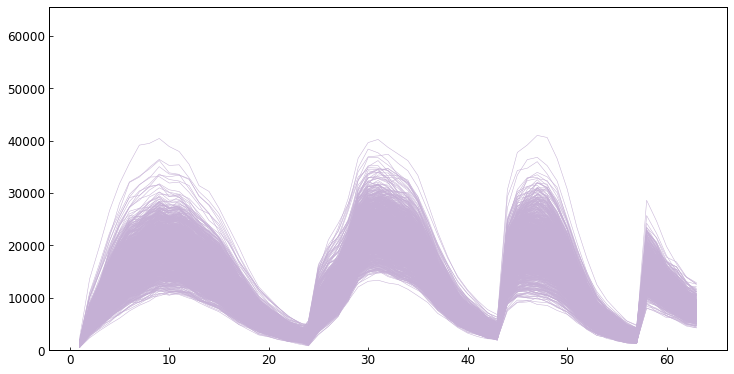

Cluster: 13


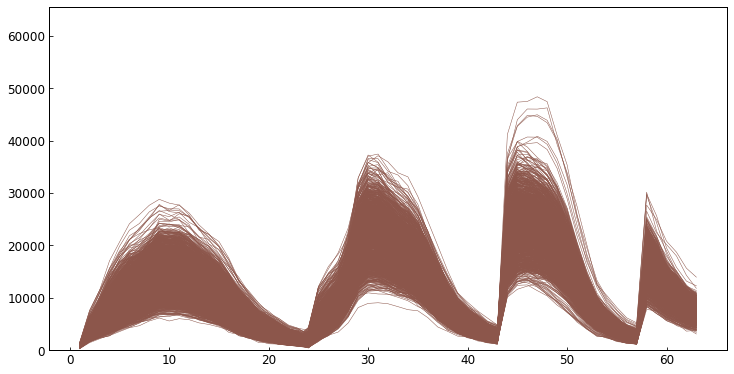

Cluster: 14


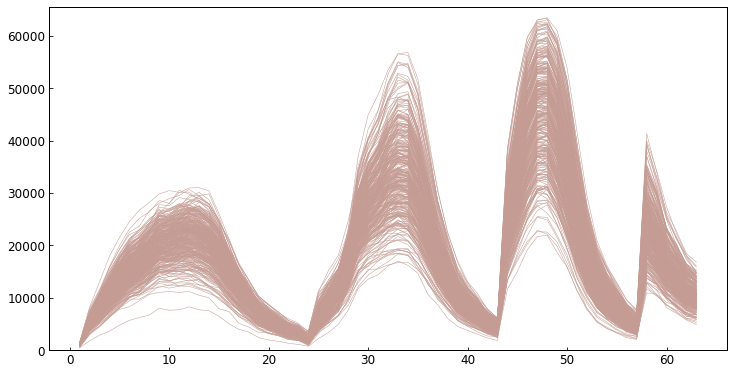

In [786]:
for c in np.unique(clust_all):
    print('Cluster:', c)
    bool_c = clust_all == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':1,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

Merge cluster

Cluster: 1


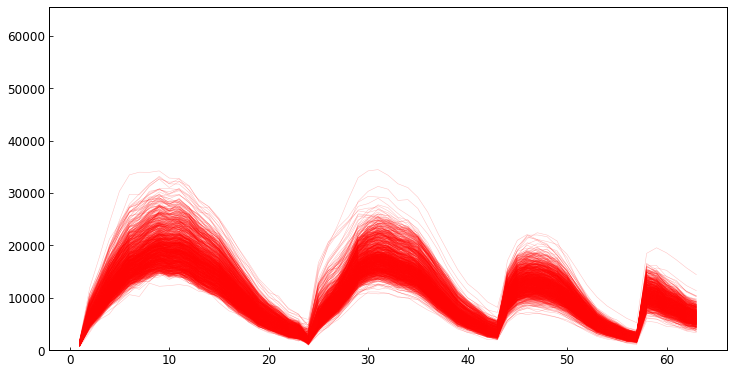

Cluster: 2


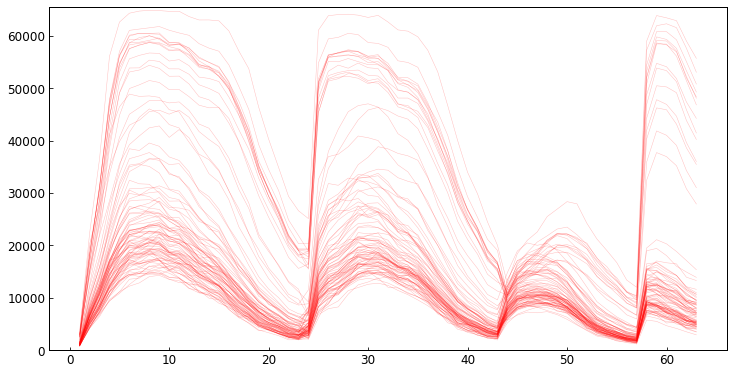

Cluster: 3


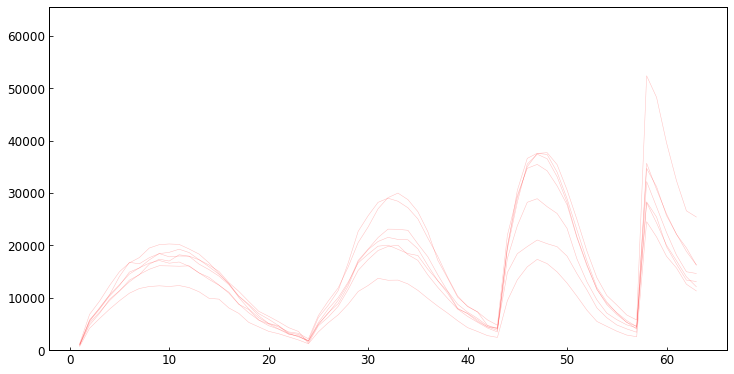

Cluster: 4


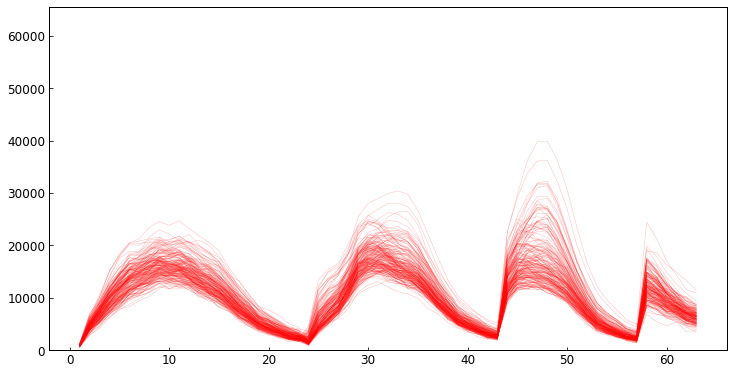

Cluster: 5


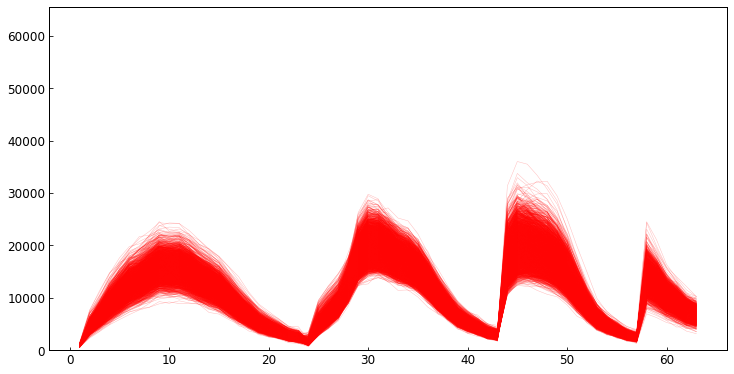

Cluster: 6


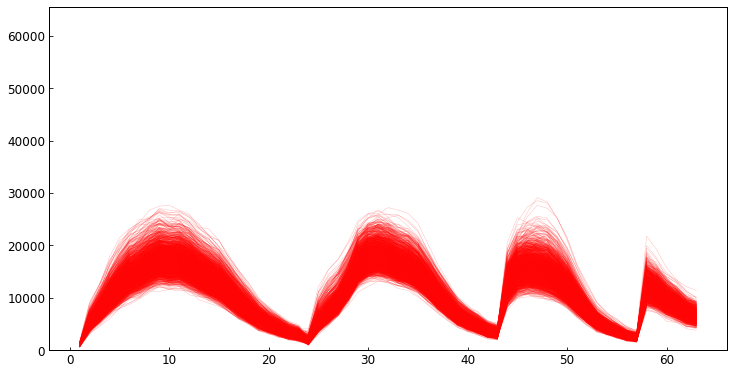

In [1189]:
for c in np.unique(clust_all):
    print('Cluster:', c)
    bool_c = clust_all == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.25,'color':'r'})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [1190]:
# Merge certain cluster
merge = {}

In [1191]:
clust_merge = clust_all.copy()
for c, c_lst in merge.items():
    for c_ in c_lst:
        bool_c = clust_all == c_
        clust_merge[bool_c] = c

Cluster: 1


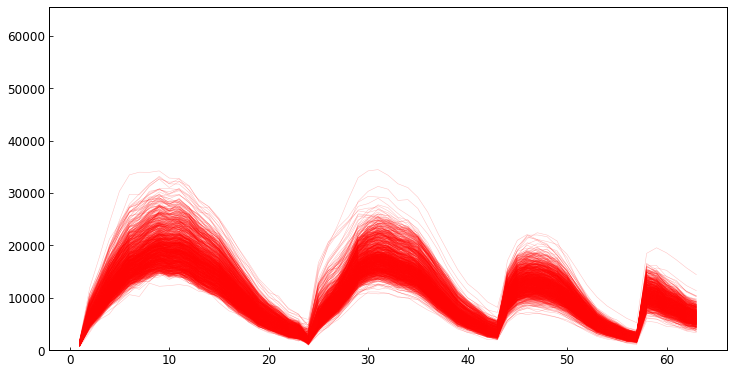

Cluster: 2


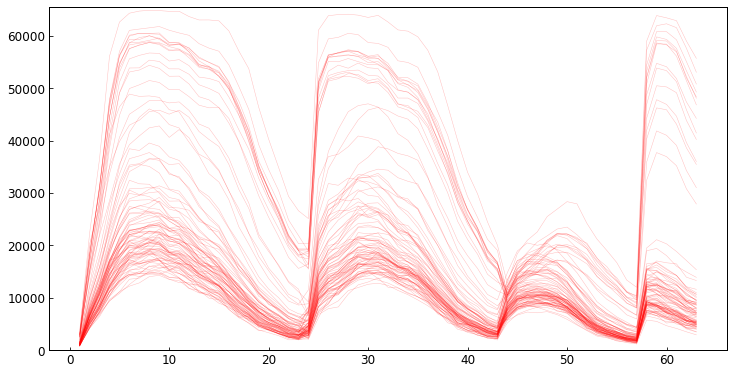

Cluster: 3


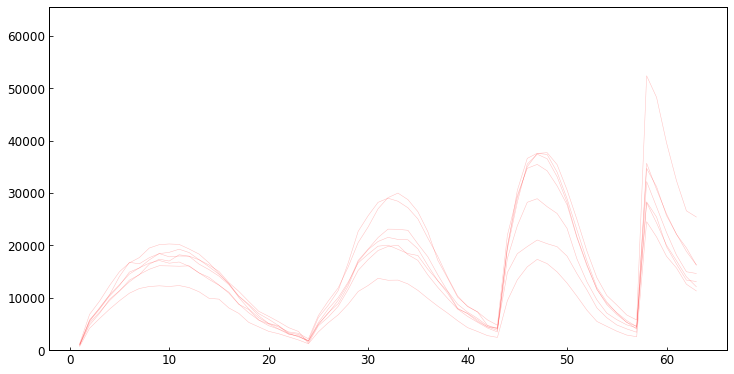

Cluster: 4


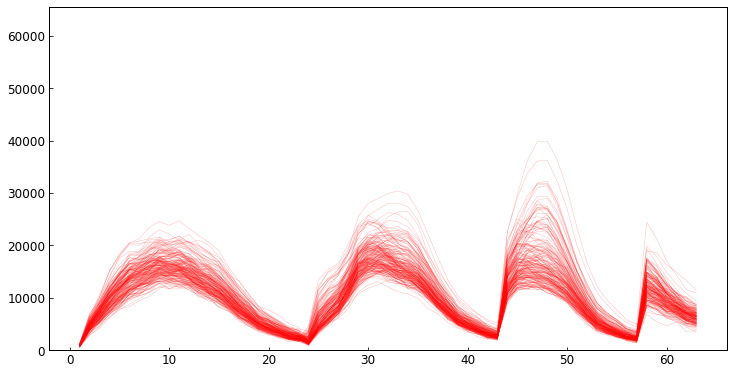

Cluster: 5


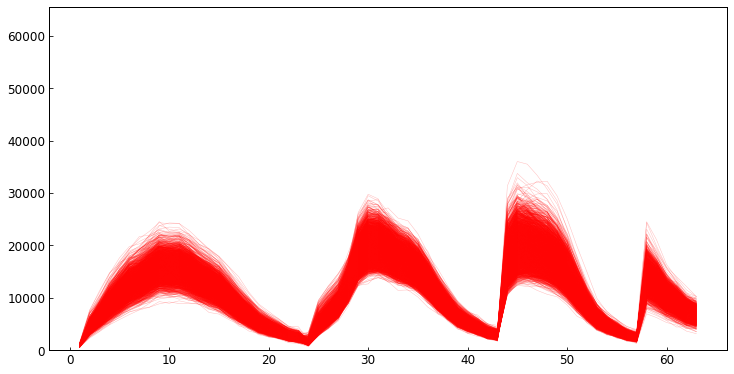

Cluster: 6


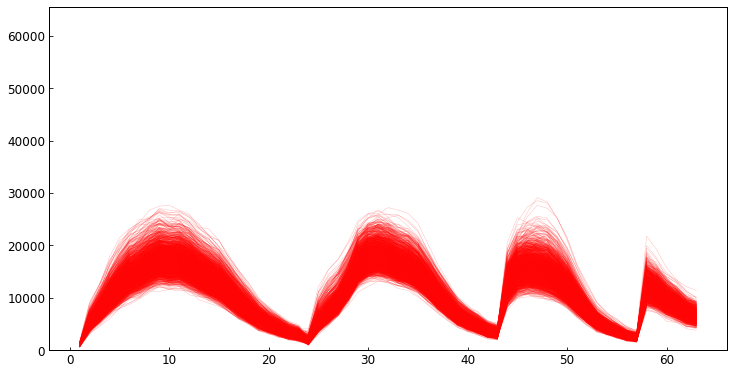

In [1192]:
for c in np.unique(clust_merge):
    print('Cluster:', c)
    bool_c = clust_merge == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':0.25,'color':'r'})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

## Project to the image

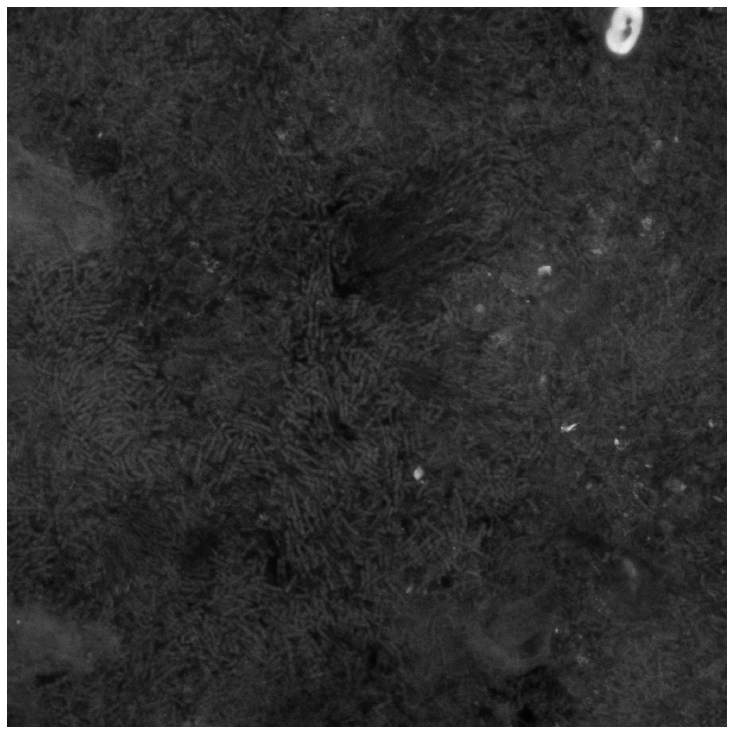

In [1193]:
im_sum = np.sum(stacks[m], axis=2)

mx = np.max(im_sum)
mn = np.min(im_sum)
im_norm = (im_sum - mn) / (mx - mn)
im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

In [1194]:
dict_lab_clust = dict(zip(labels,clust_merge))
colors = plt.get_cmap('tab10').colors
dict_clust_col = dict(zip(np.unique(clust_merge), colors))

In [1195]:
seg = segs[m]
prop = props[m]
for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        b = eval(b) if isinstance(b, str) else b
        rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
        seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
        im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
        cl = dict_lab_clust[l]
        color = np.array(dict_clust_col[cl])
        rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
        # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]
        rgb_cell = seg_sub[:,:,None] * color[None,:]
        im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

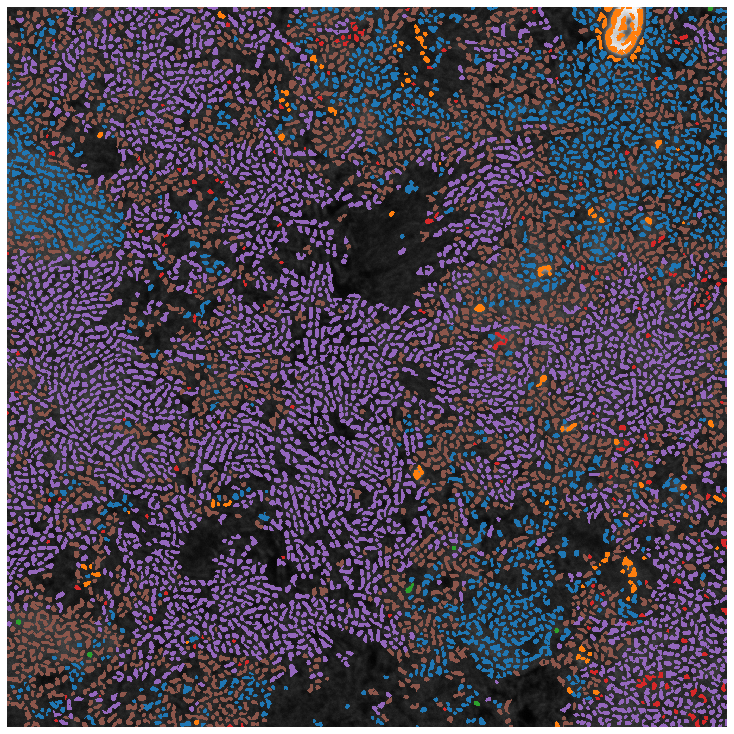

In [1196]:
fig, ax, cbar = ip.plot_image(im_rgb, im_inches=10)

Cluster: 1


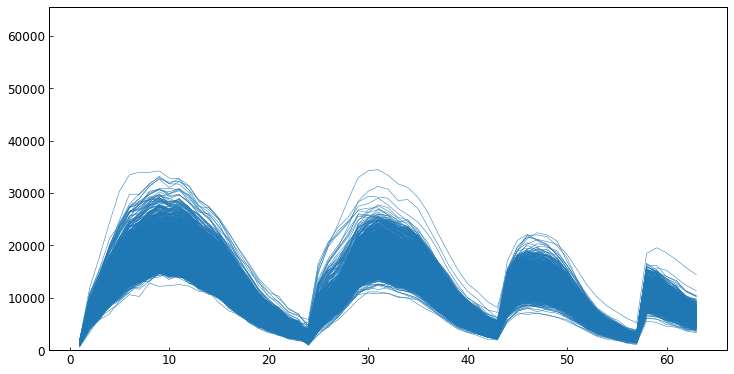

Cluster: 2


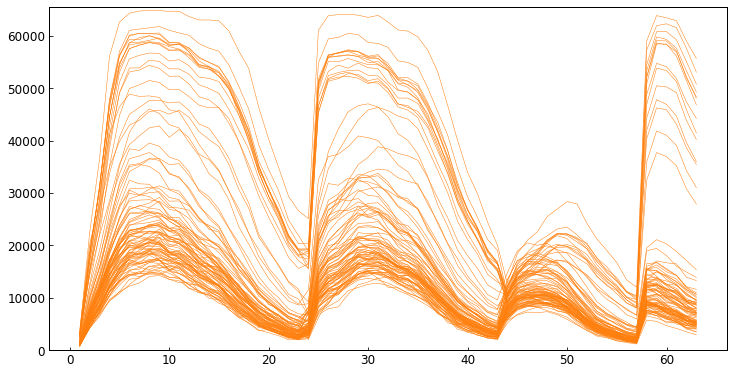

Cluster: 3


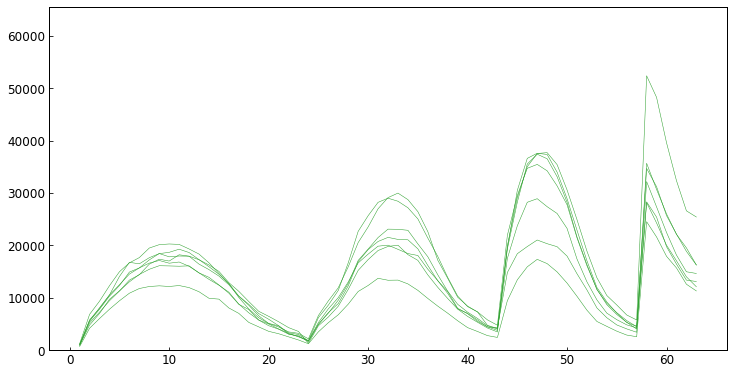

Cluster: 4


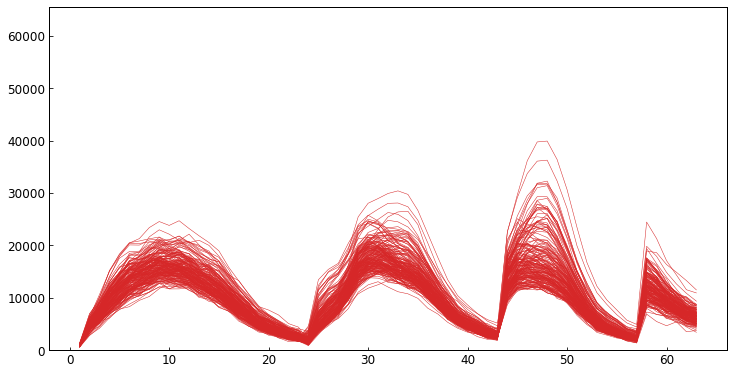

Cluster: 5


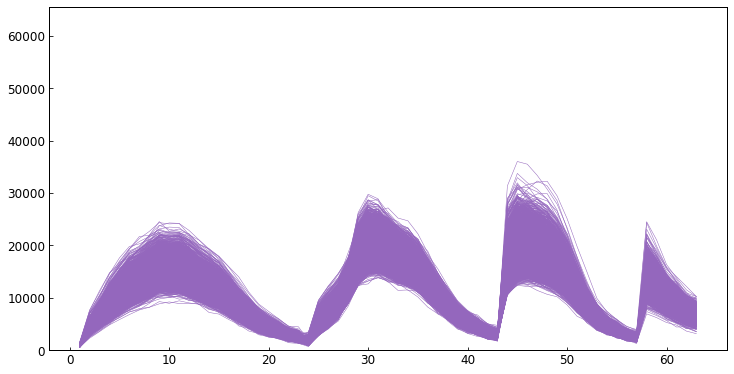

Cluster: 6


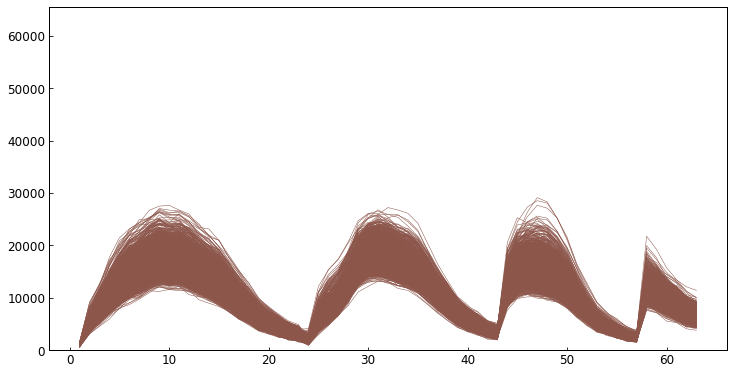

In [1197]:
for c in np.unique(clust_merge):
    print('Cluster:', c)
    bool_c = clust_merge == c
    labels_sub = np.array(labels)[bool_c]
    spec_sub = []
    for l in labels_sub:
        s = dict_lab_specmean[l]
        spec_sub.append(s)
    spec_sub = np.vstack(spec_sub)
    fig, ax = ip.general_plot(dims=spec_dims)
    color = dict_clust_col[c]
    fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':1,'color':color})
    ax.set_ylim(0,2**16)
    plt.plot()
    plt.show()

In [1198]:
ignore = [2]
clust_trim = clust_merge.copy()
for c in ignore:
    bool_c = clust_merge == c
    clust_trim[bool_c] = 0

In [1199]:
dict_lab_clust = dict(zip(labels,clust_trim))
colors = plt.get_cmap('tab10').colors
dict_clust_col = dict(zip(np.unique(clust_trim)[1:], colors))

In [1200]:
im_rgb = im_norm[:,:,None] * np.array([1,1,1])[None,:]
for i, row in prop.iterrows():
    l = row.label
    if l in labels:
        b = row.bbox
        cl = dict_lab_clust[l]
        if cl:
            color = np.array(dict_clust_col[cl])
            b = eval(b) if isinstance(b, str) else b
            rgb_sub = im_rgb[b[0]:b[2],b[1]:b[3]]
            seg_sub = seg[b[0]:b[2],b[1]:b[3]] == l
            im_sub = im_norm[b[0]:b[2],b[1]:b[3]]
            rgb_noncell =  rgb_sub * np.dstack([~seg_sub]*3)
            # rgb_cell = (im_sub * seg_sub)[:,:,None] * color[None,:]        
            rgb_cell = seg_sub[:,:,None] * color[None,:]
            im_rgb[b[0]:b[2],b[1]:b[3],:] = rgb_noncell + rgb_cell

(<Figure size 720x719.648 with 1 Axes>, <Axes:>, [[], []])

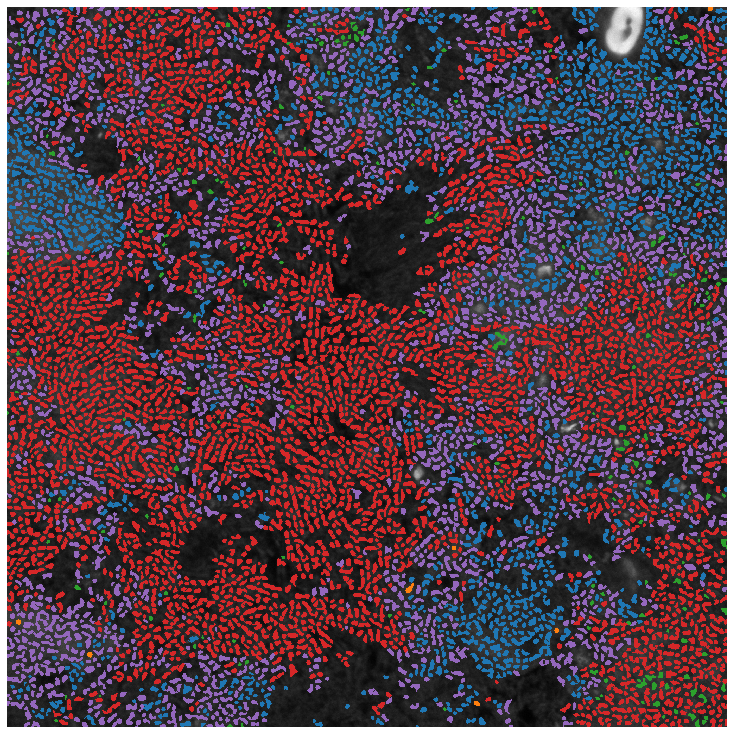

In [1201]:
ip.plot_image(im_rgb, im_inches=10)

Cluster: 1


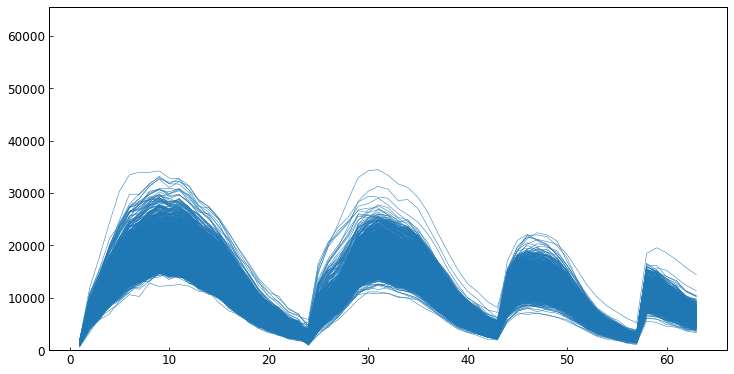

Cluster: 3


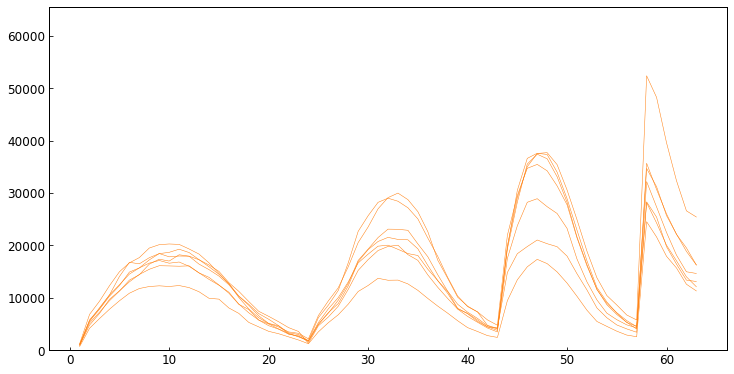

Cluster: 4


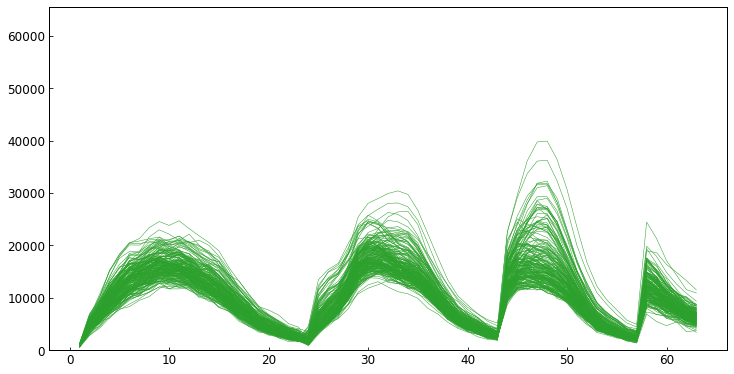

Cluster: 5


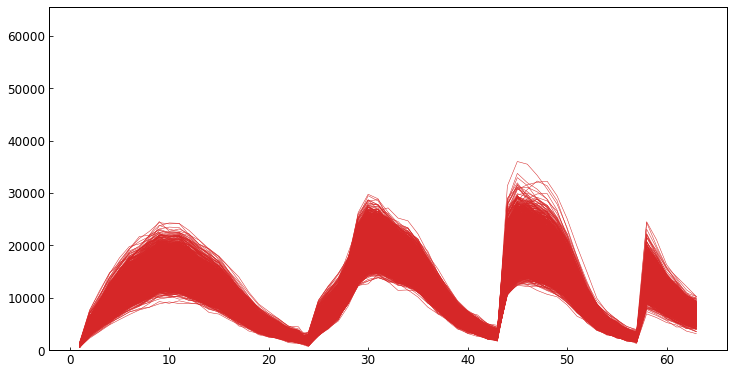

Cluster: 6


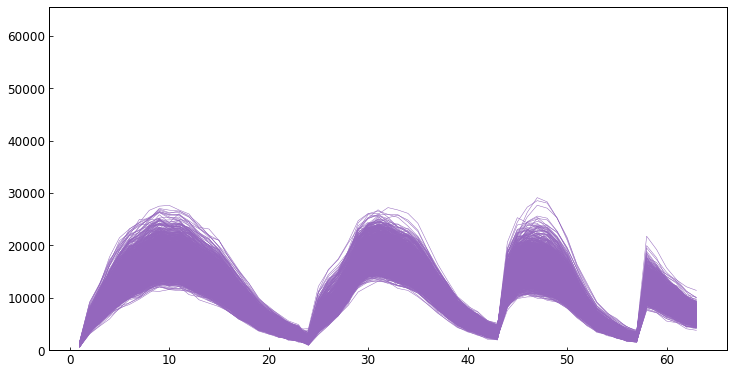

In [1202]:
for c in np.unique(clust_trim):
    if c:
        print('Cluster:', c)
        bool_c = clust_trim == c
        labels_sub = np.array(labels)[bool_c]
        spec_sub = []
        for l in labels_sub:
            s = dict_lab_specmean[l]
            spec_sub.append(s)
        spec_sub = np.vstack(spec_sub)
        fig, ax = ip.general_plot(dims=spec_dims)
        color = dict_clust_col[c]
        fsi.plot_cell_spectra(ax, spec_sub, {'lw':0.5,'alpha':1,'color':color})
        ax.set_ylim(0,2**16)
        plt.plot()
        plt.show()

## Save

In [116]:
output_dir = '../../outputs/agglomerative_cluster/' + sn
# output_dir = output_dir_fmt.format(sample_name=sn)
if not os.path.exists(output_dir): 
    os.makedirs(output_dir)
    print("made dir:",output_dir)


made dir: ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01


In [117]:
stack_dir = output_dir + '/stacks'
props_dir = output_dir + '/props'
segs_dir = output_dir + '/segs'
spec_dir = output_dir + '/spectra'
clust_dir = output_dir + '/clust'

for dir_ in [clust_dir, spec_dir, segs_dir, props_dir, stack_dir]:
    if not os.path.exists(dir_):
        os.makedirs(dir_)
        print("made dir:",dir_)


made dir: ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01/clust
made dir: ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01/spectra
made dir: ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01/segs
made dir: ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01/props
made dir: ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01/stacks


In [206]:
bn = sn + '_M_' + str(m)
stack_fn = stack_dir + '/' + bn + '_stack.npy'
props_fn = props_dir + '/' + bn + '_props.csv'
seg_fn = segs_dir + '/' + bn + '_seg.npy'
spec_fn = spec_dir + '/' + bn + '_spec.yaml'
clust_fn = clust_dir + '/' + bn + '_clust.yaml'

np.save(stack_fn, stacks[m])
print('Wrote:',stack_fn)
props[m].to_csv(props_fn, index=False)
print('Wrote:',props_fn)
np.save(seg_fn, segs[m])
print('Wrote:',seg_fn)
with open(spec_fn, 'w') as f:
    yaml.dump(specs[m], f)
print('Wrote:',spec_fn)
with open(clust_fn, 'w') as f:
    yaml.dump(dict_lab_clust, f)
print('Wrote:',clust_fn)


Wrote: ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01/stacks/2023_10_18_hsdm_slide_IVB_fov_01_M_5_stack.npy
Wrote: ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01/props/2023_10_18_hsdm_slide_IVB_fov_01_M_5_props.csv
Wrote: ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01/segs/2023_10_18_hsdm_slide_IVB_fov_01_M_5_seg.npy
Wrote: ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01/spectra/2023_10_18_hsdm_slide_IVB_fov_01_M_5_spec.yaml
Wrote: ../../outputs/agglomerative_cluster/2023_10_18_hsdm_slide_IVB_fov_01/clust/2023_10_18_hsdm_slide_IVB_fov_01_M_5_clust.yaml


: 

In [205]:
a = 1